In [ ]:
from pathlib import Path
import sys

sys.path.append(str(Path('').absolute().parent))


from stable_baselines3 import DQN, A2C
from stable_baselines3.a2c import MlpPolicy
from stable_baselines3.common.env_util import make_vec_env

from gym_snake.envs.SnakeEnv import SnakeEnv

import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np

import random
random.seed(42)

In [ ]:
def plot_metrics(metrics, filepath=None):
    formatted_dict = {'episodes': [],
                      'metrics': [],
                      'results': []}

    n = len(metrics['score'])
    for i in range(n):        
        score = metrics['score'][i]
        reward = metrics['reward'][i]

        formatted_dict['episodes'].append(i)
        formatted_dict['metrics'].append('score')
        formatted_dict['results'].append(score)

        formatted_dict['episodes'].append(i)
        formatted_dict['metrics'].append('reward')
        formatted_dict['results'].append(reward)

    df_metrics = pd.DataFrame(formatted_dict)
    sns.lineplot(data=df_metrics, x='episodes', y='results', hue='metrics')
    if filepath is None:
        plt.show()
    else:
        plt.savefig(filepath)
        
def evaluate(model):
    snake_env = SnakeEnv(440, 440, enable_render=False)
    env = make_vec_env(lambda: snake_env, n_envs=1)
    obs = env.reset()

    for _ in range(10000):
        action, _states = model.predict(obs)
        obs, rewards, dones, info = env.step(action)
        env.render()

    return snake_env.record, np.mean(np.array(snake_env.results['score']))

def plot_max_results(results, p_string):
    formatted_dict = { p_string: [],
                      'metrics': [],
                      'results': []}
    for parameter, result in results.items():
        _, max_train_score, max_test_score, meand_train_score, mean_test_score = result
        
        formatted_dict[p_string].append(parameter)
        formatted_dict['metrics'].append('Max Train Score')
        formatted_dict['results'].append(max_train_score)
        
        formatted_dict[p_string].append(parameter)
        formatted_dict['metrics'].append('Max Test Score')
        formatted_dict['results'].append(max_test_score)
        
        formatted_dict[p_string].append(parameter)
        formatted_dict['metrics'].append('Mean Train Score')
        formatted_dict['results'].append(mean_train_score)
        
        formatted_dict[p_string].append(parameter)
        formatted_dict['metrics'].append('Mean Test Score')
        formatted_dict['results'].append(mean_test_score)
        
    df_metrics = pd.DataFrame(formatted_dict)
    sns.lineplot(data=df_metrics, x=p_string, y='results', hue='metrics')  
    
    plt.show()
        
           

# Testando Learning Rate

In [ ]:
#this is a try. My learning rate was always the same using random.uniform. 
#the problem seemed the seed=42 in the A2C constructor
for _ in range(10):
    learning_rate=random.uniform(0.001,0.1)
    print("lr: ", learning_rate)
    

lr:  0.06430325304733049
lr:  0.003476064767044027
lr:  0.02822790251854281
lr:  0.023097863076733453
lr:  0.07391065020223724
lr:  0.06799324925486823
lr:  0.0893257772027797
lr:  0.009606944430312198
lr:  0.04277026014884178
lr:  0.003949924724368965


## Default Example

In [ ]:
results = {}

# enable_render=True turns on the display
snake_env = SnakeEnv(440, 440, enable_render=False)
env = make_vec_env(lambda: snake_env, n_envs=1)

#gamma = random.uniform(0.95, 1)
learning_rate=1e-3#random.uniform(0.001,0.1)
#print("lr: ", learning_rate)

model = A2C(MlpPolicy, env, verbose=1, learning_rate=learning_rate)#, seed=42)#, gamma=gamma)
model.learn(total_timesteps=20000, log_interval=1000)

# Print rewards and scores for each episode
max_train_score = snake_env.record
mean_train_score = np.mean(np.array(snake_env.results['score']))
max_test_score, mean_test_score = evaluate(model)

results[learning_rate] = (snake_env.results, max_train_score, max_test_score, mean_train_score, mean_test_score)

Using cpu device
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 81.6     |
|    ep_rew_mean        | -26.6    |
| time/                 |          |
|    fps                | 415      |
|    iterations         | 1000     |
|    time_elapsed       | 12       |
|    total_timesteps    | 5000     |
| train/                |          |
|    entropy_loss       | -0.0897  |
|    explained_variance | -51.2    |
|    learning_rate      | 0.001    |
|    n_updates          | 999      |
|    policy_loss        | 0.0344   |
|    value_loss         | 68.1     |
------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 62.5     |
|    ep_rew_mean        | -5.5     |
| time/                 |          |
|    fps                | 410      |
|    iterations         | 2000     |
|    time_elapsed       | 24       |
|    total_timesteps    | 10000    |
| train/             

Learning Rate 0.001


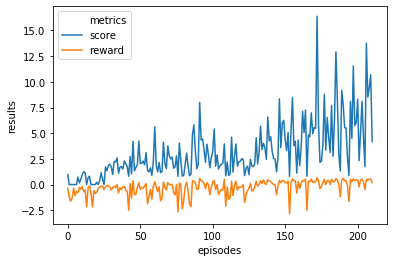

Max Train Score 31 Max Test Score 27
Mean Train Score 3.1806518916359434 Mean Test Score 6.458243129728509
----------------------------------------------------------------------------------------------------


In [ ]:
for learning_rate, result in results.items():
    metrics, max_train_score, max_test_score, mean_train_score, mean_test_score = result
    
    print("Learning Rate", learning_rate)
    plot_metrics(metrics)    
    print("Max Train Score", max_train_score, "Max Test Score", max_test_score)
    print("Mean Train Score", mean_train_score, "Mean Test Score", mean_test_score)
    print("-"*100)

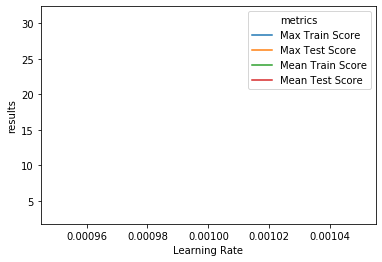

In [ ]:
plot_max_results(results,'Learning Rate')

## Learning rate range (0.001, 0.1)

In [ ]:
results = {}
for _ in range(10):
    # enable_render=True turns on the display
    snake_env = SnakeEnv(440, 440, enable_render=False)
    env = make_vec_env(lambda: snake_env, n_envs=1)

    #gamma = random.uniform(0.95, 1)
    learning_rate=random.uniform(0.001,0.1)
    #print("lr: ", learning_rate)
    
    model = A2C(MlpPolicy, env, verbose=1, learning_rate=learning_rate)#, seed=42)#, gamma=gamma)
    model.learn(total_timesteps=20000, log_interval=1000)

    # Print rewards and scores for each episode
    max_train_score = snake_env.record
    mean_train_score = np.mean(np.array(snake_env.results['score']))
    max_test_score, mean_test_score = evaluate(model)
    
    results[learning_rate] = (snake_env.results, max_train_score, max_test_score, mean_train_score, mean_test_score)

Using cpu device
-------------------------------------
| rollout/              |           |
|    ep_len_mean        | 523       |
|    ep_rew_mean        | -30       |
| time/                 |           |
|    fps                | 454       |
|    iterations         | 1000      |
|    time_elapsed       | 10        |
|    total_timesteps    | 5000      |
| train/                |           |
|    entropy_loss       | -0.000497 |
|    explained_variance | 0.00564   |
|    learning_rate      | 0.00777   |
|    n_updates          | 999       |
|    policy_loss        | 1.22e-12  |
|    value_loss         | 2.37e-15  |
-------------------------------------
-------------------------------------
| rollout/              |           |
|    ep_len_mean        | 707       |
|    ep_rew_mean        | -22.3     |
| time/                 |           |
|    fps                | 445       |
|    iterations         | 2000      |
|    time_elapsed       | 22        |
|    total_timesteps    | 10000  

-------------------------------------
| rollout/              |           |
|    ep_len_mean        | 12        |
|    ep_rew_mean        | -50       |
| time/                 |           |
|    fps                | 303       |
|    iterations         | 2000      |
|    time_elapsed       | 32        |
|    total_timesteps    | 10000     |
| train/                |           |
|    entropy_loss       | -2.89e-05 |
|    explained_variance | -0.485    |
|    learning_rate      | 0.0172    |
|    n_updates          | 1999      |
|    policy_loss        | -7.46e-05 |
|    value_loss         | 950       |
-------------------------------------
-------------------------------------
| rollout/              |           |
|    ep_len_mean        | 12        |
|    ep_rew_mean        | -50       |
| time/                 |           |
|    fps                | 304       |
|    iterations         | 3000      |
|    time_elapsed       | 49        |
|    total_timesteps    | 15000     |
| train/    

-------------------------------------
| rollout/              |           |
|    ep_len_mean        | 1e+03     |
|    ep_rew_mean        | -9.29     |
| time/                 |           |
|    fps                | 463       |
|    iterations         | 3000      |
|    time_elapsed       | 32        |
|    total_timesteps    | 15000     |
| train/                |           |
|    entropy_loss       | -1.29e-10 |
|    explained_variance | -2.97e+06 |
|    learning_rate      | 0.062     |
|    n_updates          | 2999      |
|    policy_loss        | -0        |
|    value_loss         | 0.00431   |
-------------------------------------
-------------------------------------
| rollout/              |           |
|    ep_len_mean        | 1e+03     |
|    ep_rew_mean        | -9.47     |
| time/                 |           |
|    fps                | 460       |
|    iterations         | 4000      |
|    time_elapsed       | 43        |
|    total_timesteps    | 20000     |
| train/    

-------------------------------------
| rollout/              |           |
|    ep_len_mean        | 12        |
|    ep_rew_mean        | -50       |
| time/                 |           |
|    fps                | 302       |
|    iterations         | 4000      |
|    time_elapsed       | 66        |
|    total_timesteps    | 20000     |
| train/                |           |
|    entropy_loss       | -6.42e-08 |
|    explained_variance | -0.445    |
|    learning_rate      | 0.0755    |
|    n_updates          | 3999      |
|    policy_loss        | -0        |
|    value_loss         | 1.3e+03   |
-------------------------------------


Learning Rate 0.007772749144735323


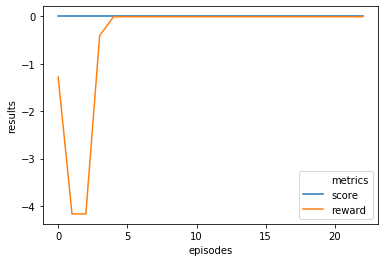

Max Train Score 0 Max Test Score 0
Mean Train Score 0.0 Mean Test Score 0.0
----------------------------------------------------------------------------------------------------
Learning Rate 0.056765830232493576


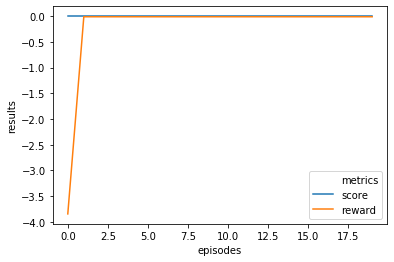

Max Train Score 0 Max Test Score 0
Mean Train Score 0.0 Mean Test Score 0.0
----------------------------------------------------------------------------------------------------
Learning Rate 0.06142160468810798


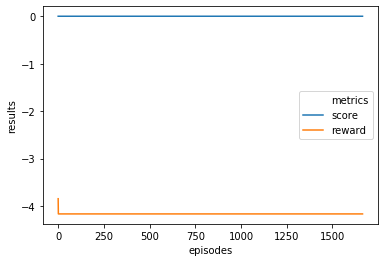

Max Train Score 0 Max Test Score 0
Mean Train Score 0.0 Mean Test Score 0.0
----------------------------------------------------------------------------------------------------
Learning Rate 0.017247538429273984


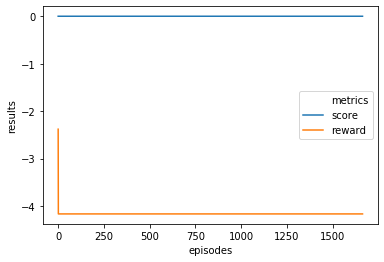

Max Train Score 0 Max Test Score 0
Mean Train Score 0.0 Mean Test Score 0.0
----------------------------------------------------------------------------------------------------
Learning Rate 0.03576758416385032


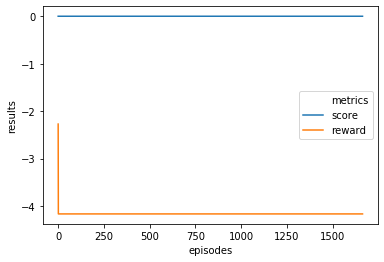

Max Train Score 0 Max Test Score 0
Mean Train Score 0.0 Mean Test Score 0.0
----------------------------------------------------------------------------------------------------
Learning Rate 0.022092489690929074


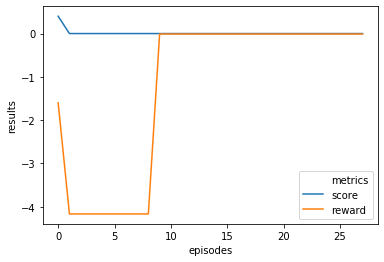

Max Train Score 1 Max Test Score 0
Mean Train Score 0.014285714285714287 Mean Test Score 0.0
----------------------------------------------------------------------------------------------------
Learning Rate 0.06199152524746992


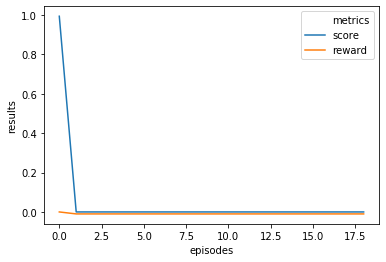

Max Train Score 1 Max Test Score 0
Mean Train Score 0.05226608187134503 Mean Test Score 0.0
----------------------------------------------------------------------------------------------------
Learning Rate 0.009582115313132866


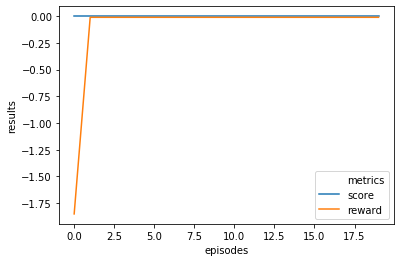

Max Train Score 0 Max Test Score 0
Mean Train Score 0.0 Mean Test Score 0.0
----------------------------------------------------------------------------------------------------
Learning Rate 0.010946046135286241


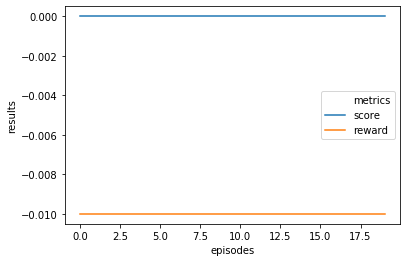

Max Train Score 0 Max Test Score 0
Mean Train Score 0.0 Mean Test Score 0.0
----------------------------------------------------------------------------------------------------
Learning Rate 0.07549211900824729


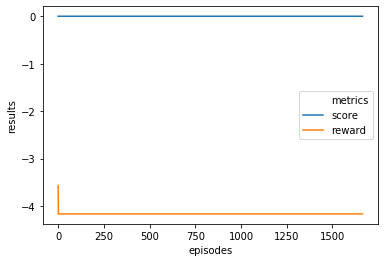

Max Train Score 0 Max Test Score 0
Mean Train Score 0.0 Mean Test Score 0.0
----------------------------------------------------------------------------------------------------


In [ ]:
for learning_rate, result in results.items():
    metrics, max_train_score, max_test_score, mean_train_score, mean_test_score = result
    
    print("Learning Rate", learning_rate)
    plot_metrics(metrics)    
    print("Max Train Score", max_train_score, "Max Test Score", max_test_score)
    print("Mean Train Score", mean_train_score, "Mean Test Score", mean_test_score)
    print("-"*100)

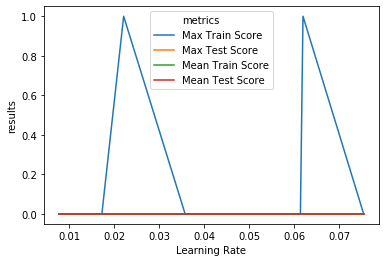

In [ ]:
plot_max_results(results,'Learning Rate')

#### Result: value above 0.01 are bad, the score is always 0


## Learning rate range (0.001, 0.01)

In [ ]:
results = {}
for _ in range(10):
    # enable_render=True turns on the display
    snake_env = SnakeEnv(440, 440, enable_render=False)
    env = make_vec_env(lambda: snake_env, n_envs=1)

    #gamma = random.uniform(0.95, 1)
    learning_rate=random.uniform(0.001,0.01)
    #print("lr: ", learning_rate)
    
    model = A2C(MlpPolicy, env, verbose=1, learning_rate=learning_rate)#, seed=42)#, gamma=gamma)
    model.learn(total_timesteps=20000, log_interval=1000)

    # Print rewards and scores for each episode
    max_train_score = snake_env.record
    mean_train_score = np.mean(np.array(snake_env.results['score']))
    max_test_score, mean_test_score = evaluate(model)
    
    results[learning_rate] = (snake_env.results, max_train_score, max_test_score, mean_train_score, mean_test_score)

Using cpu device
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 1e+03    |
|    ep_rew_mean        | -10      |
| time/                 |          |
|    fps                | 462      |
|    iterations         | 1000     |
|    time_elapsed       | 10       |
|    total_timesteps    | 5000     |
| train/                |          |
|    entropy_loss       | -0.00502 |
|    explained_variance | -0.0306  |
|    learning_rate      | 0.00631  |
|    n_updates          | 999      |
|    policy_loss        | 7.22e-12 |
|    value_loss         | 2.47e-15 |
------------------------------------
-------------------------------------
| rollout/              |           |
|    ep_len_mean        | 1e+03     |
|    ep_rew_mean        | -10       |
| time/                 |           |
|    fps                | 458       |
|    iterations         | 2000      |
|    time_elapsed       | 21        |
|    total_timesteps    | 10000     |
| train/    

------------------------------------
| rollout/              |          |
|    ep_len_mean        | 511      |
|    ep_rew_mean        | -30.6    |
| time/                 |          |
|    fps                | 434      |
|    iterations         | 2000     |
|    time_elapsed       | 23       |
|    total_timesteps    | 10000    |
| train/                |          |
|    entropy_loss       | -2.3e-05 |
|    explained_variance | -0.00408 |
|    learning_rate      | 0.00383  |
|    n_updates          | 1999     |
|    policy_loss        | 3.35e-14 |
|    value_loss         | 1.19e-15 |
------------------------------------
-------------------------------------
| rollout/              |           |
|    ep_len_mean        | 617       |
|    ep_rew_mean        | -26.1     |
| time/                 |           |
|    fps                | 438       |
|    iterations         | 3000      |
|    time_elapsed       | 34        |
|    total_timesteps    | 15000     |
| train/                |    

-------------------------------------
| rollout/              |           |
|    ep_len_mean        | 703       |
|    ep_rew_mean        | -23       |
| time/                 |           |
|    fps                | 448       |
|    iterations         | 3000      |
|    time_elapsed       | 33        |
|    total_timesteps    | 15000     |
| train/                |           |
|    entropy_loss       | -4.53e-06 |
|    explained_variance | -0.599    |
|    learning_rate      | 0.00647   |
|    n_updates          | 2999      |
|    policy_loss        | -8.94e-13 |
|    value_loss         | 1.19e-10  |
-------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 763      |
|    ep_rew_mean        | -20.4    |
| time/                 |          |
|    fps                | 446      |
|    iterations         | 4000     |
|    time_elapsed       | 44       |
|    total_timesteps    | 20000    |
| train/             

-------------------------------------
| rollout/              |           |
|    ep_len_mean        | 912       |
|    ep_rew_mean        | -13.8     |
| time/                 |           |
|    fps                | 459       |
|    iterations         | 4000      |
|    time_elapsed       | 43        |
|    total_timesteps    | 20000     |
| train/                |           |
|    entropy_loss       | -4.99e-05 |
|    explained_variance | 0.0288    |
|    learning_rate      | 0.00422   |
|    n_updates          | 3999      |
|    policy_loss        | -2.21e-13 |
|    value_loss         | 8.15e-15  |
-------------------------------------


Learning Rate 0.0063061652598536185


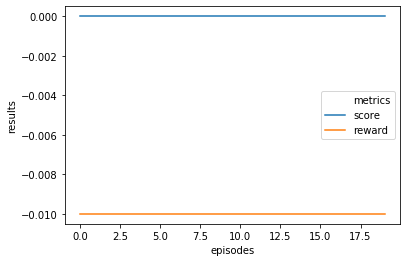

Max Train Score 0 Max Test Score 0
Mean Train Score 0.0 Mean Test Score 0.0
----------------------------------------------------------------------------------------------------
Learning Rate 0.0044562871840880865


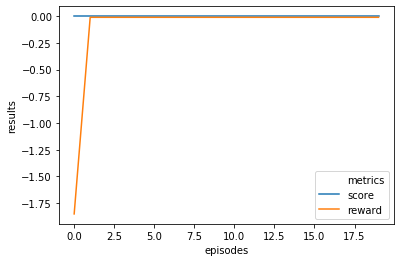

Max Train Score 0 Max Test Score 0
Mean Train Score 0.0 Mean Test Score 0.0
----------------------------------------------------------------------------------------------------
Learning Rate 0.00966923839497938


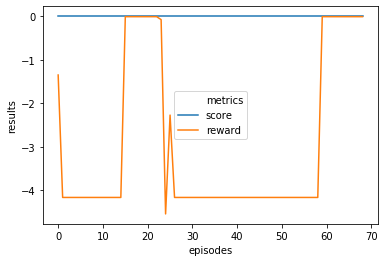

Max Train Score 0 Max Test Score 0
Mean Train Score 0.0 Mean Test Score 0.0
----------------------------------------------------------------------------------------------------
Learning Rate 0.0038305330136395245


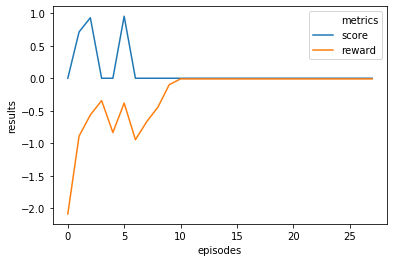

Max Train Score 1 Max Test Score 0
Mean Train Score 0.09260962601002842 Mean Test Score 0.0
----------------------------------------------------------------------------------------------------
Learning Rate 0.005980569686062571


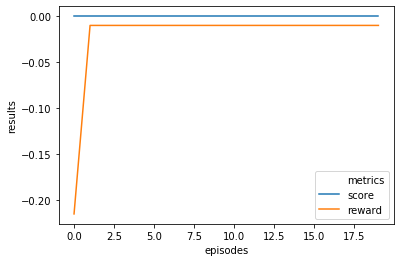

Max Train Score 0 Max Test Score 0
Mean Train Score 0.0 Mean Test Score 0.0
----------------------------------------------------------------------------------------------------
Learning Rate 0.006400070805032677


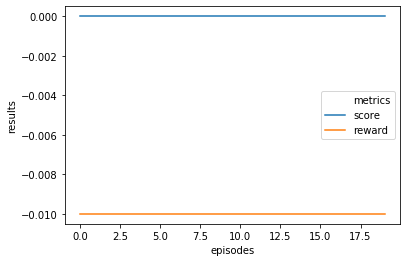

Max Train Score 0 Max Test Score 0
Mean Train Score 0.0 Mean Test Score 0.0
----------------------------------------------------------------------------------------------------
Learning Rate 0.00646833789023971


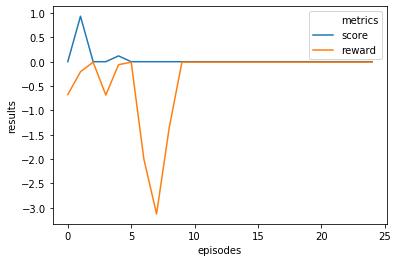

Max Train Score 1 Max Test Score 0
Mean Train Score 0.042072674048619065 Mean Test Score 0.0
----------------------------------------------------------------------------------------------------
Learning Rate 0.0028490114633719778


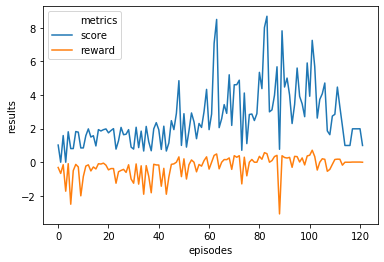

Max Train Score 18 Max Test Score 3
Mean Train Score 2.6700281359345386 Mean Test Score 1.398201409787309
----------------------------------------------------------------------------------------------------
Learning Rate 0.006970195247417596


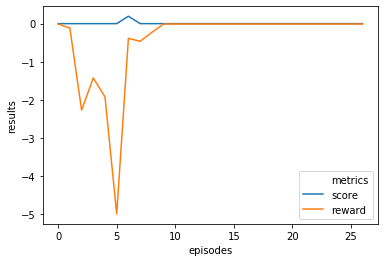

Max Train Score 1 Max Test Score 0
Mean Train Score 0.00719165767709457 Mean Test Score 0.0
----------------------------------------------------------------------------------------------------
Learning Rate 0.004217746638139699


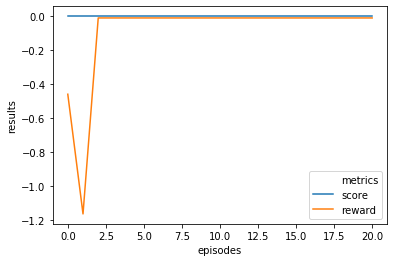

Max Train Score 0 Max Test Score 0
Mean Train Score 0.0 Mean Test Score 0.0
----------------------------------------------------------------------------------------------------


In [ ]:
for learning_rate, result in results.items():
    metrics, max_train_score, max_test_score, mean_train_score, mean_test_score = result
    
    print("Learning Rate", learning_rate)
    plot_metrics(metrics)    
    print("Max Train Score", max_train_score, "Max Test Score", max_test_score)
    print("Mean Train Score", mean_train_score, "Mean Test Score", mean_test_score)
    print("-"*100)

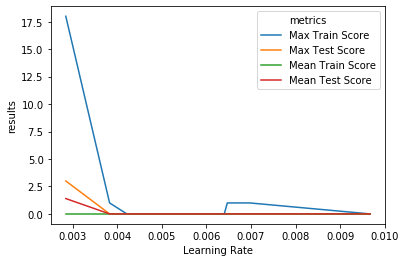

In [ ]:
plot_max_results(results,'Learning Rate')

#### Result:  continue to be ruim, value above 0.003 are low

## Learning rate range (0.0005, 0.005)

In [ ]:
results = {}
for _ in range(10):
    # enable_render=True turns on the display
    snake_env = SnakeEnv(440, 440, enable_render=False)
    env = make_vec_env(lambda: snake_env, n_envs=1)

    #gamma = random.uniform(0.95, 1)
    learning_rate=random.uniform(0.0005,0.005)
    #print("lr: ", learning_rate)
    
    model = A2C(MlpPolicy, env, verbose=1, learning_rate=learning_rate)#, seed=42)#, gamma=gamma)
    model.learn(total_timesteps=20000, log_interval=1000)

    # Print rewards and scores for each episode
    max_train_score = snake_env.record
    mean_train_score = np.mean(np.array(snake_env.results['score']))
    max_test_score, mean_test_score = evaluate(model)
    
    results[learning_rate] = (snake_env.results, max_train_score, max_test_score, mean_train_score, mean_test_score)

Using cpu device
-------------------------------------
| rollout/              |           |
|    ep_len_mean        | 735       |
|    ep_rew_mean        | -23.3     |
| time/                 |           |
|    fps                | 459       |
|    iterations         | 1000      |
|    time_elapsed       | 10        |
|    total_timesteps    | 5000      |
| train/                |           |
|    entropy_loss       | -0.000882 |
|    explained_variance | -0.965    |
|    learning_rate      | 0.00247   |
|    n_updates          | 999       |
|    policy_loss        | 2.1e-11   |
|    value_loss         | 7.11e-14  |
-------------------------------------
-------------------------------------
| rollout/              |           |
|    ep_len_mean        | 855       |
|    ep_rew_mean        | -17.3     |
| time/                 |           |
|    fps                | 462       |
|    iterations         | 2000      |
|    time_elapsed       | 21        |
|    total_timesteps    | 10000  

-------------------------------------
| rollout/              |           |
|    ep_len_mean        | 783       |
|    ep_rew_mean        | -19.2     |
| time/                 |           |
|    fps                | 440       |
|    iterations         | 2000      |
|    time_elapsed       | 22        |
|    total_timesteps    | 10000     |
| train/                |           |
|    entropy_loss       | -0.000183 |
|    explained_variance | -0.424    |
|    learning_rate      | 0.00289   |
|    n_updates          | 1999      |
|    policy_loss        | 5.88e-11  |
|    value_loss         | 3.93e-11  |
-------------------------------------
-------------------------------------
| rollout/              |           |
|    ep_len_mean        | 847       |
|    ep_rew_mean        | -16.5     |
| time/                 |           |
|    fps                | 446       |
|    iterations         | 3000      |
|    time_elapsed       | 33        |
|    total_timesteps    | 15000     |
| train/    

------------------------------------
| rollout/              |          |
|    ep_len_mean        | 791      |
|    ep_rew_mean        | -18.9    |
| time/                 |          |
|    fps                | 458      |
|    iterations         | 3000     |
|    time_elapsed       | 32       |
|    total_timesteps    | 15000    |
| train/                |          |
|    entropy_loss       | -0.00176 |
|    explained_variance | -0.825   |
|    learning_rate      | 0.00233  |
|    n_updates          | 2999     |
|    policy_loss        | 4.94e-09 |
|    value_loss         | 1.39e-08 |
------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 836      |
|    ep_rew_mean        | -17      |
| time/                 |          |
|    fps                | 458      |
|    iterations         | 4000     |
|    time_elapsed       | 43       |
|    total_timesteps    | 20000    |
| train/                |          |
|

------------------------------------
| rollout/              |          |
|    ep_len_mean        | 120      |
|    ep_rew_mean        | 35       |
| time/                 |          |
|    fps                | 429      |
|    iterations         | 4000     |
|    time_elapsed       | 46       |
|    total_timesteps    | 20000    |
| train/                |          |
|    entropy_loss       | -0.105   |
|    explained_variance | -1.1e+04 |
|    learning_rate      | 0.00249  |
|    n_updates          | 3999     |
|    policy_loss        | -0.498   |
|    value_loss         | 0.417    |
------------------------------------


Learning Rate 0.0024697153255187065


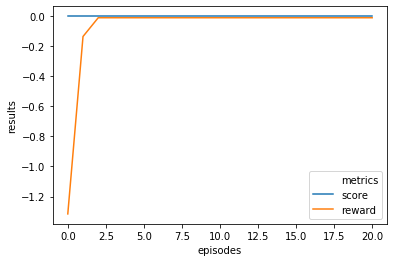

Max Train Score 0 Max Test Score 0
Mean Train Score 0.0 Mean Test Score 0.0
----------------------------------------------------------------------------------------------------
Learning Rate 0.0032981316499962826


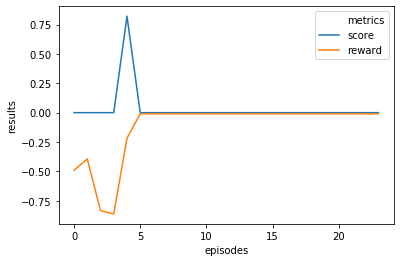

Max Train Score 1 Max Test Score 0
Mean Train Score 0.034193840579710144 Mean Test Score 0.0
----------------------------------------------------------------------------------------------------
Learning Rate 0.00217679968973502


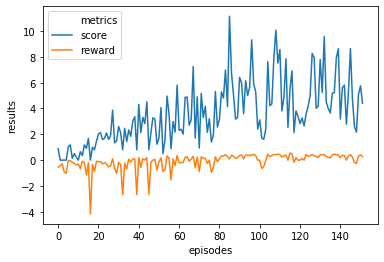

Max Train Score 18 Max Test Score 18
Mean Train Score 3.604206441750168 Mean Test Score 4.311070275839919
----------------------------------------------------------------------------------------------------
Learning Rate 0.002890047768312996


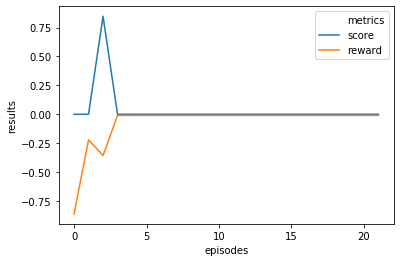

Max Train Score 1 Max Test Score 0
Mean Train Score 0.03855519480519481 Mean Test Score 0.0
----------------------------------------------------------------------------------------------------
Learning Rate 0.004195810943402324


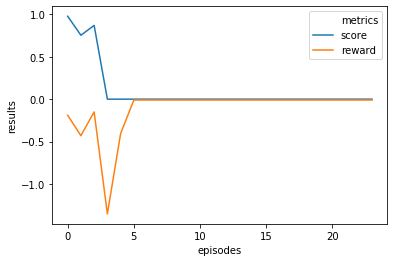

Max Train Score 1 Max Test Score 0
Mean Train Score 0.10822552259208895 Mean Test Score 0.0
----------------------------------------------------------------------------------------------------
Learning Rate 0.0036192192755120866


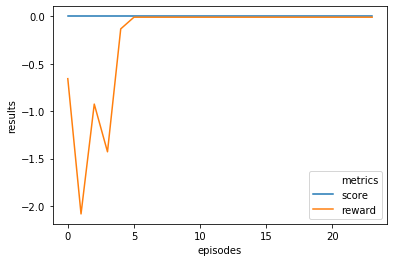

Max Train Score 0 Max Test Score 0
Mean Train Score 0.0 Mean Test Score 0.0
----------------------------------------------------------------------------------------------------
Learning Rate 0.002329781362970937


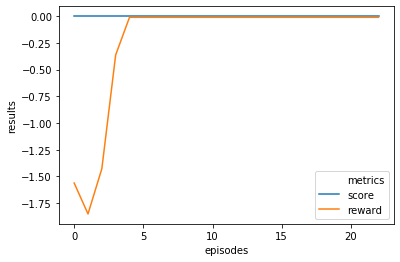

Max Train Score 0 Max Test Score 0
Mean Train Score 0.0 Mean Test Score 0.0
----------------------------------------------------------------------------------------------------
Learning Rate 0.0014810291833967267


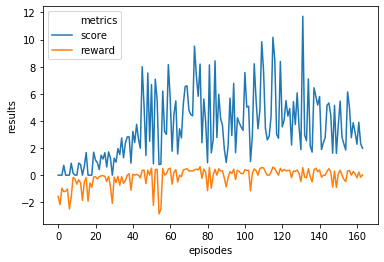

Max Train Score 22 Max Test Score 15
Mean Train Score 3.499772360714392 Mean Test Score 3.625928766186477
----------------------------------------------------------------------------------------------------
Learning Rate 0.004948481200310918


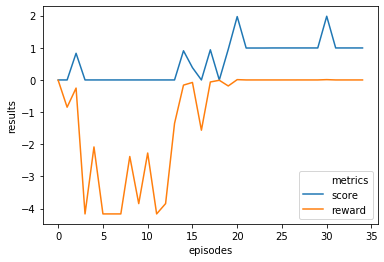

Max Train Score 3 Max Test Score 2
Mean Train Score 0.5969435396139068 Mean Test Score 1.3079294153379761
----------------------------------------------------------------------------------------------------
Learning Rate 0.0024861923188130384


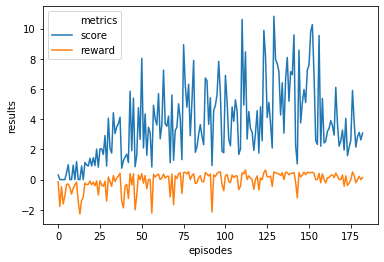

Max Train Score 21 Max Test Score 20
Mean Train Score 3.6998943662725985 Mean Test Score 3.364312017681897
----------------------------------------------------------------------------------------------------


In [ ]:
for learning_rate, result in results.items():
    metrics, max_train_score, max_test_score, mean_train_score, mean_test_score = result
    
    print("Learning Rate", learning_rate)
    plot_metrics(metrics)    
    print("Max Train Score", max_train_score, "Max Test Score", max_test_score)
    print("Mean Train Score", mean_train_score, "Mean Test Score", mean_test_score)
    print("-"*100)

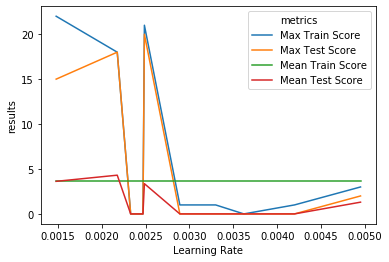

In [ ]:
plot_max_results(results,'Learning Rate')

#### Result: values above 0.002 are bad (not always)

## Learning Rate range (0.0002,0.002)

In [ ]:
results = {}
for _ in range(10):
    # enable_render=True turns on the display
    snake_env = SnakeEnv(440, 440, enable_render=False)
    env = make_vec_env(lambda: snake_env, n_envs=1)

    #gamma = random.uniform(0.95, 1)
    learning_rate=random.uniform(0.0002,0.002)
    #print("lr: ", learning_rate)
    
    model = A2C(MlpPolicy, env, verbose=1, learning_rate=learning_rate)#, seed=42)#, gamma=gamma)
    model.learn(total_timesteps=20000, log_interval=1000)

    # Print rewards and scores for each episode
    max_train_score = snake_env.record
    mean_train_score = np.mean(np.array(snake_env.results['score']))
    max_test_score, mean_test_score = evaluate(model)
    
    results[learning_rate] = (snake_env.results, max_train_score, max_test_score, mean_train_score, mean_test_score)

Using cpu device
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 76.6     |
|    ep_rew_mean        | -30      |
| time/                 |          |
|    fps                | 423      |
|    iterations         | 1000     |
|    time_elapsed       | 11       |
|    total_timesteps    | 5000     |
| train/                |          |
|    entropy_loss       | -0.372   |
|    explained_variance | -63.1    |
|    learning_rate      | 0.00105  |
|    n_updates          | 999      |
|    policy_loss        | 0.00995  |
|    value_loss         | 15.3     |
------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 83.3     |
|    ep_rew_mean        | -10.1    |
| time/                 |          |
|    fps                | 425      |
|    iterations         | 2000     |
|    time_elapsed       | 23       |
|    total_timesteps    | 10000    |
| train/             

-------------------------------------
| rollout/              |           |
|    ep_len_mean        | 94.9      |
|    ep_rew_mean        | -11.7     |
| time/                 |           |
|    fps                | 434       |
|    iterations         | 2000      |
|    time_elapsed       | 23        |
|    total_timesteps    | 10000     |
| train/                |           |
|    entropy_loss       | -0.000673 |
|    explained_variance | nan       |
|    learning_rate      | 0.00113   |
|    n_updates          | 1999      |
|    policy_loss        | -3.74e-05 |
|    value_loss         | 0.436     |
-------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 95.1     |
|    ep_rew_mean        | 18.1     |
| time/                 |          |
|    fps                | 433      |
|    iterations         | 3000     |
|    time_elapsed       | 34       |
|    total_timesteps    | 15000    |
| train/             

------------------------------------
| rollout/              |          |
|    ep_len_mean        | 87.9     |
|    ep_rew_mean        | 5.9      |
| time/                 |          |
|    fps                | 414      |
|    iterations         | 3000     |
|    time_elapsed       | 36       |
|    total_timesteps    | 15000    |
| train/                |          |
|    entropy_loss       | -0.0825  |
|    explained_variance | 0.415    |
|    learning_rate      | 0.00151  |
|    n_updates          | 2999     |
|    policy_loss        | -0.00774 |
|    value_loss         | 0.741    |
------------------------------------
-------------------------------------
| rollout/              |           |
|    ep_len_mean        | 108       |
|    ep_rew_mean        | 22.5      |
| time/                 |           |
|    fps                | 417       |
|    iterations         | 4000      |
|    time_elapsed       | 47        |
|    total_timesteps    | 20000     |
| train/                |    

------------------------------------
| rollout/              |          |
|    ep_len_mean        | 63.5     |
|    ep_rew_mean        | -16.8    |
| time/                 |          |
|    fps                | 416      |
|    iterations         | 4000     |
|    time_elapsed       | 47       |
|    total_timesteps    | 20000    |
| train/                |          |
|    entropy_loss       | -0.744   |
|    explained_variance | -0.188   |
|    learning_rate      | 0.000302 |
|    n_updates          | 3999     |
|    policy_loss        | -0.173   |
|    value_loss         | 0.0189   |
------------------------------------


Learning Rate 0.0010485206356484092


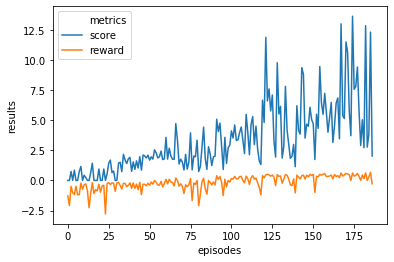

Max Train Score 28 Max Test Score 29
Mean Train Score 3.3121499838475574 Mean Test Score 6.832304596845016
----------------------------------------------------------------------------------------------------
Learning Rate 0.0007324113295818563


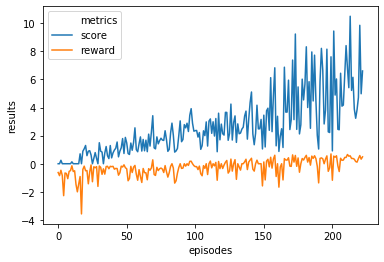

Max Train Score 21 Max Test Score 25
Mean Train Score 2.6343583002562236 Mean Test Score 5.2671039086874725
----------------------------------------------------------------------------------------------------
Learning Rate 0.0005751234335084797


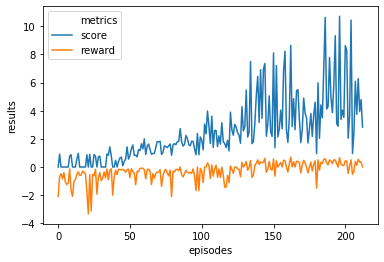

Max Train Score 22 Max Test Score 28
Mean Train Score 2.4927857334470933 Mean Test Score 5.4216762292395195
----------------------------------------------------------------------------------------------------
Learning Rate 0.0011258697051459707


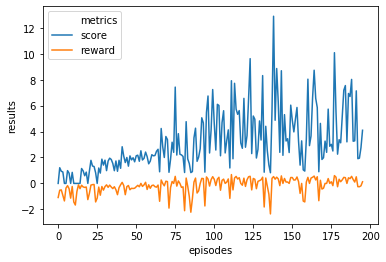

Max Train Score 24 Max Test Score 28
Mean Train Score 3.1567151514371194 Mean Test Score 5.617946013053851
----------------------------------------------------------------------------------------------------
Learning Rate 0.0006475592301496779


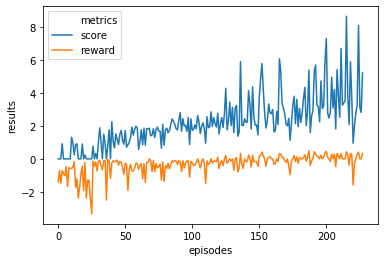

Max Train Score 14 Max Test Score 20
Mean Train Score 2.1989122471114624 Mean Test Score 4.143110619281836
----------------------------------------------------------------------------------------------------
Learning Rate 0.0014561709343096653


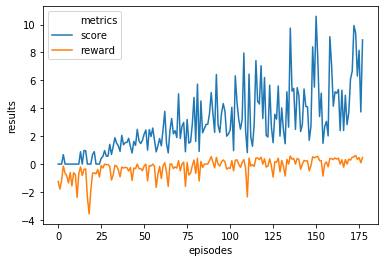

Max Train Score 23 Max Test Score 21
Mean Train Score 2.9283444371017344 Mean Test Score 5.554171242857847
----------------------------------------------------------------------------------------------------
Learning Rate 0.0015139909977083294


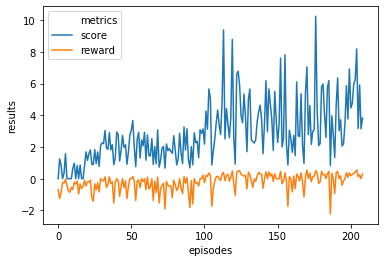

Max Train Score 18 Max Test Score 20
Mean Train Score 2.839293719558158 Mean Test Score 4.849172673309573
----------------------------------------------------------------------------------------------------
Learning Rate 0.0016336688282038616


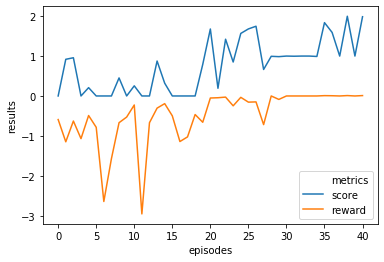

Max Train Score 2 Max Test Score 1
Mean Train Score 0.7514081175139035 Mean Test Score 0.9950298210735586
----------------------------------------------------------------------------------------------------
Learning Rate 0.0002857815237578513


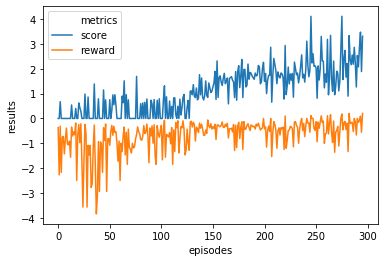

Max Train Score 7 Max Test Score 12
Mean Train Score 1.1184828616397815 Mean Test Score 2.4076667804691128
----------------------------------------------------------------------------------------------------
Learning Rate 0.00030171098145664584


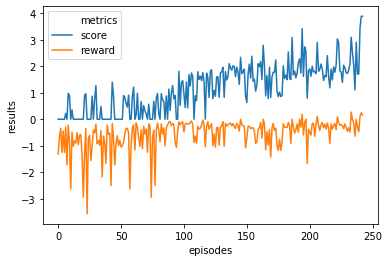

Max Train Score 8 Max Test Score 10
Mean Train Score 1.1599928625980755 Mean Test Score 2.527704975455553
----------------------------------------------------------------------------------------------------


In [ ]:
for learning_rate, result in results.items():
    metrics, max_train_score, max_test_score, mean_train_score, mean_test_score = result
    
    print("Learning Rate", learning_rate)
    plot_metrics(metrics)    
    print("Max Train Score", max_train_score, "Max Test Score", max_test_score)
    print("Mean Train Score", mean_train_score, "Mean Test Score", mean_test_score)
    print("-"*100)

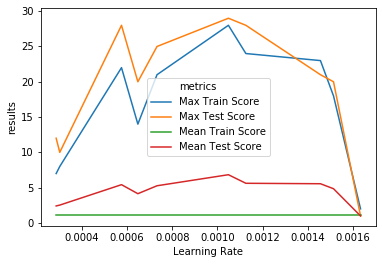

In [ ]:
plot_max_results(results,'Learning Rate')

#### Result: the range (0.0005,0.002) seems good

## Learning Rate range (0.0005,0.0014)

In [ ]:
results = {}
for _ in range(10):
    # enable_render=True turns on the display
    snake_env = SnakeEnv(440, 440, enable_render=False)
    env = make_vec_env(lambda: snake_env, n_envs=1)

    #gamma = random.uniform(0.95, 1)
    learning_rate=random.uniform(0.0005,0.0014)
    #print("lr: ", learning_rate)
    
    model = A2C(MlpPolicy, env, verbose=1, learning_rate=learning_rate)#, seed=42)#, gamma=gamma)
    model.learn(total_timesteps=20000, log_interval=1000)

    # Print rewards and scores for each episode
    max_train_score = snake_env.record
    mean_train_score = np.mean(np.array(snake_env.results['score']))
    max_test_score, mean_test_score = evaluate(model)
    
    results[learning_rate] = (snake_env.results, max_train_score, max_test_score, mean_train_score, mean_test_score)

Using cpu device
-------------------------------------
| rollout/              |           |
|    ep_len_mean        | 65.7      |
|    ep_rew_mean        | -30.8     |
| time/                 |           |
|    fps                | 417       |
|    iterations         | 1000      |
|    time_elapsed       | 11        |
|    total_timesteps    | 5000      |
| train/                |           |
|    entropy_loss       | -0.451    |
|    explained_variance | -1.66e+03 |
|    learning_rate      | 0.000896  |
|    n_updates          | 999       |
|    policy_loss        | -12.9     |
|    value_loss         | 1.62e+03  |
-------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 68.2     |
|    ep_rew_mean        | -12      |
| time/                 |          |
|    fps                | 416      |
|    iterations         | 2000     |
|    time_elapsed       | 24       |
|    total_timesteps    | 10000    |
| tr

------------------------------------
| rollout/              |          |
|    ep_len_mean        | 83.5     |
|    ep_rew_mean        | -36      |
| time/                 |          |
|    fps                | 428      |
|    iterations         | 2000     |
|    time_elapsed       | 23       |
|    total_timesteps    | 10000    |
| train/                |          |
|    entropy_loss       | -0.531   |
|    explained_variance | -8.07    |
|    learning_rate      | 0.000539 |
|    n_updates          | 1999     |
|    policy_loss        | 0.106    |
|    value_loss         | 22.7     |
------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 70.5     |
|    ep_rew_mean        | -9.2     |
| time/                 |          |
|    fps                | 427      |
|    iterations         | 3000     |
|    time_elapsed       | 35       |
|    total_timesteps    | 15000    |
| train/                |          |
|

------------------------------------
| rollout/              |          |
|    ep_len_mean        | 66.4     |
|    ep_rew_mean        | -6.2     |
| time/                 |          |
|    fps                | 424      |
|    iterations         | 3000     |
|    time_elapsed       | 35       |
|    total_timesteps    | 15000    |
| train/                |          |
|    entropy_loss       | -0.263   |
|    explained_variance | 0.618    |
|    learning_rate      | 0.000703 |
|    n_updates          | 2999     |
|    policy_loss        | 0.0162   |
|    value_loss         | 2.53     |
------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 85.2     |
|    ep_rew_mean        | 13.2     |
| time/                 |          |
|    fps                | 423      |
|    iterations         | 4000     |
|    time_elapsed       | 47       |
|    total_timesteps    | 20000    |
| train/                |          |
|

-------------------------------------
| rollout/              |           |
|    ep_len_mean        | 94.3      |
|    ep_rew_mean        | 16.7      |
| time/                 |           |
|    fps                | 423       |
|    iterations         | 4000      |
|    time_elapsed       | 47        |
|    total_timesteps    | 20000     |
| train/                |           |
|    entropy_loss       | -6.31e-05 |
|    explained_variance | nan       |
|    learning_rate      | 0.00102   |
|    n_updates          | 3999      |
|    policy_loss        | -3.81e-06 |
|    value_loss         | 0.778     |
-------------------------------------


Learning Rate 0.0008961501988583647


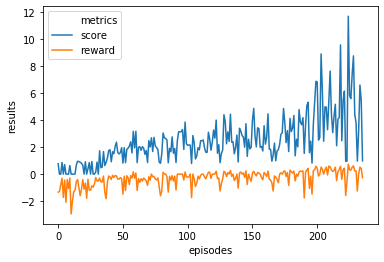

Max Train Score 23 Max Test Score 17
Mean Train Score 2.4544116781136194 Mean Test Score 3.576126472981282
----------------------------------------------------------------------------------------------------
Learning Rate 0.00104674599210108


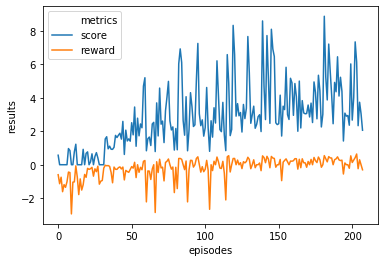

Max Train Score 16 Max Test Score 24
Mean Train Score 2.8550474182783763 Mean Test Score 4.298887911914875
----------------------------------------------------------------------------------------------------
Learning Rate 0.0005537143101696532


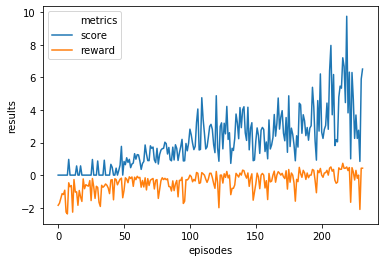

Max Train Score 16 Max Test Score 22
Mean Train Score 2.06641066694255 Mean Test Score 4.5836680387607895
----------------------------------------------------------------------------------------------------
Learning Rate 0.0005388008688384392


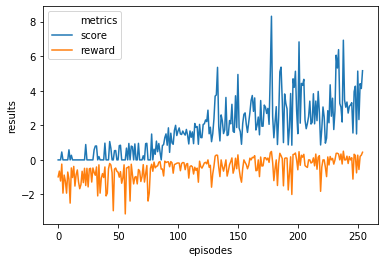

Max Train Score 17 Max Test Score 18
Mean Train Score 1.7928600767867109 Mean Test Score 3.918316051425061
----------------------------------------------------------------------------------------------------
Learning Rate 0.0010642069468577895


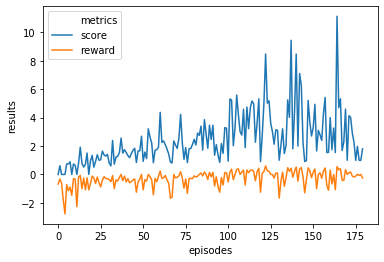

Max Train Score 20 Max Test Score 2
Mean Train Score 2.4604194372627766 Mean Test Score 1.388186038662839
----------------------------------------------------------------------------------------------------
Learning Rate 0.0006188421256312186


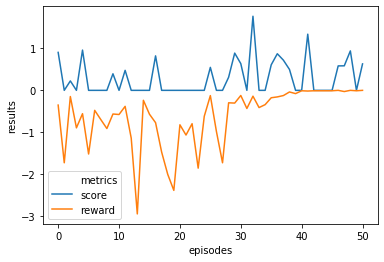

Max Train Score 2 Max Test Score 0
Mean Train Score 0.2879813648219667 Mean Test Score 0.0
----------------------------------------------------------------------------------------------------
Learning Rate 0.0007027590065810225


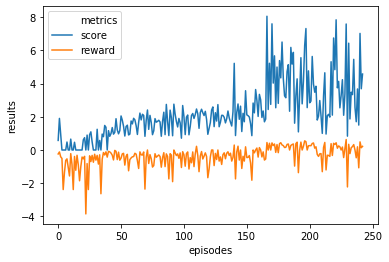

Max Train Score 15 Max Test Score 17
Mean Train Score 2.255345928444662 Mean Test Score 3.6729345012796197
----------------------------------------------------------------------------------------------------
Learning Rate 0.0007397078218237594


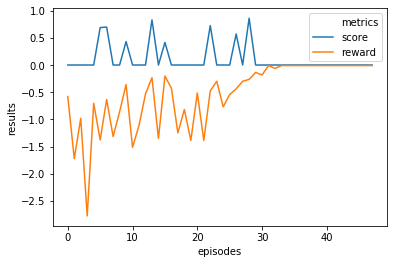

Max Train Score 1 Max Test Score 0
Mean Train Score 0.10886873989048612 Mean Test Score 0.0
----------------------------------------------------------------------------------------------------
Learning Rate 0.0010061679565551709


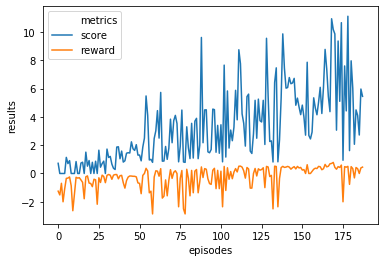

Max Train Score 24 Max Test Score 31
Mean Train Score 3.2579725287970382 Mean Test Score 7.460738420268158
----------------------------------------------------------------------------------------------------
Learning Rate 0.0010163623754524688


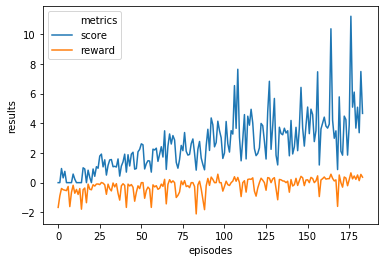

Max Train Score 22 Max Test Score 22
Mean Train Score 2.588030859837514 Mean Test Score 4.5475397222545535
----------------------------------------------------------------------------------------------------


In [ ]:
for learning_rate, result in results.items():
    metrics, max_train_score, max_test_score, mean_train_score, mean_test_score = result
    
    print("Learning Rate", learning_rate)
    plot_metrics(metrics)    
    print("Max Train Score", max_train_score, "Max Test Score", max_test_score)
    print("Mean Train Score", mean_train_score, "Mean Test Score", mean_test_score)
    print("-"*100)

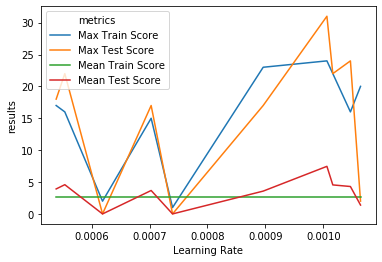

In [ ]:
plot_max_results(results,'Learning Rate')

#### Result: value between 0.001 and 0.0012 seems good

## Learning Rate with fixed value

In [ ]:
#those values seemed good during the tests
learning_rates=[0.0009610612889534735,0.0013779226379577784,0.0013197979371411934,0.001,0.0015,0.0018,0.002,0.00095,0.00092,0.0009,0.00085,0.00082,0.0008]

results = {}
for learning_rate in learning_rates:
    # enable_render=True turns on the display
    snake_env = SnakeEnv(440, 440, enable_render=False)
    env = make_vec_env(lambda: snake_env, n_envs=1)

    #gamma = random.uniform(0.95, 1)
    #learning_rate=random.uniform(0.0005,0.0014)
    #print("lr: ", learning_rate)
    
    model = A2C(MlpPolicy, env, verbose=1, learning_rate=learning_rate)#, seed=42)#, gamma=gamma)
    model.learn(total_timesteps=20000, log_interval=1000)

    # Print rewards and scores for each episode
    max_train_score = snake_env.record
    mean_train_score = np.mean(np.array(snake_env.results['score']))
    max_test_score, mean_test_score = evaluate(model)
    
    results[learning_rate] = (snake_env.results, max_train_score, max_test_score, mean_train_score, mean_test_score)

Using cpu device
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 81.8     |
|    ep_rew_mean        | -32.1    |
| time/                 |          |
|    fps                | 421      |
|    iterations         | 1000     |
|    time_elapsed       | 11       |
|    total_timesteps    | 5000     |
| train/                |          |
|    entropy_loss       | -0.357   |
|    explained_variance | -6.38    |
|    learning_rate      | 0.000961 |
|    n_updates          | 999      |
|    policy_loss        | 0.357    |
|    value_loss         | 29.7     |
------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 67.4     |
|    ep_rew_mean        | -4.8     |
| time/                 |          |
|    fps                | 420      |
|    iterations         | 2000     |
|    time_elapsed       | 23       |
|    total_timesteps    | 10000    |
| train/             

------------------------------------
| rollout/              |          |
|    ep_len_mean        | 76.8     |
|    ep_rew_mean        | -21.2    |
| time/                 |          |
|    fps                | 408      |
|    iterations         | 2000     |
|    time_elapsed       | 24       |
|    total_timesteps    | 10000    |
| train/                |          |
|    entropy_loss       | -0.17    |
|    explained_variance | -0.052   |
|    learning_rate      | 0.001    |
|    n_updates          | 1999     |
|    policy_loss        | 0.0088   |
|    value_loss         | 0.0322   |
------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 82.8     |
|    ep_rew_mean        | -12.2    |
| time/                 |          |
|    fps                | 406      |
|    iterations         | 3000     |
|    time_elapsed       | 36       |
|    total_timesteps    | 15000    |
| train/                |          |
|

-------------------------------------
| rollout/              |           |
|    ep_len_mean        | 92.1      |
|    ep_rew_mean        | 12.8      |
| time/                 |           |
|    fps                | 426       |
|    iterations         | 3000      |
|    time_elapsed       | 35        |
|    total_timesteps    | 15000     |
| train/                |           |
|    entropy_loss       | -0.0101   |
|    explained_variance | -5.19e+10 |
|    learning_rate      | 0.002     |
|    n_updates          | 2999      |
|    policy_loss        | -0.000615 |
|    value_loss         | 0.264     |
-------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 106      |
|    ep_rew_mean        | 21.1     |
| time/                 |          |
|    fps                | 424      |
|    iterations         | 4000     |
|    time_elapsed       | 47       |
|    total_timesteps    | 20000    |
| train/             

------------------------------------
| rollout/              |          |
|    ep_len_mean        | 87.8     |
|    ep_rew_mean        | -7.2     |
| time/                 |          |
|    fps                | 438      |
|    iterations         | 4000     |
|    time_elapsed       | 45       |
|    total_timesteps    | 20000    |
| train/                |          |
|    entropy_loss       | -0.0179  |
|    explained_variance | -4.39    |
|    learning_rate      | 0.0009   |
|    n_updates          | 3999     |
|    policy_loss        | -0.00157 |
|    value_loss         | 0.181    |
------------------------------------
Using cpu device
-------------------------------------
| rollout/              |           |
|    ep_len_mean        | 131       |
|    ep_rew_mean        | -45.4     |
| time/                 |           |
|    fps                | 405       |
|    iterations         | 1000      |
|    time_elapsed       | 12        |
|    total_timesteps    | 5000      |
| train/    

Learning Rate 0.0009610612889534735


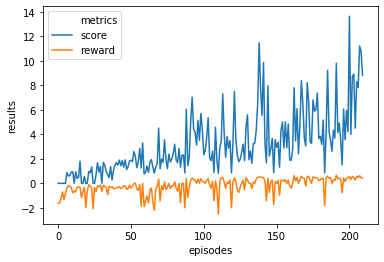

Max Train Score 27 Max Test Score 30
Mean Train Score 3.1450003332966348 Mean Test Score 7.980717028678105
----------------------------------------------------------------------------------------------------
Learning Rate 0.0013779226379577784


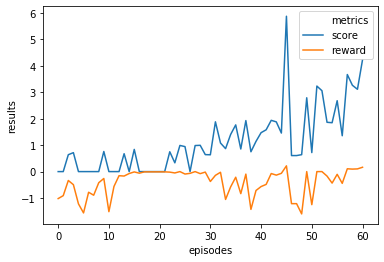

Max Train Score 10 Max Test Score 11
Mean Train Score 1.1386953170166034 Mean Test Score 2.9356534173153364
----------------------------------------------------------------------------------------------------
Learning Rate 0.0013197979371411934


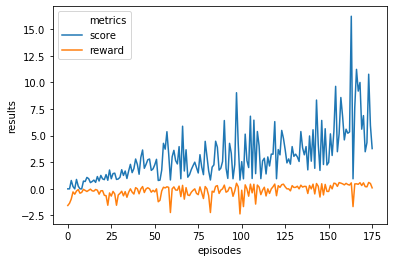

Max Train Score 31 Max Test Score 33
Mean Train Score 3.065887042756423 Mean Test Score 6.65638952506762
----------------------------------------------------------------------------------------------------
Learning Rate 0.001


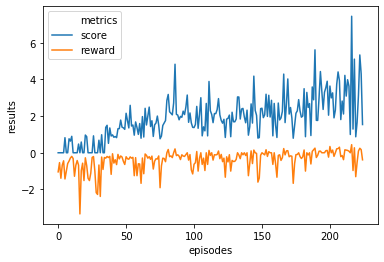

Max Train Score 15 Max Test Score 15
Mean Train Score 1.875353493333443 Mean Test Score 3.6543156767010694
----------------------------------------------------------------------------------------------------
Learning Rate 0.0015


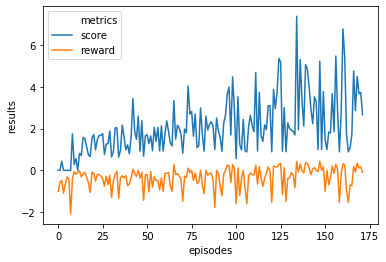

Max Train Score 14 Max Test Score 10
Mean Train Score 2.0714517400547403 Mean Test Score 2.3506823976326126
----------------------------------------------------------------------------------------------------
Learning Rate 0.0018


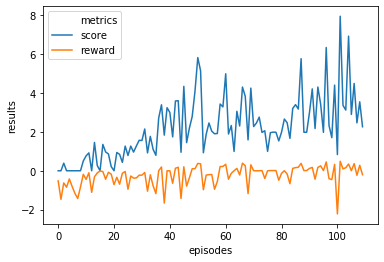

Max Train Score 16 Max Test Score 15
Mean Train Score 2.207157656797512 Mean Test Score 4.294160470530515
----------------------------------------------------------------------------------------------------
Learning Rate 0.002


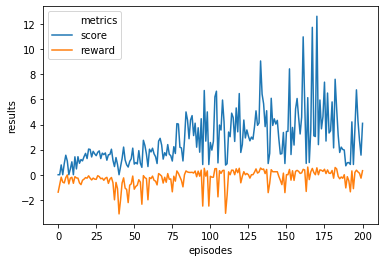

Max Train Score 23 Max Test Score 14
Mean Train Score 2.8421161411388525 Mean Test Score 2.971344659125783
----------------------------------------------------------------------------------------------------
Learning Rate 0.00095


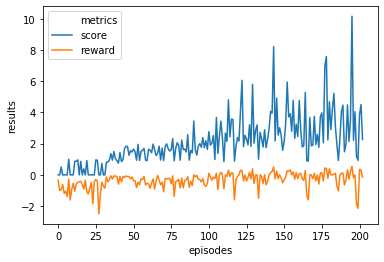

Max Train Score 20 Max Test Score 20
Mean Train Score 2.0948986818431927 Mean Test Score 4.350658443860332
----------------------------------------------------------------------------------------------------
Learning Rate 0.00092


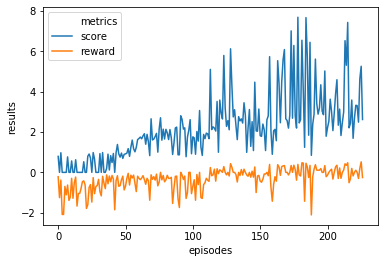

Max Train Score 15 Max Test Score 21
Mean Train Score 2.1687251541209585 Mean Test Score 4.124829808000654
----------------------------------------------------------------------------------------------------
Learning Rate 0.0009


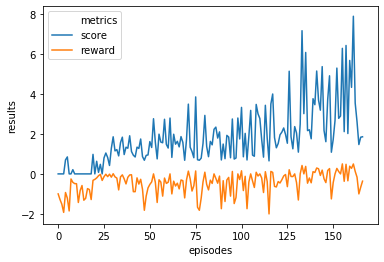

Max Train Score 16 Max Test Score 16
Mean Train Score 1.833452239337325 Mean Test Score 3.817576217192027
----------------------------------------------------------------------------------------------------
Learning Rate 0.00085


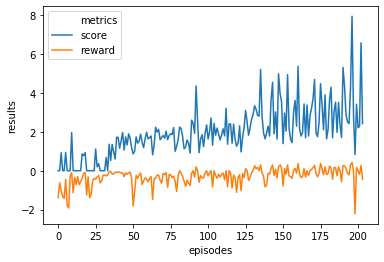

Max Train Score 16 Max Test Score 22
Mean Train Score 1.9537436588498067 Mean Test Score 3.674736966158811
----------------------------------------------------------------------------------------------------
Learning Rate 0.00082


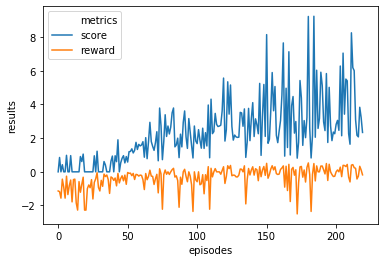

Max Train Score 20 Max Test Score 18
Mean Train Score 2.327946432387875 Mean Test Score 4.456038138014246
----------------------------------------------------------------------------------------------------
Learning Rate 0.0008


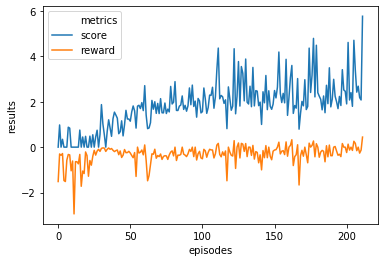

Max Train Score 12 Max Test Score 16
Mean Train Score 1.8356549911629723 Mean Test Score 2.6804185092284607
----------------------------------------------------------------------------------------------------


In [ ]:
for learning_rate, result in results.items():
    metrics, max_train_score, max_test_score, mean_train_score, mean_test_score = result
    
    print("Learning Rate", learning_rate)
    plot_metrics(metrics)    
    print("Max Train Score", max_train_score, "Max Test Score", max_test_score)
    print("Mean Train Score", mean_train_score, "Mean Test Score", mean_test_score)
    print("-"*100)

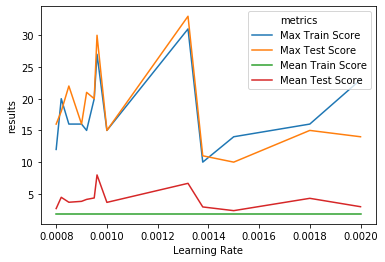

In [ ]:
plot_max_results(results,'Learning Rate')

#### Result: 0.001 seems a good value

## Learning Rate with fixed value and gamma=0.97

In [ ]:
learning_rates=[0.0009610612889534735,0.0013779226379577784,0.0013197979371411934,0.001,0.0015,0.0018,0.002,0.00095,0.00092,0.0009,0.00085,0.00082,0.0008]

results = {}
for learning_rate in learning_rates:
    # enable_render=True turns on the display
    snake_env = SnakeEnv(440, 440, enable_render=False)
    env = make_vec_env(lambda: snake_env, n_envs=1)

    #gamma = random.uniform(0.95, 1)
    #learning_rate=random.uniform(0.0005,0.0014)
    #print("lr: ", learning_rate)
    
    model = A2C(MlpPolicy, env, verbose=1, learning_rate=learning_rate,gamma=0.97)#, seed=42)#, gamma=gamma)
    model.learn(total_timesteps=20000, log_interval=1000)

    # Print rewards and scores for each episode
    max_train_score = snake_env.record
    mean_train_score = np.mean(np.array(snake_env.results['score']))
    max_test_score, mean_test_score = evaluate(model)
    
    results[learning_rate] = (snake_env.results, max_train_score, max_test_score, mean_train_score, mean_test_score)

Using cpu device
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 74.5     |
|    ep_rew_mean        | -34.6    |
| time/                 |          |
|    fps                | 407      |
|    iterations         | 1000     |
|    time_elapsed       | 12       |
|    total_timesteps    | 5000     |
| train/                |          |
|    entropy_loss       | -0.441   |
|    explained_variance | -18.8    |
|    learning_rate      | 0.000961 |
|    n_updates          | 999      |
|    policy_loss        | -0.0413  |
|    value_loss         | 35.8     |
------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 80.6     |
|    ep_rew_mean        | -5       |
| time/                 |          |
|    fps                | 415      |
|    iterations         | 2000     |
|    time_elapsed       | 24       |
|    total_timesteps    | 10000    |
| train/             

------------------------------------
| rollout/              |          |
|    ep_len_mean        | 86.3     |
|    ep_rew_mean        | -14.9    |
| time/                 |          |
|    fps                | 430      |
|    iterations         | 2000     |
|    time_elapsed       | 23       |
|    total_timesteps    | 10000    |
| train/                |          |
|    entropy_loss       | -0.224   |
|    explained_variance | -53.7    |
|    learning_rate      | 0.001    |
|    n_updates          | 1999     |
|    policy_loss        | -0.0363  |
|    value_loss         | 30.8     |
------------------------------------
-------------------------------------
| rollout/              |           |
|    ep_len_mean        | 93.6      |
|    ep_rew_mean        | 20.5      |
| time/                 |           |
|    fps                | 430       |
|    iterations         | 3000      |
|    time_elapsed       | 34        |
|    total_timesteps    | 15000     |
| train/                |    

-------------------------------------
| rollout/              |           |
|    ep_len_mean        | 91.1      |
|    ep_rew_mean        | 17        |
| time/                 |           |
|    fps                | 425       |
|    iterations         | 3000      |
|    time_elapsed       | 35        |
|    total_timesteps    | 15000     |
| train/                |           |
|    entropy_loss       | -0.000875 |
|    explained_variance | 0.776     |
|    learning_rate      | 0.002     |
|    n_updates          | 2999      |
|    policy_loss        | -2.37e-05 |
|    value_loss         | 0.378     |
-------------------------------------
-------------------------------------
| rollout/              |           |
|    ep_len_mean        | 111       |
|    ep_rew_mean        | 34.3      |
| time/                 |           |
|    fps                | 428       |
|    iterations         | 4000      |
|    time_elapsed       | 46        |
|    total_timesteps    | 20000     |
| train/    

------------------------------------
| rollout/              |          |
|    ep_len_mean        | 90.9     |
|    ep_rew_mean        | 12.8     |
| time/                 |          |
|    fps                | 422      |
|    iterations         | 4000     |
|    time_elapsed       | 47       |
|    total_timesteps    | 20000    |
| train/                |          |
|    entropy_loss       | -0.00874 |
|    explained_variance | -1.32    |
|    learning_rate      | 0.0009   |
|    n_updates          | 3999     |
|    policy_loss        | -0.001   |
|    value_loss         | 1.17     |
------------------------------------
Using cpu device
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 114      |
|    ep_rew_mean        | -41.9    |
| time/                 |          |
|    fps                | 409      |
|    iterations         | 1000     |
|    time_elapsed       | 12       |
|    total_timesteps    | 5000     |
| train/             

Learning Rate 0.0009610612889534735


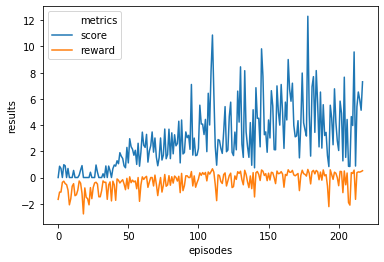

Max Train Score 22 Max Test Score 22
Mean Train Score 3.0278897829748828 Mean Test Score 5.076773522098743
----------------------------------------------------------------------------------------------------
Learning Rate 0.0013779226379577784


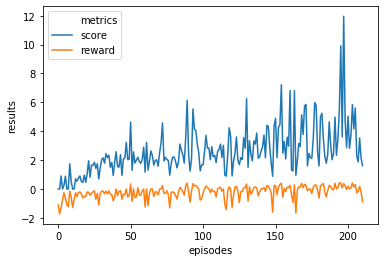

Max Train Score 24 Max Test Score 20
Mean Train Score 2.606984288211742 Mean Test Score 3.956629330917982
----------------------------------------------------------------------------------------------------
Learning Rate 0.0013197979371411934


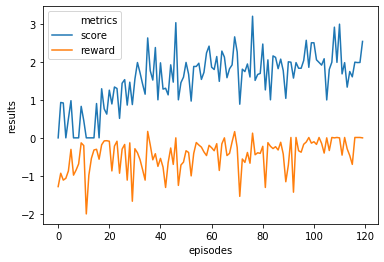

Max Train Score 6 Max Test Score 5
Mean Train Score 1.558373743051216 Mean Test Score 1.999159145204466
----------------------------------------------------------------------------------------------------
Learning Rate 0.001


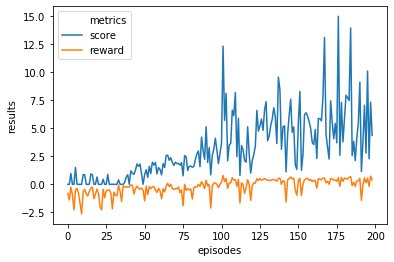

Max Train Score 27 Max Test Score 30
Mean Train Score 3.1765791921828423 Mean Test Score 5.581266073132615
----------------------------------------------------------------------------------------------------
Learning Rate 0.0015


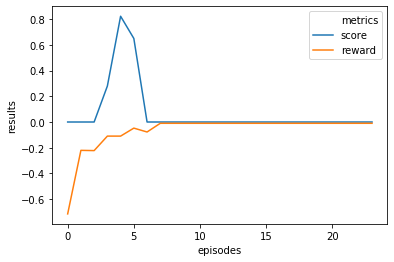

Max Train Score 1 Max Test Score 0
Mean Train Score 0.0729415405665141 Mean Test Score 0.0
----------------------------------------------------------------------------------------------------
Learning Rate 0.0018


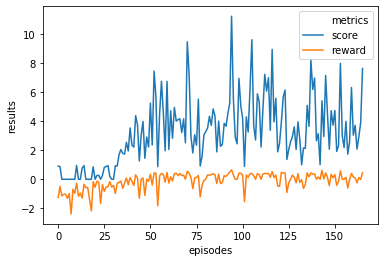

Max Train Score 20 Max Test Score 28
Mean Train Score 3.1859204233701677 Mean Test Score 5.842670956444549
----------------------------------------------------------------------------------------------------
Learning Rate 0.002


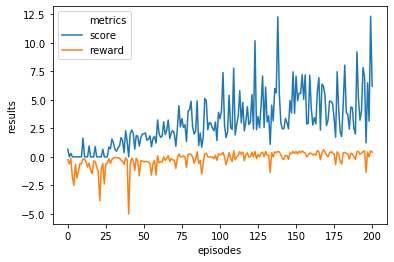

Max Train Score 23 Max Test Score 26
Mean Train Score 3.0339012287622933 Mean Test Score 5.1284479271197885
----------------------------------------------------------------------------------------------------
Learning Rate 0.00095


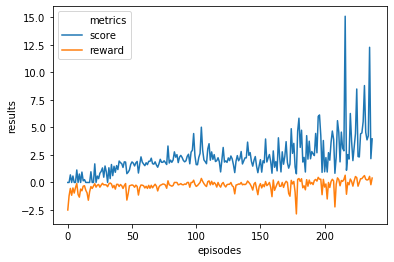

Max Train Score 28 Max Test Score 29
Mean Train Score 2.2632113279101405 Mean Test Score 5.280135781889476
----------------------------------------------------------------------------------------------------
Learning Rate 0.00092


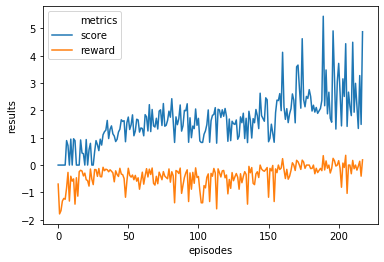

Max Train Score 10 Max Test Score 14
Mean Train Score 1.653264404269905 Mean Test Score 2.8173548123981393
----------------------------------------------------------------------------------------------------
Learning Rate 0.0009


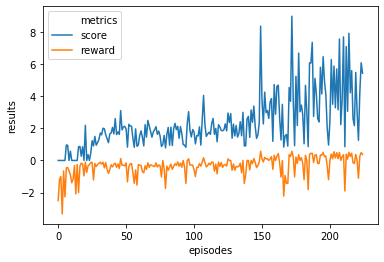

Max Train Score 16 Max Test Score 21
Mean Train Score 2.346632649466135 Mean Test Score 4.3086811502028945
----------------------------------------------------------------------------------------------------
Learning Rate 0.00085


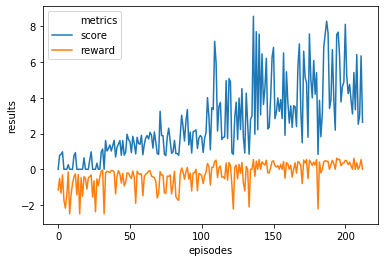

Max Train Score 16 Max Test Score 25
Mean Train Score 2.6628957926918435 Mean Test Score 5.8222901262877
----------------------------------------------------------------------------------------------------
Learning Rate 0.00082


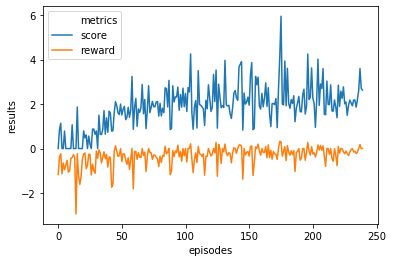

Max Train Score 12 Max Test Score 13
Mean Train Score 1.8831569160708241 Mean Test Score 2.829978969042862
----------------------------------------------------------------------------------------------------
Learning Rate 0.0008


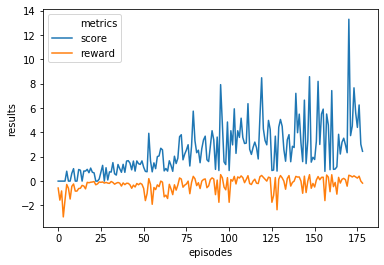

Max Train Score 26 Max Test Score 20
Mean Train Score 2.532724788832816 Mean Test Score 5.0232734090189695
----------------------------------------------------------------------------------------------------


In [ ]:
for learning_rate, result in results.items():
    metrics, max_train_score, max_test_score, mean_train_score, mean_test_score = result
    
    print("Learning Rate", learning_rate)
    plot_metrics(metrics)    
    print("Max Train Score", max_train_score, "Max Test Score", max_test_score)
    print("Mean Train Score", mean_train_score, "Mean Test Score", mean_test_score)
    print("-"*100)

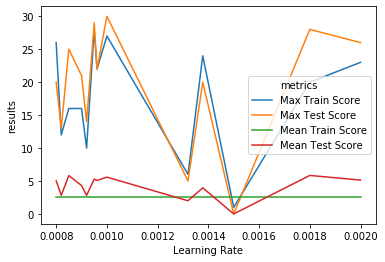

In [ ]:
plot_max_results(results,'Learning Rate')

#### 0.0015 seems a good value

## Learning Rate with fixed value and gamma=0.97 observed for 10 times

Using cpu device
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 71.2     |
|    ep_rew_mean        | -30.1    |
| time/                 |          |
|    fps                | 415      |
|    iterations         | 1000     |
|    time_elapsed       | 12       |
|    total_timesteps    | 5000     |
| train/                |          |
|    entropy_loss       | -0.215   |
|    explained_variance | -4.32    |
|    learning_rate      | 0.000961 |
|    n_updates          | 999      |
|    policy_loss        | 0.0563   |
|    value_loss         | 35.7     |
------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 74.5     |
|    ep_rew_mean        | -3.2     |
| time/                 |          |
|    fps                | 420      |
|    iterations         | 2000     |
|    time_elapsed       | 23       |
|    total_timesteps    | 10000    |
| train/             

------------------------------------
| rollout/              |          |
|    ep_len_mean        | 85.2     |
|    ep_rew_mean        | 1        |
| time/                 |          |
|    fps                | 420      |
|    iterations         | 2000     |
|    time_elapsed       | 23       |
|    total_timesteps    | 10000    |
| train/                |          |
|    entropy_loss       | -0.162   |
|    explained_variance | 0.396    |
|    learning_rate      | 0.001    |
|    n_updates          | 1999     |
|    policy_loss        | 0.00474  |
|    value_loss         | 11.5     |
------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 109      |
|    ep_rew_mean        | 34.4     |
| time/                 |          |
|    fps                | 420      |
|    iterations         | 3000     |
|    time_elapsed       | 35       |
|    total_timesteps    | 15000    |
| train/                |          |
|

-------------------------------------
| rollout/              |           |
|    ep_len_mean        | 875       |
|    ep_rew_mean        | -17.1     |
| time/                 |           |
|    fps                | 447       |
|    iterations         | 3000      |
|    time_elapsed       | 33        |
|    total_timesteps    | 15000     |
| train/                |           |
|    entropy_loss       | -9.59e-05 |
|    explained_variance | -0.717    |
|    learning_rate      | 0.002     |
|    n_updates          | 2999      |
|    policy_loss        | 2.22e-10  |
|    value_loss         | 1.98e-05  |
-------------------------------------
-------------------------------------
| rollout/              |           |
|    ep_len_mean        | 904       |
|    ep_rew_mean        | -15.5     |
| time/                 |           |
|    fps                | 447       |
|    iterations         | 4000      |
|    time_elapsed       | 44        |
|    total_timesteps    | 20000     |
| train/    

------------------------------------
| rollout/              |          |
|    ep_len_mean        | 115      |
|    ep_rew_mean        | 1.7      |
| time/                 |          |
|    fps                | 423      |
|    iterations         | 4000     |
|    time_elapsed       | 47       |
|    total_timesteps    | 20000    |
| train/                |          |
|    entropy_loss       | -0.232   |
|    explained_variance | -1.7e+03 |
|    learning_rate      | 0.0009   |
|    n_updates          | 3999     |
|    policy_loss        | -55.1    |
|    value_loss         | 1.01e+03 |
------------------------------------
Using cpu device
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 111      |
|    ep_rew_mean        | -42      |
| time/                 |          |
|    fps                | 432      |
|    iterations         | 1000     |
|    time_elapsed       | 11       |
|    total_timesteps    | 5000     |
| train/             

Learning Rate 0.0009610612889534735


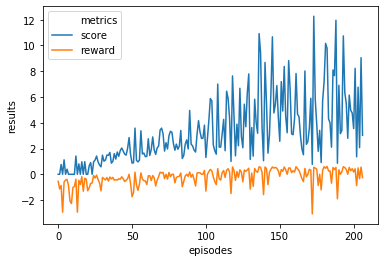

Max Train Score 24 Max Test Score 27
Mean Train Score 3.2567403901509606 Mean Test Score 7.533071438580753
----------------------------------------------------------------------------------------------------
Learning Rate 0.0013779226379577784


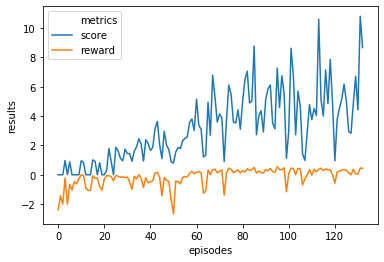

Max Train Score 20 Max Test Score 19
Mean Train Score 3.1590620167965877 Mean Test Score 5.014294314608481
----------------------------------------------------------------------------------------------------
Learning Rate 0.0013197979371411934


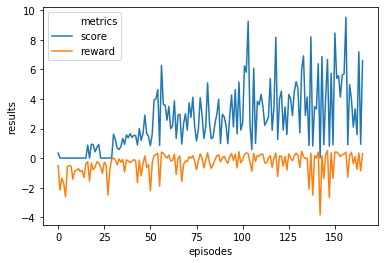

Max Train Score 18 Max Test Score 25
Mean Train Score 2.6153739406831047 Mean Test Score 4.247837686623141
----------------------------------------------------------------------------------------------------
Learning Rate 0.001


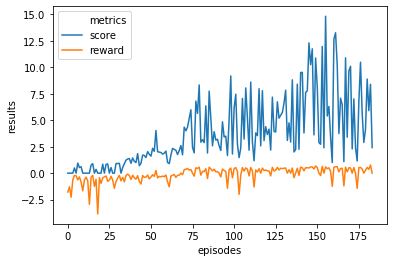

Max Train Score 30 Max Test Score 30
Mean Train Score 3.7504140910815376 Mean Test Score 6.4574066743014535
----------------------------------------------------------------------------------------------------
Learning Rate 0.0015


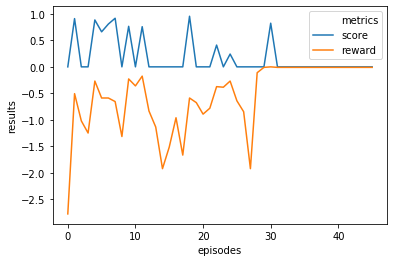

Max Train Score 1 Max Test Score 0
Mean Train Score 0.1770361017335054 Mean Test Score 0.0
----------------------------------------------------------------------------------------------------
Learning Rate 0.0018


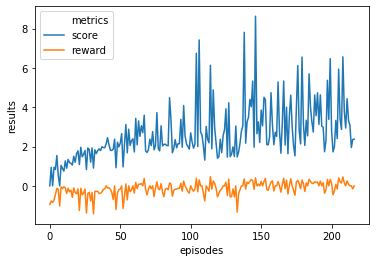

Max Train Score 16 Max Test Score 5
Mean Train Score 2.6299797827765143 Mean Test Score 1.6413905796914745
----------------------------------------------------------------------------------------------------
Learning Rate 0.002


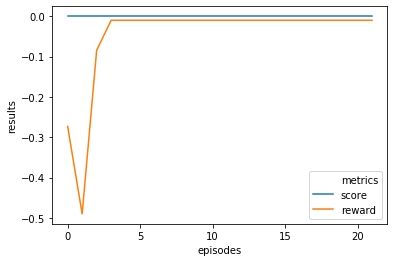

Max Train Score 0 Max Test Score 0
Mean Train Score 0.0 Mean Test Score 0.0
----------------------------------------------------------------------------------------------------
Learning Rate 0.00095


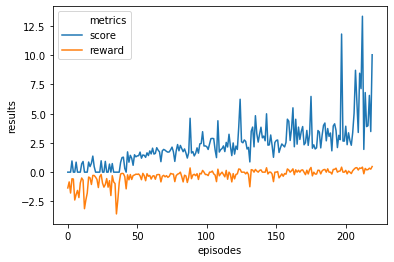

Max Train Score 24 Max Test Score 15
Mean Train Score 2.3527658370689246 Mean Test Score 3.631883970185461
----------------------------------------------------------------------------------------------------
Learning Rate 0.00092


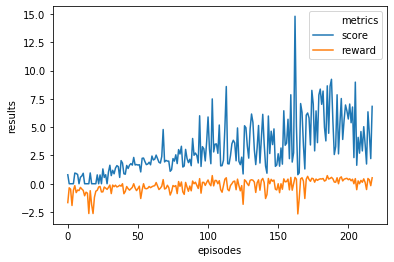

Max Train Score 26 Max Test Score 29
Mean Train Score 3.0871904126037952 Mean Test Score 5.726839470336932
----------------------------------------------------------------------------------------------------
Learning Rate 0.0009


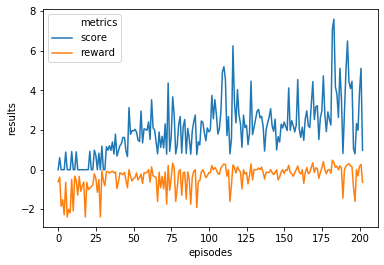

Max Train Score 13 Max Test Score 16
Mean Train Score 2.0518267033307613 Mean Test Score 3.51346209466926
----------------------------------------------------------------------------------------------------
Learning Rate 0.00085


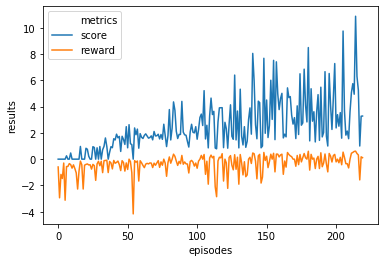

Max Train Score 19 Max Test Score 25
Mean Train Score 2.4672985947325277 Mean Test Score 4.878005007212284
----------------------------------------------------------------------------------------------------
Learning Rate 0.00082


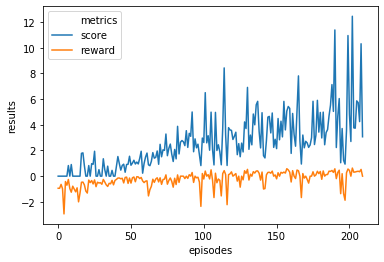

Max Train Score 24 Max Test Score 21
Mean Train Score 2.5871618358571347 Mean Test Score 3.6716109337877105
----------------------------------------------------------------------------------------------------
Learning Rate 0.0008


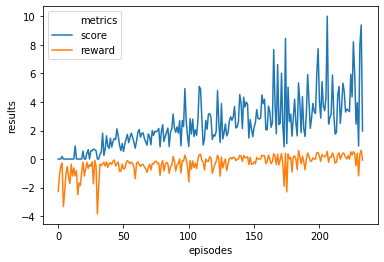

Max Train Score 19 Max Test Score 18
Mean Train Score 2.407847841206259 Mean Test Score 4.279553029426395
----------------------------------------------------------------------------------------------------
Learning rate max results  1


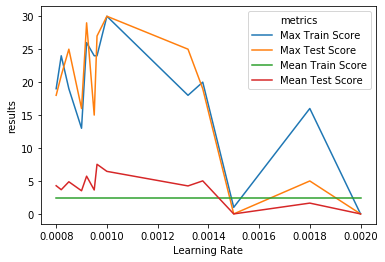

----------------------------------------------------------------------------------------------------
Using cpu device
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 99.2     |
|    ep_rew_mean        | -34      |
| time/                 |          |
|    fps                | 430      |
|    iterations         | 1000     |
|    time_elapsed       | 11       |
|    total_timesteps    | 5000     |
| train/                |          |
|    entropy_loss       | -0.426   |
|    explained_variance | 0.241    |
|    learning_rate      | 0.000961 |
|    n_updates          | 999      |
|    policy_loss        | 0.0418   |
|    value_loss         | 0.183    |
------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 70.7     |
|    ep_rew_mean        | -13      |
| time/                 |          |
|    fps                | 416      |
|    iterations         | 2000 

------------------------------------
| rollout/              |          |
|    ep_len_mean        | 92.6     |
|    ep_rew_mean        | -19.3    |
| time/                 |          |
|    fps                | 430      |
|    iterations         | 2000     |
|    time_elapsed       | 23       |
|    total_timesteps    | 10000    |
| train/                |          |
|    entropy_loss       | -0.316   |
|    explained_variance | -7.86    |
|    learning_rate      | 0.001    |
|    n_updates          | 1999     |
|    policy_loss        | 10.3     |
|    value_loss         | 144      |
------------------------------------
-------------------------------------
| rollout/              |           |
|    ep_len_mean        | 78.3      |
|    ep_rew_mean        | 4.5       |
| time/                 |           |
|    fps                | 427       |
|    iterations         | 3000      |
|    time_elapsed       | 35        |
|    total_timesteps    | 15000     |
| train/                |    

------------------------------------
| rollout/              |          |
|    ep_len_mean        | 508      |
|    ep_rew_mean        | -25.4    |
| time/                 |          |
|    fps                | 452      |
|    iterations         | 3000     |
|    time_elapsed       | 33       |
|    total_timesteps    | 15000    |
| train/                |          |
|    entropy_loss       | -0.0023  |
|    explained_variance | nan      |
|    learning_rate      | 0.002    |
|    n_updates          | 2999     |
|    policy_loss        | -6.7e-07 |
|    value_loss         | 9.06e-06 |
------------------------------------
-------------------------------------
| rollout/              |           |
|    ep_len_mean        | 567       |
|    ep_rew_mean        | -20.9     |
| time/                 |           |
|    fps                | 451       |
|    iterations         | 4000      |
|    time_elapsed       | 44        |
|    total_timesteps    | 20000     |
| train/                |    

-------------------------------------
| rollout/              |           |
|    ep_len_mean        | 111       |
|    ep_rew_mean        | 30        |
| time/                 |           |
|    fps                | 424       |
|    iterations         | 4000      |
|    time_elapsed       | 47        |
|    total_timesteps    | 20000     |
| train/                |           |
|    entropy_loss       | -0.000653 |
|    explained_variance | -5.07     |
|    learning_rate      | 0.0009    |
|    n_updates          | 3999      |
|    policy_loss        | -5.45e-05 |
|    value_loss         | 1.17      |
-------------------------------------
Using cpu device
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 113      |
|    ep_rew_mean        | -38      |
| time/                 |          |
|    fps                | 418      |
|    iterations         | 1000     |
|    time_elapsed       | 11       |
|    total_timesteps    | 5000     |
| tr

Learning Rate 0.0009610612889534735


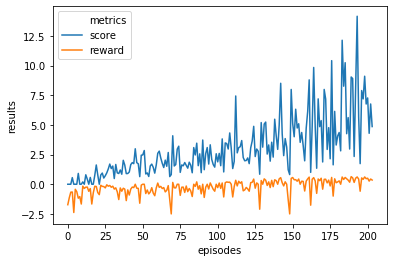

Max Train Score 28 Max Test Score 30
Mean Train Score 2.991751748920027 Mean Test Score 6.298558812090226
----------------------------------------------------------------------------------------------------
Learning Rate 0.0013779226379577784


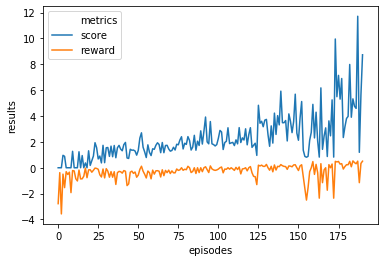

Max Train Score 23 Max Test Score 24
Mean Train Score 2.2924380072562167 Mean Test Score 5.475742291390256
----------------------------------------------------------------------------------------------------
Learning Rate 0.0013197979371411934


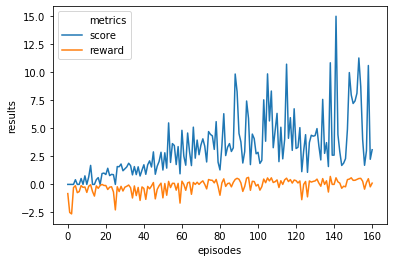

Max Train Score 28 Max Test Score 30
Mean Train Score 3.286666756463878 Mean Test Score 6.08440283018494
----------------------------------------------------------------------------------------------------
Learning Rate 0.001


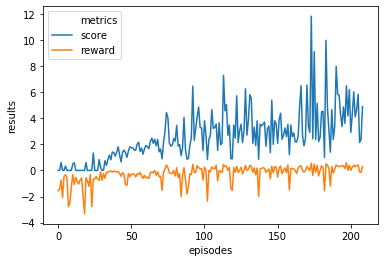

Max Train Score 22 Max Test Score 20
Mean Train Score 2.587366535476908 Mean Test Score 4.123814600236514
----------------------------------------------------------------------------------------------------
Learning Rate 0.0015


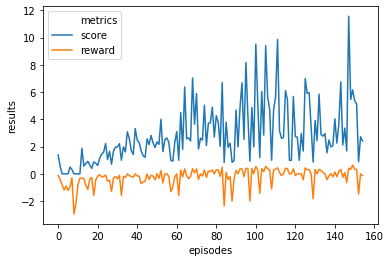

Max Train Score 22 Max Test Score 17
Mean Train Score 2.8754568612636318 Mean Test Score 3.670736703747948
----------------------------------------------------------------------------------------------------
Learning Rate 0.0018


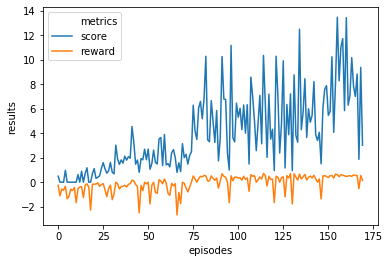

Max Train Score 26 Max Test Score 35
Mean Train Score 3.9276368263094676 Mean Test Score 7.847868049901267
----------------------------------------------------------------------------------------------------
Learning Rate 0.002


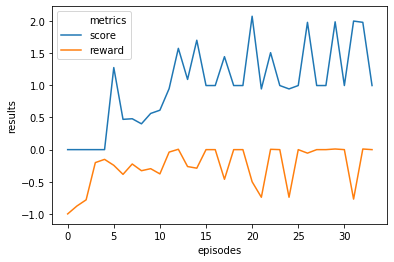

Max Train Score 3 Max Test Score 4
Mean Train Score 0.9988736668694987 Mean Test Score 1.246671415185829
----------------------------------------------------------------------------------------------------
Learning Rate 0.00095


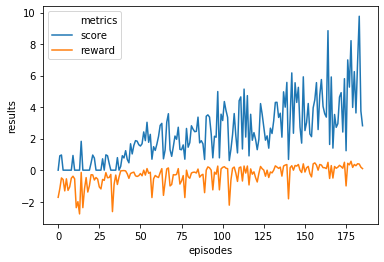

Max Train Score 18 Max Test Score 22
Mean Train Score 2.370902405892587 Mean Test Score 5.292627932546864
----------------------------------------------------------------------------------------------------
Learning Rate 0.00092


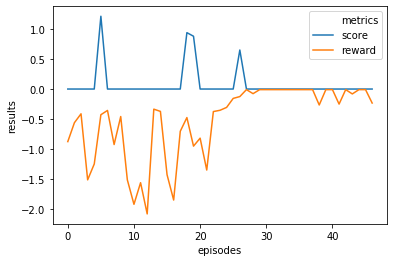

Max Train Score 2 Max Test Score 1
Mean Train Score 0.07843952514767448 Mean Test Score 0.08842756183745583
----------------------------------------------------------------------------------------------------
Learning Rate 0.0009


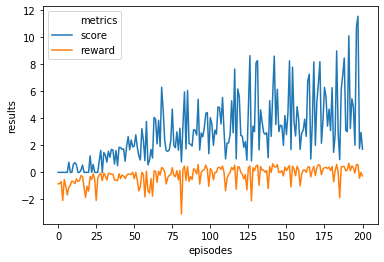

Max Train Score 23 Max Test Score 21
Mean Train Score 2.9929047646913904 Mean Test Score 5.16080890768723
----------------------------------------------------------------------------------------------------
Learning Rate 0.00085


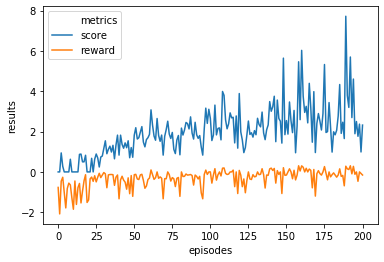

Max Train Score 15 Max Test Score 8
Mean Train Score 1.9683274136160742 Mean Test Score 2.119793168057467
----------------------------------------------------------------------------------------------------
Learning Rate 0.00082


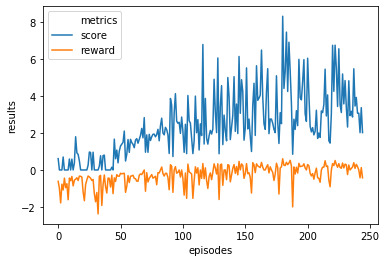

Max Train Score 18 Max Test Score 18
Mean Train Score 2.424398192433956 Mean Test Score 3.7556076051772727
----------------------------------------------------------------------------------------------------
Learning Rate 0.0008


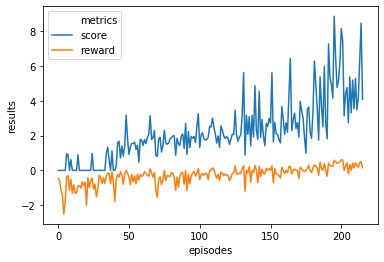

Max Train Score 17 Max Test Score 34
Mean Train Score 2.227268718939405 Mean Test Score 4.974040647764808
----------------------------------------------------------------------------------------------------
Learning rate max results  2


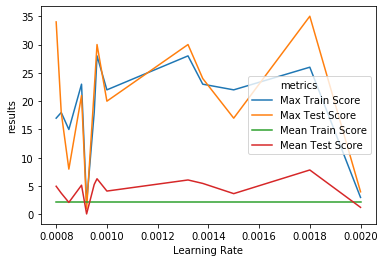

----------------------------------------------------------------------------------------------------
Using cpu device
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 217      |
|    ep_rew_mean        | -45.2    |
| time/                 |          |
|    fps                | 448      |
|    iterations         | 1000     |
|    time_elapsed       | 11       |
|    total_timesteps    | 5000     |
| train/                |          |
|    entropy_loss       | -0.0253  |
|    explained_variance | -0.584   |
|    learning_rate      | 0.000961 |
|    n_updates          | 999      |
|    policy_loss        | 1.16e-09 |
|    value_loss         | 6.22e-13 |
------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 368      |
|    ep_rew_mean        | -38.5    |
| time/                 |          |
|    fps                | 451      |
|    iterations         | 2000 

------------------------------------
| rollout/              |          |
|    ep_len_mean        | 86.9     |
|    ep_rew_mean        | -22.1    |
| time/                 |          |
|    fps                | 430      |
|    iterations         | 2000     |
|    time_elapsed       | 23       |
|    total_timesteps    | 10000    |
| train/                |          |
|    entropy_loss       | -0.024   |
|    explained_variance | 0.0356   |
|    learning_rate      | 0.001    |
|    n_updates          | 1999     |
|    policy_loss        | 2.42e-05 |
|    value_loss         | 0.0017   |
------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 99.2     |
|    ep_rew_mean        | -2.4     |
| time/                 |          |
|    fps                | 426      |
|    iterations         | 3000     |
|    time_elapsed       | 35       |
|    total_timesteps    | 15000    |
| train/                |          |
|

-------------------------------------
| rollout/              |           |
|    ep_len_mean        | 560       |
|    ep_rew_mean        | -29.6     |
| time/                 |           |
|    fps                | 458       |
|    iterations         | 3000      |
|    time_elapsed       | 32        |
|    total_timesteps    | 15000     |
| train/                |           |
|    entropy_loss       | -2.49e-05 |
|    explained_variance | nan       |
|    learning_rate      | 0.002     |
|    n_updates          | 2999      |
|    policy_loss        | -0        |
|    value_loss         | 0         |
-------------------------------------
-------------------------------------
| rollout/              |           |
|    ep_len_mean        | 633       |
|    ep_rew_mean        | -26.3     |
| time/                 |           |
|    fps                | 458       |
|    iterations         | 4000      |
|    time_elapsed       | 43        |
|    total_timesteps    | 20000     |
| train/    

-------------------------------------
| rollout/              |           |
|    ep_len_mean        | 121       |
|    ep_rew_mean        | 41.4      |
| time/                 |           |
|    fps                | 413       |
|    iterations         | 4000      |
|    time_elapsed       | 48        |
|    total_timesteps    | 20000     |
| train/                |           |
|    entropy_loss       | -0.0113   |
|    explained_variance | -8.03     |
|    learning_rate      | 0.0009    |
|    n_updates          | 3999      |
|    policy_loss        | -0.000972 |
|    value_loss         | 14.3      |
-------------------------------------
Using cpu device
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 74       |
|    ep_rew_mean        | -33.9    |
| time/                 |          |
|    fps                | 418      |
|    iterations         | 1000     |
|    time_elapsed       | 11       |
|    total_timesteps    | 5000     |
| tr

Learning Rate 0.0009610612889534735


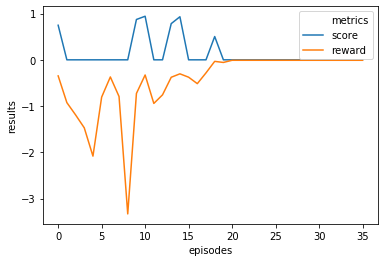

Max Train Score 1 Max Test Score 0
Mean Train Score 0.13282684688479207 Mean Test Score 0.0
----------------------------------------------------------------------------------------------------
Learning Rate 0.0013779226379577784


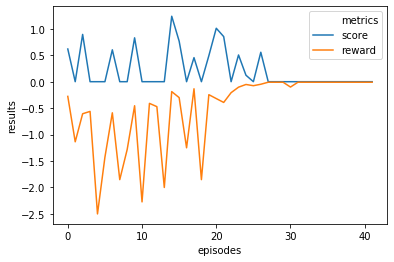

Max Train Score 2 Max Test Score 0
Mean Train Score 0.21291520108700185 Mean Test Score 0.0
----------------------------------------------------------------------------------------------------
Learning Rate 0.0013197979371411934


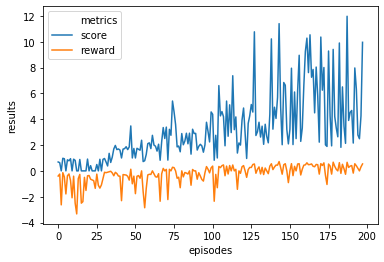

Max Train Score 23 Max Test Score 26
Mean Train Score 3.193486202064681 Mean Test Score 5.655055456401922
----------------------------------------------------------------------------------------------------
Learning Rate 0.001


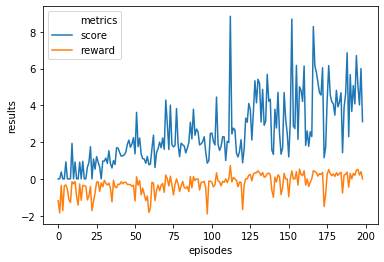

Max Train Score 17 Max Test Score 19
Mean Train Score 2.502111297555148 Mean Test Score 4.554872344454342
----------------------------------------------------------------------------------------------------
Learning Rate 0.0015


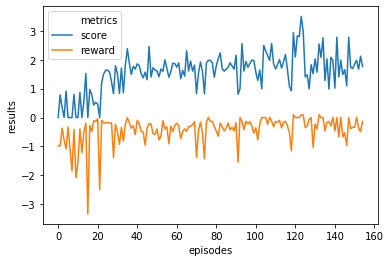

Max Train Score 6 Max Test Score 5
Mean Train Score 1.5691562475633665 Mean Test Score 1.7387698672281169
----------------------------------------------------------------------------------------------------
Learning Rate 0.0018


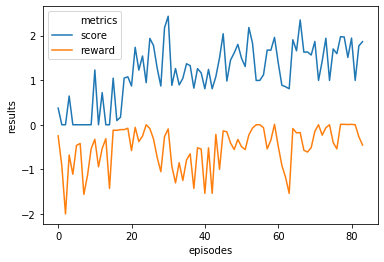

Max Train Score 4 Max Test Score 4
Mean Train Score 1.1782594691024575 Mean Test Score 1.531284214462898
----------------------------------------------------------------------------------------------------
Learning Rate 0.002


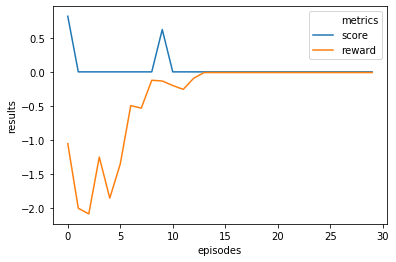

Max Train Score 2 Max Test Score 0
Mean Train Score 0.04787750626566416 Mean Test Score 0.0
----------------------------------------------------------------------------------------------------
Learning Rate 0.00095


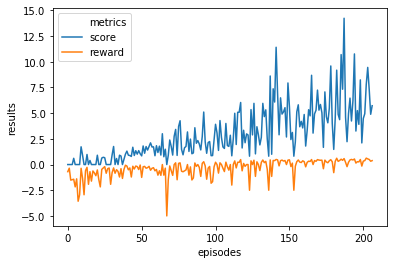

Max Train Score 26 Max Test Score 23
Mean Train Score 2.9579791121609182 Mean Test Score 4.33114645248929
----------------------------------------------------------------------------------------------------
Learning Rate 0.00092


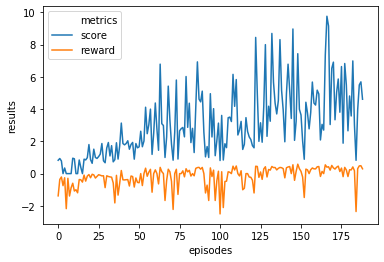

Max Train Score 20 Max Test Score 17
Mean Train Score 3.0471660521914403 Mean Test Score 4.130064317430133
----------------------------------------------------------------------------------------------------
Learning Rate 0.0009


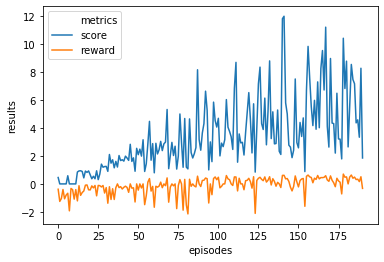

Max Train Score 26 Max Test Score 26
Mean Train Score 3.3710597909281543 Mean Test Score 5.849357055392177
----------------------------------------------------------------------------------------------------
Learning Rate 0.00085


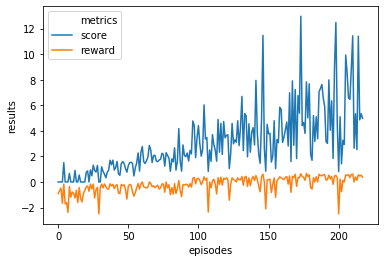

Max Train Score 25 Max Test Score 20
Mean Train Score 3.0238795268792873 Mean Test Score 5.037774564797584
----------------------------------------------------------------------------------------------------
Learning Rate 0.00082


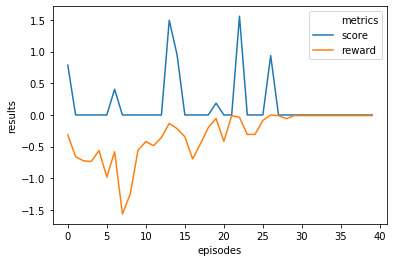

Max Train Score 2 Max Test Score 0
Mean Train Score 0.15809492923153745 Mean Test Score 0.0
----------------------------------------------------------------------------------------------------
Learning Rate 0.0008


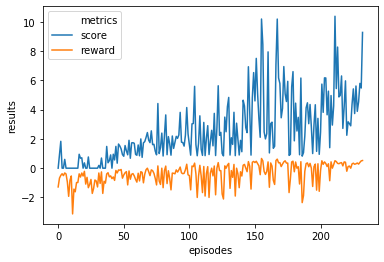

Max Train Score 21 Max Test Score 20
Mean Train Score 2.5511607694872254 Mean Test Score 4.142677564265893
----------------------------------------------------------------------------------------------------
Learning rate max results  3


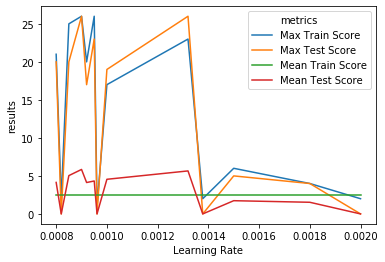

----------------------------------------------------------------------------------------------------
Using cpu device
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 202      |
|    ep_rew_mean        | -41.7    |
| time/                 |          |
|    fps                | 439      |
|    iterations         | 1000     |
|    time_elapsed       | 11       |
|    total_timesteps    | 5000     |
| train/                |          |
|    entropy_loss       | -0.509   |
|    explained_variance | -0.175   |
|    learning_rate      | 0.000961 |
|    n_updates          | 999      |
|    policy_loss        | 0.000303 |
|    value_loss         | 3.61e-06 |
------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 139      |
|    ep_rew_mean        | -25.4    |
| time/                 |          |
|    fps                | 441      |
|    iterations         | 2000 

------------------------------------
| rollout/              |          |
|    ep_len_mean        | 71.2     |
|    ep_rew_mean        | -18.3    |
| time/                 |          |
|    fps                | 426      |
|    iterations         | 2000     |
|    time_elapsed       | 23       |
|    total_timesteps    | 10000    |
| train/                |          |
|    entropy_loss       | -0.0887  |
|    explained_variance | -0.187   |
|    learning_rate      | 0.001    |
|    n_updates          | 1999     |
|    policy_loss        | 0.0442   |
|    value_loss         | 3.63     |
------------------------------------
-------------------------------------
| rollout/              |           |
|    ep_len_mean        | 78.8      |
|    ep_rew_mean        | -14.2     |
| time/                 |           |
|    fps                | 424       |
|    iterations         | 3000      |
|    time_elapsed       | 35        |
|    total_timesteps    | 15000     |
| train/                |    

------------------------------------
| rollout/              |          |
|    ep_len_mean        | 124      |
|    ep_rew_mean        | -1.7     |
| time/                 |          |
|    fps                | 432      |
|    iterations         | 3000     |
|    time_elapsed       | 34       |
|    total_timesteps    | 15000    |
| train/                |          |
|    entropy_loss       | -0.0498  |
|    explained_variance | 0.0282   |
|    learning_rate      | 0.002    |
|    n_updates          | 2999     |
|    policy_loss        | -0.00207 |
|    value_loss         | 0.0168   |
------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 126      |
|    ep_rew_mean        | 10.3     |
| time/                 |          |
|    fps                | 434      |
|    iterations         | 4000     |
|    time_elapsed       | 46       |
|    total_timesteps    | 20000    |
| train/                |          |
|

------------------------------------
| rollout/              |          |
|    ep_len_mean        | 84.9     |
|    ep_rew_mean        | -1       |
| time/                 |          |
|    fps                | 426      |
|    iterations         | 4000     |
|    time_elapsed       | 46       |
|    total_timesteps    | 20000    |
| train/                |          |
|    entropy_loss       | -0.0386  |
|    explained_variance | -0.588   |
|    learning_rate      | 0.0009   |
|    n_updates          | 3999     |
|    policy_loss        | -0.003   |
|    value_loss         | 0.238    |
------------------------------------
Using cpu device
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 87.9     |
|    ep_rew_mean        | -40.7    |
| time/                 |          |
|    fps                | 421      |
|    iterations         | 1000     |
|    time_elapsed       | 11       |
|    total_timesteps    | 5000     |
| train/             

Learning Rate 0.0009610612889534735


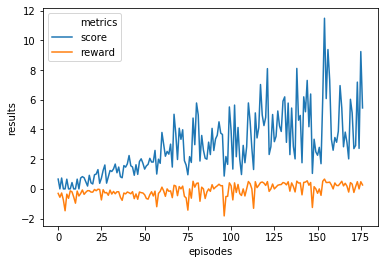

Max Train Score 21 Max Test Score 25
Mean Train Score 2.9138016620145253 Mean Test Score 5.402765383337639
----------------------------------------------------------------------------------------------------
Learning Rate 0.0013779226379577784


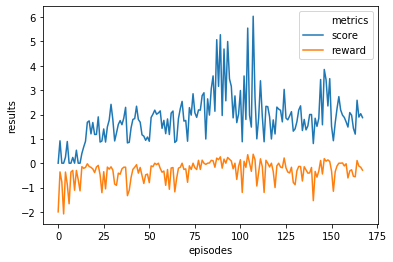

Max Train Score 12 Max Test Score 11
Mean Train Score 1.8627112477167231 Mean Test Score 2.495763071455971
----------------------------------------------------------------------------------------------------
Learning Rate 0.0013197979371411934


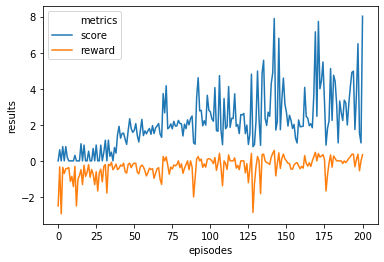

Max Train Score 15 Max Test Score 11
Mean Train Score 2.153099160324193 Mean Test Score 3.0629632804863665
----------------------------------------------------------------------------------------------------
Learning Rate 0.001


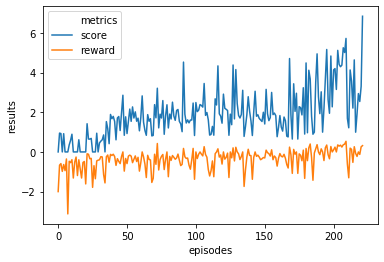

Max Train Score 11 Max Test Score 22
Mean Train Score 1.8890634251164427 Mean Test Score 4.193206831200224
----------------------------------------------------------------------------------------------------
Learning Rate 0.0015


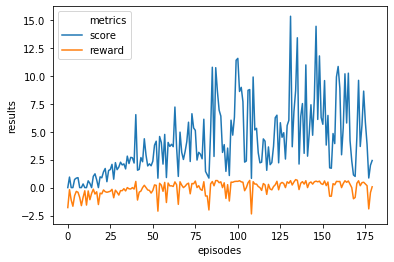

Max Train Score 30 Max Test Score 27
Mean Train Score 4.110784300195346 Mean Test Score 6.197403375924497
----------------------------------------------------------------------------------------------------
Learning Rate 0.0018


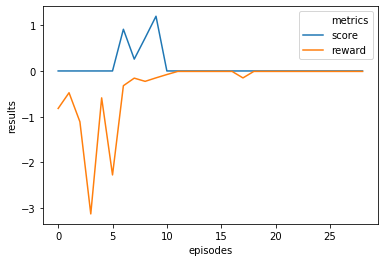

Max Train Score 2 Max Test Score 0
Mean Train Score 0.10647188484761401 Mean Test Score 0.0
----------------------------------------------------------------------------------------------------
Learning Rate 0.002


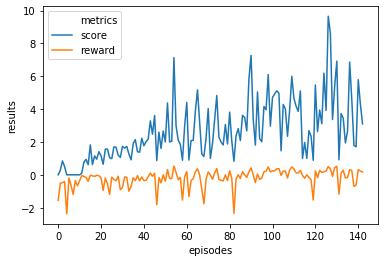

Max Train Score 18 Max Test Score 20
Mean Train Score 2.6636972008208075 Mean Test Score 3.3735021058826447
----------------------------------------------------------------------------------------------------
Learning Rate 0.00095


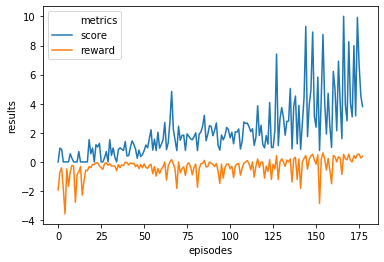

Max Train Score 18 Max Test Score 18
Mean Train Score 2.1542021000122262 Mean Test Score 4.753264737840944
----------------------------------------------------------------------------------------------------
Learning Rate 0.00092


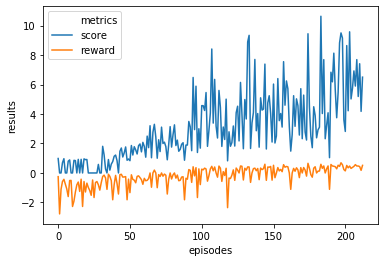

Max Train Score 20 Max Test Score 22
Mean Train Score 3.0529545647870897 Mean Test Score 5.360143264134977
----------------------------------------------------------------------------------------------------
Learning Rate 0.0009


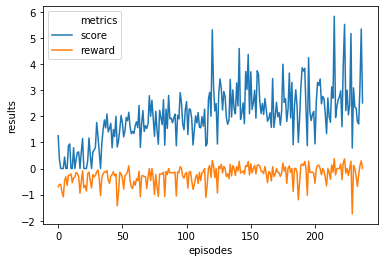

Max Train Score 11 Max Test Score 13
Mean Train Score 2.0039993501842823 Mean Test Score 3.07868877155106
----------------------------------------------------------------------------------------------------
Learning Rate 0.00085


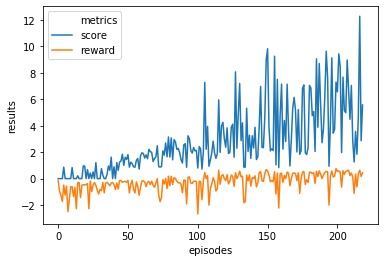

Max Train Score 23 Max Test Score 29
Mean Train Score 2.798648312778901 Mean Test Score 6.317608789967586
----------------------------------------------------------------------------------------------------
Learning Rate 0.00082


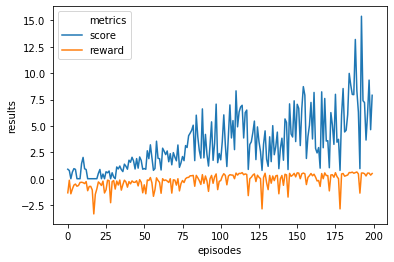

Max Train Score 31 Max Test Score 27
Mean Train Score 3.3126703183413935 Mean Test Score 5.854027369337702
----------------------------------------------------------------------------------------------------
Learning Rate 0.0008


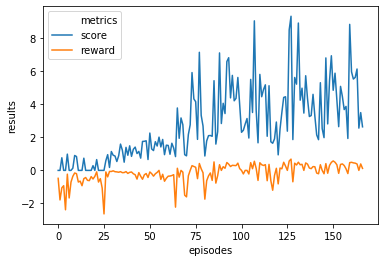

Max Train Score 18 Max Test Score 24
Mean Train Score 2.74021955805057 Mean Test Score 4.5722123873980305
----------------------------------------------------------------------------------------------------
Learning rate max results  4


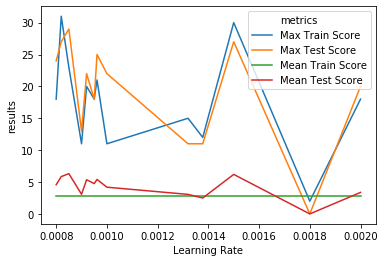

----------------------------------------------------------------------------------------------------
Using cpu device
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 90.1     |
|    ep_rew_mean        | -31.1    |
| time/                 |          |
|    fps                | 429      |
|    iterations         | 1000     |
|    time_elapsed       | 11       |
|    total_timesteps    | 5000     |
| train/                |          |
|    entropy_loss       | -0.537   |
|    explained_variance | -132     |
|    learning_rate      | 0.000961 |
|    n_updates          | 999      |
|    policy_loss        | 0.0379   |
|    value_loss         | 16.4     |
------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 74.3     |
|    ep_rew_mean        | -8.4     |
| time/                 |          |
|    fps                | 422      |
|    iterations         | 2000 

------------------------------------
| rollout/              |          |
|    ep_len_mean        | 88.8     |
|    ep_rew_mean        | -22.3    |
| time/                 |          |
|    fps                | 414      |
|    iterations         | 2000     |
|    time_elapsed       | 24       |
|    total_timesteps    | 10000    |
| train/                |          |
|    entropy_loss       | -0.202   |
|    explained_variance | 0.237    |
|    learning_rate      | 0.001    |
|    n_updates          | 1999     |
|    policy_loss        | -0.00365 |
|    value_loss         | 0.558    |
------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 81.8     |
|    ep_rew_mean        | 2.7      |
| time/                 |          |
|    fps                | 417      |
|    iterations         | 3000     |
|    time_elapsed       | 35       |
|    total_timesteps    | 15000    |
| train/                |          |
|

-------------------------------------
| rollout/              |           |
|    ep_len_mean        | 809       |
|    ep_rew_mean        | -19.4     |
| time/                 |           |
|    fps                | 447       |
|    iterations         | 3000      |
|    time_elapsed       | 33        |
|    total_timesteps    | 15000     |
| train/                |           |
|    entropy_loss       | -0.000549 |
|    explained_variance | -0.314    |
|    learning_rate      | 0.002     |
|    n_updates          | 2999      |
|    policy_loss        | 2.01e-11  |
|    value_loss         | 5.38e-12  |
-------------------------------------
-------------------------------------
| rollout/              |           |
|    ep_len_mean        | 850       |
|    ep_rew_mean        | -17.4     |
| time/                 |           |
|    fps                | 443       |
|    iterations         | 4000      |
|    time_elapsed       | 45        |
|    total_timesteps    | 20000     |
| train/    

------------------------------------
| rollout/              |          |
|    ep_len_mean        | 118      |
|    ep_rew_mean        | 21.4     |
| time/                 |          |
|    fps                | 428      |
|    iterations         | 4000     |
|    time_elapsed       | 46       |
|    total_timesteps    | 20000    |
| train/                |          |
|    entropy_loss       | -0.0103  |
|    explained_variance | 0.0148   |
|    learning_rate      | 0.0009   |
|    n_updates          | 3999     |
|    policy_loss        | 2.25e-06 |
|    value_loss         | 6.07e-05 |
------------------------------------
Using cpu device
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 77.4     |
|    ep_rew_mean        | -33.9    |
| time/                 |          |
|    fps                | 436      |
|    iterations         | 1000     |
|    time_elapsed       | 11       |
|    total_timesteps    | 5000     |
| train/             

Learning Rate 0.0009610612889534735


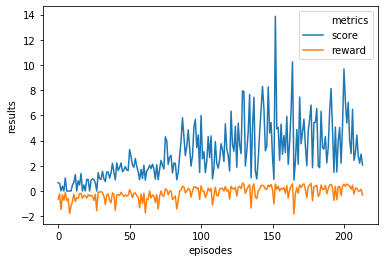

Max Train Score 28 Max Test Score 25
Mean Train Score 3.044689441783158 Mean Test Score 5.714808020499193
----------------------------------------------------------------------------------------------------
Learning Rate 0.0013779226379577784


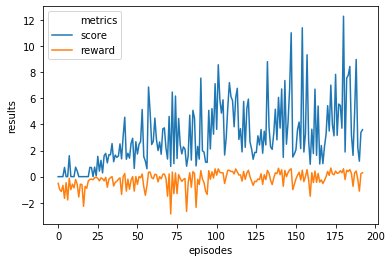

Max Train Score 25 Max Test Score 36
Mean Train Score 3.090171144781726 Mean Test Score 6.6266242887364015
----------------------------------------------------------------------------------------------------
Learning Rate 0.0013197979371411934


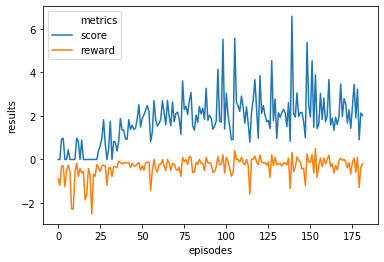

Max Train Score 13 Max Test Score 17
Mean Train Score 1.816725713687303 Mean Test Score 2.993463013827202
----------------------------------------------------------------------------------------------------
Learning Rate 0.001


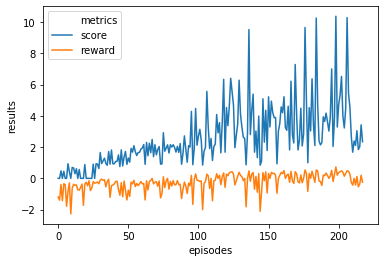

Max Train Score 19 Max Test Score 26
Mean Train Score 2.5791730519382803 Mean Test Score 4.6503107213041615
----------------------------------------------------------------------------------------------------
Learning Rate 0.0015


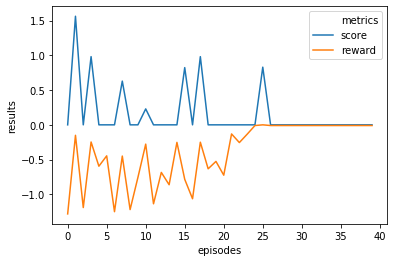

Max Train Score 2 Max Test Score 0
Mean Train Score 0.15093679242896516 Mean Test Score 0.0
----------------------------------------------------------------------------------------------------
Learning Rate 0.0018


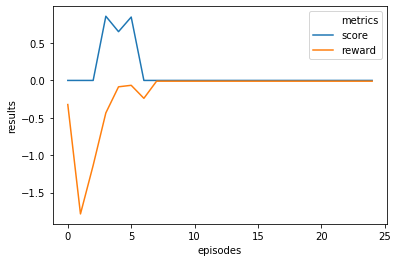

Max Train Score 2 Max Test Score 0
Mean Train Score 0.09435895058867155 Mean Test Score 0.0
----------------------------------------------------------------------------------------------------
Learning Rate 0.002


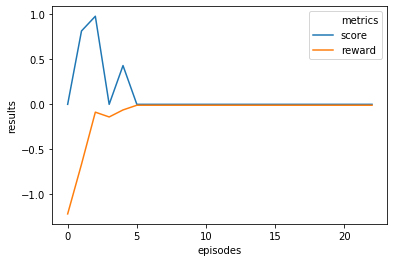

Max Train Score 1 Max Test Score 0
Mean Train Score 0.09689230426018434 Mean Test Score 0.0
----------------------------------------------------------------------------------------------------
Learning Rate 0.00095


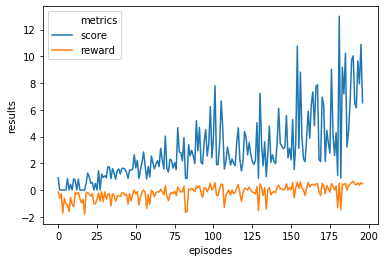

Max Train Score 23 Max Test Score 24
Mean Train Score 2.983663952332685 Mean Test Score 5.753151152869797
----------------------------------------------------------------------------------------------------
Learning Rate 0.00092


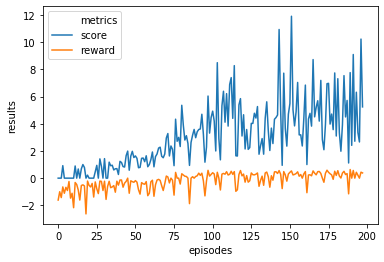

Max Train Score 23 Max Test Score 21
Mean Train Score 3.032214501684276 Mean Test Score 5.391132087440228
----------------------------------------------------------------------------------------------------
Learning Rate 0.0009


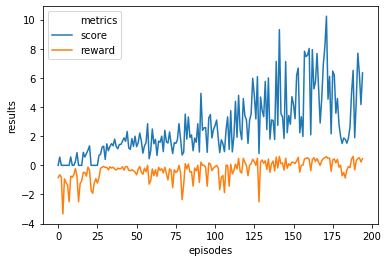

Max Train Score 19 Max Test Score 21
Mean Train Score 2.649491994273536 Mean Test Score 4.487710308141482
----------------------------------------------------------------------------------------------------
Learning Rate 0.00085


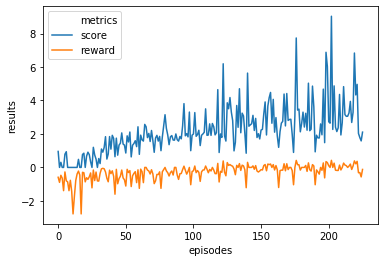

Max Train Score 19 Max Test Score 20
Mean Train Score 2.1890387113225933 Mean Test Score 3.22320417442035
----------------------------------------------------------------------------------------------------
Learning Rate 0.00082


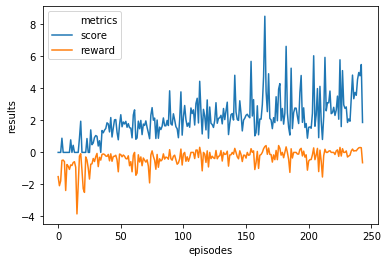

Max Train Score 16 Max Test Score 15
Mean Train Score 2.1045469453333214 Mean Test Score 3.6374248937561653
----------------------------------------------------------------------------------------------------
Learning Rate 0.0008


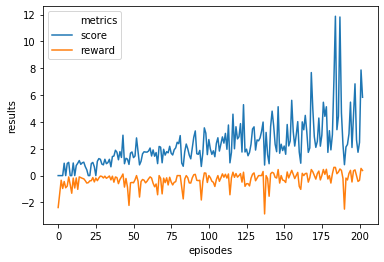

Max Train Score 23 Max Test Score 20
Mean Train Score 2.298563827698839 Mean Test Score 3.966033321339885
----------------------------------------------------------------------------------------------------
Learning rate max results  5


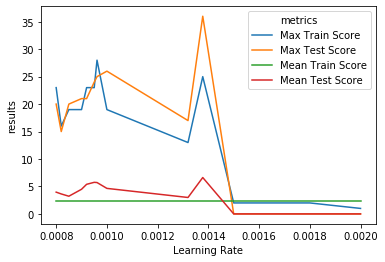

----------------------------------------------------------------------------------------------------
Using cpu device
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 90.4     |
|    ep_rew_mean        | -31.5    |
| time/                 |          |
|    fps                | 415      |
|    iterations         | 1000     |
|    time_elapsed       | 12       |
|    total_timesteps    | 5000     |
| train/                |          |
|    entropy_loss       | -0.588   |
|    explained_variance | -361     |
|    learning_rate      | 0.000961 |
|    n_updates          | 999      |
|    policy_loss        | 0.219    |
|    value_loss         | 17.6     |
------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 95       |
|    ep_rew_mean        | -3.7     |
| time/                 |          |
|    fps                | 414      |
|    iterations         | 2000 

------------------------------------
| rollout/              |          |
|    ep_len_mean        | 87.9     |
|    ep_rew_mean        | -4.8     |
| time/                 |          |
|    fps                | 433      |
|    iterations         | 2000     |
|    time_elapsed       | 23       |
|    total_timesteps    | 10000    |
| train/                |          |
|    entropy_loss       | -0.0302  |
|    explained_variance | -2.03    |
|    learning_rate      | 0.001    |
|    n_updates          | 1999     |
|    policy_loss        | -0.00749 |
|    value_loss         | 0.792    |
------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 98.3     |
|    ep_rew_mean        | 20.9     |
| time/                 |          |
|    fps                | 430      |
|    iterations         | 3000     |
|    time_elapsed       | 34       |
|    total_timesteps    | 15000    |
| train/                |          |
|

-------------------------------------
| rollout/              |           |
|    ep_len_mean        | 643       |
|    ep_rew_mean        | -25.5     |
| time/                 |           |
|    fps                | 458       |
|    iterations         | 3000      |
|    time_elapsed       | 32        |
|    total_timesteps    | 15000     |
| train/                |           |
|    entropy_loss       | -0.0217   |
|    explained_variance | 0         |
|    learning_rate      | 0.002     |
|    n_updates          | 2999      |
|    policy_loss        | -9.04e-12 |
|    value_loss         | 7.77e-17  |
-------------------------------------
-------------------------------------
| rollout/              |           |
|    ep_len_mean        | 709       |
|    ep_rew_mean        | -22.6     |
| time/                 |           |
|    fps                | 459       |
|    iterations         | 4000      |
|    time_elapsed       | 43        |
|    total_timesteps    | 20000     |
| train/    

------------------------------------
| rollout/              |          |
|    ep_len_mean        | 118      |
|    ep_rew_mean        | 35.8     |
| time/                 |          |
|    fps                | 423      |
|    iterations         | 4000     |
|    time_elapsed       | 47       |
|    total_timesteps    | 20000    |
| train/                |          |
|    entropy_loss       | -0.0282  |
|    explained_variance | nan      |
|    learning_rate      | 0.0009   |
|    n_updates          | 3999     |
|    policy_loss        | -0.00105 |
|    value_loss         | 0.0733   |
------------------------------------
Using cpu device
-------------------------------------
| rollout/              |           |
|    ep_len_mean        | 110       |
|    ep_rew_mean        | -44.1     |
| time/                 |           |
|    fps                | 426       |
|    iterations         | 1000      |
|    time_elapsed       | 11        |
|    total_timesteps    | 5000      |
| train/    

Learning Rate 0.0009610612889534735


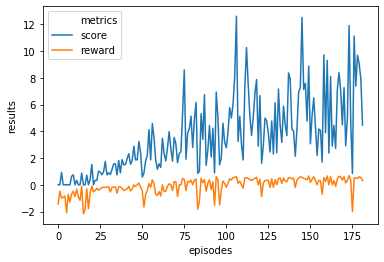

Max Train Score 25 Max Test Score 31
Mean Train Score 3.6195868694596935 Mean Test Score 7.346462281879054
----------------------------------------------------------------------------------------------------
Learning Rate 0.0013779226379577784


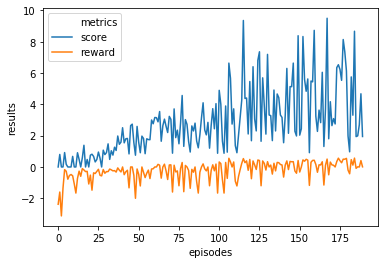

Max Train Score 18 Max Test Score 15
Mean Train Score 2.806586990311726 Mean Test Score 3.048832233665978
----------------------------------------------------------------------------------------------------
Learning Rate 0.0013197979371411934


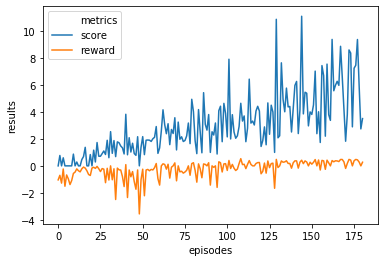

Max Train Score 20 Max Test Score 22
Mean Train Score 2.988992397497774 Mean Test Score 5.523384750359633
----------------------------------------------------------------------------------------------------
Learning Rate 0.001


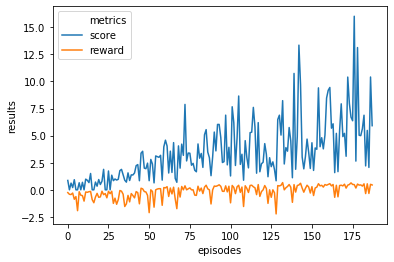

Max Train Score 27 Max Test Score 37
Mean Train Score 3.468195364779507 Mean Test Score 7.331781758987611
----------------------------------------------------------------------------------------------------
Learning Rate 0.0015


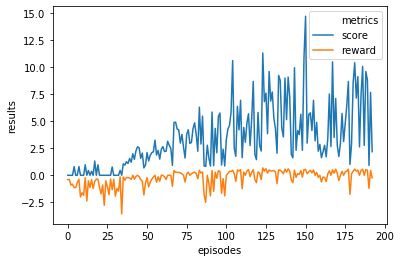

Max Train Score 28 Max Test Score 27
Mean Train Score 3.4444336485398486 Mean Test Score 5.945770802069423
----------------------------------------------------------------------------------------------------
Learning Rate 0.0018


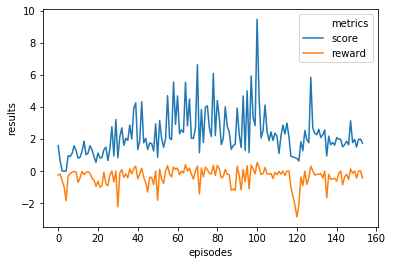

Max Train Score 19 Max Test Score 6
Mean Train Score 2.270012540514793 Mean Test Score 1.8797805074591232
----------------------------------------------------------------------------------------------------
Learning Rate 0.002


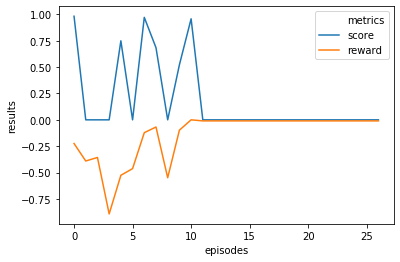

Max Train Score 1 Max Test Score 0
Mean Train Score 0.18042282545287341 Mean Test Score 0.0
----------------------------------------------------------------------------------------------------
Learning Rate 0.00095


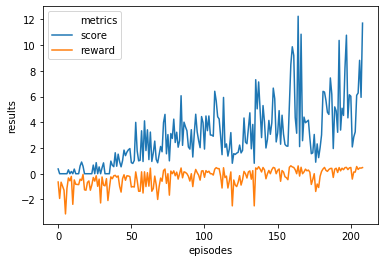

Max Train Score 26 Max Test Score 21
Mean Train Score 2.9231338790855252 Mean Test Score 5.81506510854856
----------------------------------------------------------------------------------------------------
Learning Rate 0.00092


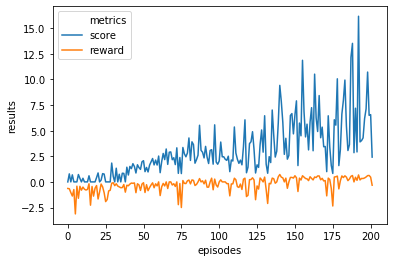

Max Train Score 31 Max Test Score 28
Mean Train Score 3.0922325755002995 Mean Test Score 5.646373513696857
----------------------------------------------------------------------------------------------------
Learning Rate 0.0009


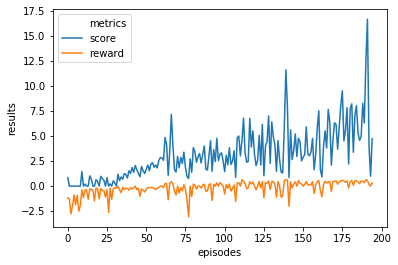

Max Train Score 29 Max Test Score 27
Mean Train Score 3.104603848278467 Mean Test Score 5.543704136951853
----------------------------------------------------------------------------------------------------
Learning Rate 0.00085


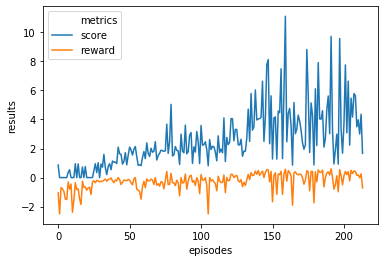

Max Train Score 21 Max Test Score 20
Mean Train Score 2.5447469538524596 Mean Test Score 3.828834968325301
----------------------------------------------------------------------------------------------------
Learning Rate 0.00082


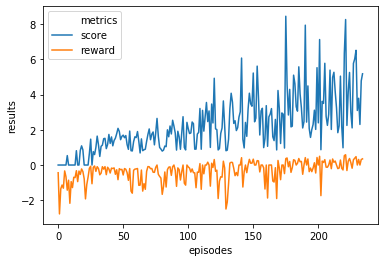

Max Train Score 16 Max Test Score 24
Mean Train Score 2.234542402906577 Mean Test Score 4.686902921090883
----------------------------------------------------------------------------------------------------
Learning Rate 0.0008


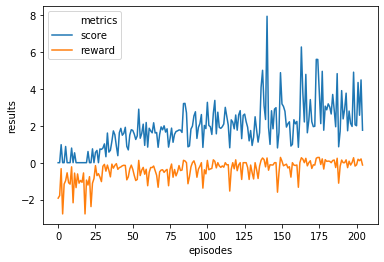

Max Train Score 15 Max Test Score 15
Mean Train Score 1.9161666121726326 Mean Test Score 3.7322791776699478
----------------------------------------------------------------------------------------------------
Learning rate max results  6


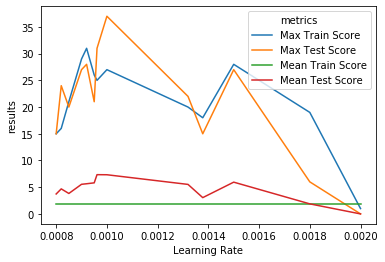

----------------------------------------------------------------------------------------------------
Using cpu device
-------------------------------------
| rollout/              |           |
|    ep_len_mean        | 171       |
|    ep_rew_mean        | -42.6     |
| time/                 |           |
|    fps                | 411       |
|    iterations         | 1000      |
|    time_elapsed       | 12        |
|    total_timesteps    | 5000      |
| train/                |           |
|    entropy_loss       | -0.385    |
|    explained_variance | 0.12      |
|    learning_rate      | 0.000961  |
|    n_updates          | 999       |
|    policy_loss        | -0.000156 |
|    value_loss         | 2.2e-06   |
-------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 114      |
|    ep_rew_mean        | -27.7    |
| time/                 |          |
|    fps                | 407      |
|    iteration

------------------------------------
| rollout/              |          |
|    ep_len_mean        | 87.8     |
|    ep_rew_mean        | -2.1     |
| time/                 |          |
|    fps                | 424      |
|    iterations         | 2000     |
|    time_elapsed       | 23       |
|    total_timesteps    | 10000    |
| train/                |          |
|    entropy_loss       | -0.0481  |
|    explained_variance | 0.746    |
|    learning_rate      | 0.001    |
|    n_updates          | 1999     |
|    policy_loss        | 0.00269  |
|    value_loss         | 0.185    |
------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 102      |
|    ep_rew_mean        | 29.2     |
| time/                 |          |
|    fps                | 428      |
|    iterations         | 3000     |
|    time_elapsed       | 34       |
|    total_timesteps    | 15000    |
| train/                |          |
|

-------------------------------------
| rollout/              |           |
|    ep_len_mean        | 102       |
|    ep_rew_mean        | 17.7      |
| time/                 |           |
|    fps                | 428       |
|    iterations         | 3000      |
|    time_elapsed       | 35        |
|    total_timesteps    | 15000     |
| train/                |           |
|    entropy_loss       | -0.000697 |
|    explained_variance | 0.414     |
|    learning_rate      | 0.002     |
|    n_updates          | 2999      |
|    policy_loss        | 0.000174  |
|    value_loss         | 2.96      |
-------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 130      |
|    ep_rew_mean        | 40       |
| time/                 |          |
|    fps                | 424      |
|    iterations         | 4000     |
|    time_elapsed       | 47       |
|    total_timesteps    | 20000    |
| train/             

-------------------------------------
| rollout/              |           |
|    ep_len_mean        | 106       |
|    ep_rew_mean        | 22.2      |
| time/                 |           |
|    fps                | 426       |
|    iterations         | 4000      |
|    time_elapsed       | 46        |
|    total_timesteps    | 20000     |
| train/                |           |
|    entropy_loss       | -0.000528 |
|    explained_variance | 0.516     |
|    learning_rate      | 0.0009    |
|    n_updates          | 3999      |
|    policy_loss        | -2.98e-05 |
|    value_loss         | 0.8       |
-------------------------------------
Using cpu device
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 88.8     |
|    ep_rew_mean        | -42.3    |
| time/                 |          |
|    fps                | 427      |
|    iterations         | 1000     |
|    time_elapsed       | 11       |
|    total_timesteps    | 5000     |
| tr

Learning Rate 0.0009610612889534735


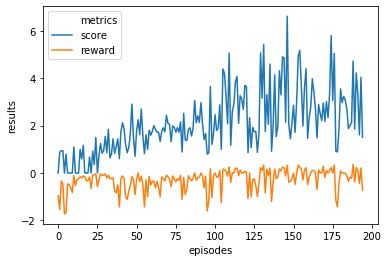

Max Train Score 14 Max Test Score 16
Mean Train Score 2.082295492880281 Mean Test Score 3.375206498564407
----------------------------------------------------------------------------------------------------
Learning Rate 0.0013779226379577784


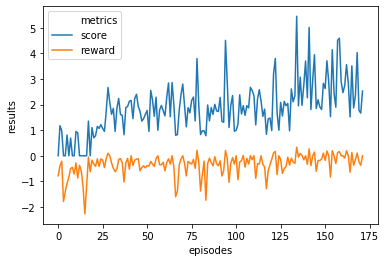

Max Train Score 11 Max Test Score 11
Mean Train Score 1.866164549634027 Mean Test Score 2.3864510028059716
----------------------------------------------------------------------------------------------------
Learning Rate 0.0013197979371411934


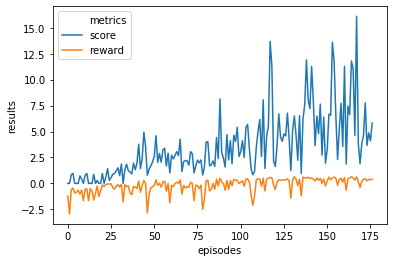

Max Train Score 30 Max Test Score 28
Mean Train Score 3.5005100644558227 Mean Test Score 7.240775476486697
----------------------------------------------------------------------------------------------------
Learning Rate 0.001


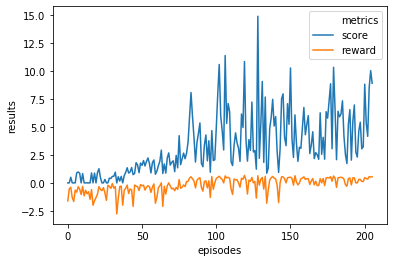

Max Train Score 31 Max Test Score 30
Mean Train Score 3.299852252909541 Mean Test Score 6.177131984524411
----------------------------------------------------------------------------------------------------
Learning Rate 0.0015


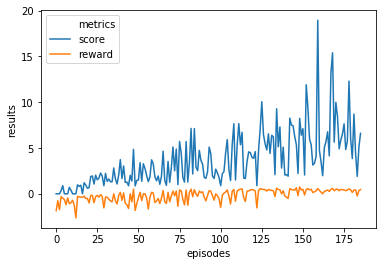

Max Train Score 38 Max Test Score 32
Mean Train Score 3.6867705801650166 Mean Test Score 7.66364965187578
----------------------------------------------------------------------------------------------------
Learning Rate 0.0018


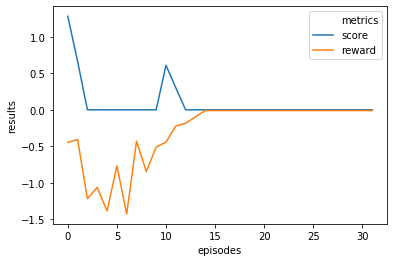

Max Train Score 2 Max Test Score 0
Mean Train Score 0.08936357763873219 Mean Test Score 0.0
----------------------------------------------------------------------------------------------------
Learning Rate 0.002


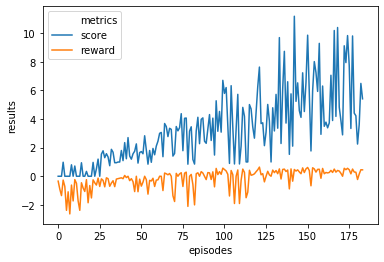

Max Train Score 21 Max Test Score 21
Mean Train Score 3.274500927626723 Mean Test Score 5.975671246101876
----------------------------------------------------------------------------------------------------
Learning Rate 0.00095


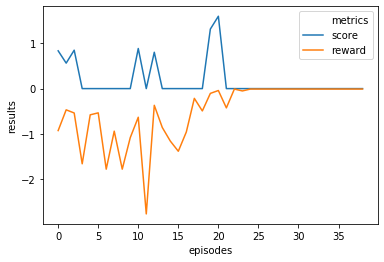

Max Train Score 3 Max Test Score 0
Mean Train Score 0.1761711147683735 Mean Test Score 0.0
----------------------------------------------------------------------------------------------------
Learning Rate 0.00092


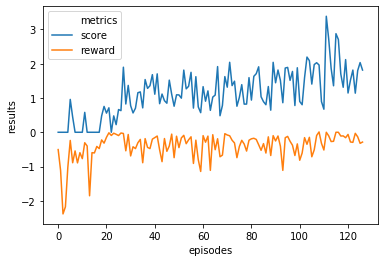

Max Train Score 5 Max Test Score 6
Mean Train Score 1.1345499793290097 Mean Test Score 1.7305337038454816
----------------------------------------------------------------------------------------------------
Learning Rate 0.0009


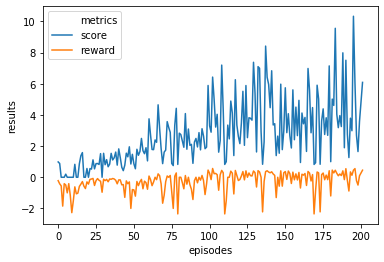

Max Train Score 19 Max Test Score 27
Mean Train Score 2.732995773117866 Mean Test Score 4.63074569187825
----------------------------------------------------------------------------------------------------
Learning Rate 0.00085


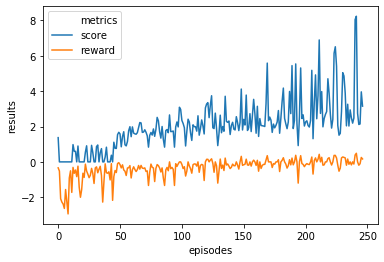

Max Train Score 15 Max Test Score 15
Mean Train Score 2.0359775726335303 Mean Test Score 3.7814338317950353
----------------------------------------------------------------------------------------------------
Learning Rate 0.00082


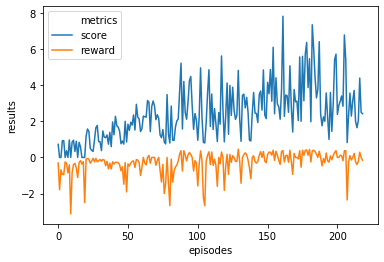

Max Train Score 14 Max Test Score 18
Mean Train Score 2.4209786365557107 Mean Test Score 3.7947879342767066
----------------------------------------------------------------------------------------------------
Learning Rate 0.0008


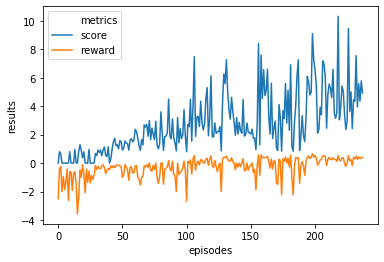

Max Train Score 20 Max Test Score 22
Mean Train Score 2.7444398560920718 Mean Test Score 4.814391060932859
----------------------------------------------------------------------------------------------------
Learning rate max results  7


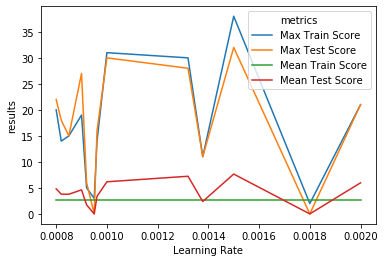

----------------------------------------------------------------------------------------------------
Using cpu device
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 120      |
|    ep_rew_mean        | -47      |
| time/                 |          |
|    fps                | 433      |
|    iterations         | 1000     |
|    time_elapsed       | 11       |
|    total_timesteps    | 5000     |
| train/                |          |
|    entropy_loss       | -0.163   |
|    explained_variance | -0.23    |
|    learning_rate      | 0.000961 |
|    n_updates          | 999      |
|    policy_loss        | -8.7e-05 |
|    value_loss         | 4.71e-06 |
------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 180      |
|    ep_rew_mean        | -39.8    |
| time/                 |          |
|    fps                | 444      |
|    iterations         | 2000 

-------------------------------------
| rollout/              |           |
|    ep_len_mean        | 72.8      |
|    ep_rew_mean        | -4.8      |
| time/                 |           |
|    fps                | 432       |
|    iterations         | 2000      |
|    time_elapsed       | 23        |
|    total_timesteps    | 10000     |
| train/                |           |
|    entropy_loss       | -0.0235   |
|    explained_variance | 0.986     |
|    learning_rate      | 0.001     |
|    n_updates          | 1999      |
|    policy_loss        | -0.000231 |
|    value_loss         | 0.17      |
-------------------------------------
-------------------------------------
| rollout/              |           |
|    ep_len_mean        | 88.5      |
|    ep_rew_mean        | 16.6      |
| time/                 |           |
|    fps                | 432       |
|    iterations         | 3000      |
|    time_elapsed       | 34        |
|    total_timesteps    | 15000     |
| train/    

------------------------------------
| rollout/              |          |
|    ep_len_mean        | 541      |
|    ep_rew_mean        | -29.3    |
| time/                 |          |
|    fps                | 445      |
|    iterations         | 3000     |
|    time_elapsed       | 33       |
|    total_timesteps    | 15000    |
| train/                |          |
|    entropy_loss       | -0.0138  |
|    explained_variance | -2.78    |
|    learning_rate      | 0.002    |
|    n_updates          | 2999     |
|    policy_loss        | 9.11e-10 |
|    value_loss         | 2.42e-13 |
------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 612      |
|    ep_rew_mean        | -26.2    |
| time/                 |          |
|    fps                | 446      |
|    iterations         | 4000     |
|    time_elapsed       | 44       |
|    total_timesteps    | 20000    |
| train/                |          |
|

-------------------------------------
| rollout/              |           |
|    ep_len_mean        | 112       |
|    ep_rew_mean        | 40.1      |
| time/                 |           |
|    fps                | 416       |
|    iterations         | 4000      |
|    time_elapsed       | 47        |
|    total_timesteps    | 20000     |
| train/                |           |
|    entropy_loss       | -0.00142  |
|    explained_variance | -3.26e+11 |
|    learning_rate      | 0.0009    |
|    n_updates          | 3999      |
|    policy_loss        | -0.000171 |
|    value_loss         | 1.73      |
-------------------------------------
Using cpu device
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 86.5     |
|    ep_rew_mean        | -40.9    |
| time/                 |          |
|    fps                | 431      |
|    iterations         | 1000     |
|    time_elapsed       | 11       |
|    total_timesteps    | 5000     |
| tr

Learning Rate 0.0009610612889534735


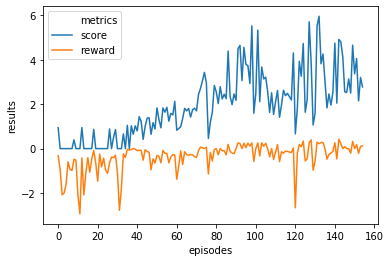

Max Train Score 10 Max Test Score 17
Mean Train Score 1.9420882644343156 Mean Test Score 3.9043458440723375
----------------------------------------------------------------------------------------------------
Learning Rate 0.0013779226379577784


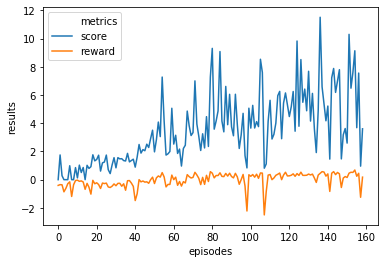

Max Train Score 20 Max Test Score 23
Mean Train Score 3.5087032064987573 Mean Test Score 4.936708271483283
----------------------------------------------------------------------------------------------------
Learning Rate 0.0013197979371411934


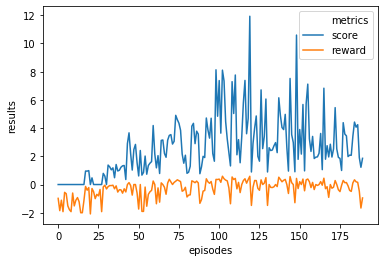

Max Train Score 23 Max Test Score 16
Mean Train Score 2.602425012760194 Mean Test Score 2.863954393662848
----------------------------------------------------------------------------------------------------
Learning Rate 0.001


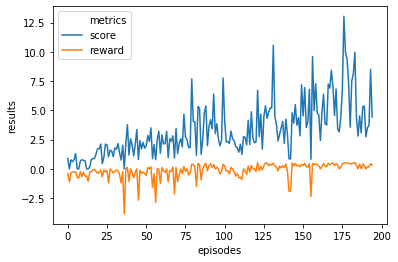

Max Train Score 25 Max Test Score 23
Mean Train Score 3.295789806872893 Mean Test Score 4.40513277004252
----------------------------------------------------------------------------------------------------
Learning Rate 0.0015


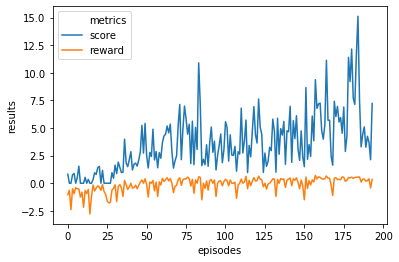

Max Train Score 29 Max Test Score 32
Mean Train Score 3.5829242862528075 Mean Test Score 8.444802750844739
----------------------------------------------------------------------------------------------------
Learning Rate 0.0018


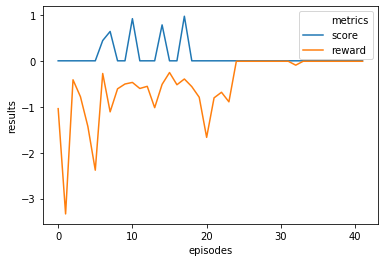

Max Train Score 1 Max Test Score 0
Mean Train Score 0.08929198975741662 Mean Test Score 0.0
----------------------------------------------------------------------------------------------------
Learning Rate 0.002


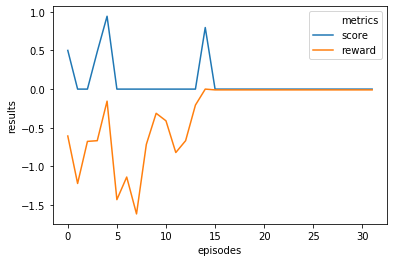

Max Train Score 1 Max Test Score 0
Mean Train Score 0.08502109521114157 Mean Test Score 0.0
----------------------------------------------------------------------------------------------------
Learning Rate 0.00095


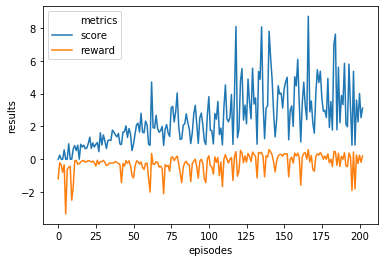

Max Train Score 16 Max Test Score 18
Mean Train Score 2.506641392099408 Mean Test Score 3.745015612630415
----------------------------------------------------------------------------------------------------
Learning Rate 0.00092


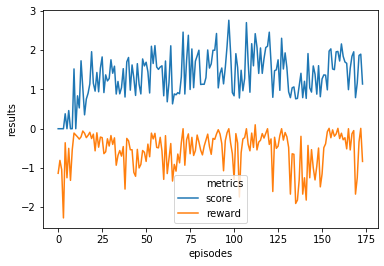

Max Train Score 7 Max Test Score 5
Mean Train Score 1.3631095699221394 Mean Test Score 1.164862504578083
----------------------------------------------------------------------------------------------------
Learning Rate 0.0009


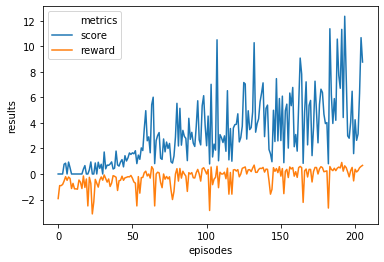

Max Train Score 26 Max Test Score 35
Mean Train Score 3.196218693559884 Mean Test Score 7.361763659122396
----------------------------------------------------------------------------------------------------
Learning Rate 0.00085


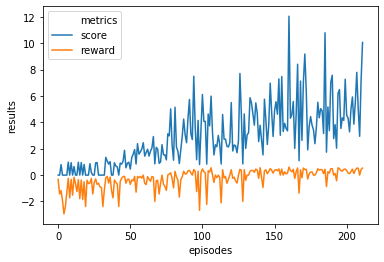

Max Train Score 20 Max Test Score 22
Mean Train Score 2.953914665384688 Mean Test Score 4.669023311190582
----------------------------------------------------------------------------------------------------
Learning Rate 0.00082


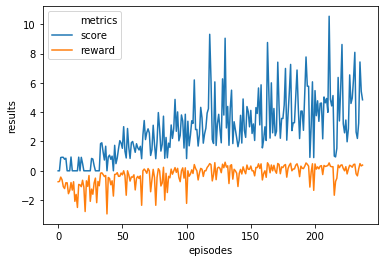

Max Train Score 20 Max Test Score 18
Mean Train Score 2.882144023520805 Mean Test Score 4.415807023359054
----------------------------------------------------------------------------------------------------
Learning Rate 0.0008


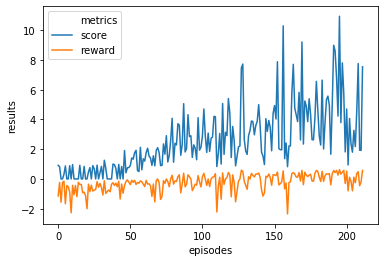

Max Train Score 19 Max Test Score 27
Mean Train Score 2.5952350233166737 Mean Test Score 5.113506679137792
----------------------------------------------------------------------------------------------------
Learning rate max results  8


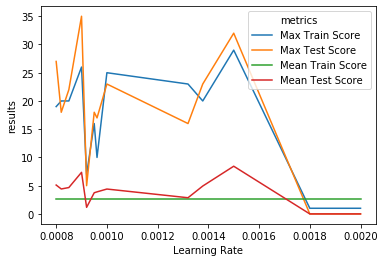

----------------------------------------------------------------------------------------------------
Using cpu device
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 95.3     |
|    ep_rew_mean        | -36.2    |
| time/                 |          |
|    fps                | 427      |
|    iterations         | 1000     |
|    time_elapsed       | 11       |
|    total_timesteps    | 5000     |
| train/                |          |
|    entropy_loss       | -0.411   |
|    explained_variance | 0.149    |
|    learning_rate      | 0.000961 |
|    n_updates          | 999      |
|    policy_loss        | 0.143    |
|    value_loss         | 0.355    |
------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 103      |
|    ep_rew_mean        | -33.6    |
| time/                 |          |
|    fps                | 427      |
|    iterations         | 2000 

------------------------------------
| rollout/              |          |
|    ep_len_mean        | 89.2     |
|    ep_rew_mean        | -20.3    |
| time/                 |          |
|    fps                | 428      |
|    iterations         | 2000     |
|    time_elapsed       | 23       |
|    total_timesteps    | 10000    |
| train/                |          |
|    entropy_loss       | -0.348   |
|    explained_variance | 0.992    |
|    learning_rate      | 0.001    |
|    n_updates          | 1999     |
|    policy_loss        | 0.119    |
|    value_loss         | 0.916    |
------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 82.9     |
|    ep_rew_mean        | 7.2      |
| time/                 |          |
|    fps                | 429      |
|    iterations         | 3000     |
|    time_elapsed       | 34       |
|    total_timesteps    | 15000    |
| train/                |          |
|

------------------------------------
| rollout/              |          |
|    ep_len_mean        | 99       |
|    ep_rew_mean        | 16.5     |
| time/                 |          |
|    fps                | 419      |
|    iterations         | 3000     |
|    time_elapsed       | 35       |
|    total_timesteps    | 15000    |
| train/                |          |
|    entropy_loss       | -0.0176  |
|    explained_variance | 0.267    |
|    learning_rate      | 0.002    |
|    n_updates          | 2999     |
|    policy_loss        | 0.0309   |
|    value_loss         | 48       |
------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 136      |
|    ep_rew_mean        | 27.3     |
| time/                 |          |
|    fps                | 426      |
|    iterations         | 4000     |
|    time_elapsed       | 46       |
|    total_timesteps    | 20000    |
| train/                |          |
|

-------------------------------------
| rollout/              |           |
|    ep_len_mean        | 138       |
|    ep_rew_mean        | 57.6      |
| time/                 |           |
|    fps                | 430       |
|    iterations         | 4000      |
|    time_elapsed       | 46        |
|    total_timesteps    | 20000     |
| train/                |           |
|    entropy_loss       | -0.000599 |
|    explained_variance | 0.571     |
|    learning_rate      | 0.0009    |
|    n_updates          | 3999      |
|    policy_loss        | -5.52e-05 |
|    value_loss         | 1.13      |
-------------------------------------
Using cpu device
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 89.4     |
|    ep_rew_mean        | -36      |
| time/                 |          |
|    fps                | 444      |
|    iterations         | 1000     |
|    time_elapsed       | 11       |
|    total_timesteps    | 5000     |
| tr

Learning Rate 0.0009610612889534735


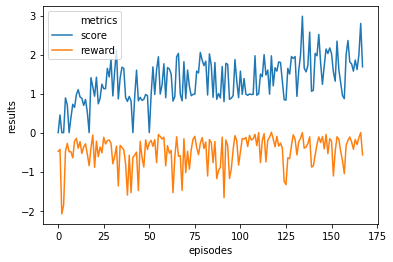

Max Train Score 5 Max Test Score 8
Mean Train Score 1.3233391624493425 Mean Test Score 2.0120561493984543
----------------------------------------------------------------------------------------------------
Learning Rate 0.0013779226379577784


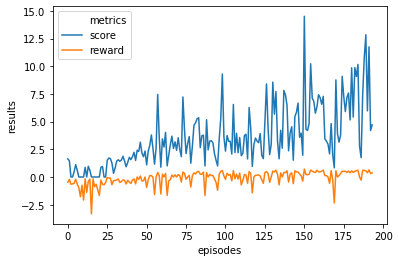

Max Train Score 27 Max Test Score 26
Mean Train Score 3.562756803272026 Mean Test Score 5.6592455851464205
----------------------------------------------------------------------------------------------------
Learning Rate 0.0013197979371411934


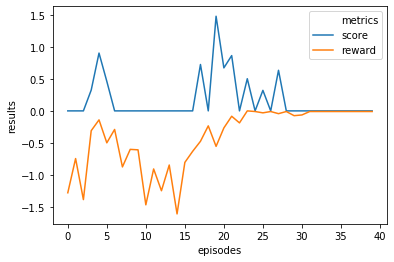

Max Train Score 2 Max Test Score 0
Mean Train Score 0.17248873355112712 Mean Test Score 0.0
----------------------------------------------------------------------------------------------------
Learning Rate 0.001


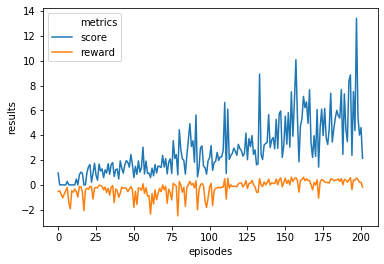

Max Train Score 24 Max Test Score 27
Mean Train Score 2.822226071273387 Mean Test Score 4.926282998272228
----------------------------------------------------------------------------------------------------
Learning Rate 0.0015


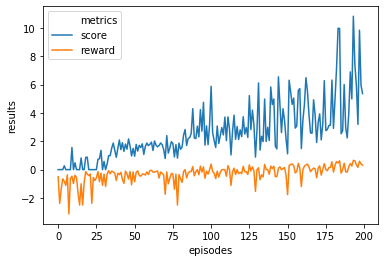

Max Train Score 21 Max Test Score 36
Mean Train Score 2.609247505207095 Mean Test Score 6.006800453821545
----------------------------------------------------------------------------------------------------
Learning Rate 0.0018


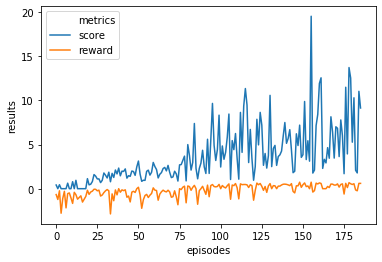

Max Train Score 39 Max Test Score 26
Mean Train Score 3.638867676662442 Mean Test Score 6.86102851840703
----------------------------------------------------------------------------------------------------
Learning Rate 0.002


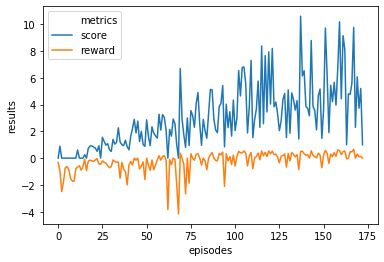

Max Train Score 20 Max Test Score 14
Mean Train Score 2.999314051135735 Mean Test Score 3.442748876184432
----------------------------------------------------------------------------------------------------
Learning Rate 0.00095


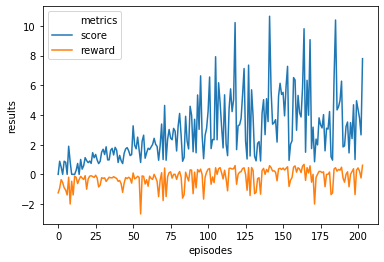

Max Train Score 21 Max Test Score 23
Mean Train Score 2.8916759025533816 Mean Test Score 4.917199110537337
----------------------------------------------------------------------------------------------------
Learning Rate 0.00092


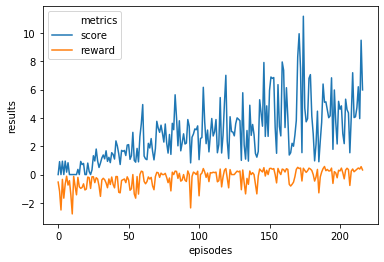

Max Train Score 20 Max Test Score 19
Mean Train Score 2.921812367981413 Mean Test Score 4.816331872381222
----------------------------------------------------------------------------------------------------
Learning Rate 0.0009


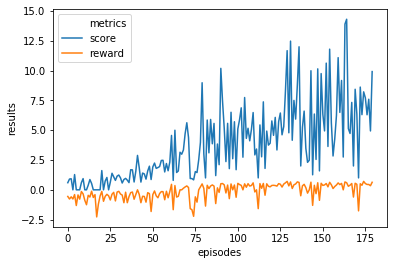

Max Train Score 30 Max Test Score 30
Mean Train Score 3.816158348101749 Mean Test Score 6.161774046933141
----------------------------------------------------------------------------------------------------
Learning Rate 0.00085


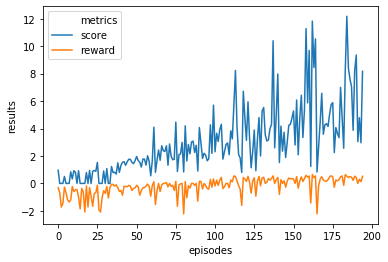

Max Train Score 22 Max Test Score 24
Mean Train Score 3.0114649037106505 Mean Test Score 5.371177936499297
----------------------------------------------------------------------------------------------------
Learning Rate 0.00082


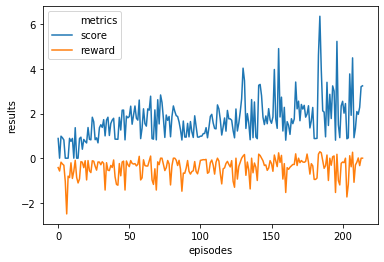

Max Train Score 11 Max Test Score 20
Mean Train Score 1.7138192024362666 Mean Test Score 2.8235308868899787
----------------------------------------------------------------------------------------------------
Learning Rate 0.0008


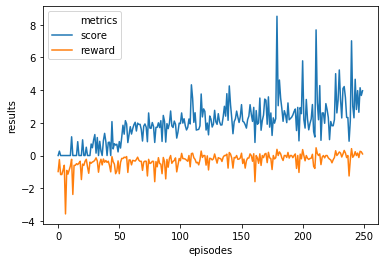

Max Train Score 16 Max Test Score 21
Mean Train Score 1.979997897954961 Mean Test Score 3.7126448840691366
----------------------------------------------------------------------------------------------------
Learning rate max results  9


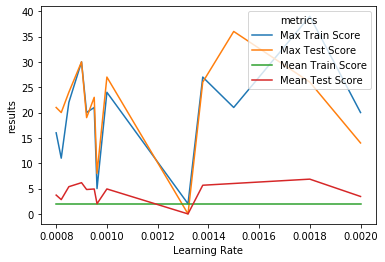

----------------------------------------------------------------------------------------------------
Using cpu device
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 92.9     |
|    ep_rew_mean        | -44.7    |
| time/                 |          |
|    fps                | 431      |
|    iterations         | 1000     |
|    time_elapsed       | 11       |
|    total_timesteps    | 5000     |
| train/                |          |
|    entropy_loss       | -0.86    |
|    explained_variance | -0.441   |
|    learning_rate      | 0.000961 |
|    n_updates          | 999      |
|    policy_loss        | -0.0299  |
|    value_loss         | 0.000476 |
------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 79.4     |
|    ep_rew_mean        | -20.1    |
| time/                 |          |
|    fps                | 418      |
|    iterations         | 2000 

------------------------------------
| rollout/              |          |
|    ep_len_mean        | 107      |
|    ep_rew_mean        | -26.5    |
| time/                 |          |
|    fps                | 430      |
|    iterations         | 2000     |
|    time_elapsed       | 23       |
|    total_timesteps    | 10000    |
| train/                |          |
|    entropy_loss       | -0.229   |
|    explained_variance | 0.248    |
|    learning_rate      | 0.001    |
|    n_updates          | 1999     |
|    policy_loss        | -0.00442 |
|    value_loss         | 0.00206  |
------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 97.5     |
|    ep_rew_mean        | -11.6    |
| time/                 |          |
|    fps                | 429      |
|    iterations         | 3000     |
|    time_elapsed       | 34       |
|    total_timesteps    | 15000    |
| train/                |          |
|

------------------------------------
| rollout/              |          |
|    ep_len_mean        | 100      |
|    ep_rew_mean        | -17      |
| time/                 |          |
|    fps                | 441      |
|    iterations         | 3000     |
|    time_elapsed       | 33       |
|    total_timesteps    | 15000    |
| train/                |          |
|    entropy_loss       | -0.00708 |
|    explained_variance | -0.0305  |
|    learning_rate      | 0.002    |
|    n_updates          | 2999     |
|    policy_loss        | 4.7e-06  |
|    value_loss         | 0.000526 |
------------------------------------
-------------------------------------
| rollout/              |           |
|    ep_len_mean        | 101       |
|    ep_rew_mean        | -13.1     |
| time/                 |           |
|    fps                | 437       |
|    iterations         | 4000      |
|    time_elapsed       | 45        |
|    total_timesteps    | 20000     |
| train/                |    

------------------------------------
| rollout/              |          |
|    ep_len_mean        | 119      |
|    ep_rew_mean        | 40.5     |
| time/                 |          |
|    fps                | 428      |
|    iterations         | 4000     |
|    time_elapsed       | 46       |
|    total_timesteps    | 20000    |
| train/                |          |
|    entropy_loss       | -0.00713 |
|    explained_variance | 0.468    |
|    learning_rate      | 0.0009   |
|    n_updates          | 3999     |
|    policy_loss        | 0.000433 |
|    value_loss         | 12.1     |
------------------------------------
Using cpu device
-------------------------------------
| rollout/              |           |
|    ep_len_mean        | 172       |
|    ep_rew_mean        | -45.2     |
| time/                 |           |
|    fps                | 443       |
|    iterations         | 1000      |
|    time_elapsed       | 11        |
|    total_timesteps    | 5000      |
| train/    

Learning Rate 0.0009610612889534735


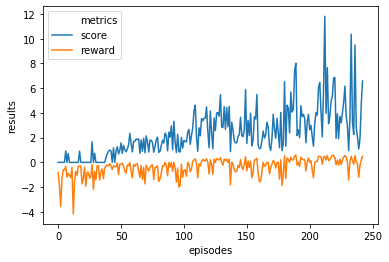

Max Train Score 22 Max Test Score 22
Mean Train Score 2.3478701946479044 Mean Test Score 5.0137495085262165
----------------------------------------------------------------------------------------------------
Learning Rate 0.0013779226379577784


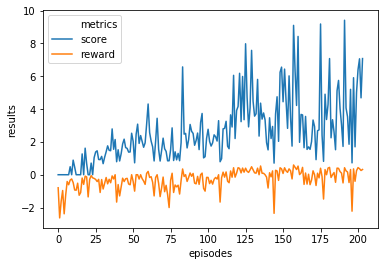

Max Train Score 18 Max Test Score 21
Mean Train Score 2.6258173790431543 Mean Test Score 4.385880819119995
----------------------------------------------------------------------------------------------------
Learning Rate 0.0013197979371411934


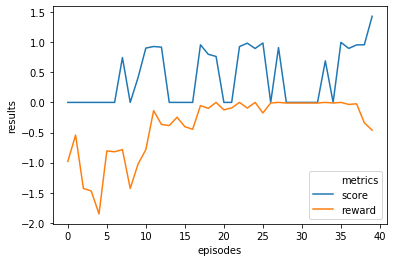

Max Train Score 3 Max Test Score 3
Mean Train Score 0.42624362449611686 Mean Test Score 1.4479778012500966
----------------------------------------------------------------------------------------------------
Learning Rate 0.001


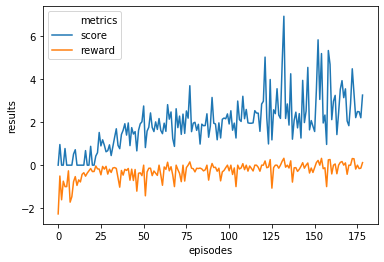

Max Train Score 13 Max Test Score 12
Mean Train Score 1.9533541412893933 Mean Test Score 3.163116971986063
----------------------------------------------------------------------------------------------------
Learning Rate 0.0015


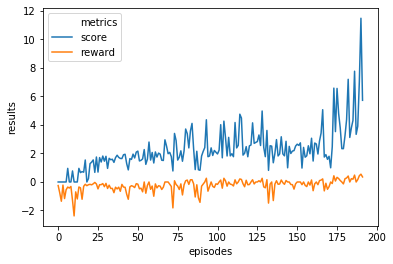

Max Train Score 21 Max Test Score 23
Mean Train Score 2.268020580502443 Mean Test Score 5.5999469826538215
----------------------------------------------------------------------------------------------------
Learning Rate 0.0018


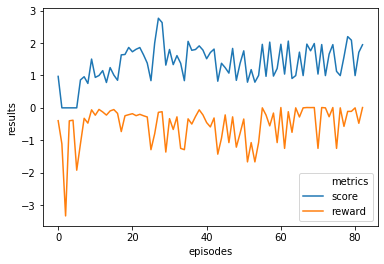

Max Train Score 5 Max Test Score 4
Mean Train Score 1.3648667967112325 Mean Test Score 1.3732711144262486
----------------------------------------------------------------------------------------------------
Learning Rate 0.002


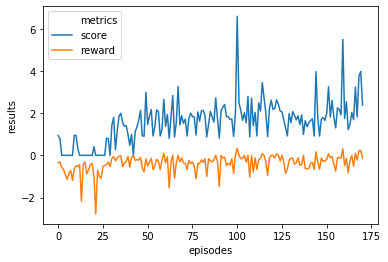

Max Train Score 12 Max Test Score 12
Mean Train Score 1.5720503029994362 Mean Test Score 2.18116828421709
----------------------------------------------------------------------------------------------------
Learning Rate 0.00095


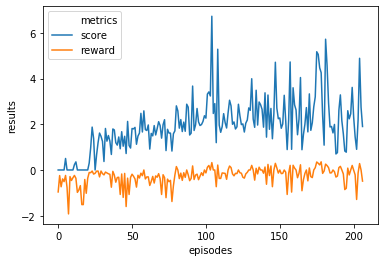

Max Train Score 12 Max Test Score 11
Mean Train Score 1.9445202294352826 Mean Test Score 2.7493590053238943
----------------------------------------------------------------------------------------------------
Learning Rate 0.00092


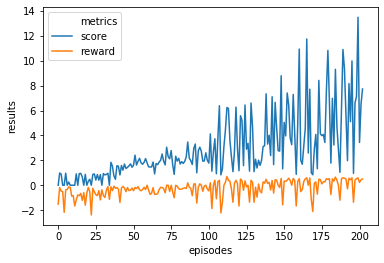

Max Train Score 25 Max Test Score 29
Mean Train Score 2.9338089094781945 Mean Test Score 5.887924100999171
----------------------------------------------------------------------------------------------------
Learning Rate 0.0009


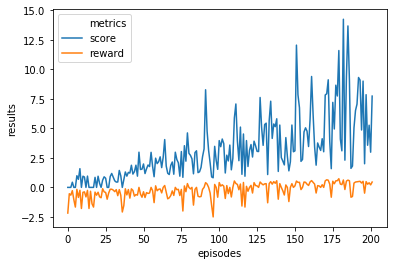

Max Train Score 30 Max Test Score 23
Mean Train Score 3.1694100357567567 Mean Test Score 5.113510227200706
----------------------------------------------------------------------------------------------------
Learning Rate 0.00085


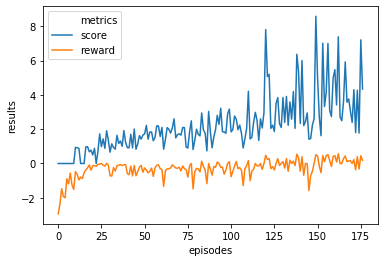

Max Train Score 18 Max Test Score 30
Mean Train Score 2.2200071475706524 Mean Test Score 4.9197855421060614
----------------------------------------------------------------------------------------------------
Learning Rate 0.00082


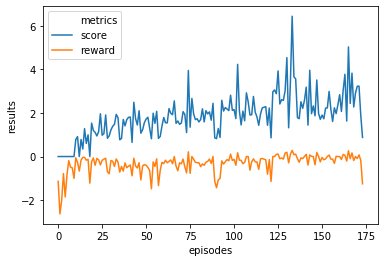

Max Train Score 12 Max Test Score 20
Mean Train Score 1.865384394146104 Mean Test Score 3.557094874591312
----------------------------------------------------------------------------------------------------
Learning Rate 0.0008


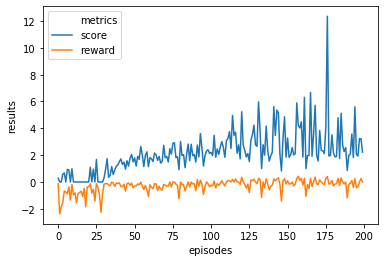

Max Train Score 23 Max Test Score 18
Mean Train Score 2.175583582362003 Mean Test Score 3.428967162484743
----------------------------------------------------------------------------------------------------
Learning rate max results  10


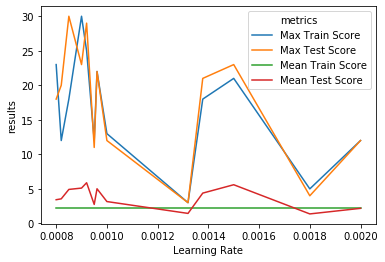

----------------------------------------------------------------------------------------------------


In [ ]:
learning_rates=[0.0009610612889534735,0.0013779226379577784,0.0013197979371411934,0.001,0.0015,0.0018,0.002,0.00095,0.00092,0.0009,0.00085,0.00082,0.0008]
for i in range(10):
    results = {}
    for learning_rate in learning_rates:
        # enable_render=True turns on the display
        snake_env = SnakeEnv(440, 440, enable_render=False)
        env = make_vec_env(lambda: snake_env, n_envs=1)

        #gamma = random.uniform(0.95, 1)
        #learning_rate=random.uniform(0.0005,0.0014)
        #print("lr: ", learning_rate)

        model = A2C(MlpPolicy, env, verbose=1, learning_rate=learning_rate,gamma=0.97)#, seed=42)#, gamma=gamma)
        model.learn(total_timesteps=20000, log_interval=1000)

        # Print rewards and scores for each episode
        max_train_score = snake_env.record
        mean_train_score = np.mean(np.array(snake_env.results['score']))
        max_test_score, mean_test_score = evaluate(model)

        results[learning_rate] = (snake_env.results, max_train_score, max_test_score, mean_train_score, mean_test_score)

    for learning_rate, result in results.items():
        metrics, max_train_score, max_test_score, mean_train_score, mean_test_score = result

        print("Learning Rate", learning_rate)
        plot_metrics(metrics)    
        print("Max Train Score", max_train_score, "Max Test Score", max_test_score)
        print("Mean Train Score", mean_train_score, "Mean Test Score", mean_test_score)
        print("-"*100)
    
    print("Learning rate max results ", i+1)
    plot_max_results(results,'Learning Rate')
    print("-"*100)

#### Result: os resultados sao sempre diferentes mas em media o 0.001 è bom

### Final Result: 0.001 is a good value

# Testando: use_rms_prop (Adam optimizer)

In [ ]:
results = {}
for _ in range(10):
    # enable_render=True turns on the display
    snake_env = SnakeEnv(440, 440, enable_render=False)
    env = make_vec_env(lambda: snake_env, n_envs=1)

    #gamma = random.uniform(0.95, 1)
    #learning_rate=random.uniform(0.001,0.1)
    learning_rate=random.uniform(0.0002,0.002)
    #learning_rate=1e-3

    model = A2C(MlpPolicy, env, verbose=1, learning_rate=learning_rate, seed=42,use_rms_prop=False)#, gamma=gamma, normalize_advantage=True)
    model.learn(total_timesteps=20000, log_interval=1000)

    # Print rewards and scores for each episode
    max_train_score = snake_env.record
    mean_train_score = np.mean(np.array(snake_env.results['score']))
    max_test_score, mean_test_score = evaluate(model)

    results[learning_rate] = (snake_env.results, max_train_score, max_test_score, mean_train_score, mean_test_score)

Using cpu device
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 107      |
|    ep_rew_mean        | -25.2    |
| time/                 |          |
|    fps                | 425      |
|    iterations         | 1000     |
|    time_elapsed       | 11       |
|    total_timesteps    | 5000     |
| train/                |          |
|    entropy_loss       | -0.0857  |
|    explained_variance | -96.8    |
|    learning_rate      | 0.00189  |
|    n_updates          | 999      |
|    policy_loss        | 0.0172   |
|    value_loss         | 17.3     |
------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 114      |
|    ep_rew_mean        | 5.06     |
| time/                 |          |
|    fps                | 421      |
|    iterations         | 2000     |
|    time_elapsed       | 23       |
|    total_timesteps    | 10000    |
| train/             

------------------------------------
| rollout/              |          |
|    ep_len_mean        | 86.9     |
|    ep_rew_mean        | -1.7     |
| time/                 |          |
|    fps                | 405      |
|    iterations         | 2000     |
|    time_elapsed       | 24       |
|    total_timesteps    | 10000    |
| train/                |          |
|    entropy_loss       | -0.0216  |
|    explained_variance | nan      |
|    learning_rate      | 0.00106  |
|    n_updates          | 1999     |
|    policy_loss        | -0.00193 |
|    value_loss         | 0.443    |
------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 110      |
|    ep_rew_mean        | 24.6     |
| time/                 |          |
|    fps                | 404      |
|    iterations         | 3000     |
|    time_elapsed       | 37       |
|    total_timesteps    | 15000    |
| train/                |          |
|

------------------------------------
| rollout/              |          |
|    ep_len_mean        | 116      |
|    ep_rew_mean        | 32.9     |
| time/                 |          |
|    fps                | 420      |
|    iterations         | 3000     |
|    time_elapsed       | 35       |
|    total_timesteps    | 15000    |
| train/                |          |
|    entropy_loss       | -0.00998 |
|    explained_variance | 0.327    |
|    learning_rate      | 0.000881 |
|    n_updates          | 2999     |
|    policy_loss        | 0.000585 |
|    value_loss         | 0.245    |
------------------------------------
-------------------------------------
| rollout/              |           |
|    ep_len_mean        | 153       |
|    ep_rew_mean        | 47.5      |
| time/                 |           |
|    fps                | 423       |
|    iterations         | 4000      |
|    time_elapsed       | 47        |
|    total_timesteps    | 20000     |
| train/                |    

------------------------------------
| rollout/              |          |
|    ep_len_mean        | 178      |
|    ep_rew_mean        | -5.2     |
| time/                 |          |
|    fps                | 379      |
|    iterations         | 4000     |
|    time_elapsed       | 52       |
|    total_timesteps    | 20000    |
| train/                |          |
|    entropy_loss       | -0.0143  |
|    explained_variance | -1.39    |
|    learning_rate      | 0.000839 |
|    n_updates          | 3999     |
|    policy_loss        | 0.0106   |
|    value_loss         | 21       |
------------------------------------


Learning Rate 0.0018854050053594355


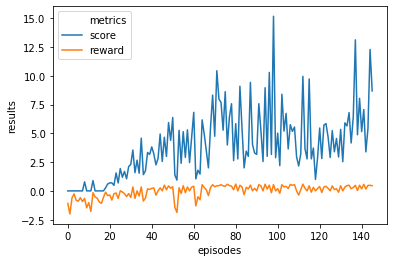

Max Train Score 26 Max Test Score 20
Mean Train Score 3.9244074748073814 Mean Test Score 5.441752731710941
----------------------------------------------------------------------------------------------------
Learning Rate 0.0017699823520155055


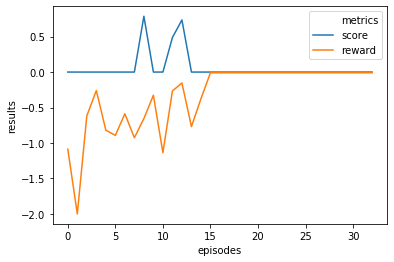

Max Train Score 1 Max Test Score 0
Mean Train Score 0.06085355446011184 Mean Test Score 0.0
----------------------------------------------------------------------------------------------------
Learning Rate 0.000601779328667881


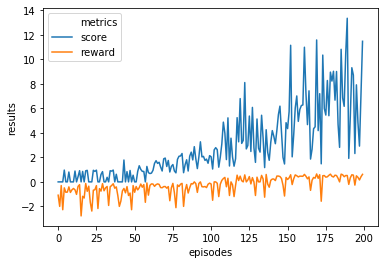

Max Train Score 26 Max Test Score 26
Mean Train Score 2.9265949856747424 Mean Test Score 7.42731729970182
----------------------------------------------------------------------------------------------------
Learning Rate 0.0010582520748696454


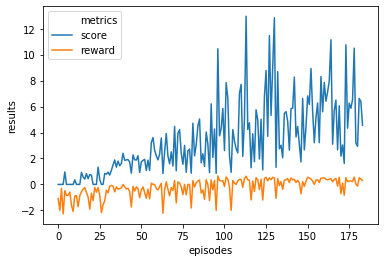

Max Train Score 24 Max Test Score 25
Mean Train Score 3.4040046431628763 Mean Test Score 6.037803191222612
----------------------------------------------------------------------------------------------------
Learning Rate 0.00046268267716378616


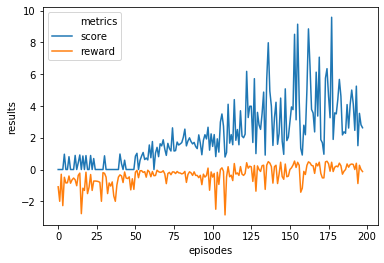

Max Train Score 19 Max Test Score 19
Mean Train Score 2.108762940411853 Mean Test Score 4.75381546219258
----------------------------------------------------------------------------------------------------
Learning Rate 0.001578489829262681


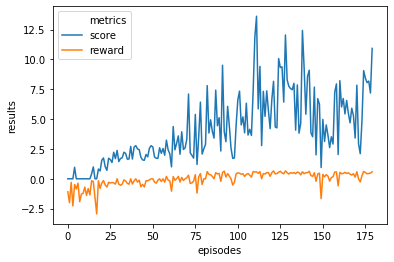

Max Train Score 25 Max Test Score 35
Mean Train Score 4.079537577197181 Mean Test Score 7.695902112336821
----------------------------------------------------------------------------------------------------
Learning Rate 0.0008810913946649566


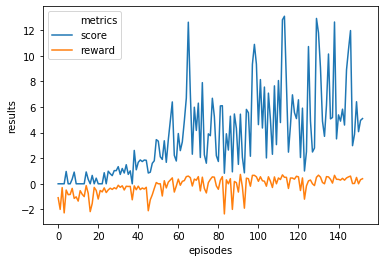

Max Train Score 26 Max Test Score 29
Mean Train Score 3.8026137519273076 Mean Test Score 6.23157472871962
----------------------------------------------------------------------------------------------------
Learning Rate 0.0011929584096402625


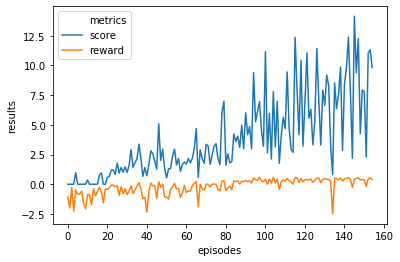

Max Train Score 27 Max Test Score 35
Mean Train Score 3.8004460472737702 Mean Test Score 7.700752477403204
----------------------------------------------------------------------------------------------------
Learning Rate 0.0012177160386409554


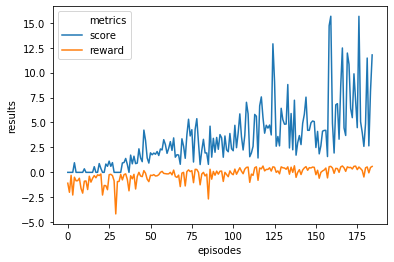

Max Train Score 34 Max Test Score 37
Mean Train Score 3.3916055758650607 Mean Test Score 8.146916689551562
----------------------------------------------------------------------------------------------------
Learning Rate 0.0008390158750072813


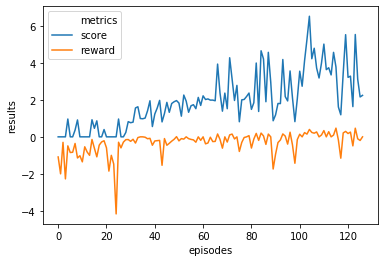

Max Train Score 12 Max Test Score 12
Mean Train Score 1.9322072255165719 Mean Test Score 3.659746420564364
----------------------------------------------------------------------------------------------------


In [ ]:
for learning_rate, result in results.items():
    metrics, max_train_score, max_test_score, mean_train_score, mean_test_score = result
    
    print("Learning Rate", learning_rate)
    plot_metrics(metrics)    
    print("Max Train Score", max_train_score, "Max Test Score", max_test_score)
    print("Mean Train Score", mean_train_score, "Mean Test Score", mean_test_score)
    print("-"*100)

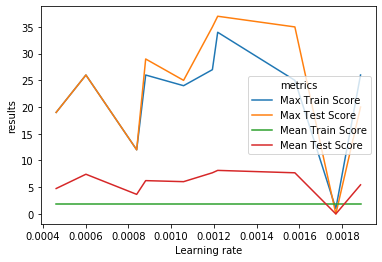

In [ ]:
plot_max_results(results,'Learning rate')

#### Result: TO DO
OLD: the range (0.0005,0.00125) is a good range, and seems that Adam Optimization is not so better than the default one

# Testando: n_eval_episode

## n_eval_episode range (1000,10000)

In [ ]:
results = {}
for _ in range(10):
    # enable_render=True turns on the display
    snake_env = SnakeEnv(440, 440, enable_render=False)
    env = make_vec_env(lambda: snake_env, n_envs=1)

    #entropy = random.uniform(0, 0.1)
    
    n_eval_episode = random.uniform(1000,10000)
    
    #gamma=0.97 is the best one?
    #leaning_rate=??? see the best result from previous test
    model = A2C(MlpPolicy, env, verbose=1, learning_rate=1e-3, gamma=0.97)#seed=42, gamma=0.97)#, ent_coef=entropy)
    model.learn(total_timesteps=20000, log_interval=1000, n_eval_episodes=n_eval_episode)

    # Print rewards and scores for each episode
    max_train_score = snake_env.record
    mean_train_score = np.mean(np.array(snake_env.results['score']))
    max_test_score, mean_test_score = evaluate(model)
    
    results[n_eval_episode] = (snake_env.results, max_train_score, max_test_score, mean_train_score, mean_test_score)

Using cpu device
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 92.7     |
|    ep_rew_mean        | -43      |
| time/                 |          |
|    fps                | 419      |
|    iterations         | 1000     |
|    time_elapsed       | 11       |
|    total_timesteps    | 5000     |
| train/                |          |
|    entropy_loss       | -0.739   |
|    explained_variance | -0.132   |
|    learning_rate      | 0.001    |
|    n_updates          | 999      |
|    policy_loss        | 0.16     |
|    value_loss         | 0.109    |
------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 89       |
|    ep_rew_mean        | -25.4    |
| time/                 |          |
|    fps                | 419      |
|    iterations         | 2000     |
|    time_elapsed       | 23       |
|    total_timesteps    | 10000    |
| train/             

------------------------------------
| rollout/              |          |
|    ep_len_mean        | 81.2     |
|    ep_rew_mean        | -18.2    |
| time/                 |          |
|    fps                | 412      |
|    iterations         | 2000     |
|    time_elapsed       | 24       |
|    total_timesteps    | 10000    |
| train/                |          |
|    entropy_loss       | -0.0667  |
|    explained_variance | -299     |
|    learning_rate      | 0.001    |
|    n_updates          | 1999     |
|    policy_loss        | -47.2    |
|    value_loss         | 519      |
------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 84.9     |
|    ep_rew_mean        | -8.5     |
| time/                 |          |
|    fps                | 409      |
|    iterations         | 3000     |
|    time_elapsed       | 36       |
|    total_timesteps    | 15000    |
| train/                |          |
|

------------------------------------
| rollout/              |          |
|    ep_len_mean        | 138      |
|    ep_rew_mean        | -8.2     |
| time/                 |          |
|    fps                | 441      |
|    iterations         | 3000     |
|    time_elapsed       | 33       |
|    total_timesteps    | 15000    |
| train/                |          |
|    entropy_loss       | -0.0339  |
|    explained_variance | 0.827    |
|    learning_rate      | 0.001    |
|    n_updates          | 2999     |
|    policy_loss        | -0.00194 |
|    value_loss         | 1.35     |
------------------------------------
-------------------------------------
| rollout/              |           |
|    ep_len_mean        | 119       |
|    ep_rew_mean        | 6.4       |
| time/                 |           |
|    fps                | 441       |
|    iterations         | 4000      |
|    time_elapsed       | 45        |
|    total_timesteps    | 20000     |
| train/                |    

------------------------------------
| rollout/              |          |
|    ep_len_mean        | 471      |
|    ep_rew_mean        | -31      |
| time/                 |          |
|    fps                | 463      |
|    iterations         | 4000     |
|    time_elapsed       | 43       |
|    total_timesteps    | 20000    |
| train/                |          |
|    entropy_loss       | -0.0012  |
|    explained_variance | -1.09    |
|    learning_rate      | 0.001    |
|    n_updates          | 3999     |
|    policy_loss        | 8.1e-08  |
|    value_loss         | 1.36e-05 |
------------------------------------


n_eval_episode 1060.9063248292437


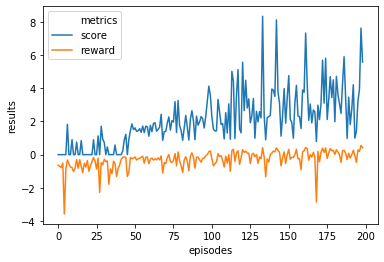

Max Train Score 16 Max Test Score 13
Mean Train Score 2.0898896991626246 Mean Test Score 3.187784148027344
----------------------------------------------------------------------------------------------------
n_eval_episode 4196.250807262621


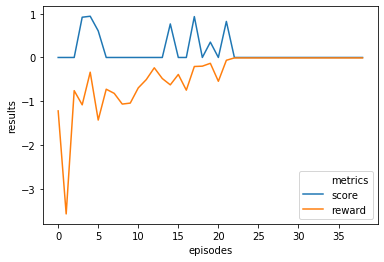

Max Train Score 1 Max Test Score 0
Mean Train Score 0.13688555496004995 Mean Test Score 0.0
----------------------------------------------------------------------------------------------------
n_eval_episode 4682.8968149621305


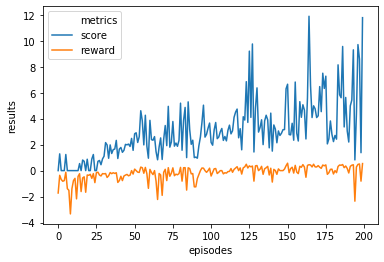

Max Train Score 22 Max Test Score 25
Mean Train Score 3.0261254574493948 Mean Test Score 6.302873806614484
----------------------------------------------------------------------------------------------------
n_eval_episode 5252.870523315611


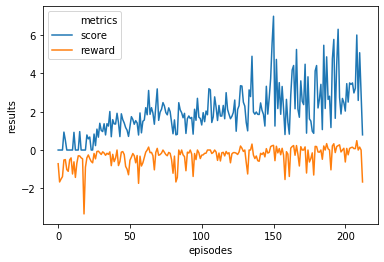

Max Train Score 13 Max Test Score 16
Mean Train Score 1.9980517964541136 Mean Test Score 3.614921331622629
----------------------------------------------------------------------------------------------------
n_eval_episode 5828.077172977617


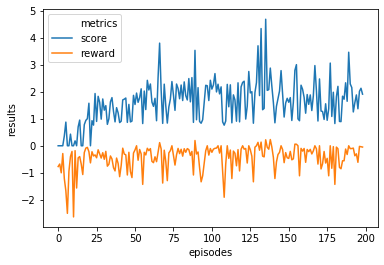

Max Train Score 9 Max Test Score 9
Mean Train Score 1.5972472381079457 Mean Test Score 1.8650293861700171
----------------------------------------------------------------------------------------------------
n_eval_episode 6781.718118639386


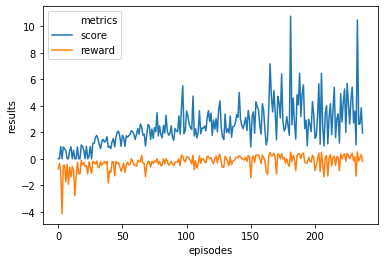

Max Train Score 19 Max Test Score 13
Mean Train Score 2.4585067779554555 Mean Test Score 3.430991544242761
----------------------------------------------------------------------------------------------------
n_eval_episode 1812.2743965976065


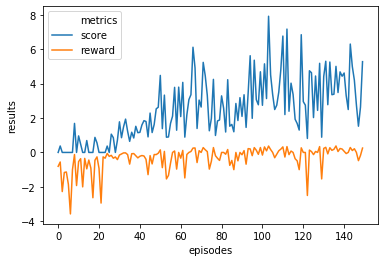

Max Train Score 14 Max Test Score 17
Mean Train Score 2.4512234205179424 Mean Test Score 3.4028229713267706
----------------------------------------------------------------------------------------------------
n_eval_episode 3036.317449727275


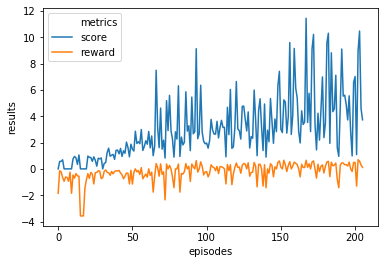

Max Train Score 23 Max Test Score 25
Mean Train Score 3.0425298803543503 Mean Test Score 6.702845912549968
----------------------------------------------------------------------------------------------------
n_eval_episode 4823.976856091731


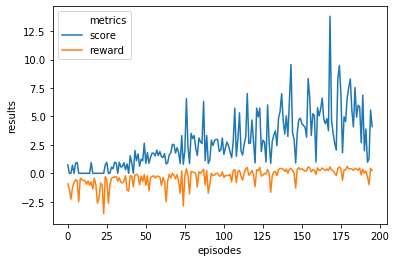

Max Train Score 26 Max Test Score 17
Mean Train Score 2.7827104909327893 Mean Test Score 4.476290751525235
----------------------------------------------------------------------------------------------------
n_eval_episode 6858.1985443895


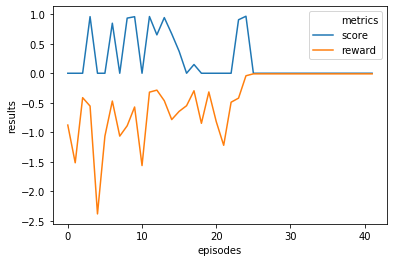

Max Train Score 1 Max Test Score 0
Mean Train Score 0.2215167964678239 Mean Test Score 0.0
----------------------------------------------------------------------------------------------------


In [ ]:
for n_eval_episode, result in results.items():
    metrics, max_train_score, max_test_score, mean_train_score, mean_test_score = result
    
    print("n_eval_episode", n_eval_episode)
    plot_metrics(metrics)    
    print("Max Train Score", max_train_score, "Max Test Score", max_test_score)
    print("Mean Train Score", mean_train_score, "Mean Test Score", mean_test_score)
    print("-"*100)

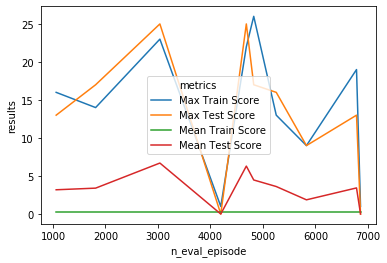

In [ ]:
plot_max_results(results,'n_eval_episode')

#### Result: parece bom um n_eval_episodes entre 1000 e 4000

## n_eval_episodes range  (1000,4000)

In [ ]:
results = {}
for _ in range(10):
    # enable_render=True turns on the display
    snake_env = SnakeEnv(440, 440, enable_render=False)
    env = make_vec_env(lambda: snake_env, n_envs=1)

    #entropy = random.uniform(0, 0.1)
    
    n_eval_episode = random.uniform(1000,4000)
    
    #gamma=0.97 is the best one?
    #leaning_rate=??? see the best result from previous test
    model = A2C(MlpPolicy, env, verbose=1, learning_rate=1e-3, gamma=0.97)#seed=42, gamma=0.97)#, ent_coef=entropy)
    model.learn(total_timesteps=20000, log_interval=1000, n_eval_episodes=n_eval_episode)

    # Print rewards and scores for each episode
    max_train_score = snake_env.record
    mean_train_score = np.mean(np.array(snake_env.results['score']))
    max_test_score, mean_test_score = evaluate(model)
    
    results[n_eval_episode] = (snake_env.results, max_train_score, max_test_score, mean_train_score, mean_test_score)

In [ ]:
for n_eval_episode, result in results.items():
    metrics, max_train_score, max_test_score, mean_train_score, mean_test_score = result
    
    print("n_eval_episode", n_eval_episode)
    plot_metrics(metrics)    
    print("Max Train Score", max_train_score, "Max Test Score", max_test_score)
    print("Mean Train Score", mean_train_score, "Mean Test Score", mean_test_score)
    print("-"*100)

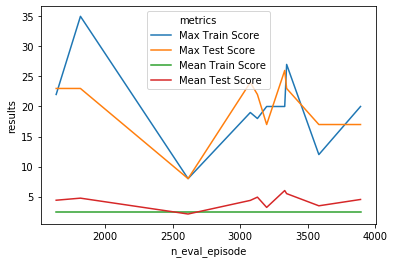

In [ ]:
plot_max_results(results,'n_eval_episode')

#### Result: entre 3000 e 3500 è bom, e entre 1000 e 1250

## n_eval_episode ranges (1000,1250),(3000,3500)

In [ ]:
results = {}
for i in range(10):
    # enable_render=True turns on the display
    snake_env = SnakeEnv(440, 440, enable_render=False)
    env = make_vec_env(lambda: snake_env, n_envs=1)

    #entropy = random.uniform(0, 0.1)
    if i < 5:
        n_eval_episode = random.uniform(1000,1250)
    else:
        n_eval_episode = random.uniform(3000,3500)
    
    #gamma=0.97 is the best one?
    #leaning_rate=??? see the best result from previous test
    model = A2C(MlpPolicy, env, verbose=1, learning_rate=1e-3, gamma=0.97)#seed=42, gamma=0.97)#, ent_coef=entropy)
    model.learn(total_timesteps=20000, log_interval=1000, n_eval_episodes=n_eval_episode)

    # Print rewards and scores for each episode
    max_train_score = snake_env.record
    mean_train_score = np.mean(np.array(snake_env.results['score']))
    max_test_score, mean_test_score = evaluate(model)
    
    results[n_eval_episode] = (snake_env.results, max_train_score, max_test_score, mean_train_score, mean_test_score)

Using cpu device
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 65.3     |
|    ep_rew_mean        | -30.1    |
| time/                 |          |
|    fps                | 339      |
|    iterations         | 1000     |
|    time_elapsed       | 14       |
|    total_timesteps    | 5000     |
| train/                |          |
|    entropy_loss       | -0.0695  |
|    explained_variance | 0.515    |
|    learning_rate      | 0.001    |
|    n_updates          | 999      |
|    policy_loss        | 0.0685   |
|    value_loss         | 27.5     |
------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 77.2     |
|    ep_rew_mean        | 0.1      |
| time/                 |          |
|    fps                | 370      |
|    iterations         | 2000     |
|    time_elapsed       | 26       |
|    total_timesteps    | 10000    |
| train/             

------------------------------------
| rollout/              |          |
|    ep_len_mean        | 112      |
|    ep_rew_mean        | -21.9    |
| time/                 |          |
|    fps                | 418      |
|    iterations         | 2000     |
|    time_elapsed       | 23       |
|    total_timesteps    | 10000    |
| train/                |          |
|    entropy_loss       | -0.521   |
|    explained_variance | 0.935    |
|    learning_rate      | 0.001    |
|    n_updates          | 1999     |
|    policy_loss        | -0.0815  |
|    value_loss         | 0.723    |
------------------------------------
-------------------------------------
| rollout/              |           |
|    ep_len_mean        | 74        |
|    ep_rew_mean        | 1.6       |
| time/                 |           |
|    fps                | 414       |
|    iterations         | 3000      |
|    time_elapsed       | 36        |
|    total_timesteps    | 15000     |
| train/                |    

------------------------------------
| rollout/              |          |
|    ep_len_mean        | 104      |
|    ep_rew_mean        | -16.2    |
| time/                 |          |
|    fps                | 430      |
|    iterations         | 3000     |
|    time_elapsed       | 34       |
|    total_timesteps    | 15000    |
| train/                |          |
|    entropy_loss       | -0.0782  |
|    explained_variance | -0.488   |
|    learning_rate      | 0.001    |
|    n_updates          | 2999     |
|    policy_loss        | -8.3e-10 |
|    value_loss         | 1.15e-15 |
------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 134      |
|    ep_rew_mean        | -9.1     |
| time/                 |          |
|    fps                | 427      |
|    iterations         | 4000     |
|    time_elapsed       | 46       |
|    total_timesteps    | 20000    |
| train/                |          |
|

------------------------------------
| rollout/              |          |
|    ep_len_mean        | 77.8     |
|    ep_rew_mean        | -8.7     |
| time/                 |          |
|    fps                | 429      |
|    iterations         | 4000     |
|    time_elapsed       | 46       |
|    total_timesteps    | 20000    |
| train/                |          |
|    entropy_loss       | -0.0215  |
|    explained_variance | nan      |
|    learning_rate      | 0.001    |
|    n_updates          | 3999     |
|    policy_loss        | -0.00305 |
|    value_loss         | 1.1      |
------------------------------------


n_eval_episode 1203.1327284748795


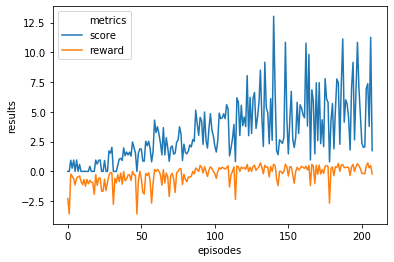

Max Train Score 25 Max Test Score 33
Mean Train Score 3.294925682300151 Mean Test Score 6.162779992456766
----------------------------------------------------------------------------------------------------
n_eval_episode 1233.7473038308488


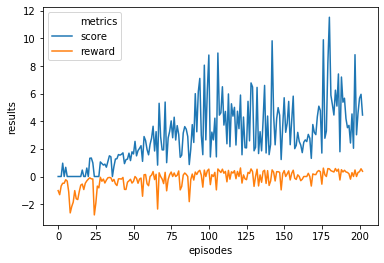

Max Train Score 21 Max Test Score 19
Mean Train Score 3.008742048728395 Mean Test Score 4.500917704704374
----------------------------------------------------------------------------------------------------
n_eval_episode 1197.6791570838268


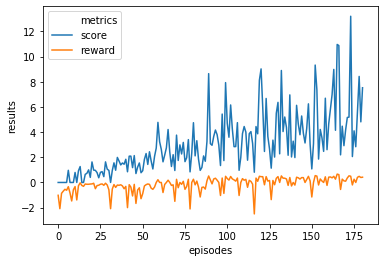

Max Train Score 24 Max Test Score 22
Mean Train Score 3.0480970386978177 Mean Test Score 5.217087790187851
----------------------------------------------------------------------------------------------------
n_eval_episode 1043.625270880599


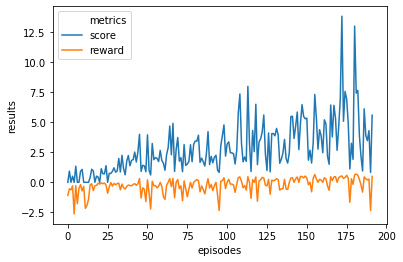

Max Train Score 27 Max Test Score 28
Mean Train Score 2.8101330271386993 Mean Test Score 4.923769738902636
----------------------------------------------------------------------------------------------------
n_eval_episode 1200.3223531027656


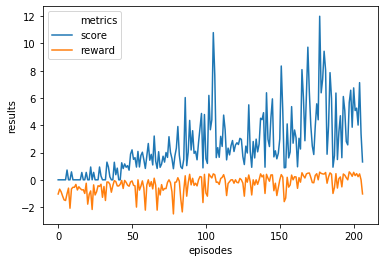

Max Train Score 23 Max Test Score 22
Mean Train Score 2.5708414584886063 Mean Test Score 4.707258649835698
----------------------------------------------------------------------------------------------------
n_eval_episode 3488.615952953791


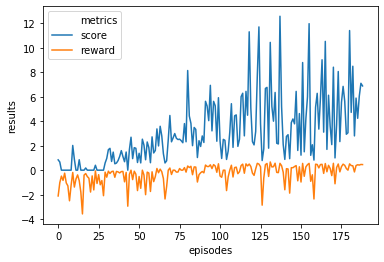

Max Train Score 24 Max Test Score 29
Mean Train Score 3.085143006224579 Mean Test Score 5.962369773307131
----------------------------------------------------------------------------------------------------
n_eval_episode 3452.730941273893


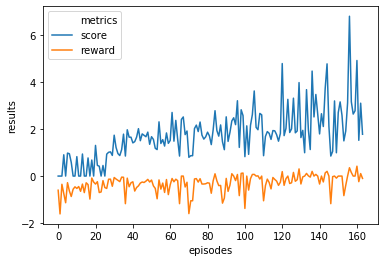

Max Train Score 12 Max Test Score 20
Mean Train Score 1.764636636613316 Mean Test Score 3.5262662623324084
----------------------------------------------------------------------------------------------------
n_eval_episode 3108.9363254735304


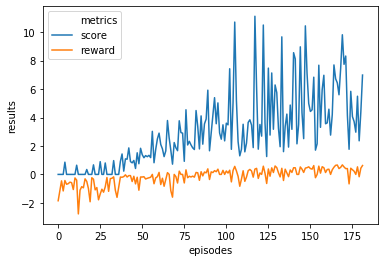

Max Train Score 21 Max Test Score 28
Mean Train Score 2.9767746963975634 Mean Test Score 6.797671326066638
----------------------------------------------------------------------------------------------------
n_eval_episode 3323.8750056461436


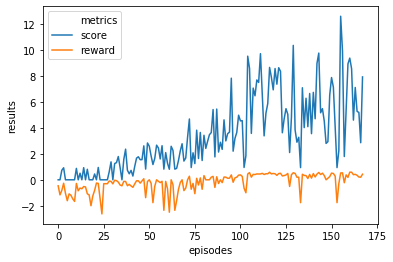

Max Train Score 24 Max Test Score 23
Mean Train Score 3.361990265250689 Mean Test Score 6.668153543366327
----------------------------------------------------------------------------------------------------
n_eval_episode 3199.6813457279045


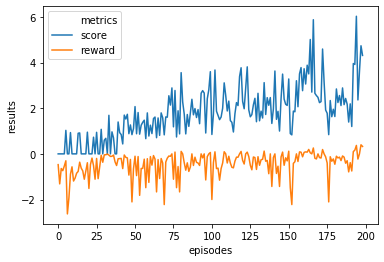

Max Train Score 12 Max Test Score 15
Mean Train Score 1.7851918048149598 Mean Test Score 3.039584063841927
----------------------------------------------------------------------------------------------------


In [ ]:
for n_eval_episode, result in results.items():
    metrics, max_train_score, max_test_score, mean_train_score, mean_test_score = result
    
    print("n_eval_episode", n_eval_episode)
    plot_metrics(metrics)    
    print("Max Train Score", max_train_score, "Max Test Score", max_test_score)
    print("Mean Train Score", mean_train_score, "Mean Test Score", mean_test_score)
    print("-"*100)

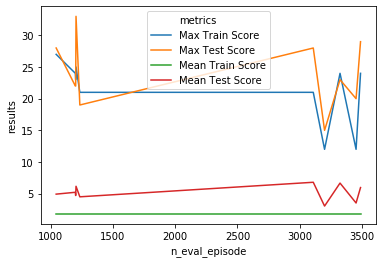

In [ ]:
plot_max_results(results,'n_eval_episode')

#### Result: the experimented range continue to be good, the value 1250 seems to be the better one

## n_eval_episode ranges (1000,1250),(3000,3500) 10 times

Using cpu device
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 160      |
|    ep_rew_mean        | -44.8    |
| time/                 |          |
|    fps                | 394      |
|    iterations         | 1000     |
|    time_elapsed       | 12       |
|    total_timesteps    | 5000     |
| train/                |          |
|    entropy_loss       | -0.987   |
|    explained_variance | -0.00914 |
|    learning_rate      | 0.001    |
|    n_updates          | 999      |
|    policy_loss        | 0.0227   |
|    value_loss         | 0.0138   |
------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 106      |
|    ep_rew_mean        | -26.8    |
| time/                 |          |
|    fps                | 385      |
|    iterations         | 2000     |
|    time_elapsed       | 25       |
|    total_timesteps    | 10000    |
| train/             

-------------------------------------
| rollout/              |           |
|    ep_len_mean        | 84.6      |
|    ep_rew_mean        | -9        |
| time/                 |           |
|    fps                | 359       |
|    iterations         | 2000      |
|    time_elapsed       | 27        |
|    total_timesteps    | 10000     |
| train/                |           |
|    entropy_loss       | -0.00596  |
|    explained_variance | nan       |
|    learning_rate      | 0.001     |
|    n_updates          | 1999      |
|    policy_loss        | -0.000929 |
|    value_loss         | 2.03      |
-------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 100      |
|    ep_rew_mean        | 18.8     |
| time/                 |          |
|    fps                | 379      |
|    iterations         | 3000     |
|    time_elapsed       | 39       |
|    total_timesteps    | 15000    |
| train/             

-------------------------------------
| rollout/              |           |
|    ep_len_mean        | 98.2      |
|    ep_rew_mean        | 10        |
| time/                 |           |
|    fps                | 428       |
|    iterations         | 3000      |
|    time_elapsed       | 34        |
|    total_timesteps    | 15000     |
| train/                |           |
|    entropy_loss       | -0.084    |
|    explained_variance | -3.17e+12 |
|    learning_rate      | 0.001     |
|    n_updates          | 2999      |
|    policy_loss        | 0.0498    |
|    value_loss         | 10.2      |
-------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 118      |
|    ep_rew_mean        | 28.8     |
| time/                 |          |
|    fps                | 432      |
|    iterations         | 4000     |
|    time_elapsed       | 46       |
|    total_timesteps    | 20000    |
| train/             

------------------------------------
| rollout/              |          |
|    ep_len_mean        | 62.9     |
|    ep_rew_mean        | -11.9    |
| time/                 |          |
|    fps                | 383      |
|    iterations         | 4000     |
|    time_elapsed       | 52       |
|    total_timesteps    | 20000    |
| train/                |          |
|    entropy_loss       | -0.225   |
|    explained_variance | 0.796    |
|    learning_rate      | 0.001    |
|    n_updates          | 3999     |
|    policy_loss        | -0.169   |
|    value_loss         | 3.96     |
------------------------------------
n_eval_episode 3016.3347704416847


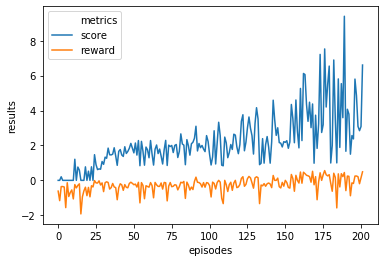

Max Train Score 16 Max Test Score 14
Mean Train Score 2.1822347108734252 Mean Test Score 3.669720805172319
----------------------------------------------------------------------------------------------------
n_eval_episode 3016.3347704416847


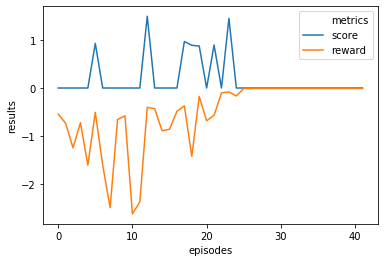

Max Train Score 2 Max Test Score 0
Mean Train Score 0.1792976258326592 Mean Test Score 0.0
----------------------------------------------------------------------------------------------------
n_eval_episode 3016.3347704416847


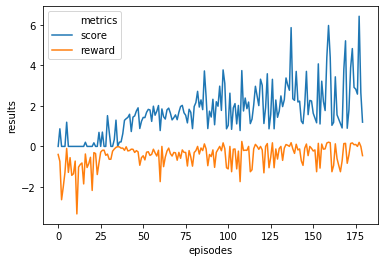

Max Train Score 13 Max Test Score 10
Mean Train Score 1.699688242498547 Mean Test Score 2.2112665306315935
----------------------------------------------------------------------------------------------------
n_eval_episode 3016.3347704416847


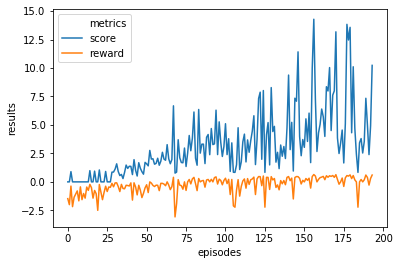

Max Train Score 27 Max Test Score 28
Mean Train Score 3.2195123406374746 Mean Test Score 6.1789803374916525
----------------------------------------------------------------------------------------------------
n_eval_episode 3016.3347704416847


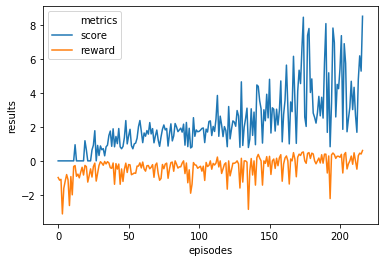

Max Train Score 17 Max Test Score 29
Mean Train Score 2.261031561584981 Mean Test Score 4.439384907265541
----------------------------------------------------------------------------------------------------
n_eval_episode 3016.3347704416847


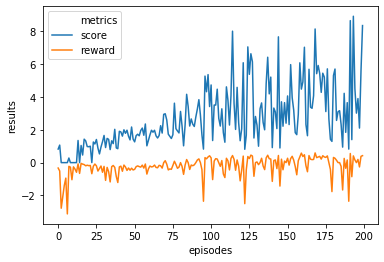

Max Train Score 16 Max Test Score 20
Mean Train Score 2.6968520822834843 Mean Test Score 3.93655557650784
----------------------------------------------------------------------------------------------------
n_eval_episode 3016.3347704416847


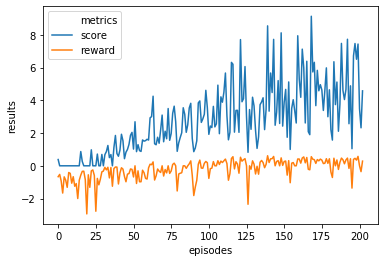

Max Train Score 18 Max Test Score 22
Mean Train Score 2.7763041461364693 Mean Test Score 4.681172129505225
----------------------------------------------------------------------------------------------------
n_eval_episode 3016.3347704416847


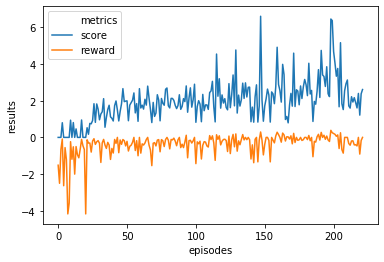

Max Train Score 12 Max Test Score 17
Mean Train Score 1.9595079448623998 Mean Test Score 2.9587904399667937
----------------------------------------------------------------------------------------------------
n_eval_episode 3016.3347704416847


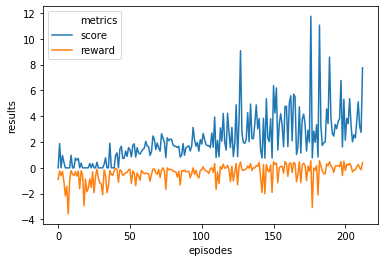

Max Train Score 25 Max Test Score 24
Mean Train Score 2.207213208498215 Mean Test Score 4.286977179254178
----------------------------------------------------------------------------------------------------
n_eval_episode 3016.3347704416847


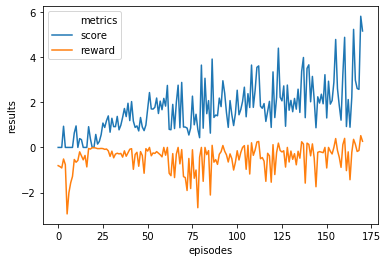

Max Train Score 10 Max Test Score 13
Mean Train Score 1.706266135674877 Mean Test Score 3.0860540783009682
----------------------------------------------------------------------------------------------------
n_eval_episode max results  10


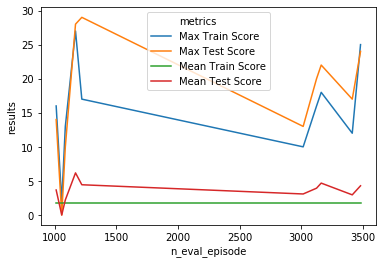

----------------------------------------------------------------------------------------------------
Using cpu device
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 84.3     |
|    ep_rew_mean        | -28.1    |
| time/                 |          |
|    fps                | 380      |
|    iterations         | 1000     |
|    time_elapsed       | 13       |
|    total_timesteps    | 5000     |
| train/                |          |
|    entropy_loss       | -0.318   |
|    explained_variance | -92.4    |
|    learning_rate      | 0.001    |
|    n_updates          | 999      |
|    policy_loss        | 0.309    |
|    value_loss         | 31.1     |
------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 72.6     |
|    ep_rew_mean        | -3.4     |
| time/                 |          |
|    fps                | 392      |
|    iterations         | 2000 

------------------------------------
| rollout/              |          |
|    ep_len_mean        | 82.8     |
|    ep_rew_mean        | -9.8     |
| time/                 |          |
|    fps                | 372      |
|    iterations         | 2000     |
|    time_elapsed       | 26       |
|    total_timesteps    | 10000    |
| train/                |          |
|    entropy_loss       | -0.047   |
|    explained_variance | 0.293    |
|    learning_rate      | 0.001    |
|    n_updates          | 1999     |
|    policy_loss        | -0.00211 |
|    value_loss         | 0.0762   |
------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 90.9     |
|    ep_rew_mean        | 11.6     |
| time/                 |          |
|    fps                | 370      |
|    iterations         | 3000     |
|    time_elapsed       | 40       |
|    total_timesteps    | 15000    |
| train/                |          |
|

------------------------------------
| rollout/              |          |
|    ep_len_mean        | 99.2     |
|    ep_rew_mean        | 22.6     |
| time/                 |          |
|    fps                | 421      |
|    iterations         | 3000     |
|    time_elapsed       | 35       |
|    total_timesteps    | 15000    |
| train/                |          |
|    entropy_loss       | -0.149   |
|    explained_variance | 0.947    |
|    learning_rate      | 0.001    |
|    n_updates          | 2999     |
|    policy_loss        | 0.0661   |
|    value_loss         | 5.74     |
------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 112      |
|    ep_rew_mean        | 35.8     |
| time/                 |          |
|    fps                | 424      |
|    iterations         | 4000     |
|    time_elapsed       | 47       |
|    total_timesteps    | 20000    |
| train/                |          |
|

------------------------------------
| rollout/              |          |
|    ep_len_mean        | 91.4     |
|    ep_rew_mean        | 12.6     |
| time/                 |          |
|    fps                | 410      |
|    iterations         | 4000     |
|    time_elapsed       | 48       |
|    total_timesteps    | 20000    |
| train/                |          |
|    entropy_loss       | -0.00696 |
|    explained_variance | nan      |
|    learning_rate      | 0.001    |
|    n_updates          | 3999     |
|    policy_loss        | 0.00117  |
|    value_loss         | 2.18     |
------------------------------------
n_eval_episode 3102.5794147363786


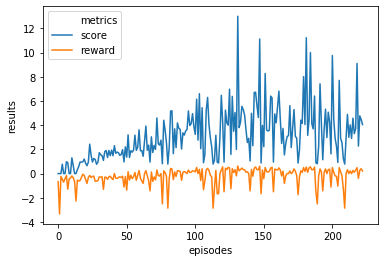

Max Train Score 24 Max Test Score 22
Mean Train Score 3.123676131646653 Mean Test Score 4.935093948365638
----------------------------------------------------------------------------------------------------
n_eval_episode 3102.5794147363786


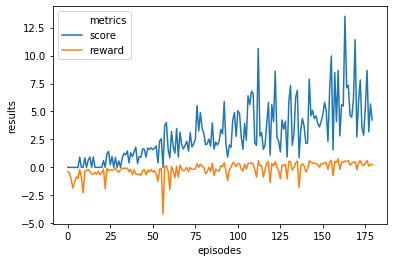

Max Train Score 25 Max Test Score 29
Mean Train Score 2.9895261431138147 Mean Test Score 4.569485777943416
----------------------------------------------------------------------------------------------------
n_eval_episode 3102.5794147363786


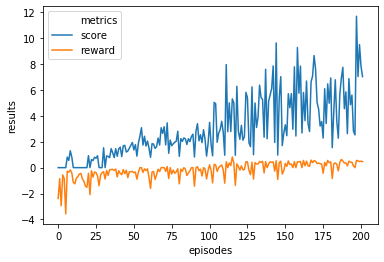

Max Train Score 23 Max Test Score 25
Mean Train Score 3.013892469528135 Mean Test Score 5.5889649178411736
----------------------------------------------------------------------------------------------------
n_eval_episode 3102.5794147363786


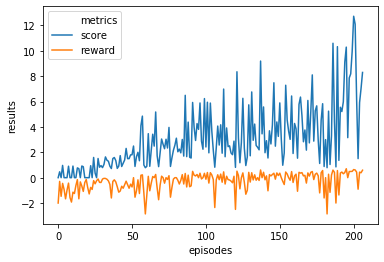

Max Train Score 24 Max Test Score 27
Mean Train Score 3.0505293616006477 Mean Test Score 5.6145886076967795
----------------------------------------------------------------------------------------------------
n_eval_episode 3102.5794147363786


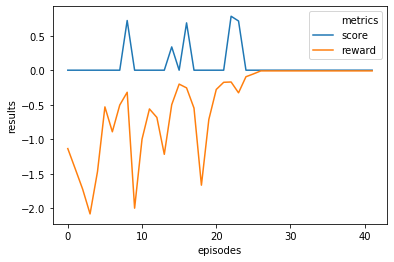

Max Train Score 1 Max Test Score 0
Mean Train Score 0.07710865409635902 Mean Test Score 0.0
----------------------------------------------------------------------------------------------------
n_eval_episode 3102.5794147363786


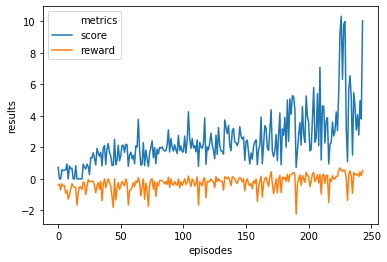

Max Train Score 20 Max Test Score 21
Mean Train Score 2.3884863986544107 Mean Test Score 4.669330781370011
----------------------------------------------------------------------------------------------------
n_eval_episode 3102.5794147363786


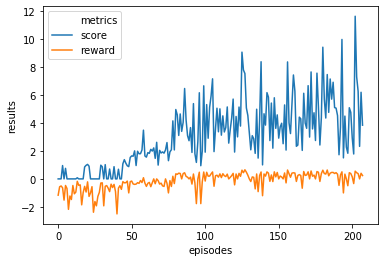

Max Train Score 21 Max Test Score 23
Mean Train Score 3.073283937521152 Mean Test Score 4.976960090670243
----------------------------------------------------------------------------------------------------
n_eval_episode 3102.5794147363786


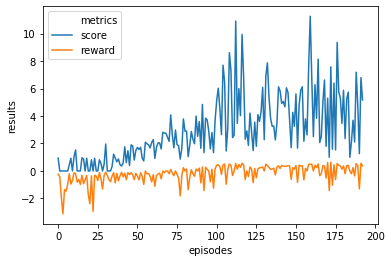

Max Train Score 21 Max Test Score 23
Mean Train Score 2.950907728254025 Mean Test Score 5.264650969310196
----------------------------------------------------------------------------------------------------
n_eval_episode 3102.5794147363786


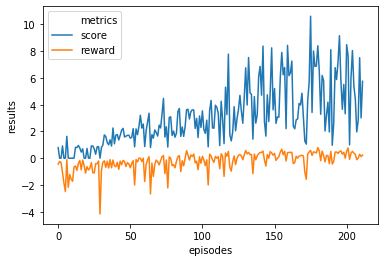

Max Train Score 22 Max Test Score 21
Mean Train Score 3.103209197997027 Mean Test Score 4.9646472109605755
----------------------------------------------------------------------------------------------------
n_eval_episode 3102.5794147363786


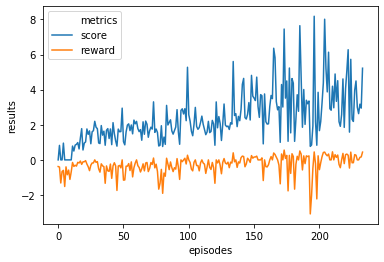

Max Train Score 16 Max Test Score 22
Mean Train Score 2.3969696041041026 Mean Test Score 5.03233739405894
----------------------------------------------------------------------------------------------------
n_eval_episode max results  10


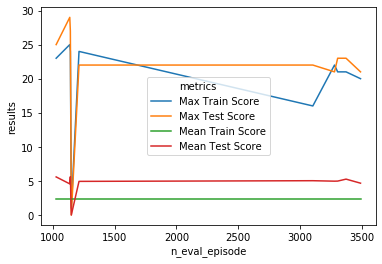

----------------------------------------------------------------------------------------------------
Using cpu device
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 116      |
|    ep_rew_mean        | -34.4    |
| time/                 |          |
|    fps                | 410      |
|    iterations         | 1000     |
|    time_elapsed       | 12       |
|    total_timesteps    | 5000     |
| train/                |          |
|    entropy_loss       | -0.326   |
|    explained_variance | -0.218   |
|    learning_rate      | 0.001    |
|    n_updates          | 999      |
|    policy_loss        | -0.052   |
|    value_loss         | 0.0129   |
------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 87.1     |
|    ep_rew_mean        | -8.9     |
| time/                 |          |
|    fps                | 411      |
|    iterations         | 2000 

-------------------------------------
| rollout/              |           |
|    ep_len_mean        | 206       |
|    ep_rew_mean        | -41.1     |
| time/                 |           |
|    fps                | 442       |
|    iterations         | 2000      |
|    time_elapsed       | 22        |
|    total_timesteps    | 10000     |
| train/                |           |
|    entropy_loss       | -0.597    |
|    explained_variance | -0.475    |
|    learning_rate      | 0.001     |
|    n_updates          | 1999      |
|    policy_loss        | -0.000875 |
|    value_loss         | 3.4e-05   |
-------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 148      |
|    ep_rew_mean        | -15.9    |
| time/                 |          |
|    fps                | 435      |
|    iterations         | 3000     |
|    time_elapsed       | 34       |
|    total_timesteps    | 15000    |
| train/             

------------------------------------
| rollout/              |          |
|    ep_len_mean        | 89.3     |
|    ep_rew_mean        | 10.4     |
| time/                 |          |
|    fps                | 410      |
|    iterations         | 3000     |
|    time_elapsed       | 36       |
|    total_timesteps    | 15000    |
| train/                |          |
|    entropy_loss       | -0.0102  |
|    explained_variance | nan      |
|    learning_rate      | 0.001    |
|    n_updates          | 2999     |
|    policy_loss        | -0.00134 |
|    value_loss         | 1.38     |
------------------------------------
-------------------------------------
| rollout/              |           |
|    ep_len_mean        | 113       |
|    ep_rew_mean        | 35.7      |
| time/                 |           |
|    fps                | 406       |
|    iterations         | 4000      |
|    time_elapsed       | 49        |
|    total_timesteps    | 20000     |
| train/                |    

------------------------------------
| rollout/              |          |
|    ep_len_mean        | 73.4     |
|    ep_rew_mean        | -7.1     |
| time/                 |          |
|    fps                | 420      |
|    iterations         | 4000     |
|    time_elapsed       | 47       |
|    total_timesteps    | 20000    |
| train/                |          |
|    entropy_loss       | -0.279   |
|    explained_variance | nan      |
|    learning_rate      | 0.001    |
|    n_updates          | 3999     |
|    policy_loss        | -0.065   |
|    value_loss         | 0.734    |
------------------------------------
n_eval_episode 3142.4945070838576


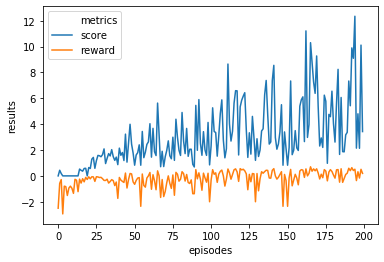

Max Train Score 24 Max Test Score 31
Mean Train Score 3.05641102411247 Mean Test Score 6.272753150164273
----------------------------------------------------------------------------------------------------
n_eval_episode 3142.4945070838576


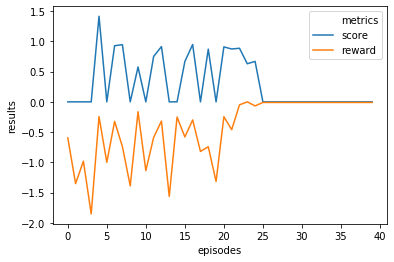

Max Train Score 2 Max Test Score 0
Mean Train Score 0.2993775570126621 Mean Test Score 0.0
----------------------------------------------------------------------------------------------------
n_eval_episode 3142.4945070838576


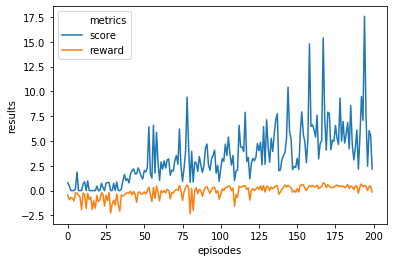

Max Train Score 33 Max Test Score 23
Mean Train Score 3.441426621228643 Mean Test Score 5.983340803075291
----------------------------------------------------------------------------------------------------
n_eval_episode 3142.4945070838576


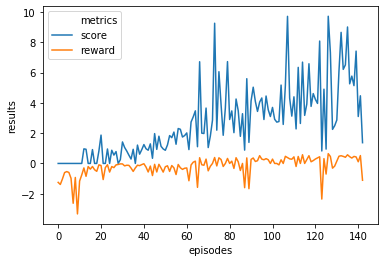

Max Train Score 19 Max Test Score 24
Mean Train Score 2.683539487422757 Mean Test Score 4.733340854774299
----------------------------------------------------------------------------------------------------
n_eval_episode 3142.4945070838576


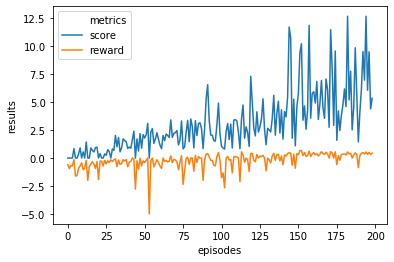

Max Train Score 25 Max Test Score 25
Mean Train Score 3.0752472264203963 Mean Test Score 5.567719894813352
----------------------------------------------------------------------------------------------------
n_eval_episode 3142.4945070838576


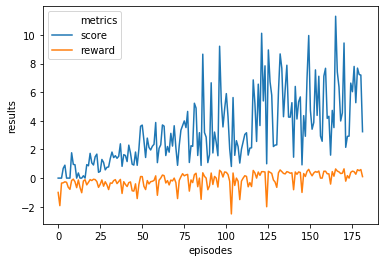

Max Train Score 22 Max Test Score 22
Mean Train Score 3.285526814696866 Mean Test Score 5.104113921861462
----------------------------------------------------------------------------------------------------
n_eval_episode 3142.4945070838576


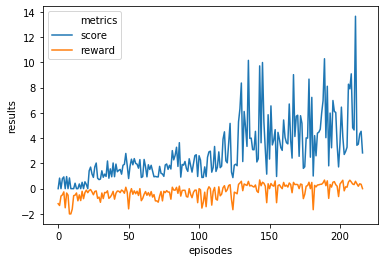

Max Train Score 27 Max Test Score 21
Mean Train Score 2.866972972113702 Mean Test Score 5.335662966085611
----------------------------------------------------------------------------------------------------
n_eval_episode 3142.4945070838576


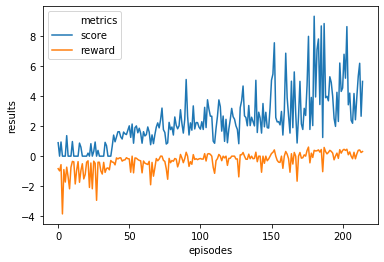

Max Train Score 18 Max Test Score 20
Mean Train Score 2.3819120580915603 Mean Test Score 4.882322605815237
----------------------------------------------------------------------------------------------------
n_eval_episode 3142.4945070838576


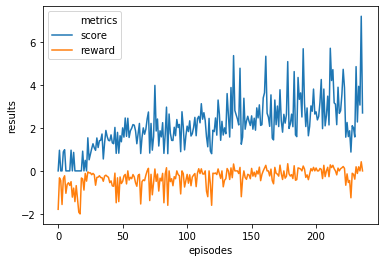

Max Train Score 14 Max Test Score 15
Mean Train Score 2.112372338043353 Mean Test Score 3.746310289016536
----------------------------------------------------------------------------------------------------
n_eval_episode 3142.4945070838576


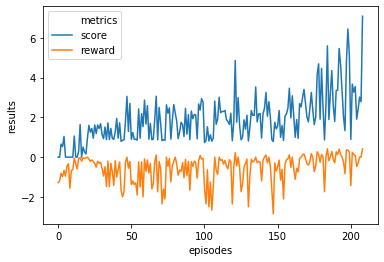

Max Train Score 12 Max Test Score 20
Mean Train Score 1.8861251460274195 Mean Test Score 4.018457408275013
----------------------------------------------------------------------------------------------------
n_eval_episode max results  10


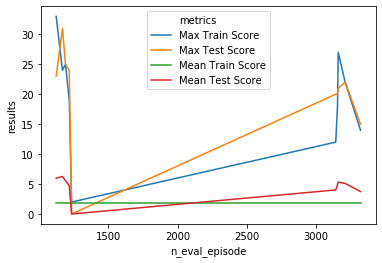

----------------------------------------------------------------------------------------------------
Using cpu device
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 91.9     |
|    ep_rew_mean        | -23.6    |
| time/                 |          |
|    fps                | 412      |
|    iterations         | 1000     |
|    time_elapsed       | 12       |
|    total_timesteps    | 5000     |
| train/                |          |
|    entropy_loss       | -0.399   |
|    explained_variance | 0.292    |
|    learning_rate      | 0.001    |
|    n_updates          | 999      |
|    policy_loss        | 0.0592   |
|    value_loss         | 0.0435   |
------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 76       |
|    ep_rew_mean        | -2       |
| time/                 |          |
|    fps                | 414      |
|    iterations         | 2000 

------------------------------------
| rollout/              |          |
|    ep_len_mean        | 91.3     |
|    ep_rew_mean        | -15.4    |
| time/                 |          |
|    fps                | 410      |
|    iterations         | 2000     |
|    time_elapsed       | 24       |
|    total_timesteps    | 10000    |
| train/                |          |
|    entropy_loss       | -0.387   |
|    explained_variance | nan      |
|    learning_rate      | 0.001    |
|    n_updates          | 1999     |
|    policy_loss        | -0.0345  |
|    value_loss         | 0.0736   |
------------------------------------
-------------------------------------
| rollout/              |           |
|    ep_len_mean        | 84.9      |
|    ep_rew_mean        | 5.6       |
| time/                 |           |
|    fps                | 411       |
|    iterations         | 3000      |
|    time_elapsed       | 36        |
|    total_timesteps    | 15000     |
| train/                |    

------------------------------------
| rollout/              |          |
|    ep_len_mean        | 93.2     |
|    ep_rew_mean        | 25.3     |
| time/                 |          |
|    fps                | 429      |
|    iterations         | 3000     |
|    time_elapsed       | 34       |
|    total_timesteps    | 15000    |
| train/                |          |
|    entropy_loss       | -0.0644  |
|    explained_variance | 0.959    |
|    learning_rate      | 0.001    |
|    n_updates          | 2999     |
|    policy_loss        | -0.0389  |
|    value_loss         | 4.16     |
------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 116      |
|    ep_rew_mean        | 43.5     |
| time/                 |          |
|    fps                | 431      |
|    iterations         | 4000     |
|    time_elapsed       | 46       |
|    total_timesteps    | 20000    |
| train/                |          |
|

------------------------------------
| rollout/              |          |
|    ep_len_mean        | 127      |
|    ep_rew_mean        | 41.8     |
| time/                 |          |
|    fps                | 425      |
|    iterations         | 4000     |
|    time_elapsed       | 47       |
|    total_timesteps    | 20000    |
| train/                |          |
|    entropy_loss       | -0.35    |
|    explained_variance | 0.397    |
|    learning_rate      | 0.001    |
|    n_updates          | 3999     |
|    policy_loss        | 0.23     |
|    value_loss         | 0.298    |
------------------------------------
n_eval_episode 3063.875371688464


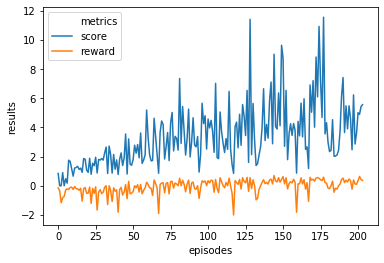

Max Train Score 21 Max Test Score 34
Mean Train Score 3.3340328255355147 Mean Test Score 6.1756403607687735
----------------------------------------------------------------------------------------------------
n_eval_episode 3063.875371688464


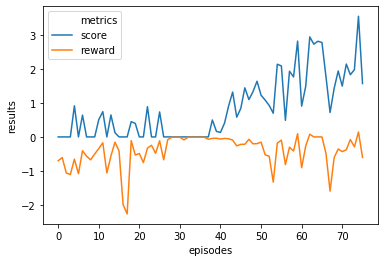

Max Train Score 7 Max Test Score 8
Mean Train Score 0.840233317097531 Mean Test Score 2.040462102906177
----------------------------------------------------------------------------------------------------
n_eval_episode 3063.875371688464


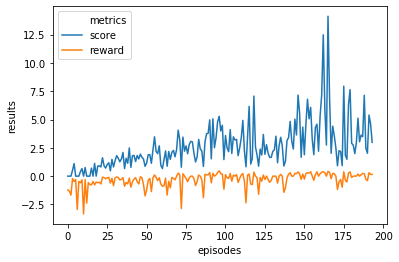

Max Train Score 28 Max Test Score 19
Mean Train Score 2.625908879536269 Mean Test Score 3.27784140970099
----------------------------------------------------------------------------------------------------
n_eval_episode 3063.875371688464


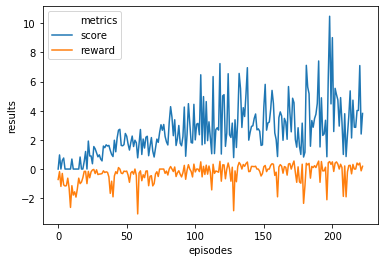

Max Train Score 20 Max Test Score 24
Mean Train Score 2.62491145678356 Mean Test Score 4.516269049655045
----------------------------------------------------------------------------------------------------
n_eval_episode 3063.875371688464


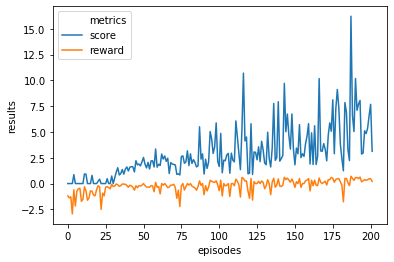

Max Train Score 29 Max Test Score 32
Mean Train Score 2.900550424236791 Mean Test Score 6.112735679476218
----------------------------------------------------------------------------------------------------
n_eval_episode 3063.875371688464


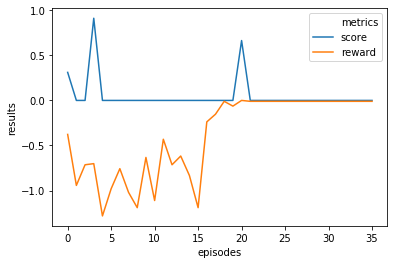

Max Train Score 1 Max Test Score 0
Mean Train Score 0.05245211364626455 Mean Test Score 0.0
----------------------------------------------------------------------------------------------------
n_eval_episode 3063.875371688464


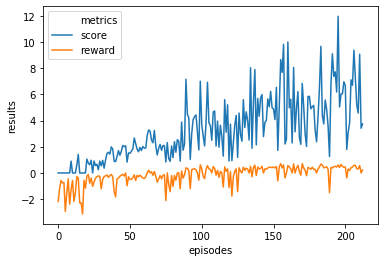

Max Train Score 22 Max Test Score 32
Mean Train Score 3.2746145543837066 Mean Test Score 7.307255670871884
----------------------------------------------------------------------------------------------------
n_eval_episode 3063.875371688464


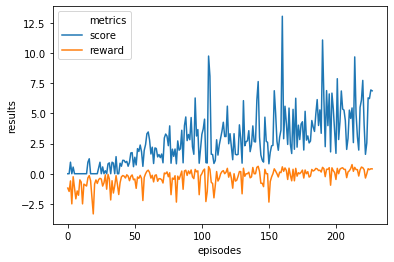

Max Train Score 26 Max Test Score 25
Mean Train Score 2.7797972531373354 Mean Test Score 6.1148930754295
----------------------------------------------------------------------------------------------------
n_eval_episode 3063.875371688464


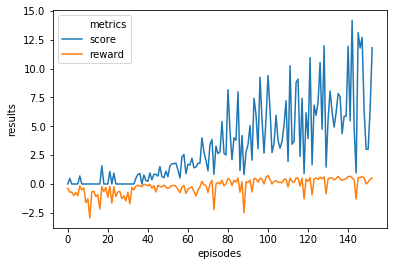

Max Train Score 28 Max Test Score 35
Mean Train Score 3.325846780113678 Mean Test Score 6.7218393303979225
----------------------------------------------------------------------------------------------------
n_eval_episode 3063.875371688464


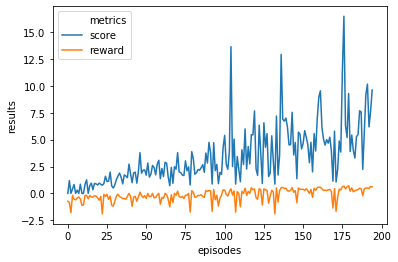

Max Train Score 31 Max Test Score 22
Mean Train Score 3.360672654529857 Mean Test Score 6.410076328258867
----------------------------------------------------------------------------------------------------
n_eval_episode max results  10


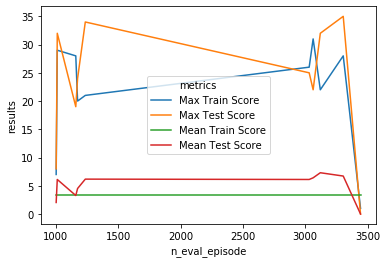

----------------------------------------------------------------------------------------------------
Using cpu device
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 115      |
|    ep_rew_mean        | -39.5    |
| time/                 |          |
|    fps                | 438      |
|    iterations         | 1000     |
|    time_elapsed       | 11       |
|    total_timesteps    | 5000     |
| train/                |          |
|    entropy_loss       | -0.693   |
|    explained_variance | -0.039   |
|    learning_rate      | 0.001    |
|    n_updates          | 999      |
|    policy_loss        | -0.0173  |
|    value_loss         | 0.00128  |
------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 88.6     |
|    ep_rew_mean        | -15.2    |
| time/                 |          |
|    fps                | 424      |
|    iterations         | 2000 

------------------------------------
| rollout/              |          |
|    ep_len_mean        | 66.1     |
|    ep_rew_mean        | -9.5     |
| time/                 |          |
|    fps                | 420      |
|    iterations         | 2000     |
|    time_elapsed       | 23       |
|    total_timesteps    | 10000    |
| train/                |          |
|    entropy_loss       | -0.188   |
|    explained_variance | -0.167   |
|    learning_rate      | 0.001    |
|    n_updates          | 1999     |
|    policy_loss        | -0.00729 |
|    value_loss         | 0.0291   |
------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 87.1     |
|    ep_rew_mean        | 3.8      |
| time/                 |          |
|    fps                | 421      |
|    iterations         | 3000     |
|    time_elapsed       | 35       |
|    total_timesteps    | 15000    |
| train/                |          |
|

------------------------------------
| rollout/              |          |
|    ep_len_mean        | 160      |
|    ep_rew_mean        | -23.9    |
| time/                 |          |
|    fps                | 436      |
|    iterations         | 3000     |
|    time_elapsed       | 34       |
|    total_timesteps    | 15000    |
| train/                |          |
|    entropy_loss       | -0.186   |
|    explained_variance | -11.8    |
|    learning_rate      | 0.001    |
|    n_updates          | 2999     |
|    policy_loss        | 0.03     |
|    value_loss         | 32.1     |
------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 82.8     |
|    ep_rew_mean        | 11       |
| time/                 |          |
|    fps                | 434      |
|    iterations         | 4000     |
|    time_elapsed       | 46       |
|    total_timesteps    | 20000    |
| train/                |          |
|

-------------------------------------
| rollout/              |           |
|    ep_len_mean        | 112       |
|    ep_rew_mean        | 26.6      |
| time/                 |           |
|    fps                | 431       |
|    iterations         | 4000      |
|    time_elapsed       | 46        |
|    total_timesteps    | 20000     |
| train/                |           |
|    entropy_loss       | -0.0101   |
|    explained_variance | -0.14     |
|    learning_rate      | 0.001     |
|    n_updates          | 3999      |
|    policy_loss        | -0.000186 |
|    value_loss         | 15.3      |
-------------------------------------
n_eval_episode 3310.073501776663


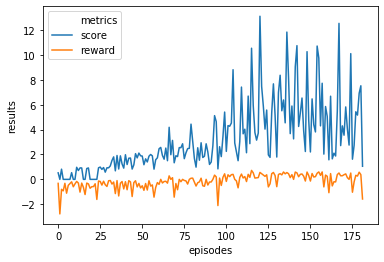

Max Train Score 24 Max Test Score 29
Mean Train Score 3.2077551117517467 Mean Test Score 5.755465518297887
----------------------------------------------------------------------------------------------------
n_eval_episode 3310.073501776663


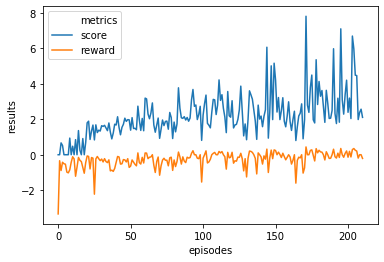

Max Train Score 15 Max Test Score 18
Mean Train Score 2.1929033122283954 Mean Test Score 3.6802335674948625
----------------------------------------------------------------------------------------------------
n_eval_episode 3310.073501776663


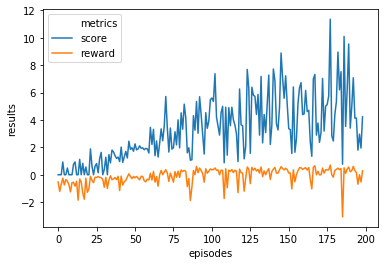

Max Train Score 22 Max Test Score 25
Mean Train Score 3.2475073173408586 Mean Test Score 4.599354498503472
----------------------------------------------------------------------------------------------------
n_eval_episode 3310.073501776663


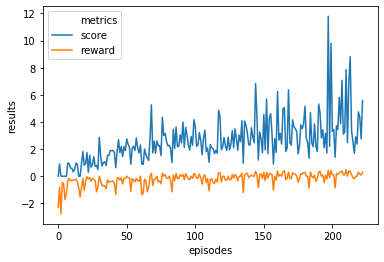

Max Train Score 23 Max Test Score 20
Mean Train Score 2.594909643837484 Mean Test Score 4.173114251355118
----------------------------------------------------------------------------------------------------
n_eval_episode 3310.073501776663


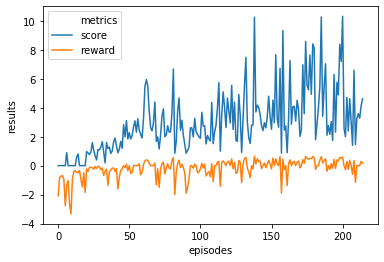

Max Train Score 20 Max Test Score 19
Mean Train Score 2.9466814804195005 Mean Test Score 4.456032241257732
----------------------------------------------------------------------------------------------------
n_eval_episode 3310.073501776663


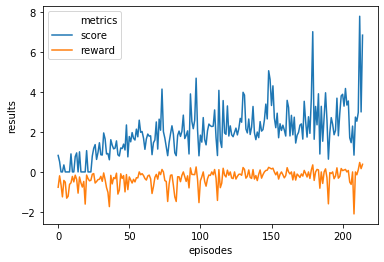

Max Train Score 16 Max Test Score 19
Mean Train Score 2.0112400324533106 Mean Test Score 3.791430425011567
----------------------------------------------------------------------------------------------------
n_eval_episode 3310.073501776663


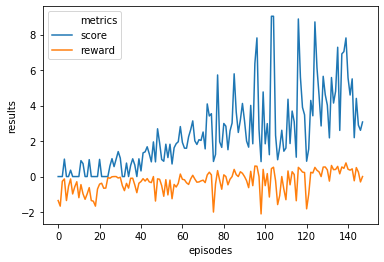

Max Train Score 18 Max Test Score 19
Mean Train Score 2.402918427246453 Mean Test Score 4.799494823918376
----------------------------------------------------------------------------------------------------
n_eval_episode 3310.073501776663


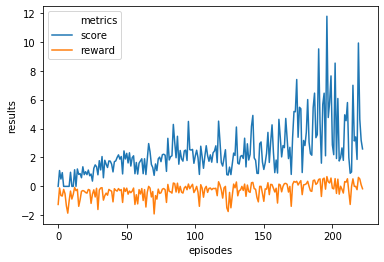

Max Train Score 21 Max Test Score 21
Mean Train Score 2.410833500761492 Mean Test Score 3.780608630838844
----------------------------------------------------------------------------------------------------
n_eval_episode 3310.073501776663


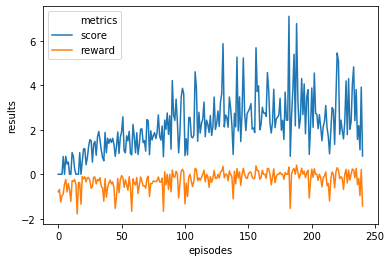

Max Train Score 14 Max Test Score 13
Mean Train Score 2.196117460048954 Mean Test Score 3.3344797457393547
----------------------------------------------------------------------------------------------------
n_eval_episode 3310.073501776663


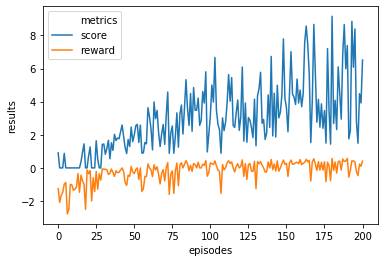

Max Train Score 18 Max Test Score 28
Mean Train Score 2.959386415728901 Mean Test Score 5.073642317327226
----------------------------------------------------------------------------------------------------
n_eval_episode max results  10


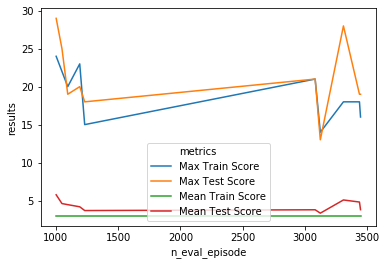

----------------------------------------------------------------------------------------------------
Using cpu device
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 88       |
|    ep_rew_mean        | -39.5    |
| time/                 |          |
|    fps                | 410      |
|    iterations         | 1000     |
|    time_elapsed       | 12       |
|    total_timesteps    | 5000     |
| train/                |          |
|    entropy_loss       | -0.253   |
|    explained_variance | -0.208   |
|    learning_rate      | 0.001    |
|    n_updates          | 999      |
|    policy_loss        | -0.0248  |
|    value_loss         | 0.0133   |
------------------------------------
-------------------------------------
| rollout/              |           |
|    ep_len_mean        | 67.4      |
|    ep_rew_mean        | -19.5     |
| time/                 |           |
|    fps                | 412       |
|    iterations         |

------------------------------------
| rollout/              |          |
|    ep_len_mean        | 66.4     |
|    ep_rew_mean        | -5.2     |
| time/                 |          |
|    fps                | 412      |
|    iterations         | 2000     |
|    time_elapsed       | 24       |
|    total_timesteps    | 10000    |
| train/                |          |
|    entropy_loss       | -0.114   |
|    explained_variance | nan      |
|    learning_rate      | 0.001    |
|    n_updates          | 1999     |
|    policy_loss        | -0.00848 |
|    value_loss         | 0.173    |
------------------------------------
-------------------------------------
| rollout/              |           |
|    ep_len_mean        | 89.7      |
|    ep_rew_mean        | 15.9      |
| time/                 |           |
|    fps                | 418       |
|    iterations         | 3000      |
|    time_elapsed       | 35        |
|    total_timesteps    | 15000     |
| train/                |    

-------------------------------------
| rollout/              |           |
|    ep_len_mean        | 82.1      |
|    ep_rew_mean        | 4         |
| time/                 |           |
|    fps                | 432       |
|    iterations         | 3000      |
|    time_elapsed       | 34        |
|    total_timesteps    | 15000     |
| train/                |           |
|    entropy_loss       | -0.014    |
|    explained_variance | -1.54     |
|    learning_rate      | 0.001     |
|    n_updates          | 2999      |
|    policy_loss        | -0.000793 |
|    value_loss         | 0.203     |
-------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 101      |
|    ep_rew_mean        | 21       |
| time/                 |          |
|    fps                | 433      |
|    iterations         | 4000     |
|    time_elapsed       | 46       |
|    total_timesteps    | 20000    |
| train/             

-------------------------------------
| rollout/              |           |
|    ep_len_mean        | 136       |
|    ep_rew_mean        | 51.2      |
| time/                 |           |
|    fps                | 431       |
|    iterations         | 4000      |
|    time_elapsed       | 46        |
|    total_timesteps    | 20000     |
| train/                |           |
|    entropy_loss       | -0.000941 |
|    explained_variance | -36       |
|    learning_rate      | 0.001     |
|    n_updates          | 3999      |
|    policy_loss        | 0.000501  |
|    value_loss         | 24.6      |
-------------------------------------
n_eval_episode 3192.6249535987795


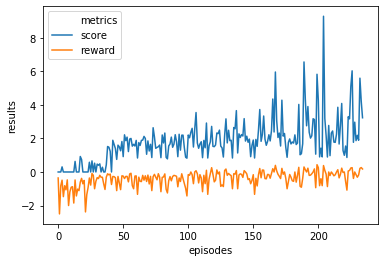

Max Train Score 19 Max Test Score 23
Mean Train Score 1.8013632046953738 Mean Test Score 3.856620825329182
----------------------------------------------------------------------------------------------------
n_eval_episode 3192.6249535987795


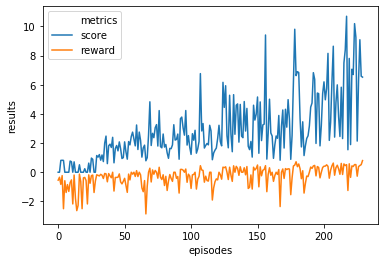

Max Train Score 18 Max Test Score 25
Mean Train Score 2.8483139765789147 Mean Test Score 5.287770088513412
----------------------------------------------------------------------------------------------------
n_eval_episode 3192.6249535987795


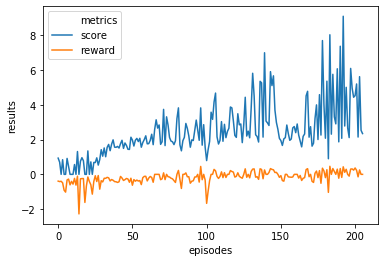

Max Train Score 16 Max Test Score 18
Mean Train Score 2.4635232683984487 Mean Test Score 4.148376549960698
----------------------------------------------------------------------------------------------------
n_eval_episode 3192.6249535987795


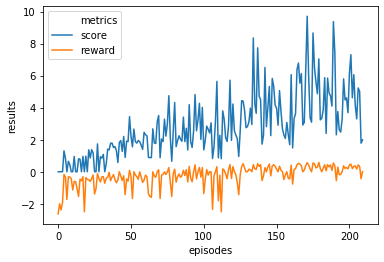

Max Train Score 19 Max Test Score 16
Mean Train Score 2.8515396328437492 Mean Test Score 4.382509475801479
----------------------------------------------------------------------------------------------------
n_eval_episode 3192.6249535987795


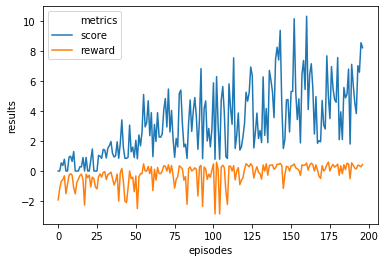

Max Train Score 19 Max Test Score 25
Mean Train Score 3.240511384721976 Mean Test Score 5.675091323438135
----------------------------------------------------------------------------------------------------
n_eval_episode 3192.6249535987795


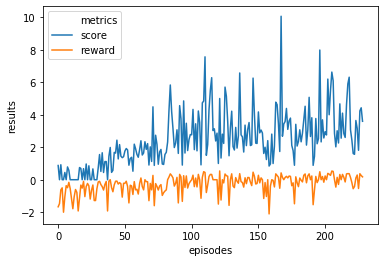

Max Train Score 19 Max Test Score 26
Mean Train Score 2.4624518005051517 Mean Test Score 4.370497384044356
----------------------------------------------------------------------------------------------------
n_eval_episode 3192.6249535987795


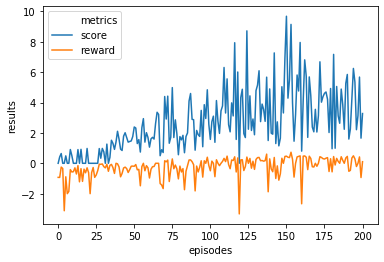

Max Train Score 19 Max Test Score 27
Mean Train Score 2.6538075450316585 Mean Test Score 4.71171066107732
----------------------------------------------------------------------------------------------------
n_eval_episode 3192.6249535987795


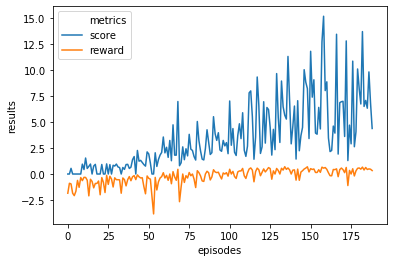

Max Train Score 30 Max Test Score 36
Mean Train Score 3.5528609211363844 Mean Test Score 7.664568273697974
----------------------------------------------------------------------------------------------------
n_eval_episode 3192.6249535987795


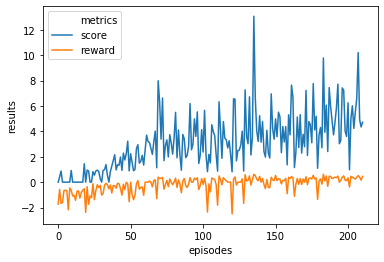

Max Train Score 24 Max Test Score 26
Mean Train Score 3.1123011124666187 Mean Test Score 6.010901617284164
----------------------------------------------------------------------------------------------------
n_eval_episode 3192.6249535987795


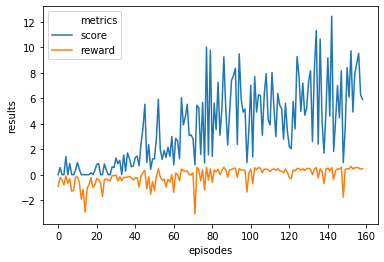

Max Train Score 23 Max Test Score 33
Mean Train Score 3.6786262908336367 Mean Test Score 7.244490991592868
----------------------------------------------------------------------------------------------------
n_eval_episode max results  10


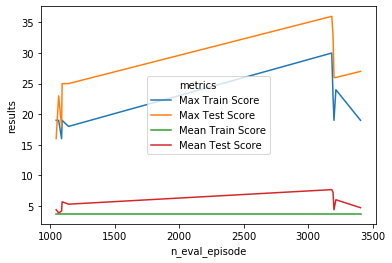

----------------------------------------------------------------------------------------------------
Using cpu device
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 106      |
|    ep_rew_mean        | -32.8    |
| time/                 |          |
|    fps                | 426      |
|    iterations         | 1000     |
|    time_elapsed       | 11       |
|    total_timesteps    | 5000     |
| train/                |          |
|    entropy_loss       | -0.339   |
|    explained_variance | 0.291    |
|    learning_rate      | 0.001    |
|    n_updates          | 999      |
|    policy_loss        | 0.16     |
|    value_loss         | 0.447    |
------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 58.7     |
|    ep_rew_mean        | -14.7    |
| time/                 |          |
|    fps                | 419      |
|    iterations         | 2000 

------------------------------------
| rollout/              |          |
|    ep_len_mean        | 91.2     |
|    ep_rew_mean        | -27.7    |
| time/                 |          |
|    fps                | 434      |
|    iterations         | 2000     |
|    time_elapsed       | 23       |
|    total_timesteps    | 10000    |
| train/                |          |
|    entropy_loss       | -0.0346  |
|    explained_variance | -0.34    |
|    learning_rate      | 0.001    |
|    n_updates          | 1999     |
|    policy_loss        | 3.25e-10 |
|    value_loss         | 1.32e-15 |
------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 84.1     |
|    ep_rew_mean        | -16.4    |
| time/                 |          |
|    fps                | 424      |
|    iterations         | 3000     |
|    time_elapsed       | 35       |
|    total_timesteps    | 15000    |
| train/                |          |
|

------------------------------------
| rollout/              |          |
|    ep_len_mean        | 560      |
|    ep_rew_mean        | -29.6    |
| time/                 |          |
|    fps                | 454      |
|    iterations         | 3000     |
|    time_elapsed       | 32       |
|    total_timesteps    | 15000    |
| train/                |          |
|    entropy_loss       | -0.00109 |
|    explained_variance | -1.45    |
|    learning_rate      | 0.001    |
|    n_updates          | 2999     |
|    policy_loss        | 5.13e-08 |
|    value_loss         | 3.12e-07 |
------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 631      |
|    ep_rew_mean        | -26.5    |
| time/                 |          |
|    fps                | 452      |
|    iterations         | 4000     |
|    time_elapsed       | 44       |
|    total_timesteps    | 20000    |
| train/                |          |
|

------------------------------------
| rollout/              |          |
|    ep_len_mean        | 98.7     |
|    ep_rew_mean        | 20.2     |
| time/                 |          |
|    fps                | 420      |
|    iterations         | 4000     |
|    time_elapsed       | 47       |
|    total_timesteps    | 20000    |
| train/                |          |
|    entropy_loss       | -0.29    |
|    explained_variance | -62.1    |
|    learning_rate      | 0.001    |
|    n_updates          | 3999     |
|    policy_loss        | -9.89    |
|    value_loss         | 2.3e+03  |
------------------------------------
n_eval_episode 3394.1808148187447


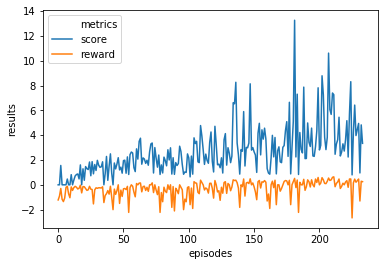

Max Train Score 23 Max Test Score 22
Mean Train Score 2.6753812105047183 Mean Test Score 5.045813990586298
----------------------------------------------------------------------------------------------------
n_eval_episode 3394.1808148187447


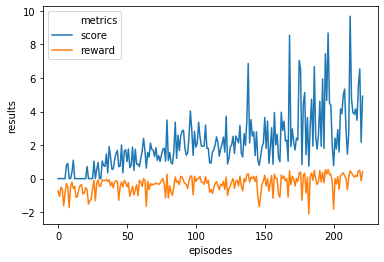

Max Train Score 17 Max Test Score 23
Mean Train Score 2.098139302677299 Mean Test Score 5.081694518300172
----------------------------------------------------------------------------------------------------
n_eval_episode 3394.1808148187447


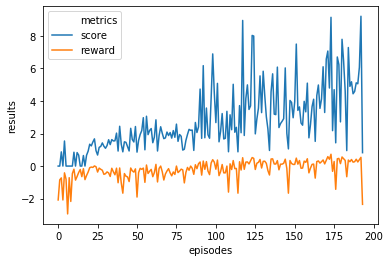

Max Train Score 18 Max Test Score 19
Mean Train Score 2.7720787627617014 Mean Test Score 4.028129104209011
----------------------------------------------------------------------------------------------------
n_eval_episode 3394.1808148187447


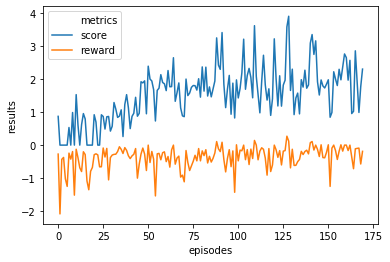

Max Train Score 7 Max Test Score 11
Mean Train Score 1.5520518249070339 Mean Test Score 2.191848426189115
----------------------------------------------------------------------------------------------------
n_eval_episode 3394.1808148187447


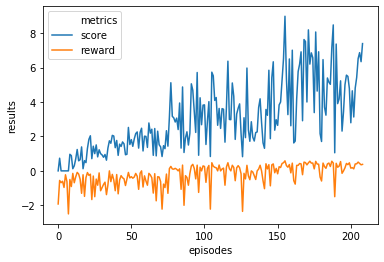

Max Train Score 17 Max Test Score 23
Mean Train Score 3.031274309463235 Mean Test Score 5.865076632566581
----------------------------------------------------------------------------------------------------
n_eval_episode 3394.1808148187447


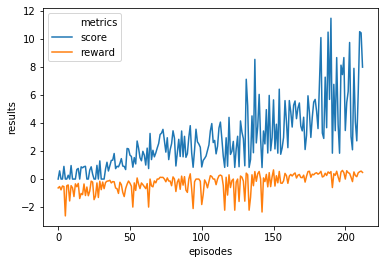

Max Train Score 21 Max Test Score 23
Mean Train Score 2.8538360757872074 Mean Test Score 6.133177436342862
----------------------------------------------------------------------------------------------------
n_eval_episode 3394.1808148187447


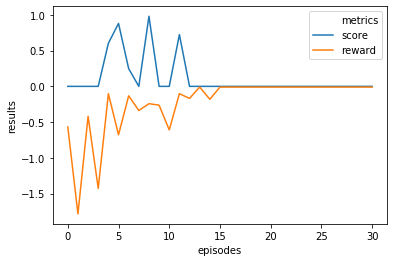

Max Train Score 1 Max Test Score 0
Mean Train Score 0.11096886387710195 Mean Test Score 0.0
----------------------------------------------------------------------------------------------------
n_eval_episode 3394.1808148187447


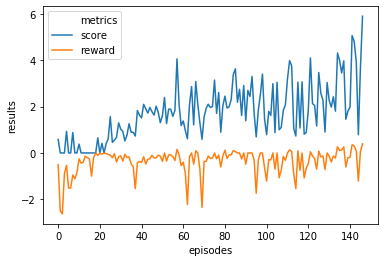

Max Train Score 11 Max Test Score 13
Mean Train Score 1.742879362046893 Mean Test Score 3.206871215055574
----------------------------------------------------------------------------------------------------
n_eval_episode 3394.1808148187447


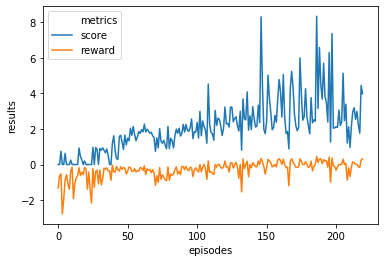

Max Train Score 17 Max Test Score 18
Mean Train Score 2.088809601078008 Mean Test Score 3.7802486914073077
----------------------------------------------------------------------------------------------------
n_eval_episode 3394.1808148187447


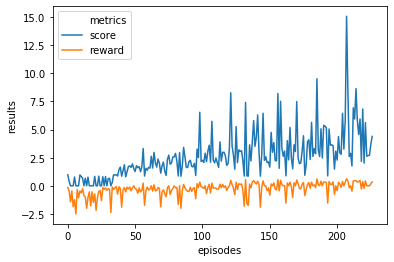

Max Train Score 30 Max Test Score 30
Mean Train Score 2.6137732922880574 Mean Test Score 4.182881218361913
----------------------------------------------------------------------------------------------------
n_eval_episode max results  10


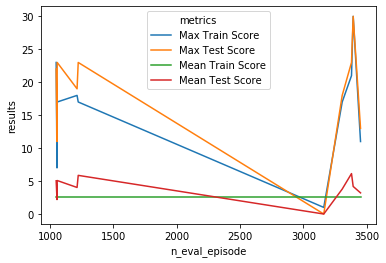

----------------------------------------------------------------------------------------------------
Using cpu device
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 110      |
|    ep_rew_mean        | -36.9    |
| time/                 |          |
|    fps                | 416      |
|    iterations         | 1000     |
|    time_elapsed       | 12       |
|    total_timesteps    | 5000     |
| train/                |          |
|    entropy_loss       | -0.254   |
|    explained_variance | 0.526    |
|    learning_rate      | 0.001    |
|    n_updates          | 999      |
|    policy_loss        | -0.00857 |
|    value_loss         | 0.017    |
------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 88.8     |
|    ep_rew_mean        | -12.1    |
| time/                 |          |
|    fps                | 419      |
|    iterations         | 2000 

------------------------------------
| rollout/              |          |
|    ep_len_mean        | 87       |
|    ep_rew_mean        | -21.8    |
| time/                 |          |
|    fps                | 434      |
|    iterations         | 2000     |
|    time_elapsed       | 23       |
|    total_timesteps    | 10000    |
| train/                |          |
|    entropy_loss       | -0.175   |
|    explained_variance | -0.458   |
|    learning_rate      | 0.001    |
|    n_updates          | 1999     |
|    policy_loss        | -0.0067  |
|    value_loss         | 0.0176   |
------------------------------------
-------------------------------------
| rollout/              |           |
|    ep_len_mean        | 84.5      |
|    ep_rew_mean        | -8.6      |
| time/                 |           |
|    fps                | 428       |
|    iterations         | 3000      |
|    time_elapsed       | 35        |
|    total_timesteps    | 15000     |
| train/                |    

------------------------------------
| rollout/              |          |
|    ep_len_mean        | 92.4     |
|    ep_rew_mean        | 15.7     |
| time/                 |          |
|    fps                | 424      |
|    iterations         | 3000     |
|    time_elapsed       | 35       |
|    total_timesteps    | 15000    |
| train/                |          |
|    entropy_loss       | -0.0127  |
|    explained_variance | nan      |
|    learning_rate      | 0.001    |
|    n_updates          | 2999     |
|    policy_loss        | -0.00139 |
|    value_loss         | 0.856    |
------------------------------------
-------------------------------------
| rollout/              |           |
|    ep_len_mean        | 116       |
|    ep_rew_mean        | 39.7      |
| time/                 |           |
|    fps                | 423       |
|    iterations         | 4000      |
|    time_elapsed       | 47        |
|    total_timesteps    | 20000     |
| train/                |    

-------------------------------------
| rollout/              |           |
|    ep_len_mean        | 113       |
|    ep_rew_mean        | 36.4      |
| time/                 |           |
|    fps                | 421       |
|    iterations         | 4000      |
|    time_elapsed       | 47        |
|    total_timesteps    | 20000     |
| train/                |           |
|    entropy_loss       | -0.000617 |
|    explained_variance | nan       |
|    learning_rate      | 0.001     |
|    n_updates          | 3999      |
|    policy_loss        | -6.65e-05 |
|    value_loss         | 1.69      |
-------------------------------------
n_eval_episode 3302.193473352869


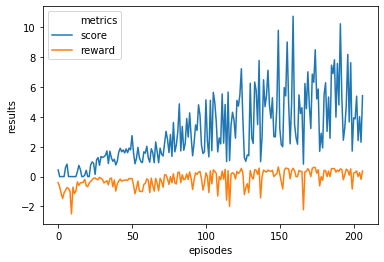

Max Train Score 20 Max Test Score 28
Mean Train Score 3.005080942069892 Mean Test Score 6.568950842866602
----------------------------------------------------------------------------------------------------
n_eval_episode 3302.193473352869


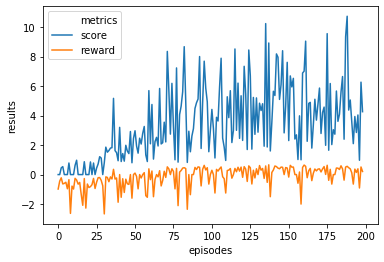

Max Train Score 21 Max Test Score 21
Mean Train Score 3.4062635053407884 Mean Test Score 4.705684885984228
----------------------------------------------------------------------------------------------------
n_eval_episode 3302.193473352869


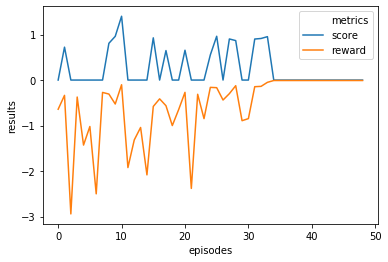

Max Train Score 2 Max Test Score 0
Mean Train Score 0.248545861076045 Mean Test Score 0.0
----------------------------------------------------------------------------------------------------
n_eval_episode 3302.193473352869


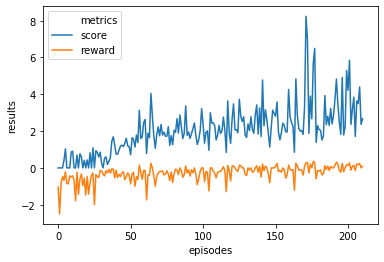

Max Train Score 13 Max Test Score 14
Mean Train Score 2.0421202635420284 Mean Test Score 3.260750875421179
----------------------------------------------------------------------------------------------------
n_eval_episode 3302.193473352869


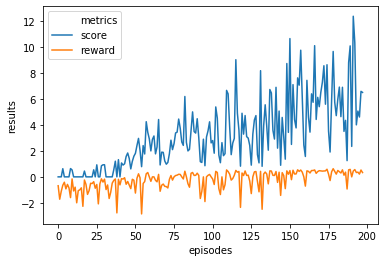

Max Train Score 23 Max Test Score 34
Mean Train Score 3.172331410290759 Mean Test Score 7.410688051727458
----------------------------------------------------------------------------------------------------
n_eval_episode 3302.193473352869


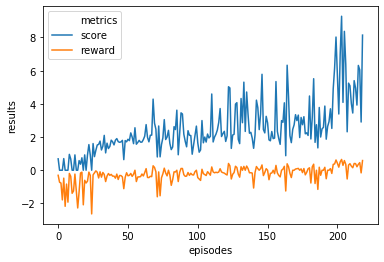

Max Train Score 19 Max Test Score 28
Mean Train Score 2.4661170856040693 Mean Test Score 5.037331040553142
----------------------------------------------------------------------------------------------------
n_eval_episode 3302.193473352869


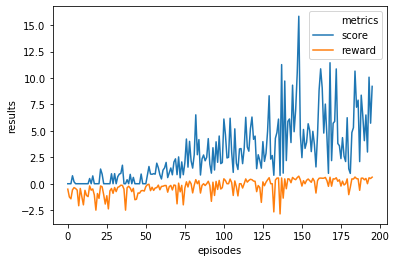

Max Train Score 35 Max Test Score 30
Mean Train Score 2.96661681844356 Mean Test Score 6.464719271954838
----------------------------------------------------------------------------------------------------
n_eval_episode 3302.193473352869


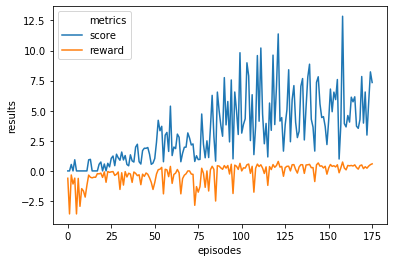

Max Train Score 23 Max Test Score 25
Mean Train Score 3.3527098028562055 Mean Test Score 5.847350894466153
----------------------------------------------------------------------------------------------------
n_eval_episode 3302.193473352869


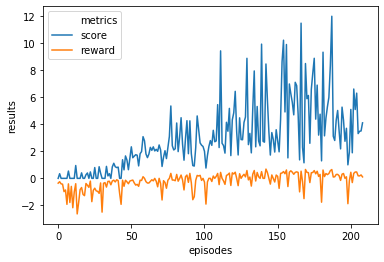

Max Train Score 22 Max Test Score 23
Mean Train Score 2.9780782183117056 Mean Test Score 5.037081072477315
----------------------------------------------------------------------------------------------------
n_eval_episode 3302.193473352869


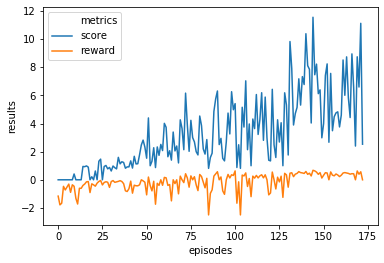

Max Train Score 23 Max Test Score 24
Mean Train Score 3.243282048389182 Mean Test Score 6.47611306746163
----------------------------------------------------------------------------------------------------
n_eval_episode max results  10


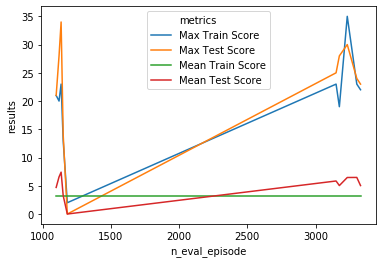

----------------------------------------------------------------------------------------------------
Using cpu device
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 82.7     |
|    ep_rew_mean        | -21.5    |
| time/                 |          |
|    fps                | 431      |
|    iterations         | 1000     |
|    time_elapsed       | 11       |
|    total_timesteps    | 5000     |
| train/                |          |
|    entropy_loss       | -0.0641  |
|    explained_variance | 0.239    |
|    learning_rate      | 0.001    |
|    n_updates          | 999      |
|    policy_loss        | 0.00224  |
|    value_loss         | 0.669    |
------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 90.2     |
|    ep_rew_mean        | 6.3      |
| time/                 |          |
|    fps                | 427      |
|    iterations         | 2000 

------------------------------------
| rollout/              |          |
|    ep_len_mean        | 93.5     |
|    ep_rew_mean        | -20.6    |
| time/                 |          |
|    fps                | 418      |
|    iterations         | 2000     |
|    time_elapsed       | 23       |
|    total_timesteps    | 10000    |
| train/                |          |
|    entropy_loss       | -0.464   |
|    explained_variance | nan      |
|    learning_rate      | 0.001    |
|    n_updates          | 1999     |
|    policy_loss        | -0.0213  |
|    value_loss         | 0.0154   |
------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 81.6     |
|    ep_rew_mean        | 9.6      |
| time/                 |          |
|    fps                | 420      |
|    iterations         | 3000     |
|    time_elapsed       | 35       |
|    total_timesteps    | 15000    |
| train/                |          |
|

------------------------------------
| rollout/              |          |
|    ep_len_mean        | 95.5     |
|    ep_rew_mean        | 21.2     |
| time/                 |          |
|    fps                | 415      |
|    iterations         | 3000     |
|    time_elapsed       | 36       |
|    total_timesteps    | 15000    |
| train/                |          |
|    entropy_loss       | -0.135   |
|    explained_variance | 0.803    |
|    learning_rate      | 0.001    |
|    n_updates          | 2999     |
|    policy_loss        | 0.147    |
|    value_loss         | 9.02     |
------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 119      |
|    ep_rew_mean        | 43.8     |
| time/                 |          |
|    fps                | 421      |
|    iterations         | 4000     |
|    time_elapsed       | 47       |
|    total_timesteps    | 20000    |
| train/                |          |
|

-------------------------------------
| rollout/              |           |
|    ep_len_mean        | 108       |
|    ep_rew_mean        | 30.6      |
| time/                 |           |
|    fps                | 418       |
|    iterations         | 4000      |
|    time_elapsed       | 47        |
|    total_timesteps    | 20000     |
| train/                |           |
|    entropy_loss       | -1.6e-05  |
|    explained_variance | nan       |
|    learning_rate      | 0.001     |
|    n_updates          | 3999      |
|    policy_loss        | -1.17e-06 |
|    value_loss         | 1.83      |
-------------------------------------
n_eval_episode 3476.650185118379


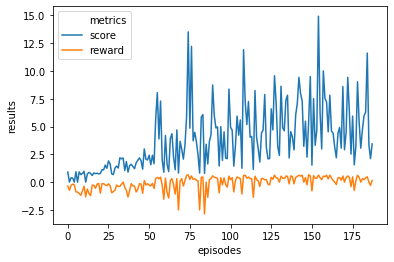

Max Train Score 28 Max Test Score 24
Mean Train Score 3.8330443294198866 Mean Test Score 6.0334735396192
----------------------------------------------------------------------------------------------------
n_eval_episode 3476.650185118379


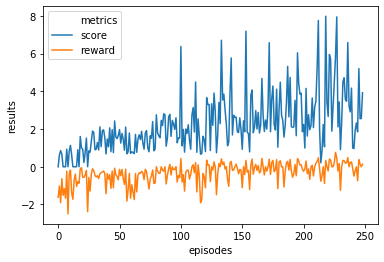

Max Train Score 15 Max Test Score 17
Mean Train Score 2.2431341109273304 Mean Test Score 4.242396978900942
----------------------------------------------------------------------------------------------------
n_eval_episode 3476.650185118379


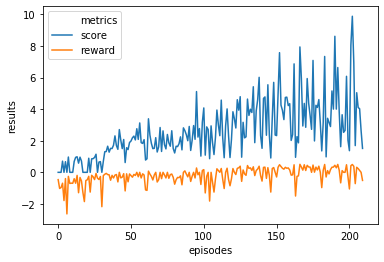

Max Train Score 18 Max Test Score 26
Mean Train Score 2.6095957697271994 Mean Test Score 5.0437209625742465
----------------------------------------------------------------------------------------------------
n_eval_episode 3476.650185118379


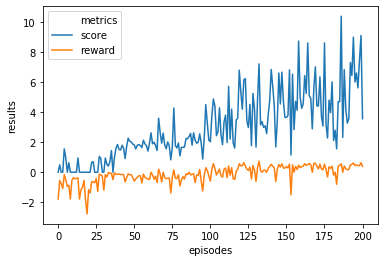

Max Train Score 19 Max Test Score 32
Mean Train Score 2.9586101334829804 Mean Test Score 5.272137455763427
----------------------------------------------------------------------------------------------------
n_eval_episode 3476.650185118379


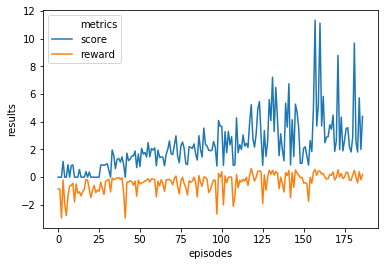

Max Train Score 22 Max Test Score 18
Mean Train Score 2.278565755291608 Mean Test Score 4.213212421577629
----------------------------------------------------------------------------------------------------
n_eval_episode 3476.650185118379


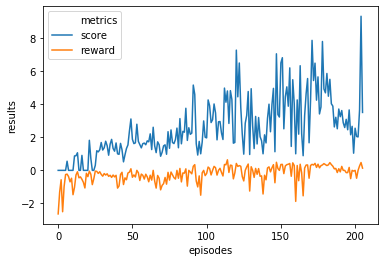

Max Train Score 17 Max Test Score 19
Mean Train Score 2.5362888999702635 Mean Test Score 4.096805325599591
----------------------------------------------------------------------------------------------------
n_eval_episode 3476.650185118379


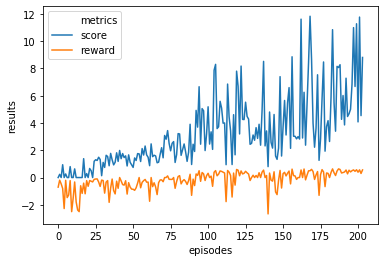

Max Train Score 24 Max Test Score 24
Mean Train Score 3.2276707651110508 Mean Test Score 5.347407747829542
----------------------------------------------------------------------------------------------------
n_eval_episode 3476.650185118379


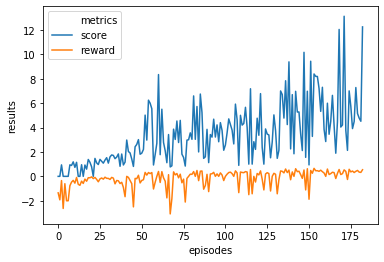

Max Train Score 24 Max Test Score 27
Mean Train Score 3.4004640510927233 Mean Test Score 5.367770042122833
----------------------------------------------------------------------------------------------------
n_eval_episode 3476.650185118379


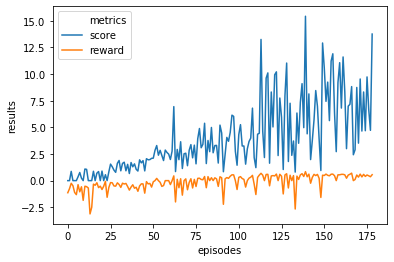

Max Train Score 30 Max Test Score 33
Mean Train Score 3.8843989627255873 Mean Test Score 7.078398210616033
----------------------------------------------------------------------------------------------------
n_eval_episode 3476.650185118379


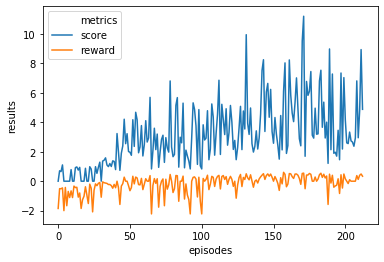

Max Train Score 21 Max Test Score 25
Mean Train Score 3.116836565330945 Mean Test Score 5.711349383280417
----------------------------------------------------------------------------------------------------
n_eval_episode max results  10


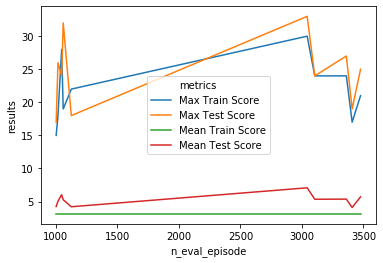

----------------------------------------------------------------------------------------------------
Using cpu device
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 198      |
|    ep_rew_mean        | -36.7    |
| time/                 |          |
|    fps                | 450      |
|    iterations         | 1000     |
|    time_elapsed       | 11       |
|    total_timesteps    | 5000     |
| train/                |          |
|    entropy_loss       | -0.376   |
|    explained_variance | -7.84    |
|    learning_rate      | 0.001    |
|    n_updates          | 999      |
|    policy_loss        | -0.00048 |
|    value_loss         | 1.37e-05 |
------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 104      |
|    ep_rew_mean        | -18.5    |
| time/                 |          |
|    fps                | 430      |
|    iterations         | 2000 

------------------------------------
| rollout/              |          |
|    ep_len_mean        | 80.2     |
|    ep_rew_mean        | -22.2    |
| time/                 |          |
|    fps                | 399      |
|    iterations         | 2000     |
|    time_elapsed       | 25       |
|    total_timesteps    | 10000    |
| train/                |          |
|    entropy_loss       | -0.137   |
|    explained_variance | -282     |
|    learning_rate      | 0.001    |
|    n_updates          | 1999     |
|    policy_loss        | -41.1    |
|    value_loss         | 1.51e+03 |
------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 96.9     |
|    ep_rew_mean        | -10.9    |
| time/                 |          |
|    fps                | 376      |
|    iterations         | 3000     |
|    time_elapsed       | 39       |
|    total_timesteps    | 15000    |
| train/                |          |
|

------------------------------------
| rollout/              |          |
|    ep_len_mean        | 79.5     |
|    ep_rew_mean        | -0.8     |
| time/                 |          |
|    fps                | 427      |
|    iterations         | 3000     |
|    time_elapsed       | 35       |
|    total_timesteps    | 15000    |
| train/                |          |
|    entropy_loss       | -0.269   |
|    explained_variance | -583     |
|    learning_rate      | 0.001    |
|    n_updates          | 2999     |
|    policy_loss        | -14.8    |
|    value_loss         | 1.74e+03 |
------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 92       |
|    ep_rew_mean        | 10       |
| time/                 |          |
|    fps                | 429      |
|    iterations         | 4000     |
|    time_elapsed       | 46       |
|    total_timesteps    | 20000    |
| train/                |          |
|

------------------------------------
| rollout/              |          |
|    ep_len_mean        | 113      |
|    ep_rew_mean        | 24       |
| time/                 |          |
|    fps                | 432      |
|    iterations         | 4000     |
|    time_elapsed       | 46       |
|    total_timesteps    | 20000    |
| train/                |          |
|    entropy_loss       | -0.0161  |
|    explained_variance | 0.996    |
|    learning_rate      | 0.001    |
|    n_updates          | 3999     |
|    policy_loss        | 0.00112  |
|    value_loss         | 0.216    |
------------------------------------
n_eval_episode 3287.115742464533


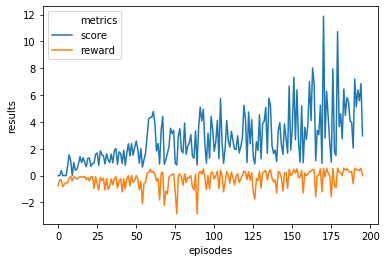

Max Train Score 26 Max Test Score 28
Mean Train Score 2.7388346786677453 Mean Test Score 5.589273972805245
----------------------------------------------------------------------------------------------------
n_eval_episode 3287.115742464533


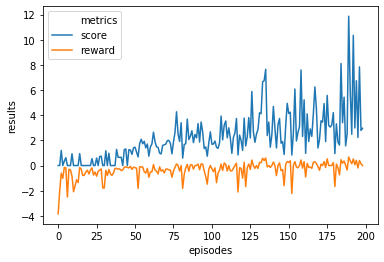

Max Train Score 25 Max Test Score 24
Mean Train Score 2.2507177554782793 Mean Test Score 5.2472084344298375
----------------------------------------------------------------------------------------------------
n_eval_episode 3287.115742464533


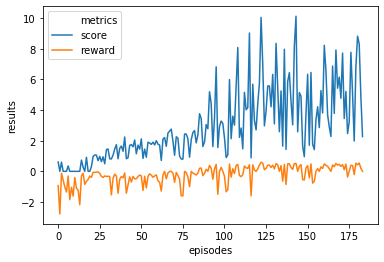

Max Train Score 20 Max Test Score 23
Mean Train Score 2.932204849551556 Mean Test Score 5.370424813580475
----------------------------------------------------------------------------------------------------
n_eval_episode 3287.115742464533


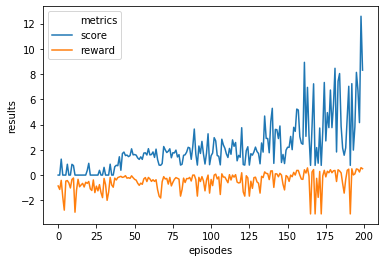

Max Train Score 21 Max Test Score 28
Mean Train Score 2.1588523561766406 Mean Test Score 4.714174281619344
----------------------------------------------------------------------------------------------------
n_eval_episode 3287.115742464533


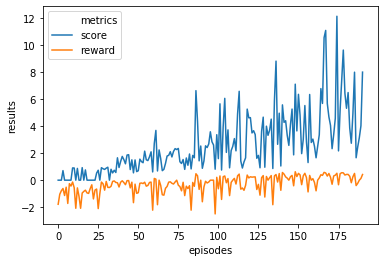

Max Train Score 23 Max Test Score 24
Mean Train Score 2.6182511397924877 Mean Test Score 6.4281376166000745
----------------------------------------------------------------------------------------------------
n_eval_episode 3287.115742464533


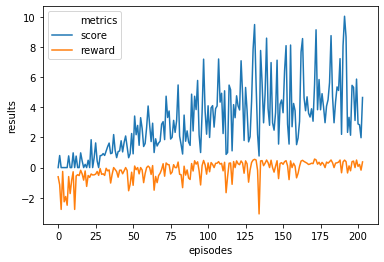

Max Train Score 19 Max Test Score 17
Mean Train Score 3.120023785046426 Mean Test Score 4.563025726811014
----------------------------------------------------------------------------------------------------
n_eval_episode 3287.115742464533


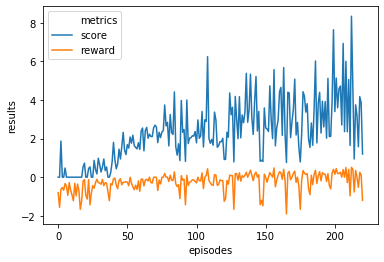

Max Train Score 15 Max Test Score 19
Mean Train Score 2.309922302299462 Mean Test Score 4.076603873103613
----------------------------------------------------------------------------------------------------
n_eval_episode 3287.115742464533


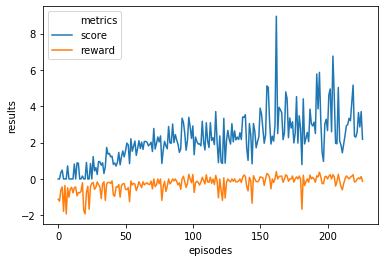

Max Train Score 16 Max Test Score 14
Mean Train Score 2.151211873460586 Mean Test Score 2.6949454080501436
----------------------------------------------------------------------------------------------------
n_eval_episode 3287.115742464533


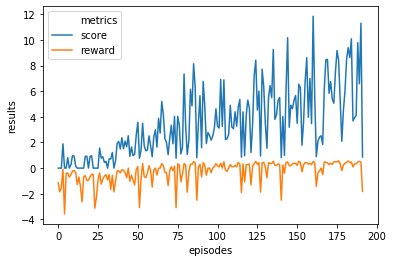

Max Train Score 23 Max Test Score 24
Mean Train Score 3.4234489008987588 Mean Test Score 6.3848663470484155
----------------------------------------------------------------------------------------------------
n_eval_episode 3287.115742464533


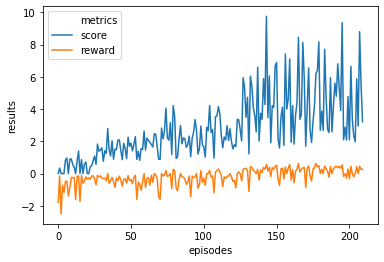

Max Train Score 18 Max Test Score 32
Mean Train Score 2.793147638498916 Mean Test Score 5.562889273424531
----------------------------------------------------------------------------------------------------
n_eval_episode max results  10


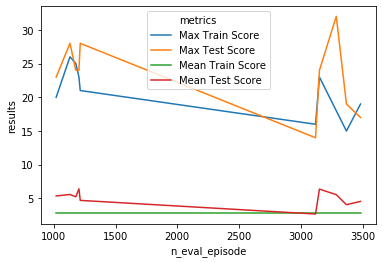

----------------------------------------------------------------------------------------------------


In [ ]:
for i in range(10):    
    results = {}
    for i in range(10):
        # enable_render=True turns on the display
        snake_env = SnakeEnv(440, 440, enable_render=False)
        env = make_vec_env(lambda: snake_env, n_envs=1)

        #entropy = random.uniform(0, 0.1)
        if i < 5:
            n_eval_episode = random.uniform(1000,1250)
        else:
            n_eval_episode = random.uniform(3000,3500)

        #gamma=0.97 is the best one?
        #leaning_rate=??? see the best result from previous test
        model = A2C(MlpPolicy, env, verbose=1, learning_rate=1e-3, gamma=0.97)#seed=42, gamma=0.97)#, ent_coef=entropy)
        model.learn(total_timesteps=20000, log_interval=1000, n_eval_episodes=n_eval_episode)

        # Print rewards and scores for each episode
        max_train_score = snake_env.record
        mean_train_score = np.mean(np.array(snake_env.results['score']))
        max_test_score, mean_test_score = evaluate(model)

        results[n_eval_episode] = (snake_env.results, max_train_score, max_test_score, mean_train_score, mean_test_score)

    for n_eval_episode, result in results.items():
        metrics, max_train_score, max_test_score, mean_train_score, mean_test_score = result

        print("n_eval_episode", n_eval_episode)
        plot_metrics(metrics)    
        print("Max Train Score", max_train_score, "Max Test Score", max_test_score)
        print("Mean Train Score", mean_train_score, "Mean Test Score", mean_test_score)
        print("-"*100)

    print("n_eval_episode max results ", i+1)
    plot_max_results(results,'n_eval_episode')
    print("-"*100)

#### Result: N/A

# Testing Seed

## Seed=42

### Learning Rate

Using cpu device
-------------------------------------
| rollout/              |           |
|    ep_len_mean        | 103       |
|    ep_rew_mean        | -45.9     |
| time/                 |           |
|    fps                | 442       |
|    iterations         | 1000      |
|    time_elapsed       | 11        |
|    total_timesteps    | 5000      |
| train/                |           |
|    entropy_loss       | -0.0877   |
|    explained_variance | -3.53     |
|    learning_rate      | 0.000961  |
|    n_updates          | 999       |
|    policy_loss        | -3.07e-06 |
|    value_loss         | 6.95e-08  |
-------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 181      |
|    ep_rew_mean        | -43.2    |
| time/                 |          |
|    fps                | 452      |
|    iterations         | 2000     |
|    time_elapsed       | 22       |
|    total_timesteps    | 10000    |
| tr

------------------------------------
| rollout/              |          |
|    ep_len_mean        | 80.9     |
|    ep_rew_mean        | -5.2     |
| time/                 |          |
|    fps                | 433      |
|    iterations         | 2000     |
|    time_elapsed       | 23       |
|    total_timesteps    | 10000    |
| train/                |          |
|    entropy_loss       | -0.21    |
|    explained_variance | 0.461    |
|    learning_rate      | 0.001    |
|    n_updates          | 1999     |
|    policy_loss        | 0.197    |
|    value_loss         | 0.344    |
------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 92.7     |
|    ep_rew_mean        | 20.5     |
| time/                 |          |
|    fps                | 433      |
|    iterations         | 3000     |
|    time_elapsed       | 34       |
|    total_timesteps    | 15000    |
| train/                |          |
|

-------------------------------------
| rollout/              |           |
|    ep_len_mean        | 616       |
|    ep_rew_mean        | -25.4     |
| time/                 |           |
|    fps                | 456       |
|    iterations         | 3000      |
|    time_elapsed       | 32        |
|    total_timesteps    | 15000     |
| train/                |           |
|    entropy_loss       | -0.0287   |
|    explained_variance | -0.502    |
|    learning_rate      | 0.002     |
|    n_updates          | 2999      |
|    policy_loss        | -3.17e-05 |
|    value_loss         | 7.1e-05   |
-------------------------------------
-------------------------------------
| rollout/              |           |
|    ep_len_mean        | 671       |
|    ep_rew_mean        | -23.2     |
| time/                 |           |
|    fps                | 460       |
|    iterations         | 4000      |
|    time_elapsed       | 43        |
|    total_timesteps    | 20000     |
| train/    

------------------------------------
| rollout/              |          |
|    ep_len_mean        | 111      |
|    ep_rew_mean        | 33.3     |
| time/                 |          |
|    fps                | 341      |
|    iterations         | 4000     |
|    time_elapsed       | 58       |
|    total_timesteps    | 20000    |
| train/                |          |
|    entropy_loss       | -0.00227 |
|    explained_variance | 0.988    |
|    learning_rate      | 0.0009   |
|    n_updates          | 3999     |
|    policy_loss        | 3.22e-05 |
|    value_loss         | 0.176    |
------------------------------------
Using cpu device
-------------------------------------
| rollout/              |           |
|    ep_len_mean        | 103       |
|    ep_rew_mean        | -41.7     |
| time/                 |           |
|    fps                | 365       |
|    iterations         | 1000      |
|    time_elapsed       | 13        |
|    total_timesteps    | 5000      |
| train/    

Learning Rate 0.0009610612889534735


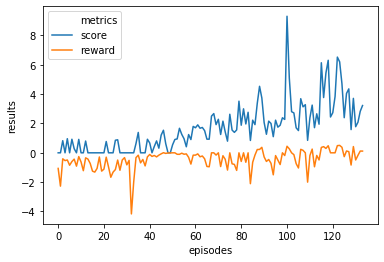

Max Train Score 18 Max Test Score 21
Mean Train Score 1.7021355433098802 Mean Test Score 4.517731764561764
----------------------------------------------------------------------------------------------------
Learning Rate 0.0013779226379577784


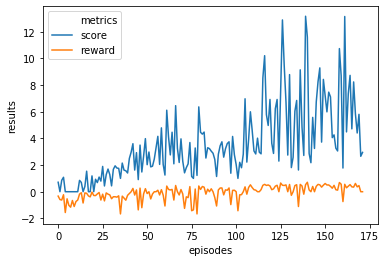

Max Train Score 25 Max Test Score 28
Mean Train Score 3.5435550264706595 Mean Test Score 6.844380332576347
----------------------------------------------------------------------------------------------------
Learning Rate 0.0013197979371411934


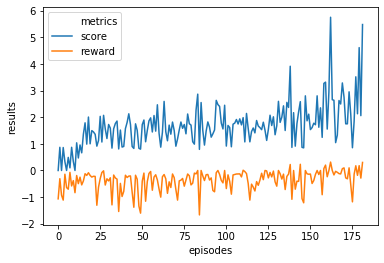

Max Train Score 12 Max Test Score 16
Mean Train Score 1.6845062678373295 Mean Test Score 2.8721237121552967
----------------------------------------------------------------------------------------------------
Learning Rate 0.001


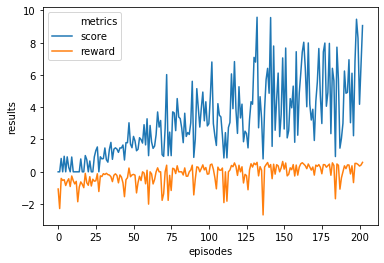

Max Train Score 19 Max Test Score 23
Mean Train Score 3.187544319534914 Mean Test Score 5.5389512802064385
----------------------------------------------------------------------------------------------------
Learning Rate 0.0015


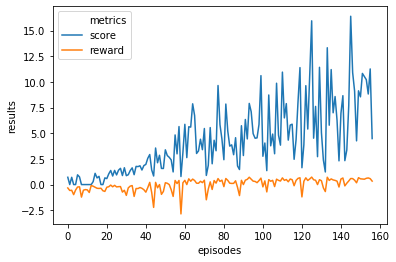

Max Train Score 33 Max Test Score 29
Mean Train Score 4.260222624820166 Mean Test Score 6.80470419433239
----------------------------------------------------------------------------------------------------
Learning Rate 0.0018


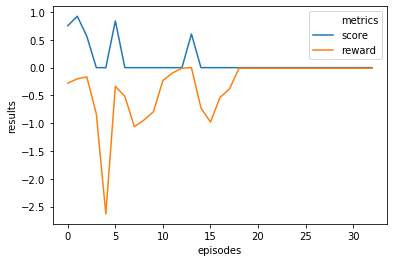

Max Train Score 1 Max Test Score 0
Mean Train Score 0.11180966285750256 Mean Test Score 0.0
----------------------------------------------------------------------------------------------------
Learning Rate 0.002


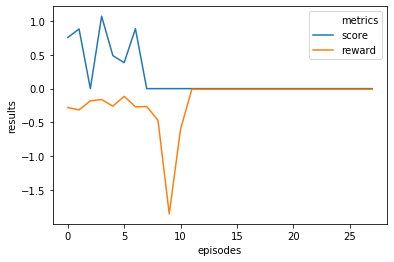

Max Train Score 2 Max Test Score 0
Mean Train Score 0.15942500621970712 Mean Test Score 0.0
----------------------------------------------------------------------------------------------------
Learning Rate 0.00095


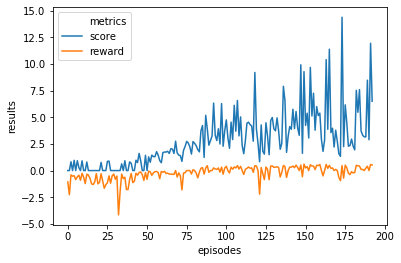

Max Train Score 26 Max Test Score 27
Mean Train Score 2.830473165383247 Mean Test Score 6.259776031443135
----------------------------------------------------------------------------------------------------
Learning Rate 0.00092


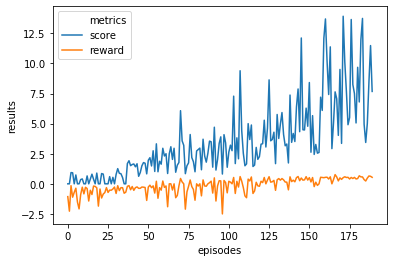

Max Train Score 29 Max Test Score 30
Mean Train Score 3.461443102697701 Mean Test Score 7.127378206363459
----------------------------------------------------------------------------------------------------
Learning Rate 0.0009


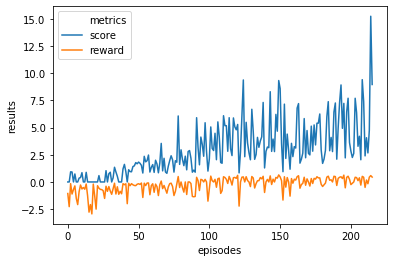

Max Train Score 27 Max Test Score 23
Mean Train Score 2.963511246827047 Mean Test Score 5.303356940667953
----------------------------------------------------------------------------------------------------
Learning Rate 0.00085


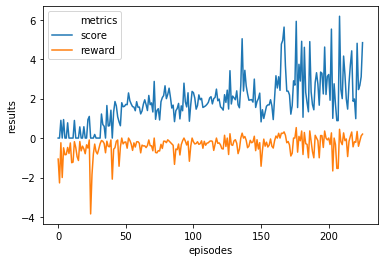

Max Train Score 11 Max Test Score 18
Mean Train Score 1.863534359940296 Mean Test Score 3.391441820825703
----------------------------------------------------------------------------------------------------
Learning Rate 0.00082


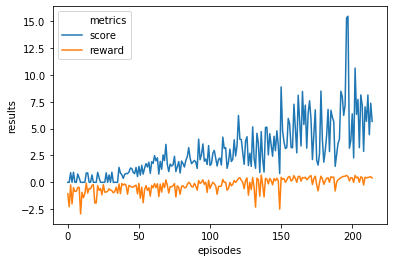

Max Train Score 29 Max Test Score 24
Mean Train Score 2.901806615409721 Mean Test Score 6.48032914179955
----------------------------------------------------------------------------------------------------
Learning Rate 0.0008


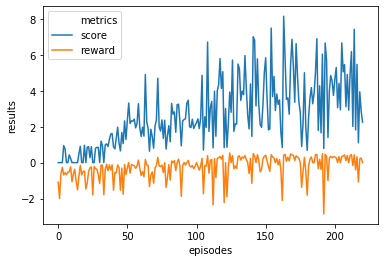

Max Train Score 15 Max Test Score 26
Mean Train Score 2.6873471003409515 Mean Test Score 5.426440096686388
----------------------------------------------------------------------------------------------------
Learning rate max results  1


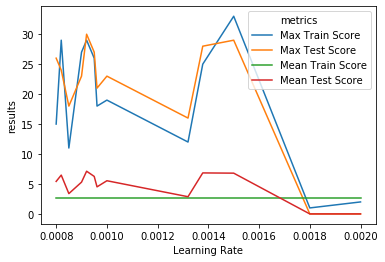

----------------------------------------------------------------------------------------------------
Using cpu device
-------------------------------------
| rollout/              |           |
|    ep_len_mean        | 103       |
|    ep_rew_mean        | -45.9     |
| time/                 |           |
|    fps                | 442       |
|    iterations         | 1000      |
|    time_elapsed       | 11        |
|    total_timesteps    | 5000      |
| train/                |           |
|    entropy_loss       | -0.0877   |
|    explained_variance | -3.53     |
|    learning_rate      | 0.000961  |
|    n_updates          | 999       |
|    policy_loss        | -3.07e-06 |
|    value_loss         | 6.95e-08  |
-------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 181      |
|    ep_rew_mean        | -43.2    |
| time/                 |          |
|    fps                | 436      |
|    iteration

------------------------------------
| rollout/              |          |
|    ep_len_mean        | 80.9     |
|    ep_rew_mean        | -5.2     |
| time/                 |          |
|    fps                | 424      |
|    iterations         | 2000     |
|    time_elapsed       | 23       |
|    total_timesteps    | 10000    |
| train/                |          |
|    entropy_loss       | -0.21    |
|    explained_variance | 0.461    |
|    learning_rate      | 0.001    |
|    n_updates          | 1999     |
|    policy_loss        | 0.197    |
|    value_loss         | 0.344    |
------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 92.7     |
|    ep_rew_mean        | 20.5     |
| time/                 |          |
|    fps                | 406      |
|    iterations         | 3000     |
|    time_elapsed       | 36       |
|    total_timesteps    | 15000    |
| train/                |          |
|

-------------------------------------
| rollout/              |           |
|    ep_len_mean        | 616       |
|    ep_rew_mean        | -25.4     |
| time/                 |           |
|    fps                | 402       |
|    iterations         | 3000      |
|    time_elapsed       | 37        |
|    total_timesteps    | 15000     |
| train/                |           |
|    entropy_loss       | -0.0287   |
|    explained_variance | -0.502    |
|    learning_rate      | 0.002     |
|    n_updates          | 2999      |
|    policy_loss        | -3.17e-05 |
|    value_loss         | 7.1e-05   |
-------------------------------------
-------------------------------------
| rollout/              |           |
|    ep_len_mean        | 671       |
|    ep_rew_mean        | -23.2     |
| time/                 |           |
|    fps                | 405       |
|    iterations         | 4000      |
|    time_elapsed       | 49        |
|    total_timesteps    | 20000     |
| train/    

------------------------------------
| rollout/              |          |
|    ep_len_mean        | 111      |
|    ep_rew_mean        | 33.3     |
| time/                 |          |
|    fps                | 370      |
|    iterations         | 4000     |
|    time_elapsed       | 54       |
|    total_timesteps    | 20000    |
| train/                |          |
|    entropy_loss       | -0.00227 |
|    explained_variance | 0.988    |
|    learning_rate      | 0.0009   |
|    n_updates          | 3999     |
|    policy_loss        | 3.22e-05 |
|    value_loss         | 0.176    |
------------------------------------
Using cpu device
-------------------------------------
| rollout/              |           |
|    ep_len_mean        | 103       |
|    ep_rew_mean        | -41.7     |
| time/                 |           |
|    fps                | 390       |
|    iterations         | 1000      |
|    time_elapsed       | 12        |
|    total_timesteps    | 5000      |
| train/    

Learning Rate 0.0009610612889534735


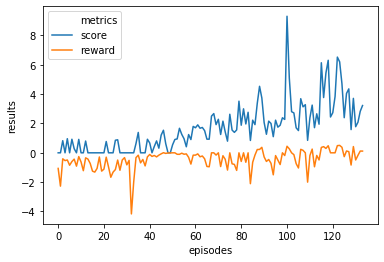

Max Train Score 18 Max Test Score 21
Mean Train Score 1.7021355433098802 Mean Test Score 4.517731764561764
----------------------------------------------------------------------------------------------------
Learning Rate 0.0013779226379577784


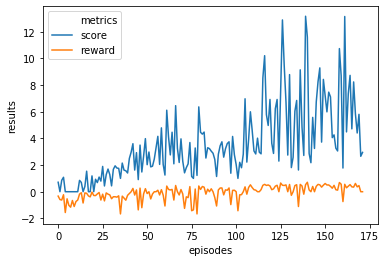

Max Train Score 25 Max Test Score 28
Mean Train Score 3.5435550264706595 Mean Test Score 6.844380332576347
----------------------------------------------------------------------------------------------------
Learning Rate 0.0013197979371411934


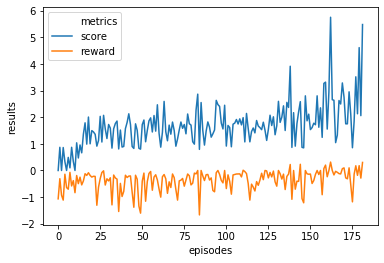

Max Train Score 12 Max Test Score 16
Mean Train Score 1.6845062678373295 Mean Test Score 2.8721237121552967
----------------------------------------------------------------------------------------------------
Learning Rate 0.001


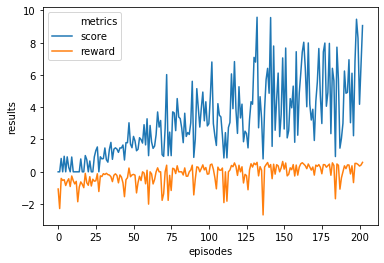

Max Train Score 19 Max Test Score 23
Mean Train Score 3.187544319534914 Mean Test Score 5.5389512802064385
----------------------------------------------------------------------------------------------------
Learning Rate 0.0015


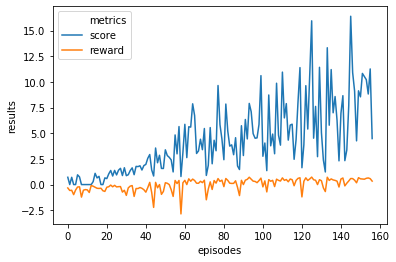

Max Train Score 33 Max Test Score 29
Mean Train Score 4.260222624820166 Mean Test Score 6.80470419433239
----------------------------------------------------------------------------------------------------
Learning Rate 0.0018


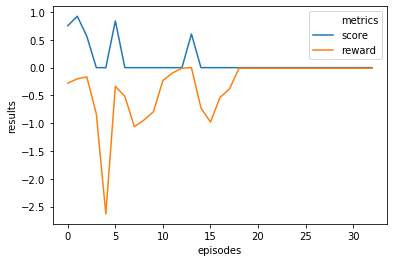

Max Train Score 1 Max Test Score 0
Mean Train Score 0.11180966285750256 Mean Test Score 0.0
----------------------------------------------------------------------------------------------------
Learning Rate 0.002


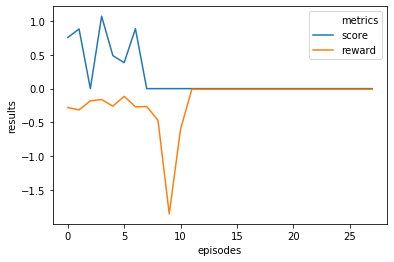

Max Train Score 2 Max Test Score 0
Mean Train Score 0.15942500621970712 Mean Test Score 0.0
----------------------------------------------------------------------------------------------------
Learning Rate 0.00095


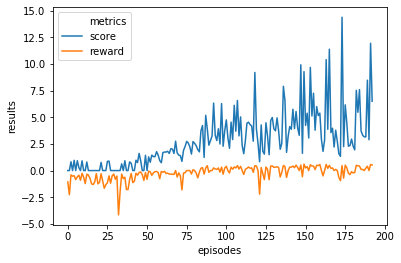

Max Train Score 26 Max Test Score 27
Mean Train Score 2.830473165383247 Mean Test Score 6.259776031443135
----------------------------------------------------------------------------------------------------
Learning Rate 0.00092


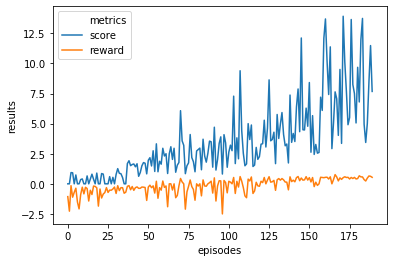

Max Train Score 29 Max Test Score 30
Mean Train Score 3.461443102697701 Mean Test Score 7.127378206363459
----------------------------------------------------------------------------------------------------
Learning Rate 0.0009


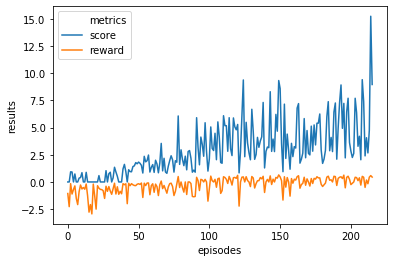

Max Train Score 27 Max Test Score 23
Mean Train Score 2.963511246827047 Mean Test Score 5.303356940667953
----------------------------------------------------------------------------------------------------
Learning Rate 0.00085


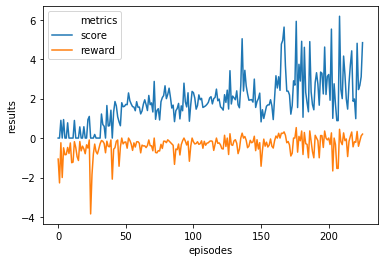

Max Train Score 11 Max Test Score 18
Mean Train Score 1.863534359940296 Mean Test Score 3.391441820825703
----------------------------------------------------------------------------------------------------
Learning Rate 0.00082


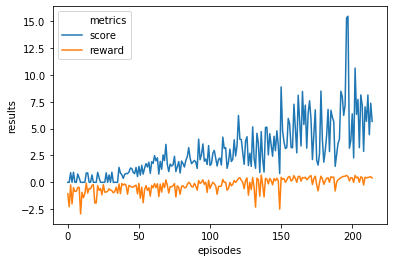

Max Train Score 29 Max Test Score 24
Mean Train Score 2.901806615409721 Mean Test Score 6.48032914179955
----------------------------------------------------------------------------------------------------
Learning Rate 0.0008


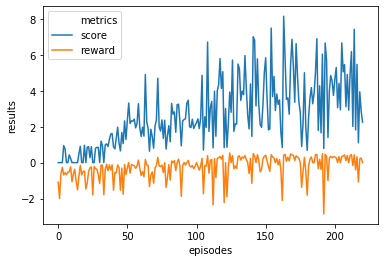

Max Train Score 15 Max Test Score 26
Mean Train Score 2.6873471003409515 Mean Test Score 5.426440096686388
----------------------------------------------------------------------------------------------------
Learning rate max results  2


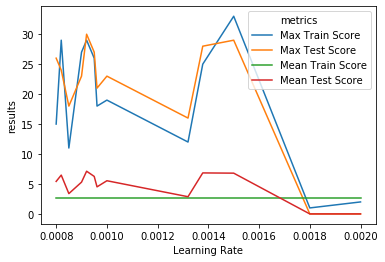

----------------------------------------------------------------------------------------------------
Using cpu device
-------------------------------------
| rollout/              |           |
|    ep_len_mean        | 103       |
|    ep_rew_mean        | -45.9     |
| time/                 |           |
|    fps                | 351       |
|    iterations         | 1000      |
|    time_elapsed       | 14        |
|    total_timesteps    | 5000      |
| train/                |           |
|    entropy_loss       | -0.0877   |
|    explained_variance | -3.53     |
|    learning_rate      | 0.000961  |
|    n_updates          | 999       |
|    policy_loss        | -3.07e-06 |
|    value_loss         | 6.95e-08  |
-------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 181      |
|    ep_rew_mean        | -43.2    |
| time/                 |          |
|    fps                | 364      |
|    iteration

------------------------------------
| rollout/              |          |
|    ep_len_mean        | 80.9     |
|    ep_rew_mean        | -5.2     |
| time/                 |          |
|    fps                | 424      |
|    iterations         | 2000     |
|    time_elapsed       | 23       |
|    total_timesteps    | 10000    |
| train/                |          |
|    entropy_loss       | -0.21    |
|    explained_variance | 0.461    |
|    learning_rate      | 0.001    |
|    n_updates          | 1999     |
|    policy_loss        | 0.197    |
|    value_loss         | 0.344    |
------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 92.7     |
|    ep_rew_mean        | 20.5     |
| time/                 |          |
|    fps                | 420      |
|    iterations         | 3000     |
|    time_elapsed       | 35       |
|    total_timesteps    | 15000    |
| train/                |          |
|

-------------------------------------
| rollout/              |           |
|    ep_len_mean        | 616       |
|    ep_rew_mean        | -25.4     |
| time/                 |           |
|    fps                | 431       |
|    iterations         | 3000      |
|    time_elapsed       | 34        |
|    total_timesteps    | 15000     |
| train/                |           |
|    entropy_loss       | -0.0287   |
|    explained_variance | -0.502    |
|    learning_rate      | 0.002     |
|    n_updates          | 2999      |
|    policy_loss        | -3.17e-05 |
|    value_loss         | 7.1e-05   |
-------------------------------------
-------------------------------------
| rollout/              |           |
|    ep_len_mean        | 671       |
|    ep_rew_mean        | -23.2     |
| time/                 |           |
|    fps                | 420       |
|    iterations         | 4000      |
|    time_elapsed       | 47        |
|    total_timesteps    | 20000     |
| train/    

------------------------------------
| rollout/              |          |
|    ep_len_mean        | 111      |
|    ep_rew_mean        | 33.3     |
| time/                 |          |
|    fps                | 433      |
|    iterations         | 4000     |
|    time_elapsed       | 46       |
|    total_timesteps    | 20000    |
| train/                |          |
|    entropy_loss       | -0.00227 |
|    explained_variance | 0.988    |
|    learning_rate      | 0.0009   |
|    n_updates          | 3999     |
|    policy_loss        | 3.22e-05 |
|    value_loss         | 0.176    |
------------------------------------
Using cpu device
-------------------------------------
| rollout/              |           |
|    ep_len_mean        | 103       |
|    ep_rew_mean        | -41.7     |
| time/                 |           |
|    fps                | 404       |
|    iterations         | 1000      |
|    time_elapsed       | 12        |
|    total_timesteps    | 5000      |
| train/    

Learning Rate 0.0009610612889534735


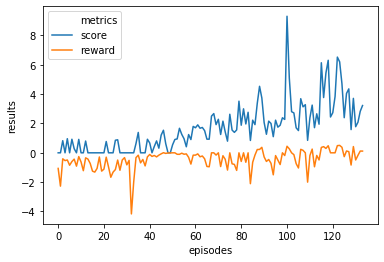

Max Train Score 18 Max Test Score 21
Mean Train Score 1.7021355433098802 Mean Test Score 4.517731764561764
----------------------------------------------------------------------------------------------------
Learning Rate 0.0013779226379577784


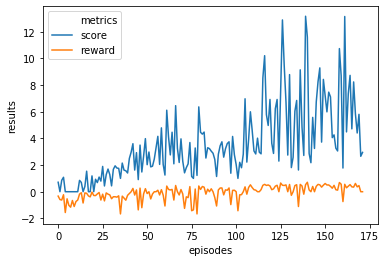

Max Train Score 25 Max Test Score 28
Mean Train Score 3.5435550264706595 Mean Test Score 6.844380332576347
----------------------------------------------------------------------------------------------------
Learning Rate 0.0013197979371411934


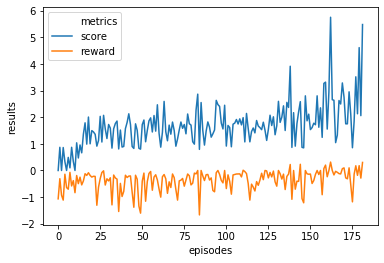

Max Train Score 12 Max Test Score 16
Mean Train Score 1.6845062678373295 Mean Test Score 2.8721237121552967
----------------------------------------------------------------------------------------------------
Learning Rate 0.001


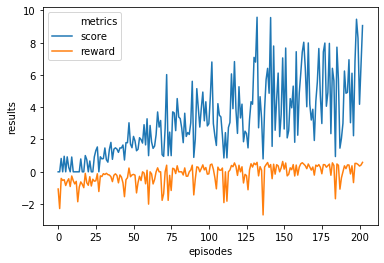

Max Train Score 19 Max Test Score 23
Mean Train Score 3.187544319534914 Mean Test Score 5.5389512802064385
----------------------------------------------------------------------------------------------------
Learning Rate 0.0015


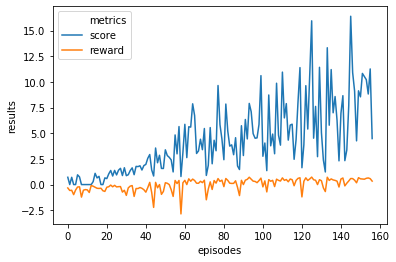

Max Train Score 33 Max Test Score 29
Mean Train Score 4.260222624820166 Mean Test Score 6.80470419433239
----------------------------------------------------------------------------------------------------
Learning Rate 0.0018


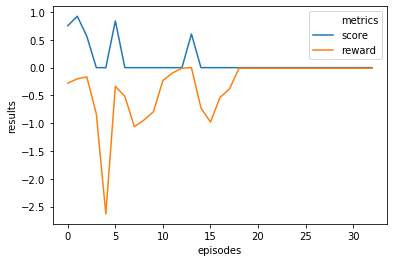

Max Train Score 1 Max Test Score 0
Mean Train Score 0.11180966285750256 Mean Test Score 0.0
----------------------------------------------------------------------------------------------------
Learning Rate 0.002


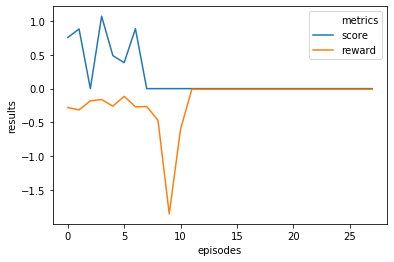

Max Train Score 2 Max Test Score 0
Mean Train Score 0.15942500621970712 Mean Test Score 0.0
----------------------------------------------------------------------------------------------------
Learning Rate 0.00095


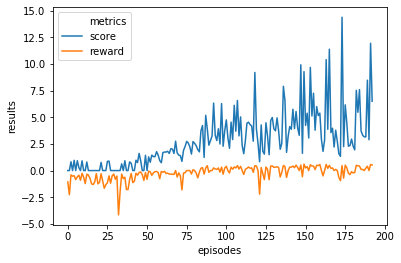

Max Train Score 26 Max Test Score 27
Mean Train Score 2.830473165383247 Mean Test Score 6.259776031443135
----------------------------------------------------------------------------------------------------
Learning Rate 0.00092


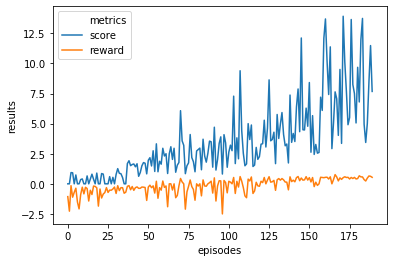

Max Train Score 29 Max Test Score 30
Mean Train Score 3.461443102697701 Mean Test Score 7.127378206363459
----------------------------------------------------------------------------------------------------
Learning Rate 0.0009


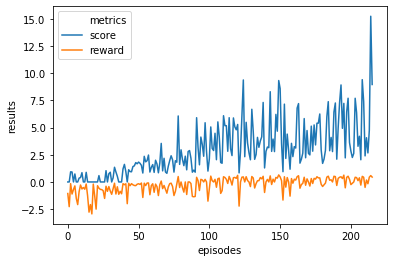

Max Train Score 27 Max Test Score 23
Mean Train Score 2.963511246827047 Mean Test Score 5.303356940667953
----------------------------------------------------------------------------------------------------
Learning Rate 0.00085


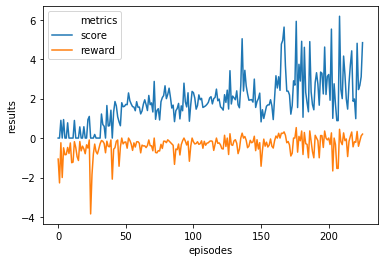

Max Train Score 11 Max Test Score 18
Mean Train Score 1.863534359940296 Mean Test Score 3.391441820825703
----------------------------------------------------------------------------------------------------
Learning Rate 0.00082


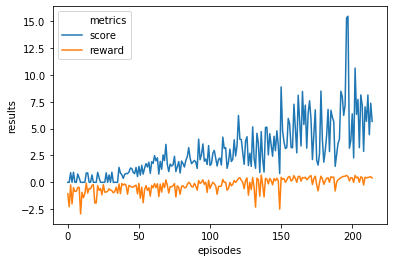

Max Train Score 29 Max Test Score 24
Mean Train Score 2.901806615409721 Mean Test Score 6.48032914179955
----------------------------------------------------------------------------------------------------
Learning Rate 0.0008


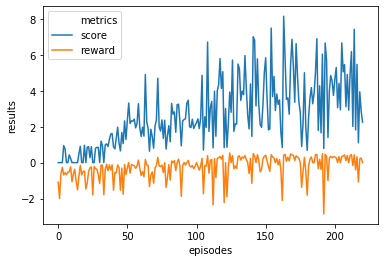

Max Train Score 15 Max Test Score 26
Mean Train Score 2.6873471003409515 Mean Test Score 5.426440096686388
----------------------------------------------------------------------------------------------------
Learning rate max results  3


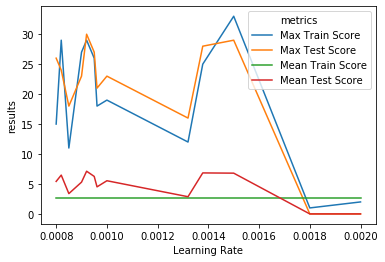

----------------------------------------------------------------------------------------------------
Using cpu device
-------------------------------------
| rollout/              |           |
|    ep_len_mean        | 103       |
|    ep_rew_mean        | -45.9     |
| time/                 |           |
|    fps                | 368       |
|    iterations         | 1000      |
|    time_elapsed       | 13        |
|    total_timesteps    | 5000      |
| train/                |           |
|    entropy_loss       | -0.0877   |
|    explained_variance | -3.53     |
|    learning_rate      | 0.000961  |
|    n_updates          | 999       |
|    policy_loss        | -3.07e-06 |
|    value_loss         | 6.95e-08  |
-------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 181      |
|    ep_rew_mean        | -43.2    |
| time/                 |          |
|    fps                | 385      |
|    iteration

------------------------------------
| rollout/              |          |
|    ep_len_mean        | 80.9     |
|    ep_rew_mean        | -5.2     |
| time/                 |          |
|    fps                | 383      |
|    iterations         | 2000     |
|    time_elapsed       | 26       |
|    total_timesteps    | 10000    |
| train/                |          |
|    entropy_loss       | -0.21    |
|    explained_variance | 0.461    |
|    learning_rate      | 0.001    |
|    n_updates          | 1999     |
|    policy_loss        | 0.197    |
|    value_loss         | 0.344    |
------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 92.7     |
|    ep_rew_mean        | 20.5     |
| time/                 |          |
|    fps                | 395      |
|    iterations         | 3000     |
|    time_elapsed       | 37       |
|    total_timesteps    | 15000    |
| train/                |          |
|

-------------------------------------
| rollout/              |           |
|    ep_len_mean        | 616       |
|    ep_rew_mean        | -25.4     |
| time/                 |           |
|    fps                | 464       |
|    iterations         | 3000      |
|    time_elapsed       | 32        |
|    total_timesteps    | 15000     |
| train/                |           |
|    entropy_loss       | -0.0287   |
|    explained_variance | -0.502    |
|    learning_rate      | 0.002     |
|    n_updates          | 2999      |
|    policy_loss        | -3.17e-05 |
|    value_loss         | 7.1e-05   |
-------------------------------------
-------------------------------------
| rollout/              |           |
|    ep_len_mean        | 671       |
|    ep_rew_mean        | -23.2     |
| time/                 |           |
|    fps                | 465       |
|    iterations         | 4000      |
|    time_elapsed       | 42        |
|    total_timesteps    | 20000     |
| train/    

------------------------------------
| rollout/              |          |
|    ep_len_mean        | 111      |
|    ep_rew_mean        | 33.3     |
| time/                 |          |
|    fps                | 431      |
|    iterations         | 4000     |
|    time_elapsed       | 46       |
|    total_timesteps    | 20000    |
| train/                |          |
|    entropy_loss       | -0.00227 |
|    explained_variance | 0.988    |
|    learning_rate      | 0.0009   |
|    n_updates          | 3999     |
|    policy_loss        | 3.22e-05 |
|    value_loss         | 0.176    |
------------------------------------
Using cpu device
-------------------------------------
| rollout/              |           |
|    ep_len_mean        | 103       |
|    ep_rew_mean        | -41.7     |
| time/                 |           |
|    fps                | 442       |
|    iterations         | 1000      |
|    time_elapsed       | 11        |
|    total_timesteps    | 5000      |
| train/    

Learning Rate 0.0009610612889534735


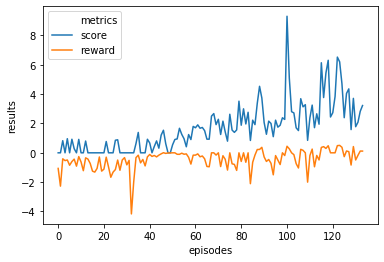

Max Train Score 18 Max Test Score 21
Mean Train Score 1.7021355433098802 Mean Test Score 4.517731764561764
----------------------------------------------------------------------------------------------------
Learning Rate 0.0013779226379577784


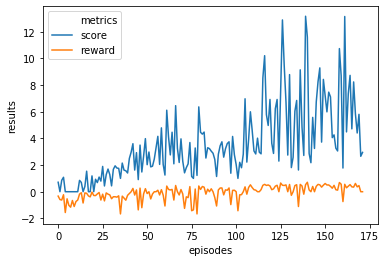

Max Train Score 25 Max Test Score 28
Mean Train Score 3.5435550264706595 Mean Test Score 6.844380332576347
----------------------------------------------------------------------------------------------------
Learning Rate 0.0013197979371411934


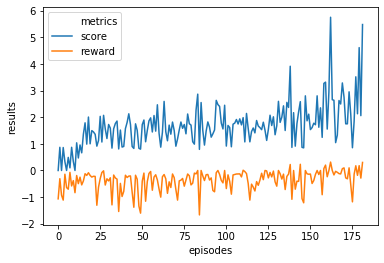

Max Train Score 12 Max Test Score 16
Mean Train Score 1.6845062678373295 Mean Test Score 2.8721237121552967
----------------------------------------------------------------------------------------------------
Learning Rate 0.001


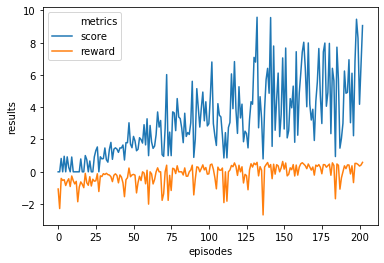

Max Train Score 19 Max Test Score 23
Mean Train Score 3.187544319534914 Mean Test Score 5.5389512802064385
----------------------------------------------------------------------------------------------------
Learning Rate 0.0015


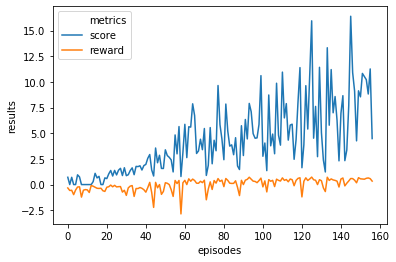

Max Train Score 33 Max Test Score 29
Mean Train Score 4.260222624820166 Mean Test Score 6.80470419433239
----------------------------------------------------------------------------------------------------
Learning Rate 0.0018


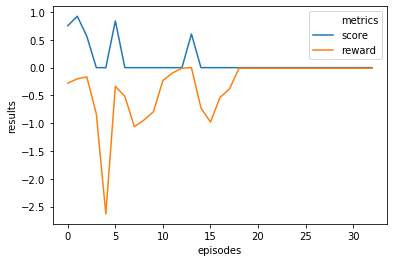

Max Train Score 1 Max Test Score 0
Mean Train Score 0.11180966285750256 Mean Test Score 0.0
----------------------------------------------------------------------------------------------------
Learning Rate 0.002


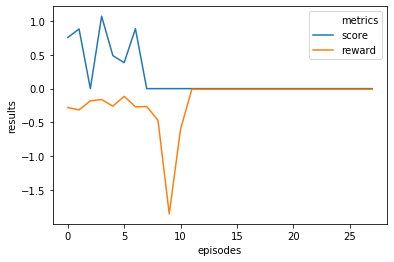

Max Train Score 2 Max Test Score 0
Mean Train Score 0.15942500621970712 Mean Test Score 0.0
----------------------------------------------------------------------------------------------------
Learning Rate 0.00095


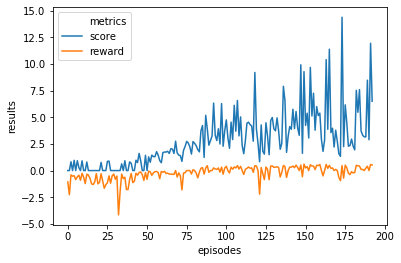

Max Train Score 26 Max Test Score 27
Mean Train Score 2.830473165383247 Mean Test Score 6.259776031443135
----------------------------------------------------------------------------------------------------
Learning Rate 0.00092


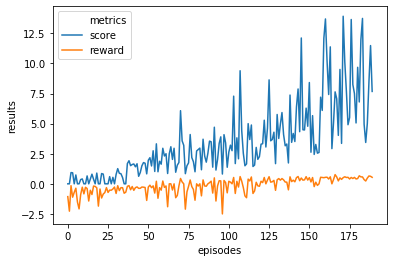

Max Train Score 29 Max Test Score 30
Mean Train Score 3.461443102697701 Mean Test Score 7.127378206363459
----------------------------------------------------------------------------------------------------
Learning Rate 0.0009


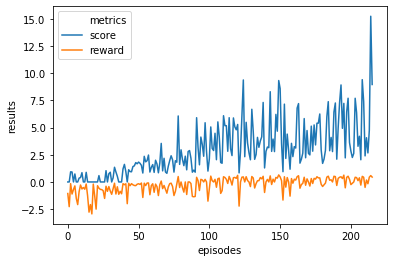

Max Train Score 27 Max Test Score 23
Mean Train Score 2.963511246827047 Mean Test Score 5.303356940667953
----------------------------------------------------------------------------------------------------
Learning Rate 0.00085


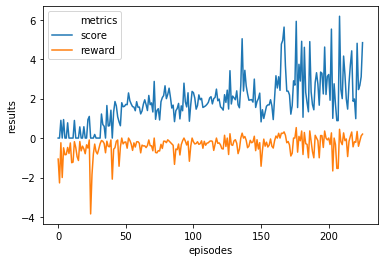

Max Train Score 11 Max Test Score 18
Mean Train Score 1.863534359940296 Mean Test Score 3.391441820825703
----------------------------------------------------------------------------------------------------
Learning Rate 0.00082


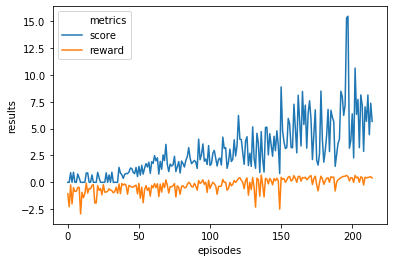

Max Train Score 29 Max Test Score 24
Mean Train Score 2.901806615409721 Mean Test Score 6.48032914179955
----------------------------------------------------------------------------------------------------
Learning Rate 0.0008


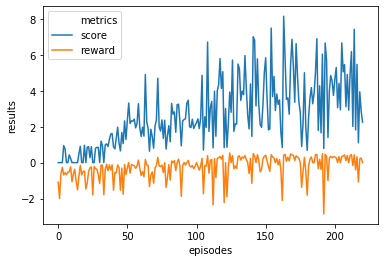

Max Train Score 15 Max Test Score 26
Mean Train Score 2.6873471003409515 Mean Test Score 5.426440096686388
----------------------------------------------------------------------------------------------------
Learning rate max results  4


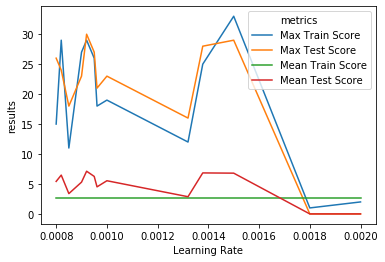

----------------------------------------------------------------------------------------------------
Using cpu device
-------------------------------------
| rollout/              |           |
|    ep_len_mean        | 103       |
|    ep_rew_mean        | -45.9     |
| time/                 |           |
|    fps                | 424       |
|    iterations         | 1000      |
|    time_elapsed       | 11        |
|    total_timesteps    | 5000      |
| train/                |           |
|    entropy_loss       | -0.0877   |
|    explained_variance | -3.53     |
|    learning_rate      | 0.000961  |
|    n_updates          | 999       |
|    policy_loss        | -3.07e-06 |
|    value_loss         | 6.95e-08  |
-------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 181      |
|    ep_rew_mean        | -43.2    |
| time/                 |          |
|    fps                | 434      |
|    iteration

------------------------------------
| rollout/              |          |
|    ep_len_mean        | 80.9     |
|    ep_rew_mean        | -5.2     |
| time/                 |          |
|    fps                | 420      |
|    iterations         | 2000     |
|    time_elapsed       | 23       |
|    total_timesteps    | 10000    |
| train/                |          |
|    entropy_loss       | -0.21    |
|    explained_variance | 0.461    |
|    learning_rate      | 0.001    |
|    n_updates          | 1999     |
|    policy_loss        | 0.197    |
|    value_loss         | 0.344    |
------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 92.7     |
|    ep_rew_mean        | 20.5     |
| time/                 |          |
|    fps                | 426      |
|    iterations         | 3000     |
|    time_elapsed       | 35       |
|    total_timesteps    | 15000    |
| train/                |          |
|

-------------------------------------
| rollout/              |           |
|    ep_len_mean        | 616       |
|    ep_rew_mean        | -25.4     |
| time/                 |           |
|    fps                | 457       |
|    iterations         | 3000      |
|    time_elapsed       | 32        |
|    total_timesteps    | 15000     |
| train/                |           |
|    entropy_loss       | -0.0287   |
|    explained_variance | -0.502    |
|    learning_rate      | 0.002     |
|    n_updates          | 2999      |
|    policy_loss        | -3.17e-05 |
|    value_loss         | 7.1e-05   |
-------------------------------------
-------------------------------------
| rollout/              |           |
|    ep_len_mean        | 671       |
|    ep_rew_mean        | -23.2     |
| time/                 |           |
|    fps                | 461       |
|    iterations         | 4000      |
|    time_elapsed       | 43        |
|    total_timesteps    | 20000     |
| train/    

------------------------------------
| rollout/              |          |
|    ep_len_mean        | 111      |
|    ep_rew_mean        | 33.3     |
| time/                 |          |
|    fps                | 420      |
|    iterations         | 4000     |
|    time_elapsed       | 47       |
|    total_timesteps    | 20000    |
| train/                |          |
|    entropy_loss       | -0.00227 |
|    explained_variance | 0.988    |
|    learning_rate      | 0.0009   |
|    n_updates          | 3999     |
|    policy_loss        | 3.22e-05 |
|    value_loss         | 0.176    |
------------------------------------
Using cpu device
-------------------------------------
| rollout/              |           |
|    ep_len_mean        | 103       |
|    ep_rew_mean        | -41.7     |
| time/                 |           |
|    fps                | 424       |
|    iterations         | 1000      |
|    time_elapsed       | 11        |
|    total_timesteps    | 5000      |
| train/    

Learning Rate 0.0009610612889534735


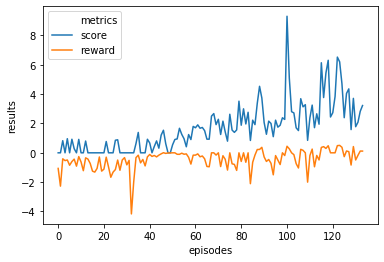

Max Train Score 18 Max Test Score 21
Mean Train Score 1.7021355433098802 Mean Test Score 4.517731764561764
----------------------------------------------------------------------------------------------------
Learning Rate 0.0013779226379577784


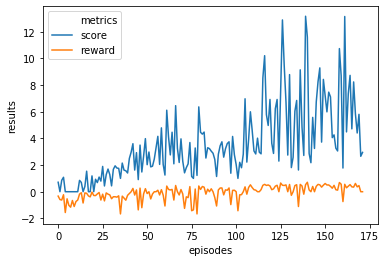

Max Train Score 25 Max Test Score 28
Mean Train Score 3.5435550264706595 Mean Test Score 6.844380332576347
----------------------------------------------------------------------------------------------------
Learning Rate 0.0013197979371411934


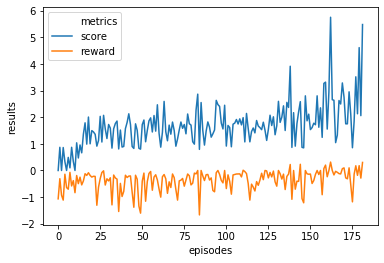

Max Train Score 12 Max Test Score 16
Mean Train Score 1.6845062678373295 Mean Test Score 2.8721237121552967
----------------------------------------------------------------------------------------------------
Learning Rate 0.001


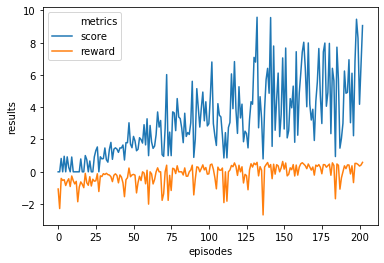

Max Train Score 19 Max Test Score 23
Mean Train Score 3.187544319534914 Mean Test Score 5.5389512802064385
----------------------------------------------------------------------------------------------------
Learning Rate 0.0015


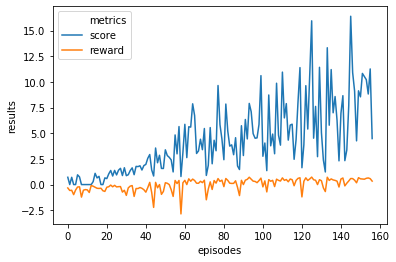

Max Train Score 33 Max Test Score 29
Mean Train Score 4.260222624820166 Mean Test Score 6.80470419433239
----------------------------------------------------------------------------------------------------
Learning Rate 0.0018


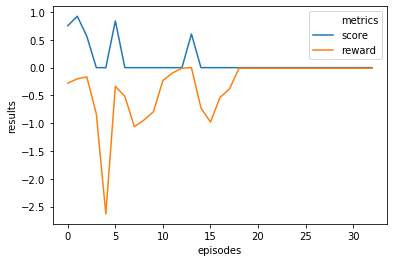

Max Train Score 1 Max Test Score 0
Mean Train Score 0.11180966285750256 Mean Test Score 0.0
----------------------------------------------------------------------------------------------------
Learning Rate 0.002


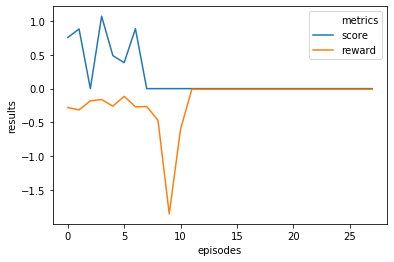

Max Train Score 2 Max Test Score 0
Mean Train Score 0.15942500621970712 Mean Test Score 0.0
----------------------------------------------------------------------------------------------------
Learning Rate 0.00095


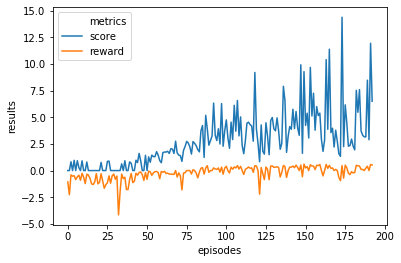

Max Train Score 26 Max Test Score 27
Mean Train Score 2.830473165383247 Mean Test Score 6.259776031443135
----------------------------------------------------------------------------------------------------
Learning Rate 0.00092


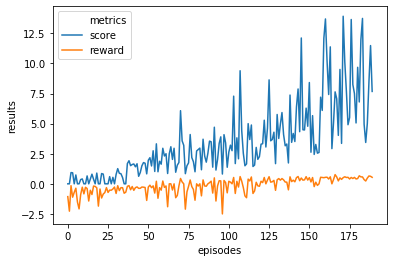

Max Train Score 29 Max Test Score 30
Mean Train Score 3.461443102697701 Mean Test Score 7.127378206363459
----------------------------------------------------------------------------------------------------
Learning Rate 0.0009


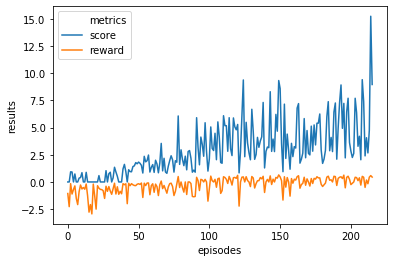

Max Train Score 27 Max Test Score 23
Mean Train Score 2.963511246827047 Mean Test Score 5.303356940667953
----------------------------------------------------------------------------------------------------
Learning Rate 0.00085


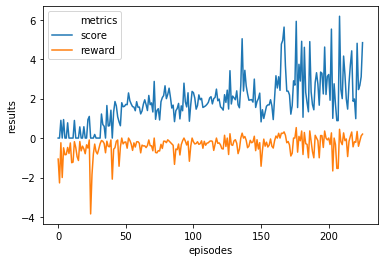

Max Train Score 11 Max Test Score 18
Mean Train Score 1.863534359940296 Mean Test Score 3.391441820825703
----------------------------------------------------------------------------------------------------
Learning Rate 0.00082


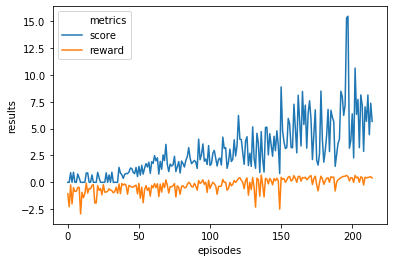

Max Train Score 29 Max Test Score 24
Mean Train Score 2.901806615409721 Mean Test Score 6.48032914179955
----------------------------------------------------------------------------------------------------
Learning Rate 0.0008


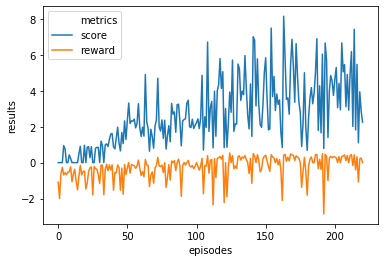

Max Train Score 15 Max Test Score 26
Mean Train Score 2.6873471003409515 Mean Test Score 5.426440096686388
----------------------------------------------------------------------------------------------------
Learning rate max results  5


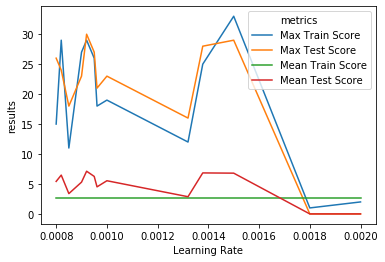

----------------------------------------------------------------------------------------------------
Using cpu device
-------------------------------------
| rollout/              |           |
|    ep_len_mean        | 103       |
|    ep_rew_mean        | -45.9     |
| time/                 |           |
|    fps                | 409       |
|    iterations         | 1000      |
|    time_elapsed       | 12        |
|    total_timesteps    | 5000      |
| train/                |           |
|    entropy_loss       | -0.0877   |
|    explained_variance | -3.53     |
|    learning_rate      | 0.000961  |
|    n_updates          | 999       |
|    policy_loss        | -3.07e-06 |
|    value_loss         | 6.95e-08  |
-------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 181      |
|    ep_rew_mean        | -43.2    |
| time/                 |          |
|    fps                | 431      |
|    iteration

------------------------------------
| rollout/              |          |
|    ep_len_mean        | 80.9     |
|    ep_rew_mean        | -5.2     |
| time/                 |          |
|    fps                | 413      |
|    iterations         | 2000     |
|    time_elapsed       | 24       |
|    total_timesteps    | 10000    |
| train/                |          |
|    entropy_loss       | -0.21    |
|    explained_variance | 0.461    |
|    learning_rate      | 0.001    |
|    n_updates          | 1999     |
|    policy_loss        | 0.197    |
|    value_loss         | 0.344    |
------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 92.7     |
|    ep_rew_mean        | 20.5     |
| time/                 |          |
|    fps                | 416      |
|    iterations         | 3000     |
|    time_elapsed       | 36       |
|    total_timesteps    | 15000    |
| train/                |          |
|

-------------------------------------
| rollout/              |           |
|    ep_len_mean        | 616       |
|    ep_rew_mean        | -25.4     |
| time/                 |           |
|    fps                | 464       |
|    iterations         | 3000      |
|    time_elapsed       | 32        |
|    total_timesteps    | 15000     |
| train/                |           |
|    entropy_loss       | -0.0287   |
|    explained_variance | -0.502    |
|    learning_rate      | 0.002     |
|    n_updates          | 2999      |
|    policy_loss        | -3.17e-05 |
|    value_loss         | 7.1e-05   |
-------------------------------------
-------------------------------------
| rollout/              |           |
|    ep_len_mean        | 671       |
|    ep_rew_mean        | -23.2     |
| time/                 |           |
|    fps                | 461       |
|    iterations         | 4000      |
|    time_elapsed       | 43        |
|    total_timesteps    | 20000     |
| train/    

------------------------------------
| rollout/              |          |
|    ep_len_mean        | 111      |
|    ep_rew_mean        | 33.3     |
| time/                 |          |
|    fps                | 426      |
|    iterations         | 4000     |
|    time_elapsed       | 46       |
|    total_timesteps    | 20000    |
| train/                |          |
|    entropy_loss       | -0.00227 |
|    explained_variance | 0.988    |
|    learning_rate      | 0.0009   |
|    n_updates          | 3999     |
|    policy_loss        | 3.22e-05 |
|    value_loss         | 0.176    |
------------------------------------
Using cpu device
-------------------------------------
| rollout/              |           |
|    ep_len_mean        | 103       |
|    ep_rew_mean        | -41.7     |
| time/                 |           |
|    fps                | 444       |
|    iterations         | 1000      |
|    time_elapsed       | 11        |
|    total_timesteps    | 5000      |
| train/    

Learning Rate 0.0009610612889534735


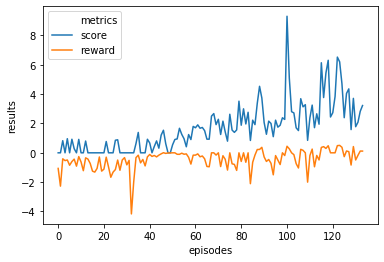

Max Train Score 18 Max Test Score 21
Mean Train Score 1.7021355433098802 Mean Test Score 4.517731764561764
----------------------------------------------------------------------------------------------------
Learning Rate 0.0013779226379577784


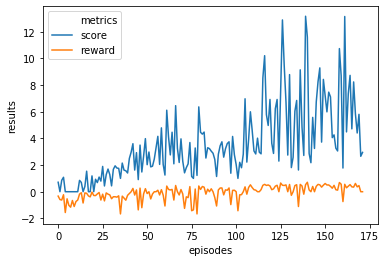

Max Train Score 25 Max Test Score 28
Mean Train Score 3.5435550264706595 Mean Test Score 6.844380332576347
----------------------------------------------------------------------------------------------------
Learning Rate 0.0013197979371411934


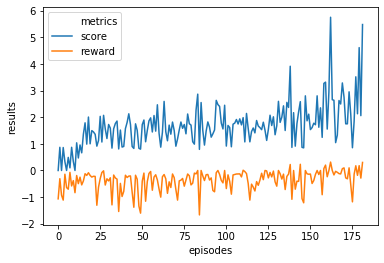

Max Train Score 12 Max Test Score 16
Mean Train Score 1.6845062678373295 Mean Test Score 2.8721237121552967
----------------------------------------------------------------------------------------------------
Learning Rate 0.001


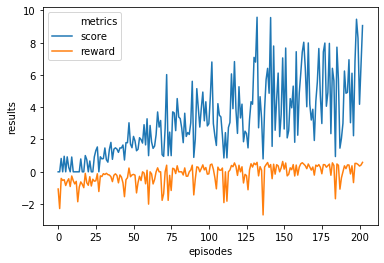

Max Train Score 19 Max Test Score 23
Mean Train Score 3.187544319534914 Mean Test Score 5.5389512802064385
----------------------------------------------------------------------------------------------------
Learning Rate 0.0015


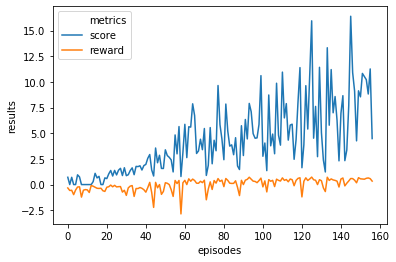

Max Train Score 33 Max Test Score 29
Mean Train Score 4.260222624820166 Mean Test Score 6.80470419433239
----------------------------------------------------------------------------------------------------
Learning Rate 0.0018


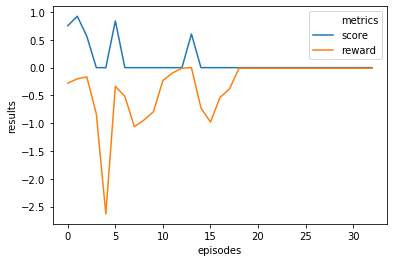

Max Train Score 1 Max Test Score 0
Mean Train Score 0.11180966285750256 Mean Test Score 0.0
----------------------------------------------------------------------------------------------------
Learning Rate 0.002


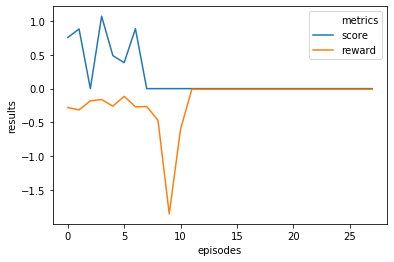

Max Train Score 2 Max Test Score 0
Mean Train Score 0.15942500621970712 Mean Test Score 0.0
----------------------------------------------------------------------------------------------------
Learning Rate 0.00095


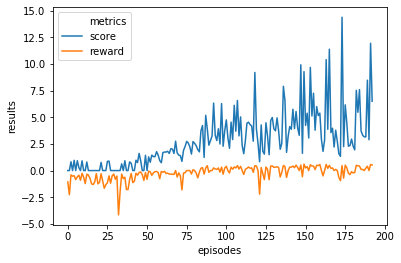

Max Train Score 26 Max Test Score 27
Mean Train Score 2.830473165383247 Mean Test Score 6.259776031443135
----------------------------------------------------------------------------------------------------
Learning Rate 0.00092


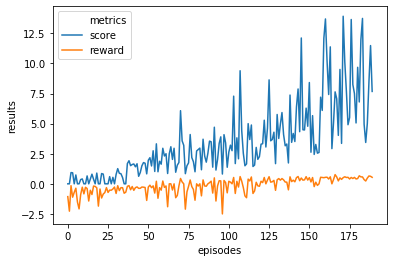

Max Train Score 29 Max Test Score 30
Mean Train Score 3.461443102697701 Mean Test Score 7.127378206363459
----------------------------------------------------------------------------------------------------
Learning Rate 0.0009


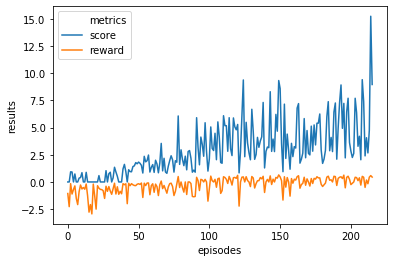

Max Train Score 27 Max Test Score 23
Mean Train Score 2.963511246827047 Mean Test Score 5.303356940667953
----------------------------------------------------------------------------------------------------
Learning Rate 0.00085


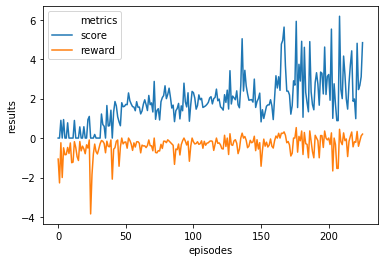

Max Train Score 11 Max Test Score 18
Mean Train Score 1.863534359940296 Mean Test Score 3.391441820825703
----------------------------------------------------------------------------------------------------
Learning Rate 0.00082


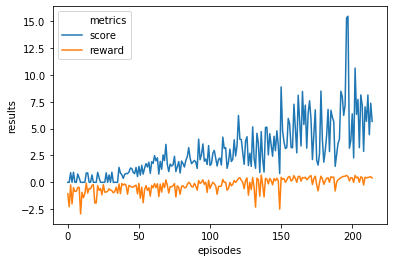

Max Train Score 29 Max Test Score 24
Mean Train Score 2.901806615409721 Mean Test Score 6.48032914179955
----------------------------------------------------------------------------------------------------
Learning Rate 0.0008


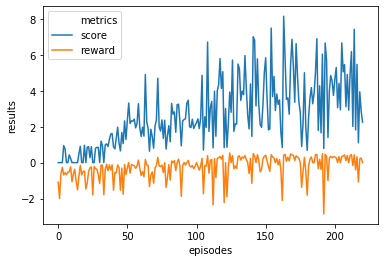

Max Train Score 15 Max Test Score 26
Mean Train Score 2.6873471003409515 Mean Test Score 5.426440096686388
----------------------------------------------------------------------------------------------------
Learning rate max results  6


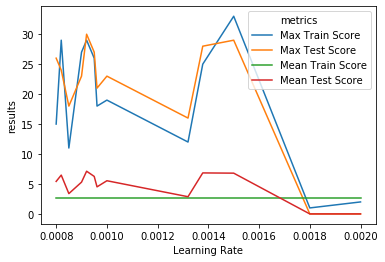

----------------------------------------------------------------------------------------------------
Using cpu device
-------------------------------------
| rollout/              |           |
|    ep_len_mean        | 103       |
|    ep_rew_mean        | -45.9     |
| time/                 |           |
|    fps                | 425       |
|    iterations         | 1000      |
|    time_elapsed       | 11        |
|    total_timesteps    | 5000      |
| train/                |           |
|    entropy_loss       | -0.0877   |
|    explained_variance | -3.53     |
|    learning_rate      | 0.000961  |
|    n_updates          | 999       |
|    policy_loss        | -3.07e-06 |
|    value_loss         | 6.95e-08  |
-------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 181      |
|    ep_rew_mean        | -43.2    |
| time/                 |          |
|    fps                | 438      |
|    iteration

------------------------------------
| rollout/              |          |
|    ep_len_mean        | 80.9     |
|    ep_rew_mean        | -5.2     |
| time/                 |          |
|    fps                | 417      |
|    iterations         | 2000     |
|    time_elapsed       | 23       |
|    total_timesteps    | 10000    |
| train/                |          |
|    entropy_loss       | -0.21    |
|    explained_variance | 0.461    |
|    learning_rate      | 0.001    |
|    n_updates          | 1999     |
|    policy_loss        | 0.197    |
|    value_loss         | 0.344    |
------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 92.7     |
|    ep_rew_mean        | 20.5     |
| time/                 |          |
|    fps                | 423      |
|    iterations         | 3000     |
|    time_elapsed       | 35       |
|    total_timesteps    | 15000    |
| train/                |          |
|

-------------------------------------
| rollout/              |           |
|    ep_len_mean        | 616       |
|    ep_rew_mean        | -25.4     |
| time/                 |           |
|    fps                | 456       |
|    iterations         | 3000      |
|    time_elapsed       | 32        |
|    total_timesteps    | 15000     |
| train/                |           |
|    entropy_loss       | -0.0287   |
|    explained_variance | -0.502    |
|    learning_rate      | 0.002     |
|    n_updates          | 2999      |
|    policy_loss        | -3.17e-05 |
|    value_loss         | 7.1e-05   |
-------------------------------------
-------------------------------------
| rollout/              |           |
|    ep_len_mean        | 671       |
|    ep_rew_mean        | -23.2     |
| time/                 |           |
|    fps                | 459       |
|    iterations         | 4000      |
|    time_elapsed       | 43        |
|    total_timesteps    | 20000     |
| train/    

------------------------------------
| rollout/              |          |
|    ep_len_mean        | 111      |
|    ep_rew_mean        | 33.3     |
| time/                 |          |
|    fps                | 429      |
|    iterations         | 4000     |
|    time_elapsed       | 46       |
|    total_timesteps    | 20000    |
| train/                |          |
|    entropy_loss       | -0.00227 |
|    explained_variance | 0.988    |
|    learning_rate      | 0.0009   |
|    n_updates          | 3999     |
|    policy_loss        | 3.22e-05 |
|    value_loss         | 0.176    |
------------------------------------
Using cpu device
-------------------------------------
| rollout/              |           |
|    ep_len_mean        | 103       |
|    ep_rew_mean        | -41.7     |
| time/                 |           |
|    fps                | 412       |
|    iterations         | 1000      |
|    time_elapsed       | 12        |
|    total_timesteps    | 5000      |
| train/    

Learning Rate 0.0009610612889534735


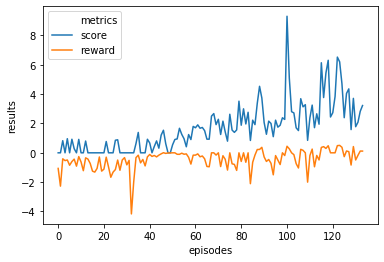

Max Train Score 18 Max Test Score 21
Mean Train Score 1.7021355433098802 Mean Test Score 4.517731764561764
----------------------------------------------------------------------------------------------------
Learning Rate 0.0013779226379577784


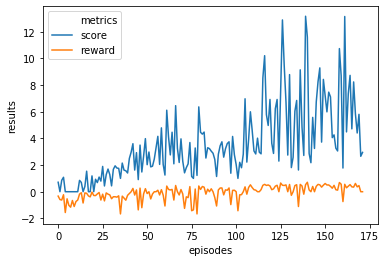

Max Train Score 25 Max Test Score 28
Mean Train Score 3.5435550264706595 Mean Test Score 6.844380332576347
----------------------------------------------------------------------------------------------------
Learning Rate 0.0013197979371411934


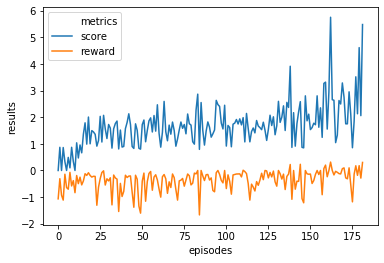

Max Train Score 12 Max Test Score 16
Mean Train Score 1.6845062678373295 Mean Test Score 2.8721237121552967
----------------------------------------------------------------------------------------------------
Learning Rate 0.001


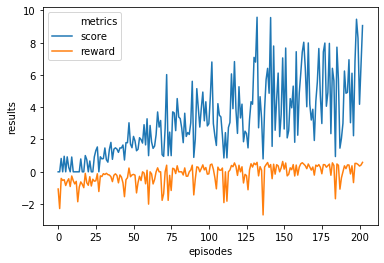

Max Train Score 19 Max Test Score 23
Mean Train Score 3.187544319534914 Mean Test Score 5.5389512802064385
----------------------------------------------------------------------------------------------------
Learning Rate 0.0015


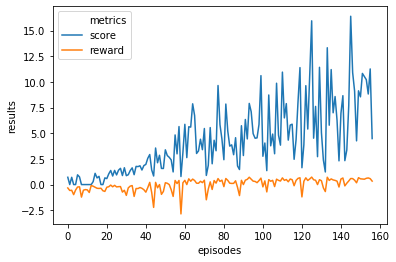

Max Train Score 33 Max Test Score 29
Mean Train Score 4.260222624820166 Mean Test Score 6.80470419433239
----------------------------------------------------------------------------------------------------
Learning Rate 0.0018


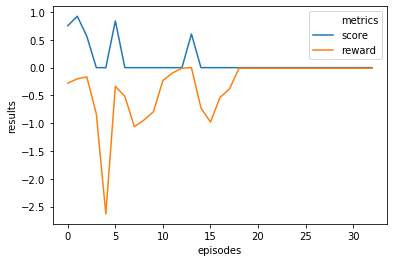

Max Train Score 1 Max Test Score 0
Mean Train Score 0.11180966285750256 Mean Test Score 0.0
----------------------------------------------------------------------------------------------------
Learning Rate 0.002


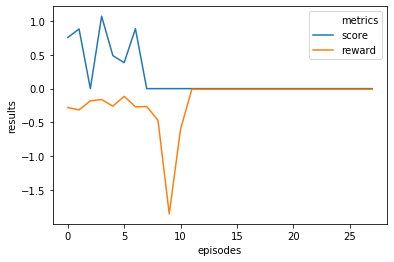

Max Train Score 2 Max Test Score 0
Mean Train Score 0.15942500621970712 Mean Test Score 0.0
----------------------------------------------------------------------------------------------------
Learning Rate 0.00095


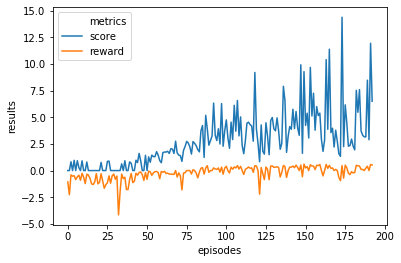

Max Train Score 26 Max Test Score 27
Mean Train Score 2.830473165383247 Mean Test Score 6.259776031443135
----------------------------------------------------------------------------------------------------
Learning Rate 0.00092


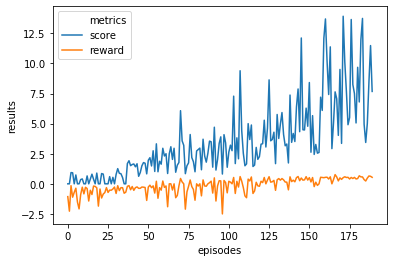

Max Train Score 29 Max Test Score 30
Mean Train Score 3.461443102697701 Mean Test Score 7.127378206363459
----------------------------------------------------------------------------------------------------
Learning Rate 0.0009


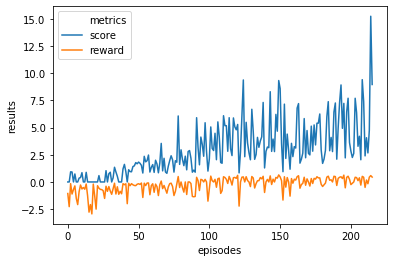

Max Train Score 27 Max Test Score 23
Mean Train Score 2.963511246827047 Mean Test Score 5.303356940667953
----------------------------------------------------------------------------------------------------
Learning Rate 0.00085


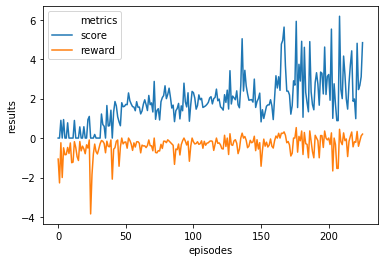

Max Train Score 11 Max Test Score 18
Mean Train Score 1.863534359940296 Mean Test Score 3.391441820825703
----------------------------------------------------------------------------------------------------
Learning Rate 0.00082


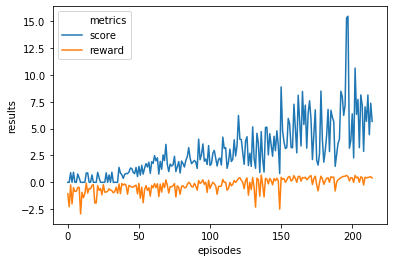

Max Train Score 29 Max Test Score 24
Mean Train Score 2.901806615409721 Mean Test Score 6.48032914179955
----------------------------------------------------------------------------------------------------
Learning Rate 0.0008


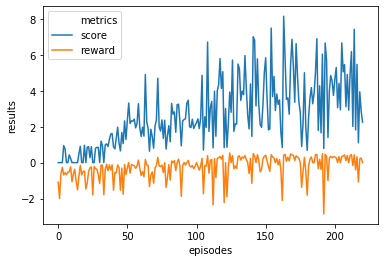

Max Train Score 15 Max Test Score 26
Mean Train Score 2.6873471003409515 Mean Test Score 5.426440096686388
----------------------------------------------------------------------------------------------------
Learning rate max results  7


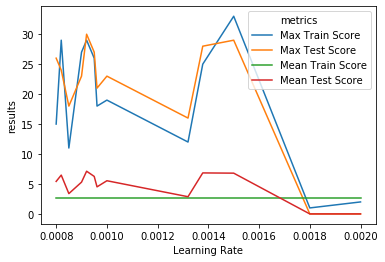

----------------------------------------------------------------------------------------------------
Using cpu device
-------------------------------------
| rollout/              |           |
|    ep_len_mean        | 103       |
|    ep_rew_mean        | -45.9     |
| time/                 |           |
|    fps                | 436       |
|    iterations         | 1000      |
|    time_elapsed       | 11        |
|    total_timesteps    | 5000      |
| train/                |           |
|    entropy_loss       | -0.0877   |
|    explained_variance | -3.53     |
|    learning_rate      | 0.000961  |
|    n_updates          | 999       |
|    policy_loss        | -3.07e-06 |
|    value_loss         | 6.95e-08  |
-------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 181      |
|    ep_rew_mean        | -43.2    |
| time/                 |          |
|    fps                | 449      |
|    iteration

------------------------------------
| rollout/              |          |
|    ep_len_mean        | 80.9     |
|    ep_rew_mean        | -5.2     |
| time/                 |          |
|    fps                | 422      |
|    iterations         | 2000     |
|    time_elapsed       | 23       |
|    total_timesteps    | 10000    |
| train/                |          |
|    entropy_loss       | -0.21    |
|    explained_variance | 0.461    |
|    learning_rate      | 0.001    |
|    n_updates          | 1999     |
|    policy_loss        | 0.197    |
|    value_loss         | 0.344    |
------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 92.7     |
|    ep_rew_mean        | 20.5     |
| time/                 |          |
|    fps                | 427      |
|    iterations         | 3000     |
|    time_elapsed       | 35       |
|    total_timesteps    | 15000    |
| train/                |          |
|

-------------------------------------
| rollout/              |           |
|    ep_len_mean        | 616       |
|    ep_rew_mean        | -25.4     |
| time/                 |           |
|    fps                | 438       |
|    iterations         | 3000      |
|    time_elapsed       | 34        |
|    total_timesteps    | 15000     |
| train/                |           |
|    entropy_loss       | -0.0287   |
|    explained_variance | -0.502    |
|    learning_rate      | 0.002     |
|    n_updates          | 2999      |
|    policy_loss        | -3.17e-05 |
|    value_loss         | 7.1e-05   |
-------------------------------------
-------------------------------------
| rollout/              |           |
|    ep_len_mean        | 671       |
|    ep_rew_mean        | -23.2     |
| time/                 |           |
|    fps                | 445       |
|    iterations         | 4000      |
|    time_elapsed       | 44        |
|    total_timesteps    | 20000     |
| train/    

------------------------------------
| rollout/              |          |
|    ep_len_mean        | 111      |
|    ep_rew_mean        | 33.3     |
| time/                 |          |
|    fps                | 418      |
|    iterations         | 4000     |
|    time_elapsed       | 47       |
|    total_timesteps    | 20000    |
| train/                |          |
|    entropy_loss       | -0.00227 |
|    explained_variance | 0.988    |
|    learning_rate      | 0.0009   |
|    n_updates          | 3999     |
|    policy_loss        | 3.22e-05 |
|    value_loss         | 0.176    |
------------------------------------
Using cpu device
-------------------------------------
| rollout/              |           |
|    ep_len_mean        | 103       |
|    ep_rew_mean        | -41.7     |
| time/                 |           |
|    fps                | 441       |
|    iterations         | 1000      |
|    time_elapsed       | 11        |
|    total_timesteps    | 5000      |
| train/    

Learning Rate 0.0009610612889534735


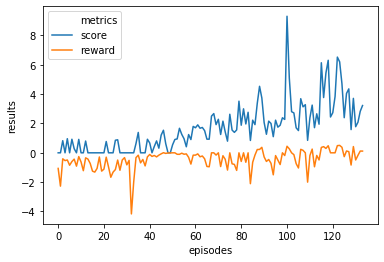

Max Train Score 18 Max Test Score 21
Mean Train Score 1.7021355433098802 Mean Test Score 4.517731764561764
----------------------------------------------------------------------------------------------------
Learning Rate 0.0013779226379577784


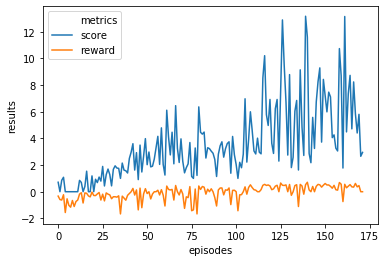

Max Train Score 25 Max Test Score 28
Mean Train Score 3.5435550264706595 Mean Test Score 6.844380332576347
----------------------------------------------------------------------------------------------------
Learning Rate 0.0013197979371411934


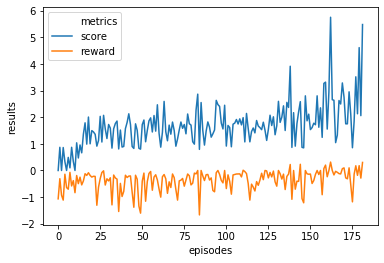

Max Train Score 12 Max Test Score 16
Mean Train Score 1.6845062678373295 Mean Test Score 2.8721237121552967
----------------------------------------------------------------------------------------------------
Learning Rate 0.001


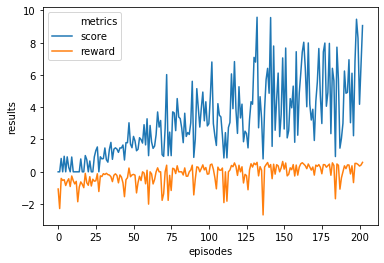

Max Train Score 19 Max Test Score 23
Mean Train Score 3.187544319534914 Mean Test Score 5.5389512802064385
----------------------------------------------------------------------------------------------------
Learning Rate 0.0015


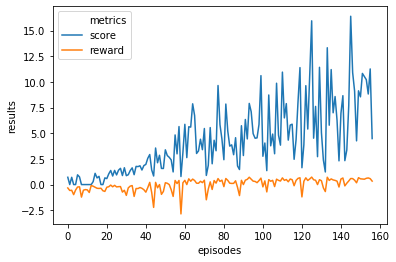

Max Train Score 33 Max Test Score 29
Mean Train Score 4.260222624820166 Mean Test Score 6.80470419433239
----------------------------------------------------------------------------------------------------
Learning Rate 0.0018


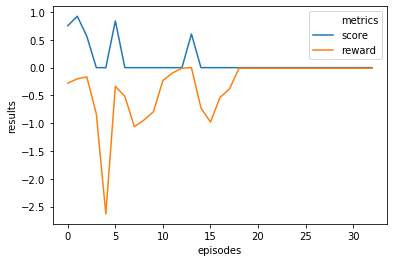

Max Train Score 1 Max Test Score 0
Mean Train Score 0.11180966285750256 Mean Test Score 0.0
----------------------------------------------------------------------------------------------------
Learning Rate 0.002


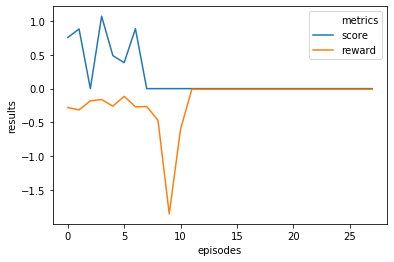

Max Train Score 2 Max Test Score 0
Mean Train Score 0.15942500621970712 Mean Test Score 0.0
----------------------------------------------------------------------------------------------------
Learning Rate 0.00095


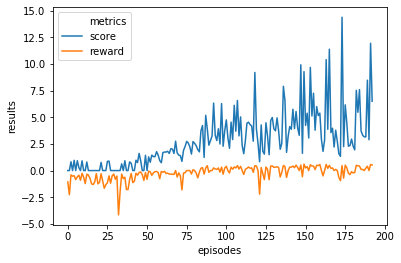

Max Train Score 26 Max Test Score 27
Mean Train Score 2.830473165383247 Mean Test Score 6.259776031443135
----------------------------------------------------------------------------------------------------
Learning Rate 0.00092


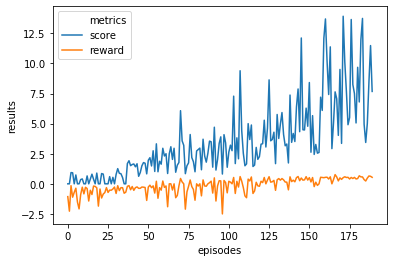

Max Train Score 29 Max Test Score 30
Mean Train Score 3.461443102697701 Mean Test Score 7.127378206363459
----------------------------------------------------------------------------------------------------
Learning Rate 0.0009


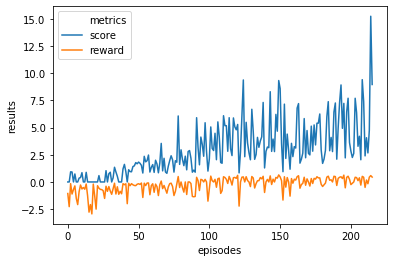

Max Train Score 27 Max Test Score 23
Mean Train Score 2.963511246827047 Mean Test Score 5.303356940667953
----------------------------------------------------------------------------------------------------
Learning Rate 0.00085


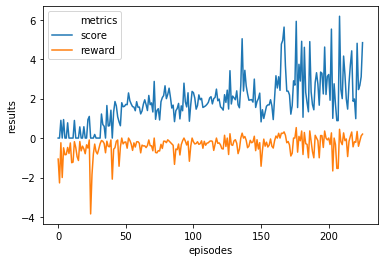

Max Train Score 11 Max Test Score 18
Mean Train Score 1.863534359940296 Mean Test Score 3.391441820825703
----------------------------------------------------------------------------------------------------
Learning Rate 0.00082


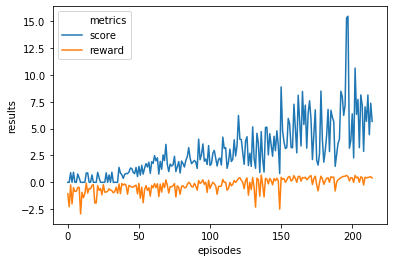

Max Train Score 29 Max Test Score 24
Mean Train Score 2.901806615409721 Mean Test Score 6.48032914179955
----------------------------------------------------------------------------------------------------
Learning Rate 0.0008


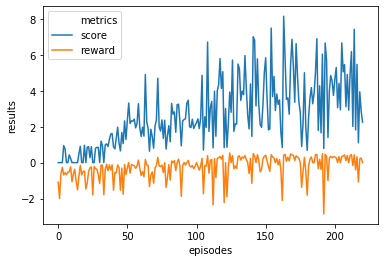

Max Train Score 15 Max Test Score 26
Mean Train Score 2.6873471003409515 Mean Test Score 5.426440096686388
----------------------------------------------------------------------------------------------------
Learning rate max results  8


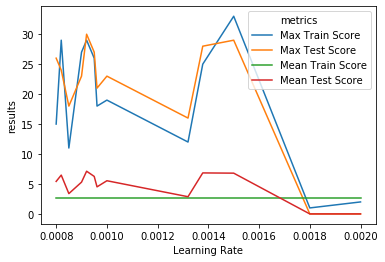

----------------------------------------------------------------------------------------------------
Using cpu device
-------------------------------------
| rollout/              |           |
|    ep_len_mean        | 103       |
|    ep_rew_mean        | -45.9     |
| time/                 |           |
|    fps                | 438       |
|    iterations         | 1000      |
|    time_elapsed       | 11        |
|    total_timesteps    | 5000      |
| train/                |           |
|    entropy_loss       | -0.0877   |
|    explained_variance | -3.53     |
|    learning_rate      | 0.000961  |
|    n_updates          | 999       |
|    policy_loss        | -3.07e-06 |
|    value_loss         | 6.95e-08  |
-------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 181      |
|    ep_rew_mean        | -43.2    |
| time/                 |          |
|    fps                | 449      |
|    iteration

------------------------------------
| rollout/              |          |
|    ep_len_mean        | 80.9     |
|    ep_rew_mean        | -5.2     |
| time/                 |          |
|    fps                | 426      |
|    iterations         | 2000     |
|    time_elapsed       | 23       |
|    total_timesteps    | 10000    |
| train/                |          |
|    entropy_loss       | -0.21    |
|    explained_variance | 0.461    |
|    learning_rate      | 0.001    |
|    n_updates          | 1999     |
|    policy_loss        | 0.197    |
|    value_loss         | 0.344    |
------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 92.7     |
|    ep_rew_mean        | 20.5     |
| time/                 |          |
|    fps                | 425      |
|    iterations         | 3000     |
|    time_elapsed       | 35       |
|    total_timesteps    | 15000    |
| train/                |          |
|

-------------------------------------
| rollout/              |           |
|    ep_len_mean        | 616       |
|    ep_rew_mean        | -25.4     |
| time/                 |           |
|    fps                | 426       |
|    iterations         | 3000      |
|    time_elapsed       | 35        |
|    total_timesteps    | 15000     |
| train/                |           |
|    entropy_loss       | -0.0287   |
|    explained_variance | -0.502    |
|    learning_rate      | 0.002     |
|    n_updates          | 2999      |
|    policy_loss        | -3.17e-05 |
|    value_loss         | 7.1e-05   |
-------------------------------------
-------------------------------------
| rollout/              |           |
|    ep_len_mean        | 671       |
|    ep_rew_mean        | -23.2     |
| time/                 |           |
|    fps                | 433       |
|    iterations         | 4000      |
|    time_elapsed       | 46        |
|    total_timesteps    | 20000     |
| train/    

------------------------------------
| rollout/              |          |
|    ep_len_mean        | 111      |
|    ep_rew_mean        | 33.3     |
| time/                 |          |
|    fps                | 430      |
|    iterations         | 4000     |
|    time_elapsed       | 46       |
|    total_timesteps    | 20000    |
| train/                |          |
|    entropy_loss       | -0.00227 |
|    explained_variance | 0.988    |
|    learning_rate      | 0.0009   |
|    n_updates          | 3999     |
|    policy_loss        | 3.22e-05 |
|    value_loss         | 0.176    |
------------------------------------
Using cpu device
-------------------------------------
| rollout/              |           |
|    ep_len_mean        | 103       |
|    ep_rew_mean        | -41.7     |
| time/                 |           |
|    fps                | 422       |
|    iterations         | 1000      |
|    time_elapsed       | 11        |
|    total_timesteps    | 5000      |
| train/    

Learning Rate 0.0009610612889534735


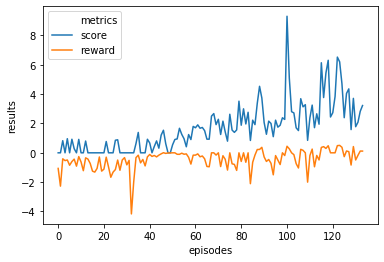

Max Train Score 18 Max Test Score 21
Mean Train Score 1.7021355433098802 Mean Test Score 4.517731764561764
----------------------------------------------------------------------------------------------------
Learning Rate 0.0013779226379577784


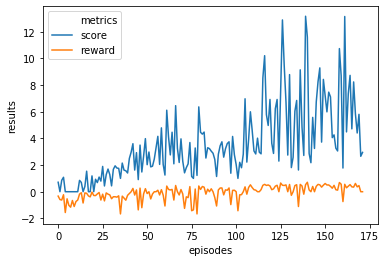

Max Train Score 25 Max Test Score 28
Mean Train Score 3.5435550264706595 Mean Test Score 6.844380332576347
----------------------------------------------------------------------------------------------------
Learning Rate 0.0013197979371411934


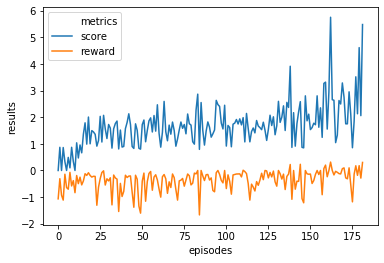

Max Train Score 12 Max Test Score 16
Mean Train Score 1.6845062678373295 Mean Test Score 2.8721237121552967
----------------------------------------------------------------------------------------------------
Learning Rate 0.001


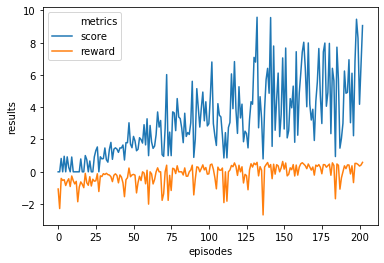

Max Train Score 19 Max Test Score 23
Mean Train Score 3.187544319534914 Mean Test Score 5.5389512802064385
----------------------------------------------------------------------------------------------------
Learning Rate 0.0015


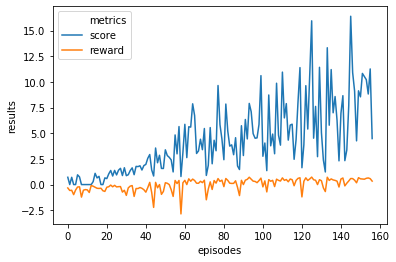

Max Train Score 33 Max Test Score 29
Mean Train Score 4.260222624820166 Mean Test Score 6.80470419433239
----------------------------------------------------------------------------------------------------
Learning Rate 0.0018


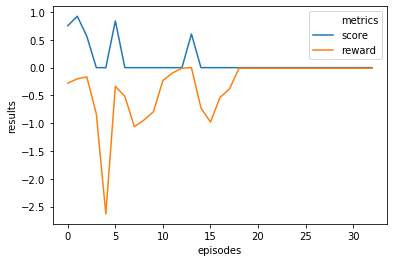

Max Train Score 1 Max Test Score 0
Mean Train Score 0.11180966285750256 Mean Test Score 0.0
----------------------------------------------------------------------------------------------------
Learning Rate 0.002


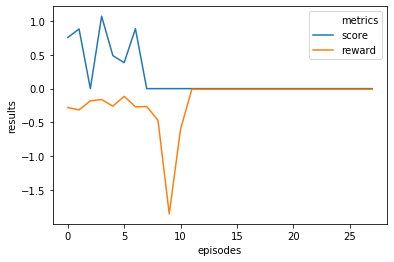

Max Train Score 2 Max Test Score 0
Mean Train Score 0.15942500621970712 Mean Test Score 0.0
----------------------------------------------------------------------------------------------------
Learning Rate 0.00095


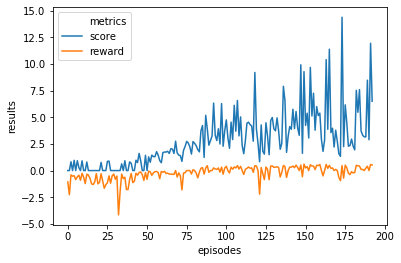

Max Train Score 26 Max Test Score 27
Mean Train Score 2.830473165383247 Mean Test Score 6.259776031443135
----------------------------------------------------------------------------------------------------
Learning Rate 0.00092


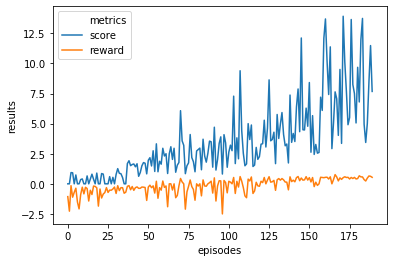

Max Train Score 29 Max Test Score 30
Mean Train Score 3.461443102697701 Mean Test Score 7.127378206363459
----------------------------------------------------------------------------------------------------
Learning Rate 0.0009


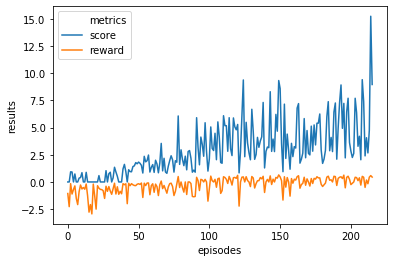

Max Train Score 27 Max Test Score 23
Mean Train Score 2.963511246827047 Mean Test Score 5.303356940667953
----------------------------------------------------------------------------------------------------
Learning Rate 0.00085


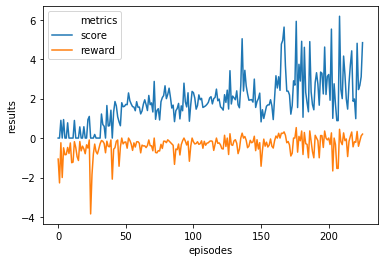

Max Train Score 11 Max Test Score 18
Mean Train Score 1.863534359940296 Mean Test Score 3.391441820825703
----------------------------------------------------------------------------------------------------
Learning Rate 0.00082


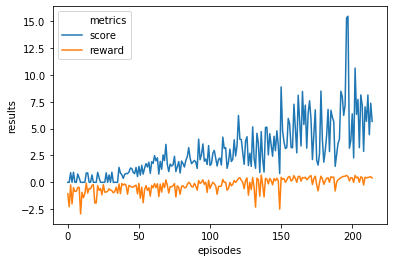

Max Train Score 29 Max Test Score 24
Mean Train Score 2.901806615409721 Mean Test Score 6.48032914179955
----------------------------------------------------------------------------------------------------
Learning Rate 0.0008


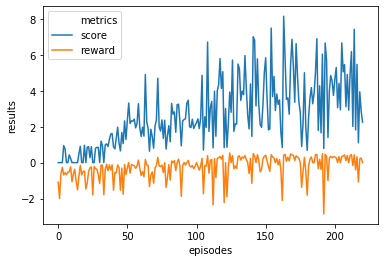

Max Train Score 15 Max Test Score 26
Mean Train Score 2.6873471003409515 Mean Test Score 5.426440096686388
----------------------------------------------------------------------------------------------------
Learning rate max results  9


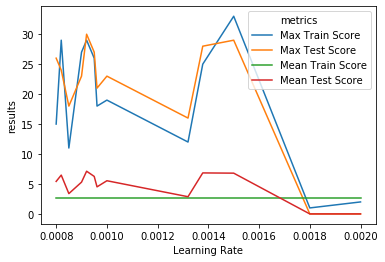

----------------------------------------------------------------------------------------------------
Using cpu device
-------------------------------------
| rollout/              |           |
|    ep_len_mean        | 103       |
|    ep_rew_mean        | -45.9     |
| time/                 |           |
|    fps                | 430       |
|    iterations         | 1000      |
|    time_elapsed       | 11        |
|    total_timesteps    | 5000      |
| train/                |           |
|    entropy_loss       | -0.0877   |
|    explained_variance | -3.53     |
|    learning_rate      | 0.000961  |
|    n_updates          | 999       |
|    policy_loss        | -3.07e-06 |
|    value_loss         | 6.95e-08  |
-------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 181      |
|    ep_rew_mean        | -43.2    |
| time/                 |          |
|    fps                | 447      |
|    iteration

------------------------------------
| rollout/              |          |
|    ep_len_mean        | 80.9     |
|    ep_rew_mean        | -5.2     |
| time/                 |          |
|    fps                | 426      |
|    iterations         | 2000     |
|    time_elapsed       | 23       |
|    total_timesteps    | 10000    |
| train/                |          |
|    entropy_loss       | -0.21    |
|    explained_variance | 0.461    |
|    learning_rate      | 0.001    |
|    n_updates          | 1999     |
|    policy_loss        | 0.197    |
|    value_loss         | 0.344    |
------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 92.7     |
|    ep_rew_mean        | 20.5     |
| time/                 |          |
|    fps                | 424      |
|    iterations         | 3000     |
|    time_elapsed       | 35       |
|    total_timesteps    | 15000    |
| train/                |          |
|

-------------------------------------
| rollout/              |           |
|    ep_len_mean        | 616       |
|    ep_rew_mean        | -25.4     |
| time/                 |           |
|    fps                | 405       |
|    iterations         | 3000      |
|    time_elapsed       | 36        |
|    total_timesteps    | 15000     |
| train/                |           |
|    entropy_loss       | -0.0287   |
|    explained_variance | -0.502    |
|    learning_rate      | 0.002     |
|    n_updates          | 2999      |
|    policy_loss        | -3.17e-05 |
|    value_loss         | 7.1e-05   |
-------------------------------------
-------------------------------------
| rollout/              |           |
|    ep_len_mean        | 671       |
|    ep_rew_mean        | -23.2     |
| time/                 |           |
|    fps                | 411       |
|    iterations         | 4000      |
|    time_elapsed       | 48        |
|    total_timesteps    | 20000     |
| train/    

------------------------------------
| rollout/              |          |
|    ep_len_mean        | 111      |
|    ep_rew_mean        | 33.3     |
| time/                 |          |
|    fps                | 422      |
|    iterations         | 4000     |
|    time_elapsed       | 47       |
|    total_timesteps    | 20000    |
| train/                |          |
|    entropy_loss       | -0.00227 |
|    explained_variance | 0.988    |
|    learning_rate      | 0.0009   |
|    n_updates          | 3999     |
|    policy_loss        | 3.22e-05 |
|    value_loss         | 0.176    |
------------------------------------
Using cpu device
-------------------------------------
| rollout/              |           |
|    ep_len_mean        | 103       |
|    ep_rew_mean        | -41.7     |
| time/                 |           |
|    fps                | 410       |
|    iterations         | 1000      |
|    time_elapsed       | 12        |
|    total_timesteps    | 5000      |
| train/    

Learning Rate 0.0009610612889534735


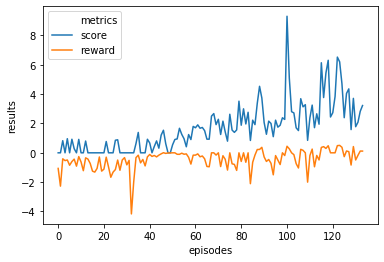

Max Train Score 18 Max Test Score 21
Mean Train Score 1.7021355433098802 Mean Test Score 4.517731764561764
----------------------------------------------------------------------------------------------------
Learning Rate 0.0013779226379577784


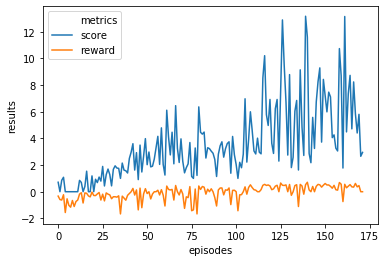

Max Train Score 25 Max Test Score 28
Mean Train Score 3.5435550264706595 Mean Test Score 6.844380332576347
----------------------------------------------------------------------------------------------------
Learning Rate 0.0013197979371411934


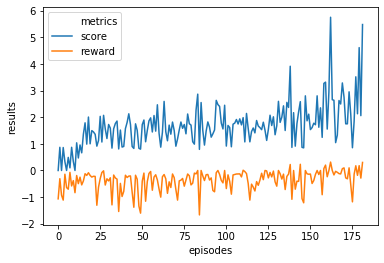

Max Train Score 12 Max Test Score 16
Mean Train Score 1.6845062678373295 Mean Test Score 2.8721237121552967
----------------------------------------------------------------------------------------------------
Learning Rate 0.001


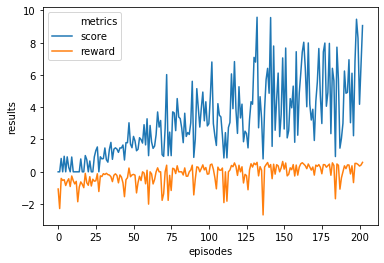

Max Train Score 19 Max Test Score 23
Mean Train Score 3.187544319534914 Mean Test Score 5.5389512802064385
----------------------------------------------------------------------------------------------------
Learning Rate 0.0015


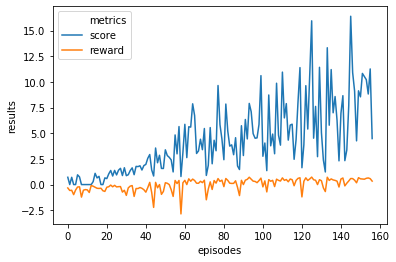

Max Train Score 33 Max Test Score 29
Mean Train Score 4.260222624820166 Mean Test Score 6.80470419433239
----------------------------------------------------------------------------------------------------
Learning Rate 0.0018


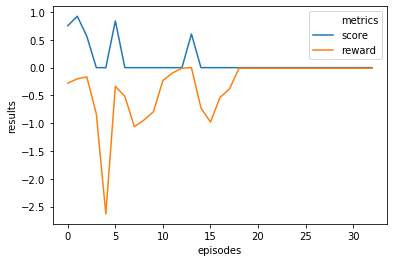

Max Train Score 1 Max Test Score 0
Mean Train Score 0.11180966285750256 Mean Test Score 0.0
----------------------------------------------------------------------------------------------------
Learning Rate 0.002


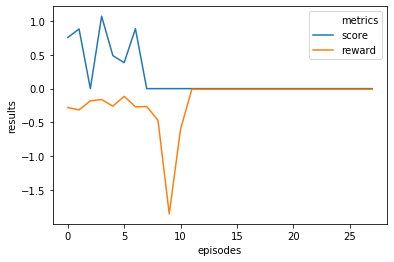

Max Train Score 2 Max Test Score 0
Mean Train Score 0.15942500621970712 Mean Test Score 0.0
----------------------------------------------------------------------------------------------------
Learning Rate 0.00095


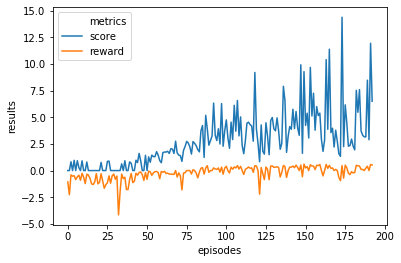

Max Train Score 26 Max Test Score 27
Mean Train Score 2.830473165383247 Mean Test Score 6.259776031443135
----------------------------------------------------------------------------------------------------
Learning Rate 0.00092


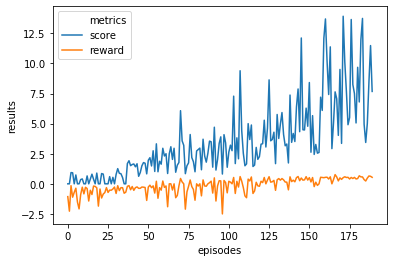

Max Train Score 29 Max Test Score 30
Mean Train Score 3.461443102697701 Mean Test Score 7.127378206363459
----------------------------------------------------------------------------------------------------
Learning Rate 0.0009


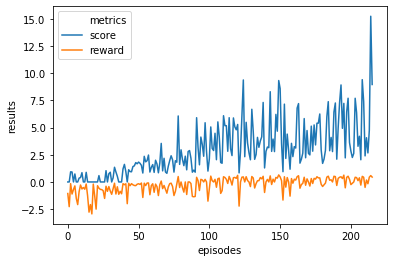

Max Train Score 27 Max Test Score 23
Mean Train Score 2.963511246827047 Mean Test Score 5.303356940667953
----------------------------------------------------------------------------------------------------
Learning Rate 0.00085


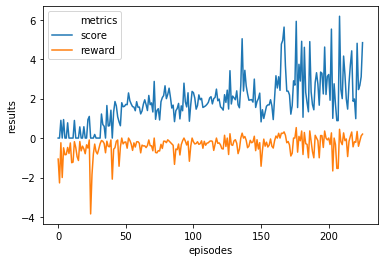

Max Train Score 11 Max Test Score 18
Mean Train Score 1.863534359940296 Mean Test Score 3.391441820825703
----------------------------------------------------------------------------------------------------
Learning Rate 0.00082


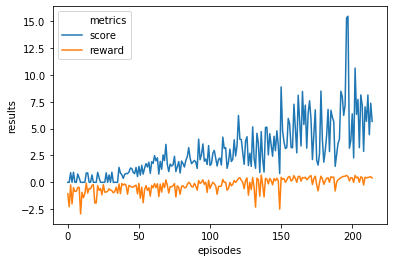

Max Train Score 29 Max Test Score 24
Mean Train Score 2.901806615409721 Mean Test Score 6.48032914179955
----------------------------------------------------------------------------------------------------
Learning Rate 0.0008


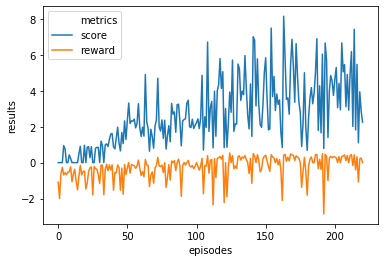

Max Train Score 15 Max Test Score 26
Mean Train Score 2.6873471003409515 Mean Test Score 5.426440096686388
----------------------------------------------------------------------------------------------------
Learning rate max results  10


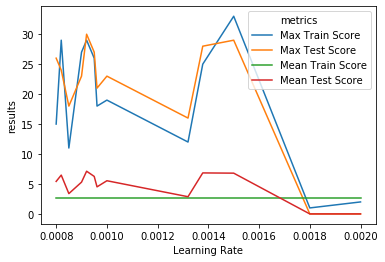

----------------------------------------------------------------------------------------------------


In [ ]:
learning_rates=[0.0009610612889534735,0.0013779226379577784,0.0013197979371411934,0.001,0.0015,0.0018,0.002,0.00095,0.00092,0.0009,0.00085,0.00082,0.0008]
for i in range(10):
    results = {}
    for learning_rate in learning_rates:
        # enable_render=True turns on the display
        snake_env = SnakeEnv(440, 440, enable_render=False)
        env = make_vec_env(lambda: snake_env, n_envs=1)

        #gamma = random.uniform(0.95, 1)
        #learning_rate=random.uniform(0.0005,0.0014)
        #print("lr: ", learning_rate)

        model = A2C(MlpPolicy, env, verbose=1, learning_rate=learning_rate,gamma=0.97, seed=42)
        model.learn(total_timesteps=20000, log_interval=1000)

        # Print rewards and scores for each episode
        max_train_score = snake_env.record
        mean_train_score = np.mean(np.array(snake_env.results['score']))
        max_test_score, mean_test_score = evaluate(model)

        results[learning_rate] = (snake_env.results, max_train_score, max_test_score, mean_train_score, mean_test_score)

    for learning_rate, result in results.items():
        metrics, max_train_score, max_test_score, mean_train_score, mean_test_score = result

        print("Learning Rate", learning_rate)
        plot_metrics(metrics)    
        print("Max Train Score", max_train_score, "Max Test Score", max_test_score)
        print("Mean Train Score", mean_train_score, "Mean Test Score", mean_test_score)
        print("-"*100)
    
    print("Learning rate max results ", i+1)
    plot_max_results(results,'Learning Rate')
    print("-"*100)

#### Result: The results remain equals in the time (for each iteration) and 0.00092 seems the best value tried

### n_eval_episode

Using cpu device
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 88.3     |
|    ep_rew_mean        | -33.6    |
| time/                 |          |
|    fps                | 425      |
|    iterations         | 1000     |
|    time_elapsed       | 11       |
|    total_timesteps    | 5000     |
| train/                |          |
|    entropy_loss       | -0.748   |
|    explained_variance | 0.303    |
|    learning_rate      | 0.001    |
|    n_updates          | 999      |
|    policy_loss        | 0.0853   |
|    value_loss         | 0.0217   |
------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 80.9     |
|    ep_rew_mean        | -5.2     |
| time/                 |          |
|    fps                | 428      |
|    iterations         | 2000     |
|    time_elapsed       | 23       |
|    total_timesteps    | 10000    |
| train/             

------------------------------------
| rollout/              |          |
|    ep_len_mean        | 80.9     |
|    ep_rew_mean        | -5.2     |
| time/                 |          |
|    fps                | 409      |
|    iterations         | 2000     |
|    time_elapsed       | 24       |
|    total_timesteps    | 10000    |
| train/                |          |
|    entropy_loss       | -0.21    |
|    explained_variance | 0.461    |
|    learning_rate      | 0.001    |
|    n_updates          | 1999     |
|    policy_loss        | 0.197    |
|    value_loss         | 0.344    |
------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 92.7     |
|    ep_rew_mean        | 20.5     |
| time/                 |          |
|    fps                | 411      |
|    iterations         | 3000     |
|    time_elapsed       | 36       |
|    total_timesteps    | 15000    |
| train/                |          |
|

------------------------------------
| rollout/              |          |
|    ep_len_mean        | 92.7     |
|    ep_rew_mean        | 20.5     |
| time/                 |          |
|    fps                | 434      |
|    iterations         | 3000     |
|    time_elapsed       | 34       |
|    total_timesteps    | 15000    |
| train/                |          |
|    entropy_loss       | -0.0174  |
|    explained_variance | nan      |
|    learning_rate      | 0.001    |
|    n_updates          | 2999     |
|    policy_loss        | -0.00224 |
|    value_loss         | 1.21     |
------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 115      |
|    ep_rew_mean        | 35.7     |
| time/                 |          |
|    fps                | 432      |
|    iterations         | 4000     |
|    time_elapsed       | 46       |
|    total_timesteps    | 20000    |
| train/                |          |
|

------------------------------------
| rollout/              |          |
|    ep_len_mean        | 115      |
|    ep_rew_mean        | 35.7     |
| time/                 |          |
|    fps                | 431      |
|    iterations         | 4000     |
|    time_elapsed       | 46       |
|    total_timesteps    | 20000    |
| train/                |          |
|    entropy_loss       | -0.226   |
|    explained_variance | 0.533    |
|    learning_rate      | 0.001    |
|    n_updates          | 3999     |
|    policy_loss        | 0.142    |
|    value_loss         | 8.79     |
------------------------------------
n_eval_episode 3468.1680570442877


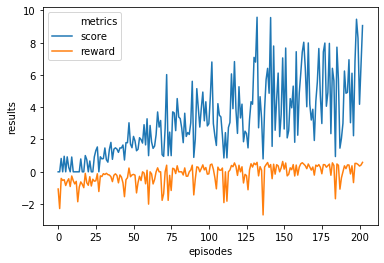

Max Train Score 19 Max Test Score 23
Mean Train Score 3.187544319534914 Mean Test Score 5.5389512802064385
----------------------------------------------------------------------------------------------------
n_eval_episode 3468.1680570442877


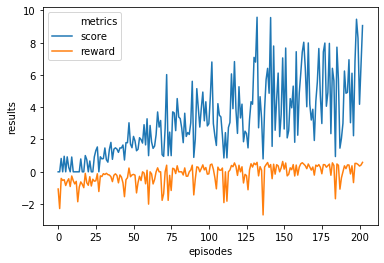

Max Train Score 19 Max Test Score 23
Mean Train Score 3.187544319534914 Mean Test Score 5.5389512802064385
----------------------------------------------------------------------------------------------------
n_eval_episode 3468.1680570442877


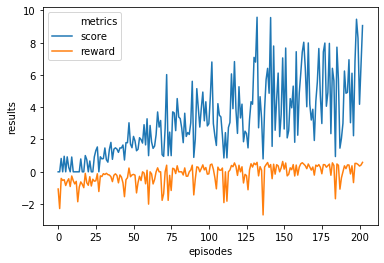

Max Train Score 19 Max Test Score 23
Mean Train Score 3.187544319534914 Mean Test Score 5.5389512802064385
----------------------------------------------------------------------------------------------------
n_eval_episode max results  10


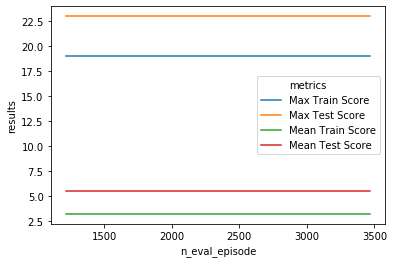

----------------------------------------------------------------------------------------------------
Using cpu device
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 88.3     |
|    ep_rew_mean        | -33.6    |
| time/                 |          |
|    fps                | 442      |
|    iterations         | 1000     |
|    time_elapsed       | 11       |
|    total_timesteps    | 5000     |
| train/                |          |
|    entropy_loss       | -0.748   |
|    explained_variance | 0.303    |
|    learning_rate      | 0.001    |
|    n_updates          | 999      |
|    policy_loss        | 0.0853   |
|    value_loss         | 0.0217   |
------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 80.9     |
|    ep_rew_mean        | -5.2     |
| time/                 |          |
|    fps                | 431      |
|    iterations         | 2000 

------------------------------------
| rollout/              |          |
|    ep_len_mean        | 80.9     |
|    ep_rew_mean        | -5.2     |
| time/                 |          |
|    fps                | 427      |
|    iterations         | 2000     |
|    time_elapsed       | 23       |
|    total_timesteps    | 10000    |
| train/                |          |
|    entropy_loss       | -0.21    |
|    explained_variance | 0.461    |
|    learning_rate      | 0.001    |
|    n_updates          | 1999     |
|    policy_loss        | 0.197    |
|    value_loss         | 0.344    |
------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 92.7     |
|    ep_rew_mean        | 20.5     |
| time/                 |          |
|    fps                | 429      |
|    iterations         | 3000     |
|    time_elapsed       | 34       |
|    total_timesteps    | 15000    |
| train/                |          |
|

------------------------------------
| rollout/              |          |
|    ep_len_mean        | 92.7     |
|    ep_rew_mean        | 20.5     |
| time/                 |          |
|    fps                | 430      |
|    iterations         | 3000     |
|    time_elapsed       | 34       |
|    total_timesteps    | 15000    |
| train/                |          |
|    entropy_loss       | -0.0174  |
|    explained_variance | nan      |
|    learning_rate      | 0.001    |
|    n_updates          | 2999     |
|    policy_loss        | -0.00224 |
|    value_loss         | 1.21     |
------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 115      |
|    ep_rew_mean        | 35.7     |
| time/                 |          |
|    fps                | 432      |
|    iterations         | 4000     |
|    time_elapsed       | 46       |
|    total_timesteps    | 20000    |
| train/                |          |
|

------------------------------------
| rollout/              |          |
|    ep_len_mean        | 115      |
|    ep_rew_mean        | 35.7     |
| time/                 |          |
|    fps                | 433      |
|    iterations         | 4000     |
|    time_elapsed       | 46       |
|    total_timesteps    | 20000    |
| train/                |          |
|    entropy_loss       | -0.226   |
|    explained_variance | 0.533    |
|    learning_rate      | 0.001    |
|    n_updates          | 3999     |
|    policy_loss        | 0.142    |
|    value_loss         | 8.79     |
------------------------------------
n_eval_episode 3468.1680570442877


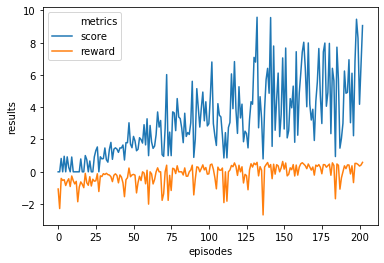

Max Train Score 19 Max Test Score 23
Mean Train Score 3.187544319534914 Mean Test Score 5.5389512802064385
----------------------------------------------------------------------------------------------------
n_eval_episode 3468.1680570442877


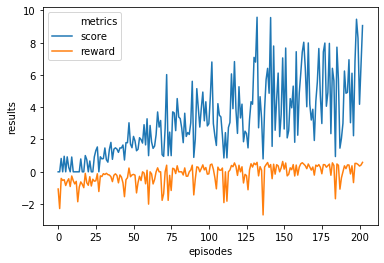

Max Train Score 19 Max Test Score 23
Mean Train Score 3.187544319534914 Mean Test Score 5.5389512802064385
----------------------------------------------------------------------------------------------------
n_eval_episode max results  10


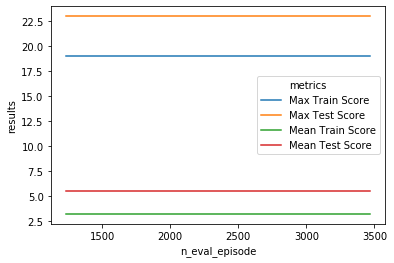

----------------------------------------------------------------------------------------------------
Using cpu device
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 88.3     |
|    ep_rew_mean        | -33.6    |
| time/                 |          |
|    fps                | 419      |
|    iterations         | 1000     |
|    time_elapsed       | 11       |
|    total_timesteps    | 5000     |
| train/                |          |
|    entropy_loss       | -0.748   |
|    explained_variance | 0.303    |
|    learning_rate      | 0.001    |
|    n_updates          | 999      |
|    policy_loss        | 0.0853   |
|    value_loss         | 0.0217   |
------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 80.9     |
|    ep_rew_mean        | -5.2     |
| time/                 |          |
|    fps                | 408      |
|    iterations         | 2000 

------------------------------------
| rollout/              |          |
|    ep_len_mean        | 80.9     |
|    ep_rew_mean        | -5.2     |
| time/                 |          |
|    fps                | 385      |
|    iterations         | 2000     |
|    time_elapsed       | 25       |
|    total_timesteps    | 10000    |
| train/                |          |
|    entropy_loss       | -0.21    |
|    explained_variance | 0.461    |
|    learning_rate      | 0.001    |
|    n_updates          | 1999     |
|    policy_loss        | 0.197    |
|    value_loss         | 0.344    |
------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 92.7     |
|    ep_rew_mean        | 20.5     |
| time/                 |          |
|    fps                | 397      |
|    iterations         | 3000     |
|    time_elapsed       | 37       |
|    total_timesteps    | 15000    |
| train/                |          |
|

------------------------------------
| rollout/              |          |
|    ep_len_mean        | 92.7     |
|    ep_rew_mean        | 20.5     |
| time/                 |          |
|    fps                | 432      |
|    iterations         | 3000     |
|    time_elapsed       | 34       |
|    total_timesteps    | 15000    |
| train/                |          |
|    entropy_loss       | -0.0174  |
|    explained_variance | nan      |
|    learning_rate      | 0.001    |
|    n_updates          | 2999     |
|    policy_loss        | -0.00224 |
|    value_loss         | 1.21     |
------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 115      |
|    ep_rew_mean        | 35.7     |
| time/                 |          |
|    fps                | 431      |
|    iterations         | 4000     |
|    time_elapsed       | 46       |
|    total_timesteps    | 20000    |
| train/                |          |
|

------------------------------------
| rollout/              |          |
|    ep_len_mean        | 115      |
|    ep_rew_mean        | 35.7     |
| time/                 |          |
|    fps                | 428      |
|    iterations         | 4000     |
|    time_elapsed       | 46       |
|    total_timesteps    | 20000    |
| train/                |          |
|    entropy_loss       | -0.226   |
|    explained_variance | 0.533    |
|    learning_rate      | 0.001    |
|    n_updates          | 3999     |
|    policy_loss        | 0.142    |
|    value_loss         | 8.79     |
------------------------------------
n_eval_episode 3468.1680570442877


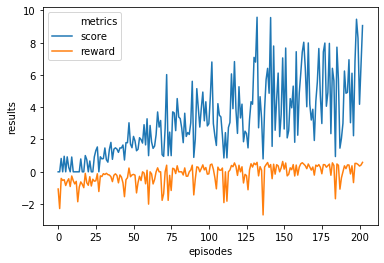

Max Train Score 19 Max Test Score 23
Mean Train Score 3.187544319534914 Mean Test Score 5.5389512802064385
----------------------------------------------------------------------------------------------------
n_eval_episode 3468.1680570442877


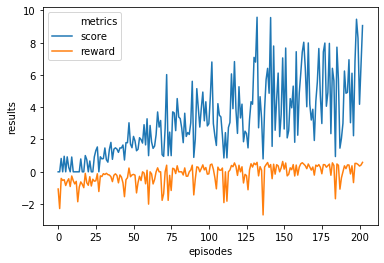

Max Train Score 19 Max Test Score 23
Mean Train Score 3.187544319534914 Mean Test Score 5.5389512802064385
----------------------------------------------------------------------------------------------------
n_eval_episode max results  10


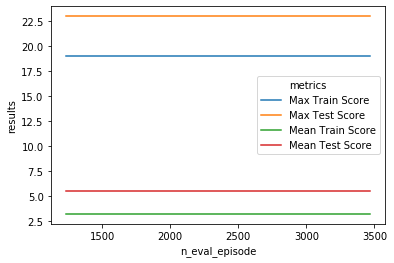

----------------------------------------------------------------------------------------------------
Using cpu device
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 88.3     |
|    ep_rew_mean        | -33.6    |
| time/                 |          |
|    fps                | 424      |
|    iterations         | 1000     |
|    time_elapsed       | 11       |
|    total_timesteps    | 5000     |
| train/                |          |
|    entropy_loss       | -0.748   |
|    explained_variance | 0.303    |
|    learning_rate      | 0.001    |
|    n_updates          | 999      |
|    policy_loss        | 0.0853   |
|    value_loss         | 0.0217   |
------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 80.9     |
|    ep_rew_mean        | -5.2     |
| time/                 |          |
|    fps                | 425      |
|    iterations         | 2000 

------------------------------------
| rollout/              |          |
|    ep_len_mean        | 80.9     |
|    ep_rew_mean        | -5.2     |
| time/                 |          |
|    fps                | 420      |
|    iterations         | 2000     |
|    time_elapsed       | 23       |
|    total_timesteps    | 10000    |
| train/                |          |
|    entropy_loss       | -0.21    |
|    explained_variance | 0.461    |
|    learning_rate      | 0.001    |
|    n_updates          | 1999     |
|    policy_loss        | 0.197    |
|    value_loss         | 0.344    |
------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 92.7     |
|    ep_rew_mean        | 20.5     |
| time/                 |          |
|    fps                | 427      |
|    iterations         | 3000     |
|    time_elapsed       | 35       |
|    total_timesteps    | 15000    |
| train/                |          |
|

------------------------------------
| rollout/              |          |
|    ep_len_mean        | 92.7     |
|    ep_rew_mean        | 20.5     |
| time/                 |          |
|    fps                | 429      |
|    iterations         | 3000     |
|    time_elapsed       | 34       |
|    total_timesteps    | 15000    |
| train/                |          |
|    entropy_loss       | -0.0174  |
|    explained_variance | nan      |
|    learning_rate      | 0.001    |
|    n_updates          | 2999     |
|    policy_loss        | -0.00224 |
|    value_loss         | 1.21     |
------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 115      |
|    ep_rew_mean        | 35.7     |
| time/                 |          |
|    fps                | 428      |
|    iterations         | 4000     |
|    time_elapsed       | 46       |
|    total_timesteps    | 20000    |
| train/                |          |
|

------------------------------------
| rollout/              |          |
|    ep_len_mean        | 115      |
|    ep_rew_mean        | 35.7     |
| time/                 |          |
|    fps                | 432      |
|    iterations         | 4000     |
|    time_elapsed       | 46       |
|    total_timesteps    | 20000    |
| train/                |          |
|    entropy_loss       | -0.226   |
|    explained_variance | 0.533    |
|    learning_rate      | 0.001    |
|    n_updates          | 3999     |
|    policy_loss        | 0.142    |
|    value_loss         | 8.79     |
------------------------------------
n_eval_episode 3468.1680570442877


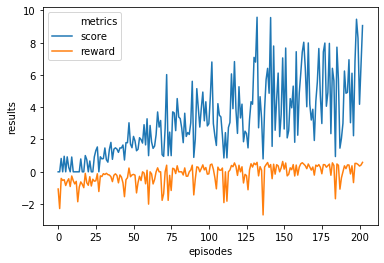

Max Train Score 19 Max Test Score 23
Mean Train Score 3.187544319534914 Mean Test Score 5.5389512802064385
----------------------------------------------------------------------------------------------------
n_eval_episode 3468.1680570442877


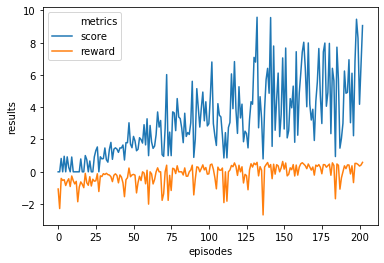

Max Train Score 19 Max Test Score 23
Mean Train Score 3.187544319534914 Mean Test Score 5.5389512802064385
----------------------------------------------------------------------------------------------------
n_eval_episode max results  10


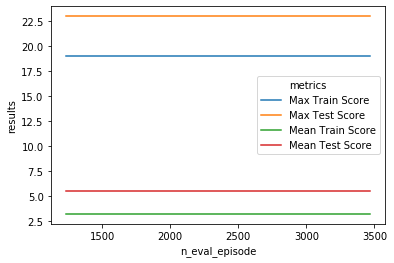

----------------------------------------------------------------------------------------------------
Using cpu device
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 88.3     |
|    ep_rew_mean        | -33.6    |
| time/                 |          |
|    fps                | 444      |
|    iterations         | 1000     |
|    time_elapsed       | 11       |
|    total_timesteps    | 5000     |
| train/                |          |
|    entropy_loss       | -0.748   |
|    explained_variance | 0.303    |
|    learning_rate      | 0.001    |
|    n_updates          | 999      |
|    policy_loss        | 0.0853   |
|    value_loss         | 0.0217   |
------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 80.9     |
|    ep_rew_mean        | -5.2     |
| time/                 |          |
|    fps                | 438      |
|    iterations         | 2000 

------------------------------------
| rollout/              |          |
|    ep_len_mean        | 80.9     |
|    ep_rew_mean        | -5.2     |
| time/                 |          |
|    fps                | 428      |
|    iterations         | 2000     |
|    time_elapsed       | 23       |
|    total_timesteps    | 10000    |
| train/                |          |
|    entropy_loss       | -0.21    |
|    explained_variance | 0.461    |
|    learning_rate      | 0.001    |
|    n_updates          | 1999     |
|    policy_loss        | 0.197    |
|    value_loss         | 0.344    |
------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 92.7     |
|    ep_rew_mean        | 20.5     |
| time/                 |          |
|    fps                | 433      |
|    iterations         | 3000     |
|    time_elapsed       | 34       |
|    total_timesteps    | 15000    |
| train/                |          |
|

------------------------------------
| rollout/              |          |
|    ep_len_mean        | 92.7     |
|    ep_rew_mean        | 20.5     |
| time/                 |          |
|    fps                | 424      |
|    iterations         | 3000     |
|    time_elapsed       | 35       |
|    total_timesteps    | 15000    |
| train/                |          |
|    entropy_loss       | -0.0174  |
|    explained_variance | nan      |
|    learning_rate      | 0.001    |
|    n_updates          | 2999     |
|    policy_loss        | -0.00224 |
|    value_loss         | 1.21     |
------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 115      |
|    ep_rew_mean        | 35.7     |
| time/                 |          |
|    fps                | 426      |
|    iterations         | 4000     |
|    time_elapsed       | 46       |
|    total_timesteps    | 20000    |
| train/                |          |
|

------------------------------------
| rollout/              |          |
|    ep_len_mean        | 115      |
|    ep_rew_mean        | 35.7     |
| time/                 |          |
|    fps                | 432      |
|    iterations         | 4000     |
|    time_elapsed       | 46       |
|    total_timesteps    | 20000    |
| train/                |          |
|    entropy_loss       | -0.226   |
|    explained_variance | 0.533    |
|    learning_rate      | 0.001    |
|    n_updates          | 3999     |
|    policy_loss        | 0.142    |
|    value_loss         | 8.79     |
------------------------------------
n_eval_episode 3468.1680570442877


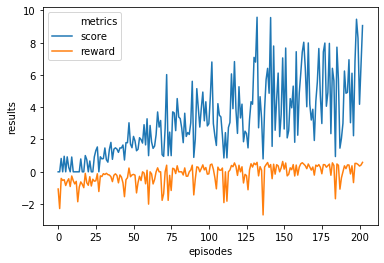

Max Train Score 19 Max Test Score 23
Mean Train Score 3.187544319534914 Mean Test Score 5.5389512802064385
----------------------------------------------------------------------------------------------------
n_eval_episode 3468.1680570442877


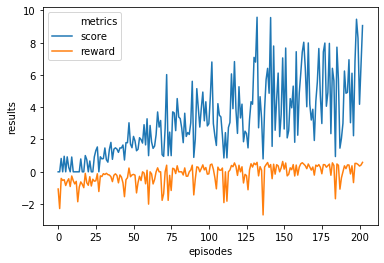

Max Train Score 19 Max Test Score 23
Mean Train Score 3.187544319534914 Mean Test Score 5.5389512802064385
----------------------------------------------------------------------------------------------------
n_eval_episode max results  10


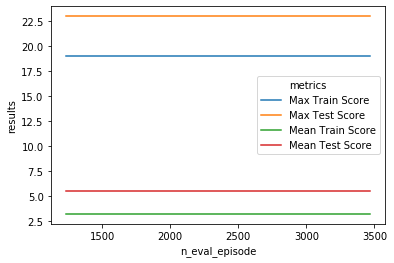

----------------------------------------------------------------------------------------------------
Using cpu device
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 88.3     |
|    ep_rew_mean        | -33.6    |
| time/                 |          |
|    fps                | 441      |
|    iterations         | 1000     |
|    time_elapsed       | 11       |
|    total_timesteps    | 5000     |
| train/                |          |
|    entropy_loss       | -0.748   |
|    explained_variance | 0.303    |
|    learning_rate      | 0.001    |
|    n_updates          | 999      |
|    policy_loss        | 0.0853   |
|    value_loss         | 0.0217   |
------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 80.9     |
|    ep_rew_mean        | -5.2     |
| time/                 |          |
|    fps                | 437      |
|    iterations         | 2000 

------------------------------------
| rollout/              |          |
|    ep_len_mean        | 80.9     |
|    ep_rew_mean        | -5.2     |
| time/                 |          |
|    fps                | 421      |
|    iterations         | 2000     |
|    time_elapsed       | 23       |
|    total_timesteps    | 10000    |
| train/                |          |
|    entropy_loss       | -0.21    |
|    explained_variance | 0.461    |
|    learning_rate      | 0.001    |
|    n_updates          | 1999     |
|    policy_loss        | 0.197    |
|    value_loss         | 0.344    |
------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 92.7     |
|    ep_rew_mean        | 20.5     |
| time/                 |          |
|    fps                | 425      |
|    iterations         | 3000     |
|    time_elapsed       | 35       |
|    total_timesteps    | 15000    |
| train/                |          |
|

------------------------------------
| rollout/              |          |
|    ep_len_mean        | 92.7     |
|    ep_rew_mean        | 20.5     |
| time/                 |          |
|    fps                | 384      |
|    iterations         | 3000     |
|    time_elapsed       | 38       |
|    total_timesteps    | 15000    |
| train/                |          |
|    entropy_loss       | -0.0174  |
|    explained_variance | nan      |
|    learning_rate      | 0.001    |
|    n_updates          | 2999     |
|    policy_loss        | -0.00224 |
|    value_loss         | 1.21     |
------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 115      |
|    ep_rew_mean        | 35.7     |
| time/                 |          |
|    fps                | 397      |
|    iterations         | 4000     |
|    time_elapsed       | 50       |
|    total_timesteps    | 20000    |
| train/                |          |
|

------------------------------------
| rollout/              |          |
|    ep_len_mean        | 115      |
|    ep_rew_mean        | 35.7     |
| time/                 |          |
|    fps                | 413      |
|    iterations         | 4000     |
|    time_elapsed       | 48       |
|    total_timesteps    | 20000    |
| train/                |          |
|    entropy_loss       | -0.226   |
|    explained_variance | 0.533    |
|    learning_rate      | 0.001    |
|    n_updates          | 3999     |
|    policy_loss        | 0.142    |
|    value_loss         | 8.79     |
------------------------------------
n_eval_episode 3468.1680570442877


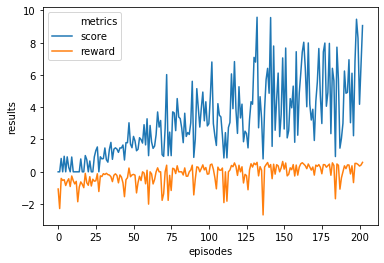

Max Train Score 19 Max Test Score 23
Mean Train Score 3.187544319534914 Mean Test Score 5.5389512802064385
----------------------------------------------------------------------------------------------------
n_eval_episode 3468.1680570442877


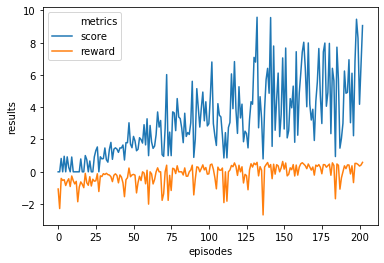

Max Train Score 19 Max Test Score 23
Mean Train Score 3.187544319534914 Mean Test Score 5.5389512802064385
----------------------------------------------------------------------------------------------------
n_eval_episode max results  10


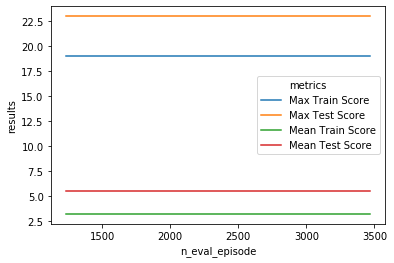

----------------------------------------------------------------------------------------------------
Using cpu device
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 88.3     |
|    ep_rew_mean        | -33.6    |
| time/                 |          |
|    fps                | 424      |
|    iterations         | 1000     |
|    time_elapsed       | 11       |
|    total_timesteps    | 5000     |
| train/                |          |
|    entropy_loss       | -0.748   |
|    explained_variance | 0.303    |
|    learning_rate      | 0.001    |
|    n_updates          | 999      |
|    policy_loss        | 0.0853   |
|    value_loss         | 0.0217   |
------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 80.9     |
|    ep_rew_mean        | -5.2     |
| time/                 |          |
|    fps                | 421      |
|    iterations         | 2000 

------------------------------------
| rollout/              |          |
|    ep_len_mean        | 80.9     |
|    ep_rew_mean        | -5.2     |
| time/                 |          |
|    fps                | 417      |
|    iterations         | 2000     |
|    time_elapsed       | 23       |
|    total_timesteps    | 10000    |
| train/                |          |
|    entropy_loss       | -0.21    |
|    explained_variance | 0.461    |
|    learning_rate      | 0.001    |
|    n_updates          | 1999     |
|    policy_loss        | 0.197    |
|    value_loss         | 0.344    |
------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 92.7     |
|    ep_rew_mean        | 20.5     |
| time/                 |          |
|    fps                | 426      |
|    iterations         | 3000     |
|    time_elapsed       | 35       |
|    total_timesteps    | 15000    |
| train/                |          |
|

------------------------------------
| rollout/              |          |
|    ep_len_mean        | 92.7     |
|    ep_rew_mean        | 20.5     |
| time/                 |          |
|    fps                | 406      |
|    iterations         | 3000     |
|    time_elapsed       | 36       |
|    total_timesteps    | 15000    |
| train/                |          |
|    entropy_loss       | -0.0174  |
|    explained_variance | nan      |
|    learning_rate      | 0.001    |
|    n_updates          | 2999     |
|    policy_loss        | -0.00224 |
|    value_loss         | 1.21     |
------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 115      |
|    ep_rew_mean        | 35.7     |
| time/                 |          |
|    fps                | 412      |
|    iterations         | 4000     |
|    time_elapsed       | 48       |
|    total_timesteps    | 20000    |
| train/                |          |
|

------------------------------------
| rollout/              |          |
|    ep_len_mean        | 115      |
|    ep_rew_mean        | 35.7     |
| time/                 |          |
|    fps                | 439      |
|    iterations         | 4000     |
|    time_elapsed       | 45       |
|    total_timesteps    | 20000    |
| train/                |          |
|    entropy_loss       | -0.226   |
|    explained_variance | 0.533    |
|    learning_rate      | 0.001    |
|    n_updates          | 3999     |
|    policy_loss        | 0.142    |
|    value_loss         | 8.79     |
------------------------------------
n_eval_episode 3468.1680570442877


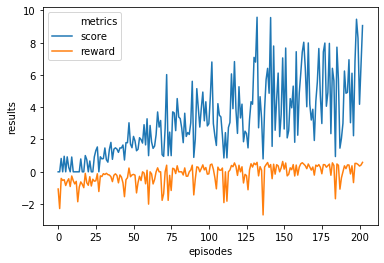

Max Train Score 19 Max Test Score 23
Mean Train Score 3.187544319534914 Mean Test Score 5.5389512802064385
----------------------------------------------------------------------------------------------------
n_eval_episode 3468.1680570442877


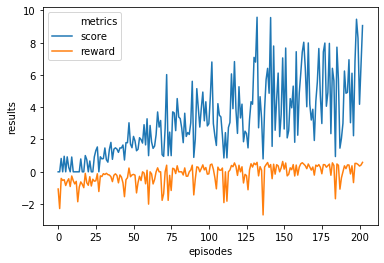

Max Train Score 19 Max Test Score 23
Mean Train Score 3.187544319534914 Mean Test Score 5.5389512802064385
----------------------------------------------------------------------------------------------------
n_eval_episode max results  10


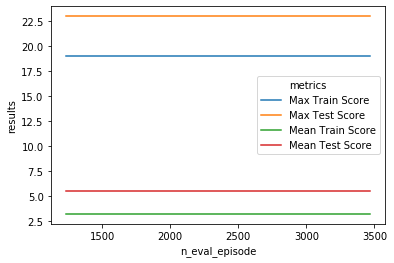

----------------------------------------------------------------------------------------------------
Using cpu device
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 88.3     |
|    ep_rew_mean        | -33.6    |
| time/                 |          |
|    fps                | 442      |
|    iterations         | 1000     |
|    time_elapsed       | 11       |
|    total_timesteps    | 5000     |
| train/                |          |
|    entropy_loss       | -0.748   |
|    explained_variance | 0.303    |
|    learning_rate      | 0.001    |
|    n_updates          | 999      |
|    policy_loss        | 0.0853   |
|    value_loss         | 0.0217   |
------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 80.9     |
|    ep_rew_mean        | -5.2     |
| time/                 |          |
|    fps                | 434      |
|    iterations         | 2000 

------------------------------------
| rollout/              |          |
|    ep_len_mean        | 80.9     |
|    ep_rew_mean        | -5.2     |
| time/                 |          |
|    fps                | 423      |
|    iterations         | 2000     |
|    time_elapsed       | 23       |
|    total_timesteps    | 10000    |
| train/                |          |
|    entropy_loss       | -0.21    |
|    explained_variance | 0.461    |
|    learning_rate      | 0.001    |
|    n_updates          | 1999     |
|    policy_loss        | 0.197    |
|    value_loss         | 0.344    |
------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 92.7     |
|    ep_rew_mean        | 20.5     |
| time/                 |          |
|    fps                | 427      |
|    iterations         | 3000     |
|    time_elapsed       | 35       |
|    total_timesteps    | 15000    |
| train/                |          |
|

------------------------------------
| rollout/              |          |
|    ep_len_mean        | 92.7     |
|    ep_rew_mean        | 20.5     |
| time/                 |          |
|    fps                | 418      |
|    iterations         | 3000     |
|    time_elapsed       | 35       |
|    total_timesteps    | 15000    |
| train/                |          |
|    entropy_loss       | -0.0174  |
|    explained_variance | nan      |
|    learning_rate      | 0.001    |
|    n_updates          | 2999     |
|    policy_loss        | -0.00224 |
|    value_loss         | 1.21     |
------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 115      |
|    ep_rew_mean        | 35.7     |
| time/                 |          |
|    fps                | 418      |
|    iterations         | 4000     |
|    time_elapsed       | 47       |
|    total_timesteps    | 20000    |
| train/                |          |
|

------------------------------------
| rollout/              |          |
|    ep_len_mean        | 115      |
|    ep_rew_mean        | 35.7     |
| time/                 |          |
|    fps                | 432      |
|    iterations         | 4000     |
|    time_elapsed       | 46       |
|    total_timesteps    | 20000    |
| train/                |          |
|    entropy_loss       | -0.226   |
|    explained_variance | 0.533    |
|    learning_rate      | 0.001    |
|    n_updates          | 3999     |
|    policy_loss        | 0.142    |
|    value_loss         | 8.79     |
------------------------------------
n_eval_episode 3468.1680570442877


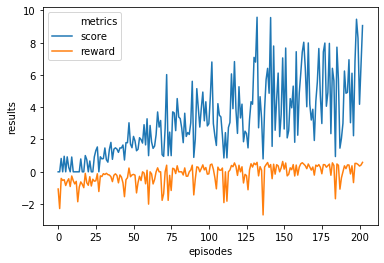

Max Train Score 19 Max Test Score 23
Mean Train Score 3.187544319534914 Mean Test Score 5.5389512802064385
----------------------------------------------------------------------------------------------------
n_eval_episode 3468.1680570442877


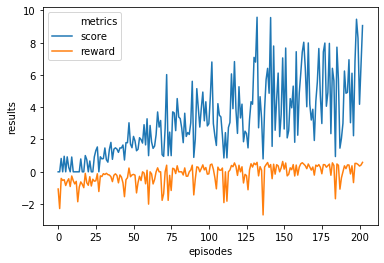

Max Train Score 19 Max Test Score 23
Mean Train Score 3.187544319534914 Mean Test Score 5.5389512802064385
----------------------------------------------------------------------------------------------------
n_eval_episode max results  10


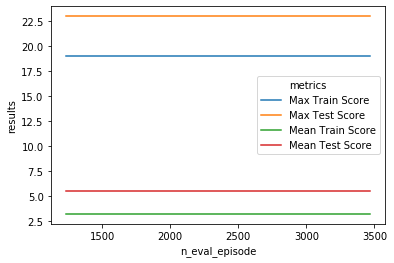

----------------------------------------------------------------------------------------------------
Using cpu device
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 88.3     |
|    ep_rew_mean        | -33.6    |
| time/                 |          |
|    fps                | 437      |
|    iterations         | 1000     |
|    time_elapsed       | 11       |
|    total_timesteps    | 5000     |
| train/                |          |
|    entropy_loss       | -0.748   |
|    explained_variance | 0.303    |
|    learning_rate      | 0.001    |
|    n_updates          | 999      |
|    policy_loss        | 0.0853   |
|    value_loss         | 0.0217   |
------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 80.9     |
|    ep_rew_mean        | -5.2     |
| time/                 |          |
|    fps                | 429      |
|    iterations         | 2000 

------------------------------------
| rollout/              |          |
|    ep_len_mean        | 80.9     |
|    ep_rew_mean        | -5.2     |
| time/                 |          |
|    fps                | 433      |
|    iterations         | 2000     |
|    time_elapsed       | 23       |
|    total_timesteps    | 10000    |
| train/                |          |
|    entropy_loss       | -0.21    |
|    explained_variance | 0.461    |
|    learning_rate      | 0.001    |
|    n_updates          | 1999     |
|    policy_loss        | 0.197    |
|    value_loss         | 0.344    |
------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 92.7     |
|    ep_rew_mean        | 20.5     |
| time/                 |          |
|    fps                | 436      |
|    iterations         | 3000     |
|    time_elapsed       | 34       |
|    total_timesteps    | 15000    |
| train/                |          |
|

------------------------------------
| rollout/              |          |
|    ep_len_mean        | 92.7     |
|    ep_rew_mean        | 20.5     |
| time/                 |          |
|    fps                | 437      |
|    iterations         | 3000     |
|    time_elapsed       | 34       |
|    total_timesteps    | 15000    |
| train/                |          |
|    entropy_loss       | -0.0174  |
|    explained_variance | nan      |
|    learning_rate      | 0.001    |
|    n_updates          | 2999     |
|    policy_loss        | -0.00224 |
|    value_loss         | 1.21     |
------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 115      |
|    ep_rew_mean        | 35.7     |
| time/                 |          |
|    fps                | 439      |
|    iterations         | 4000     |
|    time_elapsed       | 45       |
|    total_timesteps    | 20000    |
| train/                |          |
|

------------------------------------
| rollout/              |          |
|    ep_len_mean        | 115      |
|    ep_rew_mean        | 35.7     |
| time/                 |          |
|    fps                | 429      |
|    iterations         | 4000     |
|    time_elapsed       | 46       |
|    total_timesteps    | 20000    |
| train/                |          |
|    entropy_loss       | -0.226   |
|    explained_variance | 0.533    |
|    learning_rate      | 0.001    |
|    n_updates          | 3999     |
|    policy_loss        | 0.142    |
|    value_loss         | 8.79     |
------------------------------------
n_eval_episode 3468.1680570442877


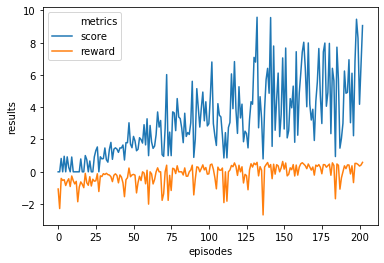

Max Train Score 19 Max Test Score 23
Mean Train Score 3.187544319534914 Mean Test Score 5.5389512802064385
----------------------------------------------------------------------------------------------------
n_eval_episode 3468.1680570442877


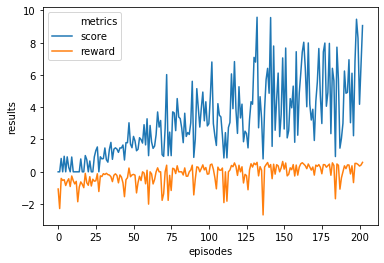

Max Train Score 19 Max Test Score 23
Mean Train Score 3.187544319534914 Mean Test Score 5.5389512802064385
----------------------------------------------------------------------------------------------------
n_eval_episode max results  10


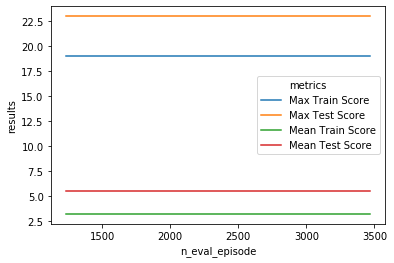

----------------------------------------------------------------------------------------------------
Using cpu device
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 88.3     |
|    ep_rew_mean        | -33.6    |
| time/                 |          |
|    fps                | 438      |
|    iterations         | 1000     |
|    time_elapsed       | 11       |
|    total_timesteps    | 5000     |
| train/                |          |
|    entropy_loss       | -0.748   |
|    explained_variance | 0.303    |
|    learning_rate      | 0.001    |
|    n_updates          | 999      |
|    policy_loss        | 0.0853   |
|    value_loss         | 0.0217   |
------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 80.9     |
|    ep_rew_mean        | -5.2     |
| time/                 |          |
|    fps                | 423      |
|    iterations         | 2000 

------------------------------------
| rollout/              |          |
|    ep_len_mean        | 80.9     |
|    ep_rew_mean        | -5.2     |
| time/                 |          |
|    fps                | 420      |
|    iterations         | 2000     |
|    time_elapsed       | 23       |
|    total_timesteps    | 10000    |
| train/                |          |
|    entropy_loss       | -0.21    |
|    explained_variance | 0.461    |
|    learning_rate      | 0.001    |
|    n_updates          | 1999     |
|    policy_loss        | 0.197    |
|    value_loss         | 0.344    |
------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 92.7     |
|    ep_rew_mean        | 20.5     |
| time/                 |          |
|    fps                | 426      |
|    iterations         | 3000     |
|    time_elapsed       | 35       |
|    total_timesteps    | 15000    |
| train/                |          |
|

------------------------------------
| rollout/              |          |
|    ep_len_mean        | 92.7     |
|    ep_rew_mean        | 20.5     |
| time/                 |          |
|    fps                | 434      |
|    iterations         | 3000     |
|    time_elapsed       | 34       |
|    total_timesteps    | 15000    |
| train/                |          |
|    entropy_loss       | -0.0174  |
|    explained_variance | nan      |
|    learning_rate      | 0.001    |
|    n_updates          | 2999     |
|    policy_loss        | -0.00224 |
|    value_loss         | 1.21     |
------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 115      |
|    ep_rew_mean        | 35.7     |
| time/                 |          |
|    fps                | 438      |
|    iterations         | 4000     |
|    time_elapsed       | 45       |
|    total_timesteps    | 20000    |
| train/                |          |
|

------------------------------------
| rollout/              |          |
|    ep_len_mean        | 115      |
|    ep_rew_mean        | 35.7     |
| time/                 |          |
|    fps                | 418      |
|    iterations         | 4000     |
|    time_elapsed       | 47       |
|    total_timesteps    | 20000    |
| train/                |          |
|    entropy_loss       | -0.226   |
|    explained_variance | 0.533    |
|    learning_rate      | 0.001    |
|    n_updates          | 3999     |
|    policy_loss        | 0.142    |
|    value_loss         | 8.79     |
------------------------------------
n_eval_episode 3468.1680570442877


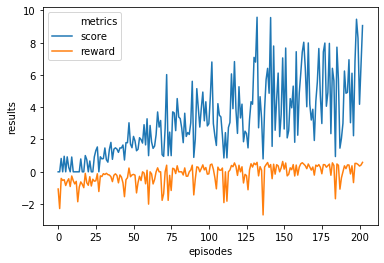

Max Train Score 19 Max Test Score 23
Mean Train Score 3.187544319534914 Mean Test Score 5.5389512802064385
----------------------------------------------------------------------------------------------------
n_eval_episode 3468.1680570442877


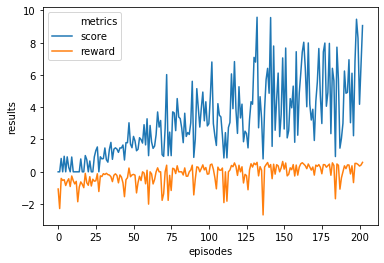

Max Train Score 19 Max Test Score 23
Mean Train Score 3.187544319534914 Mean Test Score 5.5389512802064385
----------------------------------------------------------------------------------------------------
n_eval_episode max results  10


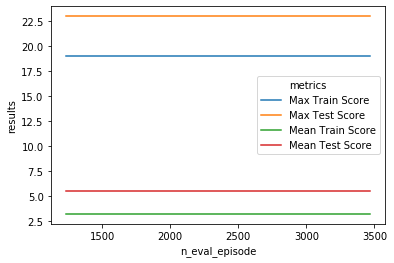

----------------------------------------------------------------------------------------------------


In [ ]:
for i in range(10):    
    results = {}
    for i in range(10):
        # enable_render=True turns on the display
        snake_env = SnakeEnv(440, 440, enable_render=False)
        env = make_vec_env(lambda: snake_env, n_envs=1)

        #entropy = random.uniform(0, 0.1)
        if i < 5:
            n_eval_episode = random.uniform(1000,1250)
        else:
            n_eval_episode = random.uniform(3000,3500)

        #gamma=0.97 is the best one?
        #leaning_rate=??? see the best result from previous test
        model = A2C(MlpPolicy, env, verbose=1, learning_rate=1e-3, gamma=0.97,seed=42)#, ent_coef=entropy)
        model.learn(total_timesteps=20000, log_interval=1000, n_eval_episodes=n_eval_episode)

        # Print rewards and scores for each episode
        max_train_score = snake_env.record
        mean_train_score = np.mean(np.array(snake_env.results['score']))
        max_test_score, mean_test_score = evaluate(model)

        results[n_eval_episode] = (snake_env.results, max_train_score, max_test_score, mean_train_score, mean_test_score)

    for n_eval_episode, result in results.items():
        metrics, max_train_score, max_test_score, mean_train_score, mean_test_score = result

        print("n_eval_episode", n_eval_episode)
        plot_metrics(metrics)    
        print("Max Train Score", max_train_score, "Max Test Score", max_test_score)
        print("Mean Train Score", mean_train_score, "Mean Test Score", mean_test_score)
        print("-"*100)
    
    print("n_eval_episode max results ", i+1)
    plot_max_results(results,'n_eval_episode')
    print("-"*100)

#### Result: The results remain equals in the time (for each iteration). using seed=42 inside the constructor influence the random.uniform() function that will return always the same value, so there are less example to evaluate

## n_eval_episode with fixed value

In [ ]:
n_eval_episodes = [1000,1500,2000,2500,3000,3500,4000,4500,5000]
results = {}
for n_eval_episode in n_eval_episodes:
    # enable_render=True turns on the display
    snake_env = SnakeEnv(440, 440, enable_render=False)
    env = make_vec_env(lambda: snake_env, n_envs=1)

    #debug
    print(n_eval_episode)
    
    model = A2C(MlpPolicy, env, verbose=1, learning_rate=1e-3, gamma=0.97,seed=42)
    model.learn(total_timesteps=20000, log_interval=1000, n_eval_episodes=n_eval_episode)

    # Print rewards and scores for each episode
    max_train_score = snake_env.record
    mean_train_score = np.mean(np.array(snake_env.results['score']))
    max_test_score, mean_test_score = evaluate(model)

    results[n_eval_episode] = (snake_env.results, max_train_score, max_test_score, mean_train_score, mean_test_score)


1000
Using cpu device
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 88.3     |
|    ep_rew_mean        | -33.6    |
| time/                 |          |
|    fps                | 390      |
|    iterations         | 1000     |
|    time_elapsed       | 12       |
|    total_timesteps    | 5000     |
| train/                |          |
|    entropy_loss       | -0.748   |
|    explained_variance | 0.303    |
|    learning_rate      | 0.001    |
|    n_updates          | 999      |
|    policy_loss        | 0.0853   |
|    value_loss         | 0.0217   |
------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 80.9     |
|    ep_rew_mean        | -5.2     |
| time/                 |          |
|    fps                | 392      |
|    iterations         | 2000     |
|    time_elapsed       | 25       |
|    total_timesteps    | 10000    |
| train/        

------------------------------------
| rollout/              |          |
|    ep_len_mean        | 80.9     |
|    ep_rew_mean        | -5.2     |
| time/                 |          |
|    fps                | 429      |
|    iterations         | 2000     |
|    time_elapsed       | 23       |
|    total_timesteps    | 10000    |
| train/                |          |
|    entropy_loss       | -0.21    |
|    explained_variance | 0.461    |
|    learning_rate      | 0.001    |
|    n_updates          | 1999     |
|    policy_loss        | 0.197    |
|    value_loss         | 0.344    |
------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 92.7     |
|    ep_rew_mean        | 20.5     |
| time/                 |          |
|    fps                | 430      |
|    iterations         | 3000     |
|    time_elapsed       | 34       |
|    total_timesteps    | 15000    |
| train/                |          |
|

------------------------------------
| rollout/              |          |
|    ep_len_mean        | 92.7     |
|    ep_rew_mean        | 20.5     |
| time/                 |          |
|    fps                | 392      |
|    iterations         | 3000     |
|    time_elapsed       | 38       |
|    total_timesteps    | 15000    |
| train/                |          |
|    entropy_loss       | -0.0174  |
|    explained_variance | nan      |
|    learning_rate      | 0.001    |
|    n_updates          | 2999     |
|    policy_loss        | -0.00224 |
|    value_loss         | 1.21     |
------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 115      |
|    ep_rew_mean        | 35.7     |
| time/                 |          |
|    fps                | 399      |
|    iterations         | 4000     |
|    time_elapsed       | 50       |
|    total_timesteps    | 20000    |
| train/                |          |
|

n_eval_episode 1000


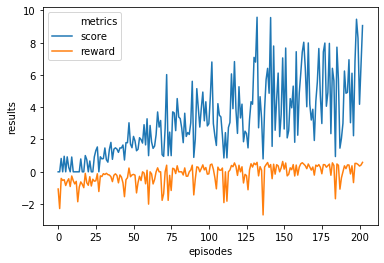

Max Train Score 19 Max Test Score 23
Mean Train Score 3.187544319534914 Mean Test Score 5.5389512802064385
----------------------------------------------------------------------------------------------------
n_eval_episode 1500


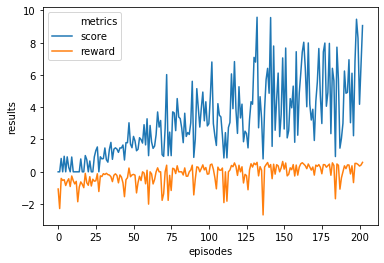

Max Train Score 19 Max Test Score 23
Mean Train Score 3.187544319534914 Mean Test Score 5.5389512802064385
----------------------------------------------------------------------------------------------------
n_eval_episode 2000


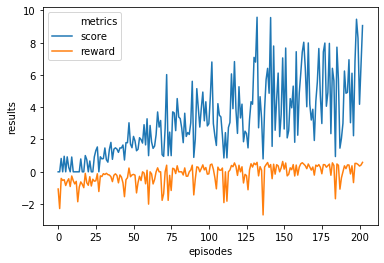

Max Train Score 19 Max Test Score 23
Mean Train Score 3.187544319534914 Mean Test Score 5.5389512802064385
----------------------------------------------------------------------------------------------------
n_eval_episode 2500


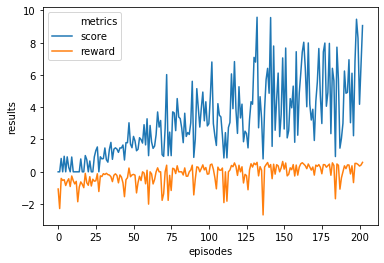

Max Train Score 19 Max Test Score 23
Mean Train Score 3.187544319534914 Mean Test Score 5.5389512802064385
----------------------------------------------------------------------------------------------------
n_eval_episode 3000


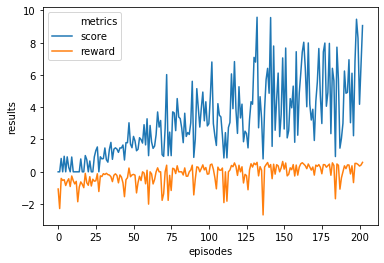

Max Train Score 19 Max Test Score 23
Mean Train Score 3.187544319534914 Mean Test Score 5.5389512802064385
----------------------------------------------------------------------------------------------------
n_eval_episode 3500


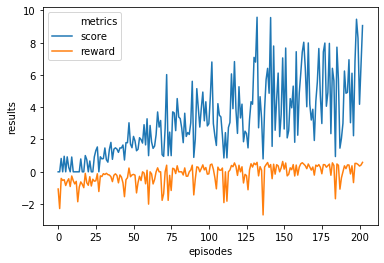

Max Train Score 19 Max Test Score 23
Mean Train Score 3.187544319534914 Mean Test Score 5.5389512802064385
----------------------------------------------------------------------------------------------------
n_eval_episode 4000


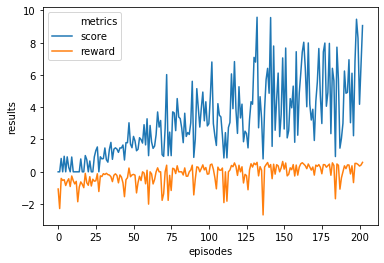

Max Train Score 19 Max Test Score 23
Mean Train Score 3.187544319534914 Mean Test Score 5.5389512802064385
----------------------------------------------------------------------------------------------------
n_eval_episode 4500


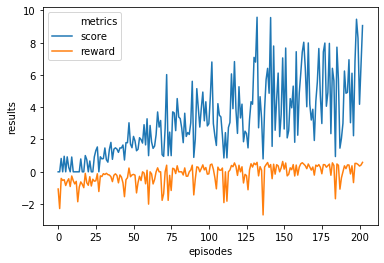

Max Train Score 19 Max Test Score 23
Mean Train Score 3.187544319534914 Mean Test Score 5.5389512802064385
----------------------------------------------------------------------------------------------------
n_eval_episode 5000


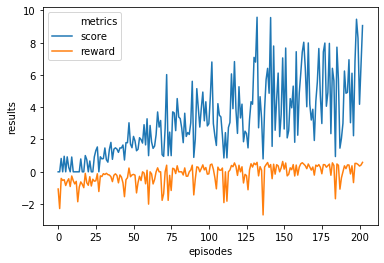

Max Train Score 19 Max Test Score 23
Mean Train Score 3.187544319534914 Mean Test Score 5.5389512802064385
----------------------------------------------------------------------------------------------------


In [ ]:
   for n_eval_episode, result in results.items():
        metrics, max_train_score, max_test_score, mean_train_score, mean_test_score = result

        print("n_eval_episode", n_eval_episode)
        plot_metrics(metrics)    
        print("Max Train Score", max_train_score, "Max Test Score", max_test_score)
        print("Mean Train Score", mean_train_score, "Mean Test Score", mean_test_score)
        print("-"*100)

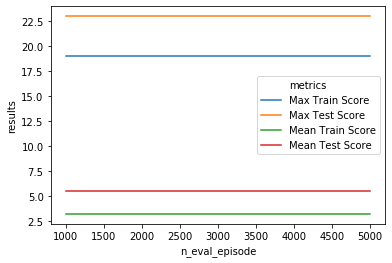

In [ ]:
plot_max_results(results,'n_eval_episode')

#### Result: with seed=42 n_eval_episode is not influent in the training

# Final Test

## learning_rate = 0.00092, seed = 42, use_rms_prop = False, n_eval_episode = 1000 , gamma = 0.97

In [ ]:
results = {}

# enable_render=True turns on the display
snake_env = SnakeEnv(440, 440, enable_render=False)
env = make_vec_env(lambda: snake_env, n_envs=1)

model = A2C(MlpPolicy, env, verbose=1, learning_rate=0.00092, seed=42, gamma=0.97, use_rms_prop = False)
model.learn(total_timesteps=20000, log_interval=1000, n_eval_episodes=1000)

# Print rewards and scores for each episode
max_train_score = snake_env.record
mean_train_score = np.mean(np.array(snake_env.results['score']))
max_test_score, mean_test_score = evaluate(model)

results[learning_rate] = (snake_env.results, max_train_score, max_test_score, mean_train_score, mean_test_score)

Using cpu device
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 81       |
|    ep_rew_mean        | -35.1    |
| time/                 |          |
|    fps                | 378      |
|    iterations         | 1000     |
|    time_elapsed       | 13       |
|    total_timesteps    | 5000     |
| train/                |          |
|    entropy_loss       | -0.73    |
|    explained_variance | -0.0949  |
|    learning_rate      | 0.00092  |
|    n_updates          | 999      |
|    policy_loss        | -0.0757  |
|    value_loss         | 0.334    |
------------------------------------
------------------------------------
| rollout/              |          |
|    ep_len_mean        | 85.9     |
|    ep_rew_mean        | -6.4     |
| time/                 |          |
|    fps                | 333      |
|    iterations         | 2000     |
|    time_elapsed       | 29       |
|    total_timesteps    | 10000    |
| train/             

Adam Optimization


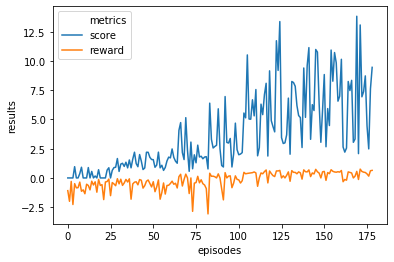

Max Train Score 27 Max Test Score 40
Mean Train Score 3.6481506234564094 Mean Test Score 8.772024393923823
----------------------------------------------------------------------------------------------------


In [ ]:
for learning_rate, result in results.items():
    metrics, max_train_score, max_test_score, mean_train_score, mean_test_score = result
    
    print("Adam Optimization")
    plot_metrics(metrics)    
    print("Max Train Score", max_train_score, "Max Test Score", max_test_score)
    print("Mean Train Score", mean_train_score, "Mean Test Score", mean_test_score)
    print("-"*100)

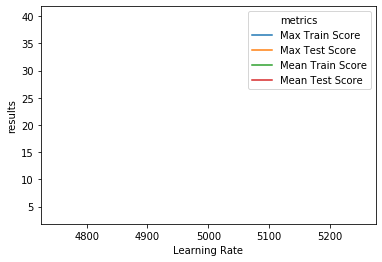

In [ ]:
plot_max_results(results,'Learning Rate')

#### Result: The best result obtained

## learning_rate = 0.00092, seed = 42, use_rms_prop = True, n_eval_episode = 1000 , gamma = 0.97

In [ ]:
results = {}

# enable_render=True turns on the display
snake_env = SnakeEnv(440, 440, enable_render=False)
env = make_vec_env(lambda: snake_env, n_envs=1)

model = A2C(MlpPolicy, env, verbose=1, learning_rate=0.00092, seed=42, gamma=0.97, use_rms_prop = True)
model.learn(total_timesteps=20000, log_interval=1000, n_eval_episodes=1000)

# Print rewards and scores for each episode
max_train_score = snake_env.record
mean_train_score = np.mean(np.array(snake_env.results['score']))
max_test_score, mean_test_score = evaluate(model)

results[learning_rate] = (snake_env.results, max_train_score, max_test_score, mean_train_score, mean_test_score)

Using cpu device
-------------------------------------
| rollout/              |           |
|    ep_len_mean        | 84.6      |
|    ep_rew_mean        | -35.4     |
| time/                 |           |
|    fps                | 368       |
|    iterations         | 1000      |
|    time_elapsed       | 13        |
|    total_timesteps    | 5000      |
| train/                |           |
|    entropy_loss       | -0.75     |
|    explained_variance | -2.07e+04 |
|    learning_rate      | 0.00092   |
|    n_updates          | 999       |
|    policy_loss        | -6.49     |
|    value_loss         | 586       |
-------------------------------------
-------------------------------------
| rollout/              |           |
|    ep_len_mean        | 73.3      |
|    ep_rew_mean        | -4.1      |
| time/                 |           |
|    fps                | 357       |
|    iterations         | 2000      |
|    time_elapsed       | 27        |
|    total_timesteps    | 10000  

RMSprop Optimization


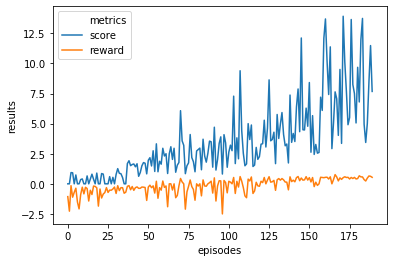

Max Train Score 29 Max Test Score 30
Mean Train Score 3.461443102697701 Mean Test Score 7.127378206363459
----------------------------------------------------------------------------------------------------


In [ ]:
for learning_rate, result in results.items():
    metrics, max_train_score, max_test_score, mean_train_score, mean_test_score = result
    
    print("RMSprop Optimization")
    plot_metrics(metrics)    
    print("Max Train Score", max_train_score, "Max Test Score", max_test_score)
    print("Mean Train Score", mean_train_score, "Mean Test Score", mean_test_score)
    print("-"*100)

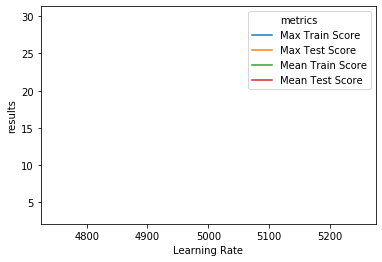

In [ ]:
plot_max_results(results,'Learning Rate')

#### Result: Adam was better for the our project